#Algoritimo Genético Para Sintonia de LSTM

##Declarações Globais

In [1]:
!pip install -U scikit-learn 

     |████████████████████████████████| 22.3MB 1.8MB/s 
  Found existing installation: scikit-learn 0.22.2.post1
    Uninstalling scikit-learn-0.22.2.post1:
      Successfully uninstalled scikit-learn-0.22.2.post1


In [2]:
import matplotlib.pyplot        as plt
import numpy                    as np
import pandas                   as pd
import seaborn                  as sns
import tensorflow               as tf
import os
import glob
import shutil
import random                   as rn
import math

from datetime                   import datetime, timedelta
from sklearn.model_selection    import train_test_split,RepeatedStratifiedKFold 
from sklearn.preprocessing      import MinMaxScaler
from sklearn.preprocessing      import StandardScaler        #Normalização dos dados
from sklearn.pipeline           import make_pipeline         #Pipe Line
from sklearn.neural_network     import MLPRegressor
from sklearn.metrics            import mean_absolute_percentage_error

from sklearn.model_selection    import GridSearchCV
#from sklearn.svm import SVC
from tensorflow                 import keras
from tensorflow.keras           import Sequential, layers, callbacks
from tensorflow.keras           import backend as K
from tensorflow.keras.layers    import Dense, LSTM, Dropout, Bidirectional

seed = 170696
sns.set()
sns.set_theme()

#### Path

In [3]:
#path  = '/tmp/'
path  = '/content/drive/MyDrive/Ensino/UFRGS/Projeto de Diplomação/'
patha = path  + 'arca3/'
pathb = patha + 'bkp/'
urla  = patha + 'arca.csv'
urld  = path  + 'dfConsumo_clima2.csv'

### Randon Freeze

In [4]:
def imports():
    import matplotlib.pyplot        as plt
    import numpy                    as np
    import pandas                   as pd
    import seaborn                  as sns
    import tensorflow               as tf
    import os
    import glob
    import shutil
    import random                   as rn
    import math

    from datetime                   import datetime, timedelta
    from sklearn.model_selection    import train_test_split,RepeatedStratifiedKFold 
    from sklearn.preprocessing      import MinMaxScaler
    from sklearn.preprocessing      import StandardScaler        #Normalização dos dados
    from sklearn.pipeline           import make_pipeline         #Pipe Line
    from sklearn.neural_network     import MLPRegressor
    from sklearn.metrics            import mean_absolute_percentage_error

    from sklearn.model_selection    import GridSearchCV
    #from sklearn.svm import SVC
    from tensorflow                 import keras
    from tensorflow.keras           import Sequential, layers, callbacks
    from tensorflow.keras           import backend as K
    from tensorflow.keras.layers    import Dense, LSTM, Dropout, Bidirectional

    seed = 170696
    sns.set()
    sns.set_theme()

In [5]:
# Utilizando o essa foi a unica maneira encontrada para congelar o randon e 
# garantir a reprodutibilidade do modelo 

def reset_seed(seed,keras=False):
    imports()
    os.environ['PYTHONHASHSEED'] = '0'
    np.random.seed(seed)
    rn.seed(seed)

    session_conf = tf.compat.v1.ConfigProto(intra_op_parallelism_threads=1, inter_op_parallelism_threads=1)
    from keras import backend as K
    tf.compat.v1.set_random_seed(seed)
    sess = tf.compat.v1.Session(graph=tf.compat.v1.get_default_graph(), config=session_conf)
    K.set_session(sess)

def set_seed_rand():
    
    from datetime import datetime

    dt_seg_now = datetime.now().strftime("%S")
    #print("\t\tSEED =", dt_seg_now)	
    nseed = int(dt_seg_now)
    os.environ['PYTHONHASHSEED'] = str(nseed)
    np.random.seed(nseed)
    rn.seed(nseed)
    print("\t\tSEED =", dt_seg_now)	


## Dados

In [6]:
urldfCC = 'https://raw.githubusercontent.com/lvb86/MLPr_GA/main/swap/dfConsumoClima2.csv'
df = pd.read_csv(urldfCC, index_col=0)
d = df.iloc[:,1:-3]
d.head()

d = df.iloc[:,1:-3]
d['mes_sin'] = np.sin(d['Mês']*2*np.pi/12)
d['mes_cos'] = np.cos(d['Mês']*2*np.pi/12)
d.drop('Mês', axis=1, inplace=True)

X = d.drop(['Consumo'],axis = 1)
y = d.Consumo
# Different scaler for input and output
scaler_x = MinMaxScaler(feature_range = (0,1))
scaler_y = MinMaxScaler(feature_range = (0,1))

# Fit the scaler using available training data
input_scaler = scaler_x.fit(X)
output_scaler = scaler_y.fit(y.to_numpy().reshape(-1,1))

# Apply the scaler to training data
X_norm = input_scaler.transform(X)
y_norm = output_scaler.transform(y.to_numpy().reshape(-1,1))

X_train = X_norm[:60]
y_train = y_norm[:60]

X_test = X_norm[60:]
y_test = y_norm[60:]

X_train = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
print("Dimensões: ",X_train.shape, X_test.shape)

Dimensões:  (60, 1, 9) (12, 1, 9)


## Funções

###Genéticas

#### Inicia Populacão

In [7]:
def inicializa_populacao(pop_tamanho, n_genes, limites):
    """
    Inicializa a população de acordo com o tamanho da população
    e número de genes.

    param pop_tamanho:     Número de individuos na população
    param n_genes:         Número de genes (Variáveis) no problema
    param limites:         Tupla contendo o número mínimo e máximo permitido  
    return:                Um array numpy com a população iniciada 
                           randomicamente
    """

    pop0 = np.random.randint(
      limites[0], limites[1], size=(pop_tamanho, n_genes)
    )
    pop=[]
    for e, i in enumerate(pop0):
        if np.sum(i) == 0:
            n = np.random.randint(limites[0]+1, limites[1], size=(1, n_genes))
            #print(e,i,n)
            pop.append(n)
        else:    
            pop.append(i)
    return pop

####Função de aptidão

In [8]:
def rede_desc(bl_list, unit_list, drop_list):
    '''
    Retorna descrição gráfica da Rede

    '''
    dic_bl = {0: 'LSTM', 1:'BILSTM'}
    desc = '->'
    for e,i in enumerate(unit_list):
        if i >0:
            if e < 2:
                desc+=(f'{dic_bl[bl_list[e]]}')   
            else:
                desc+=('MLP')
            desc+=(f'({unit_list[e]})->')
            if e < 5:
                desc+=(f'd({drop_list[e]})->')
    return desc

In [9]:
def decode_gen(chave):
    '''
    Recebe chave genética e retorna estrutura da rede 
    considerando arquitetura predefinida 

            Tipo---\ Dropout -----------------\ Neurônios-------------------\ 
            B|L  B|L  D12  D23  D34  D45  D56  NL1  NL2  NL3  NL4  NL5  NL6              
    chave =[ p01, p02, p03, p04, p05, p06, p07, p07, p08, p09, p10, p11, p12]
            2|1  2|1  2|1  2|1  2|1

    Tipo      -> se par BILSTM se não LSTM
    Dropout   -> If 0 = 0 
                Else
                    Se par 0.2 senão 0.1 
    Neurônios -> If 0 desetiva layer e dropout seguinte 
                Else numero de neurônios da camada                
    '''

    bl_list = []
    drop_list = []
    unit_list = []
    Lini = 0
    Lcount = 0

    for i in range(7,13):
        if chave[i] >0:
            ini = i-6
            break
    for i in range(7,13):
        if chave[i] >0:
            Lcount +=1
    print(f'\tN Layers = {Lcount}')

    for i in range(2):
        if chave[i] % 2 == 0:
            bl_list.append(1)
        else:
            bl_list.append(0)

    for i in range(2,7):
        if chave[i] ==0:
            drop_list.append(0)
        else:
            if chave[i] % 2 == 0:
                drop_list.append(0.2)
            else: 

                drop_list.append(0.1)

    for i in range(7,13):
        unit_list.append(chave[i])

    desc = rede_desc(bl_list, unit_list, drop_list)
    print('\t'+desc)
    return bl_list, unit_list, drop_list, desc

In [10]:
def monta_modelo(bl_list, unit_list, drop_list):
    '''
    Modelo Keras
    '''
    model = tf.keras.models.Sequential()
    model.add(tf.keras.layers.InputLayer(input_shape=(1,9)))

    for e,i in enumerate(unit_list):
        if i > 0:
            if e < 2:           # LSTM
                if bl_list[e]:
                    model.add(tf.keras.layers.Bidirectional(LSTM (units = i, return_sequences=True )))    
                else:
                    model.add(tf.keras.layers.LSTM(units = i, return_sequences=True ))

            else:               #MLP
                model.add(tf.keras.layers.Dense(units = i, activation=tf.nn.relu) )
            if e < 5:
                                #Dropout
                model.add(tf.keras.layers.Dropout(drop_list[e], seed = seed) )
    model.add(tf.keras.layers.Dense(1))
    
    return model

In [11]:
def func_aptidao(individual):
    """
    Calcula a aptidão de cada individuo

    :param individual:   Cromosomo de genes representando um individuo
    :return:             A aptidão individual e MAPE
    """
    reset_seed(seed)    #Para Garantir a repetibilidae do modelo

    bl_list, unit_list, drop_list, desc = decode_gen(individual)
    model = monta_modelo(bl_list, unit_list, drop_list)
    
        
    with tf.device(':CPU:0'):

        model.compile(optimizer = 'adam',loss='mse', metrics=['accuracy','mape'])
        early_stop = keras.callbacks.EarlyStopping(monitor = 'loss',
                                            patience = 10)
        model.fit(  x=X_train,
                    y=y_train,
                    batch_size=None,
                    epochs=10000,
                    verbose=False,
                    callbacks=[early_stop],
                    validation_split=0.0,
                    validation_data=(X_test,y_test),
                    shuffle=False,
                    class_weight=None,
                    sample_weight=None,
                    initial_epoch=0,
                    steps_per_epoch=19,
                    validation_steps=1,
                    validation_batch_size=None,
                    validation_freq=1,
                    max_queue_size=10,
                    workers=1,
                    use_multiprocessing=False)

        y_pred_norm = model.predict(X_test)
        y_pred = output_scaler.inverse_transform(y_pred_norm.ravel().reshape(-1, 1))
        mape = mean_absolute_percentage_error(y[60:],y_pred.ravel())
        apti = 1-mape

    print('\t\t','mape','|',mape, '||', 'aptidão','|',apti)
    set_seed_rand()
    return mape, apti

#### Seleção de Progenitores

In [12]:
def selecao_de_progenitores(individuos, probabilidades, pares):
    """
    Seleciona os pais de acordo com a estratégia "roulette_wheel" que seleciona 
    individuos aleatoriamente utilizando a maior aptidão como maior 
    probabilidade 
    
    param individuos:       Numero de individuos
    param probabilidades:  distribuíção de probabilidade
    return:                pares escolhidos aleatoriamente
    """
    from math import ceil
    n = len(individuos)
    pares = int(pares)
    if pares*2 > n:
        pares = n/2
    
    p1, p2 = None, None
    pn = np.random.choice(range(n),2*pares, replace = False,p=probabilidades)
    pr = np.random.choice(pn,len(pn),replace=False)
    pp = np.array(pr).reshape(ceil(len(pn)/2),2)

    print('\t\t',pp)   
    return pp

#### Cruzamento

In [13]:
def cruzamento(casal, populacao, ng):
    '''
    param casal:     index tupla (p1,p2) do casal que ira cruzar
    param populacao: recebe a popopulação atual 

    return:          2 filhos com os cruzamentos aleatórios dos genes 
    '''
    p1 = casal[0]   #progenitor 1
    p2 = casal[1]   #progenitor 2
    f1 = []         #filho 1
    f2 = []         #filho 2
    ng = populacao[p1].shape[0]

    print('\t\tpar --', casal,'------')
    print('\t\tp:',p1,populacao[p1]) #p1
    print('\t\tp:',p2,populacao[p2]) #p2

    s1=np.ones(ng)
    while(s1.sum()==ng or s1.sum()==0):   # garantia de que havera ao menos 
        s1=np.random.choice([0,1],ng)    # 1 cruzamento
    print('\t\txxx ', s1)
    for i, b in enumerate(s1):
        #print(i,b)
        if b:
            #print(x[7][i])
            f1.append(populacao[p1][i])
            f2.append(populacao[p2][i])
        else:
            #print(x[9][i])
            f1.append(populacao[p2][i])
            f2.append(populacao[p1][i])
    print('\t\tf1  ',f1)
    print('\t\tf2  ',f2)
    return np.array(f1),np.array(f2)

#### Mutação

In [14]:
#mutacao
def mutacao(original, proba_mut, ng):
    '''
    apartir de um individuo original será gerado 1 individuo mutante
    
    param original:     cromossomo do individuo original
    param proba_mut:    probabilidade de mutação 
    return:             mutante
    '''
    mutante = [] 
    print('\t\tori ', original)
    
    gm = np.random.choice(64,ng)    #Sequencia mutante Aleatória

    s1=np.ones(ng)
    while(s1.sum()==0):   # garantia de que havera ao menos 
        s1=np.random.choice([0,1],ng,p=[1-proba_mut,proba_mut])    # 1 mutação
    print('\t\txxx ', s1)
    for i, b in enumerate(s1):
        #print(i,b)
        if b:
            #print(x[7][i])
            mutante.append(gm[i])
            
        else:
            mutante.append(original[i])
            
    print('\t\tmut ',mutante)

    return  np.array(mutante)

###Busca e Salvamento 

In [15]:
def busca_item_lista(_item, _lista):
    '''
    Percorre a lista de arrays e retorna a posição se encontrar ou false se 
    não enontrar 
    
    '''
    for index, it in enumerate(_lista): 

        #print(index,it,_item, all(it==_item))
        if (all(it==_item)):
            return True, index
    return False, False

In [16]:
def salva_arca(_ep,idtest):
    now = datetime.now().strftime('_%y_%m_%d-%H_%M_')
    url = patha + 'arca' +str(idtest)+ now + str(_ep) + '.csv'
    #arca = pd.DataFrame([arca_gen,arca_mape,arca_apt]).T
    arca = pd.DataFrame(dic_arca).T.iloc[:,-3:]   
    arca.columns = ['gen','mape','apt']
    arca.apt = 1-arca.mape  #correção de aptidão relativa para geral
    arca.to_csv(url,index=False)

In [17]:
def recupera_arca():
    '''
    Recupera dados de testes passados
    
    return: arca_gen, arca_mape, arca_apt, dic_arca, dic_arca_i
    '''
    url = patha + 'arca.csv'
    arca_gen_str = pd.read_csv(url).gen.to_list()
    arca_mape    = pd.read_csv(url).mape.to_list()
    arca_apt     = pd.read_csv(url).apt.to_list()

    arca_gen = []
    for e, arc_g in enumerate(arca_gen_str):
        arca_gen.append(gene_str2numpy(arc_g))
    print(len(arca_gen))
    dic_arca = {} # Cria dicionário vazio. # set() = conjunto vazio
    dic_arca_i = {} 
    for e, i in enumerate(arca_gen):
        dic_arca[tuple(i)] = [e,i,arca_mape[e],arca_apt[e]]
        dic_arca_i[e] = i    

    return arca_gen, arca_mape, arca_apt, dic_arca, dic_arca_i

In [18]:
#arca_gen, arca_mape, arca_apt, dic_arca, dic_arca_i = recupera_arca()

In [19]:
#len(arca_gen) == len(arca_mape)

In [20]:
def gene_str2numpy(_str): 
    '''

    return: np.array com a sequencialida 
    '''
    indice = []
    arn = [] 
    ultimo = 9999
    for i, c in enumerate(_str):
        if ord(c) in (91,32,93):
            if i != ultimo + 1:
                indice.append(i)
            # print(i,c,ord(c),)
                ultimo = i

    for i in range(len(indice)-1):
        n_str =_str[indice[i]+1:indice[i+1]]
        arn.append(int(n_str.strip()))
    return np.array(arn)

In [21]:
def salva_resultado(_ep,_res,_mut,_tempo,_pop,_pop_r,_pop_c,idtest):
    now = datetime.now().strftime('_%y_%m_%d-%H_%M_')
    url = path + 'resultado' +str(idtest)+ now + str(_ep) + '.csv'
    result = pd.DataFrame([_res,_mut,_tempo,_pop,_pop_r,_pop_c]).T
    result.columns = ['Mape','Mutacao','Tempo','Populacao','Pop_Recuperada','Pop_Calculada']
    result.to_csv(url,index = False)

In [22]:
def atualiza_arca(_bol):
    if _bol:
        os.chdir(patha)
        extension = 'csv'
        all_filenames = [i for i in glob.glob('arca*.{}'.format(extension))]
        if len(all_filenames):
            now = datetime.now().strftime('%y_%m_%d-%H_%M')
            url = pathb + 'arca_bkp_' + now + '.csv'
            if os.path.exists(patha+'arca.csv'):
                pd.read_csv(patha+'arca.csv').to_csv(url)
            #combine all files in the list
            combined = pd.concat([pd.read_csv(f) for f in all_filenames ])
            filtred = combined[['gen','mape','apt']].sort_values('mape').drop_duplicates()
            #export to csv
            filtred.to_csv("arca.csv", index=False, encoding='utf-8-sig')
            # move arquivos para o bkp
            for f in all_filenames:
                if f !='arca.csv':
                    shutil.move(patha+f,pathb+f)
                    print(f)

#https://www.freecodecamp.org/news/how-to-combine-multiple-csv-files-with-8-lines-of-code-265183e0854/
#https://datatofish.com/move-file-python/

In [23]:
if 0:
    dfa = pd.read_csv(patha + 'arca.csv')
    dfa['len'] = dfa['gen'].apply(lambda x: len(x))
    #dfa['len'].count_values()
    dfb=dfa[dfa['len'] == 40]
    dfb.drop(['len'], axis =1 ,inplace = True)
    dfb.sort_values('mape').to_csv(patha + 'arca.csv', index = False)
    pd.read_csv(patha + 'arca.csv')

In [24]:
def df_arca_hist(df):
    '''
    Gera dados únicos para comparativo em histograma, considerando que:
    (3, 2, 0, 1) = (3, 2, 1)
    uma vez que na lógica implementada para arquiterura MLP a camada com 0 
    neurônios é suprimida.
    '''
    arca_hist = df[['gen','mape']]
    arca_hist['gen'] = arca_hist.gen.apply(lambda g: gene_str2numpy(g))
    arca_hist['dim'] = arca_hist.gen.apply(lambda x: np.shape(x)[0])
    arca_hist['gen'] = arca_hist.gen.apply(lambda x: str(x[np.where(x)]))
    arca_hist.drop_duplicates(inplace=True)
    
    return arca_hist[arca_hist.dim != 0]

###Relatórios e Medidas

In [25]:
def time_diff(_T1):
    T2 = datetime.now()
    format = '%H:%M'
    #tdiff = datetime.strptime(T1, format) - datetime.strptime(T2, format)
    tdiff = T2 - T1
    #if tdiff. < 0:
    #    tdiff = timedelta(days = 0,
    #                seconds = tdiff.seconds, microseconds = tdiff.microseconds)
    tdiff.total_seconds
    print( '....tempo transcorrido ', tdiff)
    return tdiff.total_seconds()/60
#

In [26]:
def relatorio_parcial():
    print('__________________RELATÓRIO PARCIAL________________________________'
    ,'\n\t\t Geração                    =', ep                  
    ,'\n\t\t Parado                     =', count_parada        
    ,'\n\t\t Códigos na arca            =', len(arca_gen)
    ,'\n\t\t % da população avaliada    =', f'{(len(arca_gen)/max_comb)*100:.5f} %'
    ,'\n\t\t Tempo médio por geração    =', f'{np.mean(list_tdiff):.5f} %'
    ,'\n\t\t Tempo médio por ind_c      =', f'{sum(list_tdiff)/sum(list_t_pop):.2f} min'
    ,'\n-->Nesta Geração:_____________________________________________________'
    ,'\n\t\t Novos indivíduos Testados  =', sum(list_t_pop_c)                
    ,'|'                                  , f'{(sum(list_t_pop_c)/max_comb)*100:.5f} %'
    ,'\n\t\t Clones indivíduos Testados =', sum(list_t_pop_r)
    ,'\n\t\t Total indivíduos Testados  =', sum(list_t_pop)
    ,'|'                                  , f'{(sum(list_t_pop)/max_comb)*100.:.5f} %'
    #,'\n\t\t Tempo por indivíduos novo  =', f'{sum(list_tdiff)/sum(list_t_pop_c):.2f} min'
    #,'\n\t\t %(indivíduos novo/Testados)=', f'{(sum(list_t_pop_c)/max_comb)*100:.5} %'
    )

    _,_,_, desc1 = decode_gen(ge_mape_gen)
    _,_,_, desc2 = decode_gen(ar_mape_gen)

    print('--------Melhor desta Geração ----------',
          '\n\t\t MAPE      = ', round(ge_mape_min,6),
          '\n\t\t id_arca   = ', ge_mape_ind         ,
          '\n\t\t gen       = ', ge_mape_gen         , 
          '\n\t'               , desc1         
          )

    print('------------Melhor testado ------------',
          '\n\t\t MAPE      = ', round(ar_mape_min,6),
          '\n\t\t id_arca   = ', ar_mape_ind         ,
          '\n\t\t gen       = ', ar_mape_gen         ,
          '\n\t'               , desc2               ,
          )
    fig, axs = plt.subplots(3,2, figsize=(12,15))
       
    sns.lineplot(ax=axs[0,0],x=range(len(res)),y=res)
    axs[0,0].set_title('MAPE mínimo por Geração')
    axs[0,0].set_ylabel('MAPE')
    #axs[0,0].set_xlabel('Geração')
    
    sns.lineplot(ax=axs[1,0],x=range(len(list_mutacao)),y=list_mutacao)
    axs[1,0].set_title('Evolução do Fator de mutação')
    axs[1,0].set_ylabel('Fator de mutação')
    #axs[1,0].set_xlabel('Geração')
    
    sns.lineplot(ax=axs[0,1],x=range(len(list_t_pop)),y=list_t_pop, label = 'total')
    sns.lineplot(ax=axs[0,1],x=range(len(list_t_pop_c)),y=list_t_pop_c, label = 'calculada')
    sns.lineplot(ax=axs[0,1],x=range(len(list_t_pop_r)),y=list_t_pop_r, label = 'recuperada')
    axs[0,1].set_title('Evolução tamanho da população')
    axs[0,1].set_ylabel('Indivíduos')
    #axs[0,1].set_xlabel('Geração')
        
    sns.lineplot(ax=axs[1,1],x=range(len(list_tdiff)),y=list_tdiff)
    sns.lineplot(ax=axs[1,1],x=range(len(list_tdiff)),y=np.mean(list_tdiff))
    axs[1,1].set_title('Perfil de tempo por iteração')
    axs[1,1].set_ylabel('tempo [min]')
    #axs[1,1].set_xlabel('Geração')
        
    sns.histplot(ax=axs[2,0],data=teste_mape, kde=True)
    axs[2,0].set_title('Distribuíção de erro por genoma teste')

    list_t_pop_a = []
    list_t_pop_ca = []
    list_t_pop_ra = []
    for e,i in enumerate(list_t_pop_c):
        list_t_pop_a.append(sum(list_t_pop[:e+1]))
        list_t_pop_ca.append(sum(list_t_pop_c[:e+1]))
        list_t_pop_ra.append(sum(list_t_pop_r[:e+1]))
    sns.lineplot(ax=axs[2,1],x=range(len(list_t_pop_a)),
                 y=list_t_pop_a,label = 'total')
    sns.lineplot(ax=axs[2,1],x=range(len(list_t_pop_ca)),
                 y=list_t_pop_ca, label = 'calculada')
    sns.lineplot(ax=axs[2,1],x=range(len(list_t_pop_ra)),
                 y=list_t_pop_ra,label = 'recuperada')
    #sns.ecfplot(ax=axs[2,1],list_t_pop_t, label = 'indivíduos avaliados')
    axs[2,1].set_title('População acumulada')
    axs[2,1].set_ylabel('Indivíduos')
        
    #arca_hist = df_arca_hist(pd.read_csv(urla))
    #sns.histplot(ax=axs[2,1],data=arca_hist, kde=True)
    #axs[2,1].set_title('Distribuíção de erro por genoma hist.')
 
    plt.suptitle('Resultados dos testes Geração = '+str(ep) , y=.93, fontsize=17)
    plt.show();

In [27]:
#relatorio_parcial()


# Main (Código Principal)

In [ ]:
#atualiza_arca(True)

->Algoritmo genético de otimização -----------------------------------
	 Nova Populaçao                         =  True 
	 recupera memória de iterações passadas =  False 
	 Gerações máximas                       =  200 
	 Mais aptos selecionados em memória     =  0 
	 Tamanho da população                   =  32 
	 Número de Genes                        =  13 
	 Limite de valores para cada Gene       =  (0, 64) 
	 Probaabilidade de Mutação inicial      =  0.2 
	 Casais por época                       =  8 
	 Limite de epocas parado no mesmo erro  =  200 
	 Erro Alvo                              =  1e-05 
	 Total de combinações no teste          =  320.0 
	 Tempo de execução estimado em horas    =  320.0 
	 Total de combinações possíveis         =  369720589101871337890625 
	 Tempo máximo max comb. em anos         =  2.1102773350563433e+18
-->Inicializa População............................................
População Inicial: [array([10,  9, 44, 32, 29, 39, 39, 38, 49,  6, 47, 51, 27]),

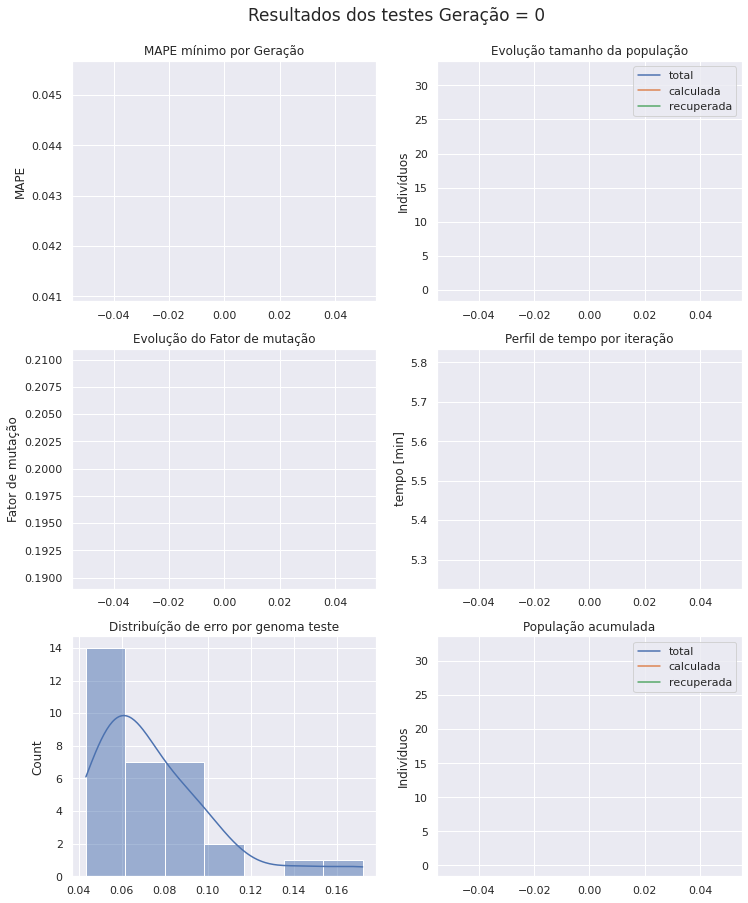

	 Min Erro Atual 0.04330 x 1.00000 Min Erro Anterior
	 parado a 0 epocas
-->>epoca 1 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [56 59 24 11 47 41 48 46 30 36 25 42 39]
Projenitores [23  6 35  0 34 19 51 62 58 46 53 44 49]
Projenitores [62 35  2  3 51 20  5 16 26 45 60 41 18]
Projenitores [45 21 56 42  4  7  5 38  2 20  2  9 59]
Projenitores [ 3 44 30 56 17 43  7 51 41 20 21 48 35]
Projenitores [10  9 44 32 29 39 39 38 49  6 47 51 27]
Projenitores [14 39 15  0 38 19 39 34 26 58 29 27  6]
Projenitores [14 51 50 47 19 18 49 48  4 53 10 22 31]
Projenitores [30 29 27 60  9 40  1 12 52 11 58 38  0]
Projenitores [12 40 31 59 52 29 48 27 37 41 32 30 37]
Projenitores [62 45 57 27 24 29 55  4 14 47 23 48 58]
Projenitores [32 37  4 32 18 61 45 57 17 61 15  6 12]
Projenitores [31  7 30 16 48 39 54 55 17 21 11  4  4]
Projenitores [46 62 62 58 17 48  0  2 14 22 26 30 28]
Projenitores [24 24 62 57 26  8 21 49 18  

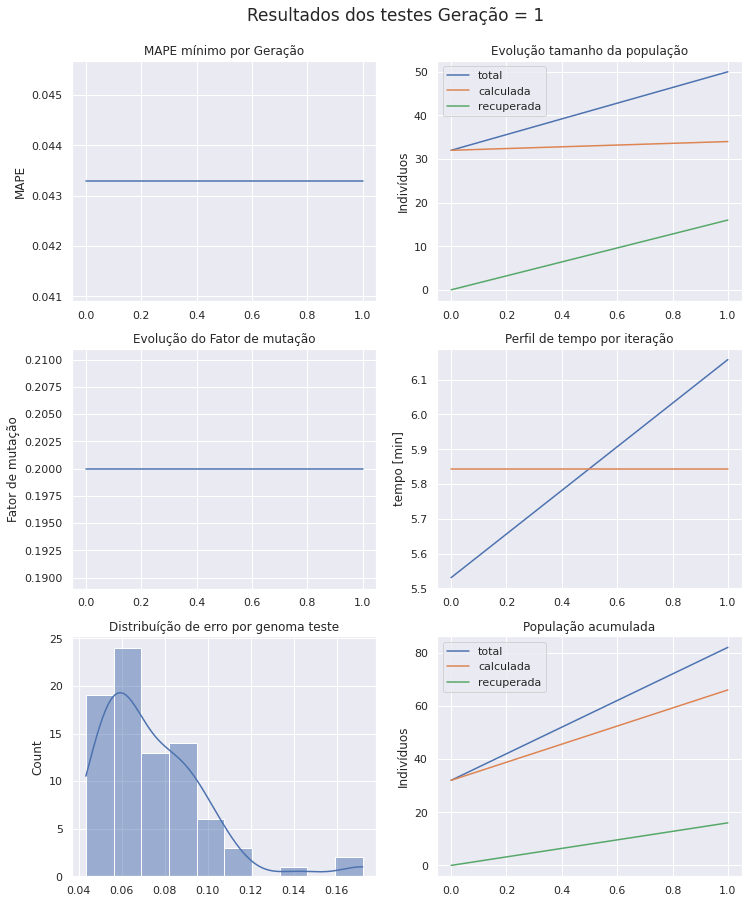

	 Min Erro Atual 0.04330 x 0.04330 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 2 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [12 29 31 59  9 40 48 27 52 41 58 38  0]
Projenitores [56 59 24 11 47 41 48 46 30 36 25 42 39]
Projenitores [62 45 57 27 24 29 55  4 14 47 23 48 58]
Projenitores [42  0 45 33 47 58 35 22 34 16 23 61 36]
Projenitores [32 28 35 50 16 12 26  6 14 23 24 25 51]
Projenitores [21 30 28 18  9 52 40 29 50 40 49  0 55]
Projenitores [30 29 27 60  9 40  1 12 52 11 58 38  0]
Projenitores [14 39 15  0 38 19 39 34 26 58 29 27  6]
Projenitores [20 11 16 51 27 59 26 40 22  5 26 23  3]
Projenitores [10 44 30 56 29 43  7 38 41  6 47 48 27]
Projenitores [ 3 44 30 56 17 43  7 51 41 20 21 48 35]
Projenitores [10  9 44 32 29 39 39 38 49  6 47 51 27]
Projenitores [ 2 28 49 63 17 57  6 36 40 21 19 27 35]
Projenitores [23 59 35  0 34 41 48 46 58 36 25 42 39]
Projenitores [31 62 30 16 17 39  0  2 17 2

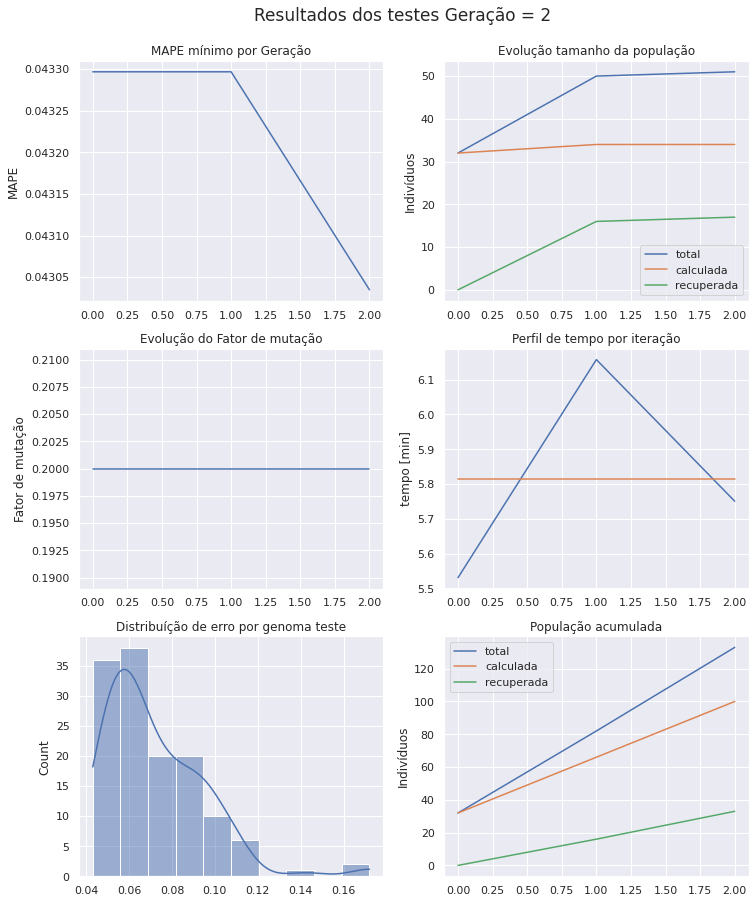

	 Min Erro Atual 0.04303 x 0.04330 Min Erro Anterior
	 parado a 0 epocas
-->>epoca 3 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 2 59 35 63 17 57 48 36 58 21 25 42 39]
Projenitores [12 40 31 59 52 29 48 27 37 41 32 30 37]
Projenitores [ 3 44 30 56 17 43  7 51 41 20 21 48 35]
Projenitores [12 59 31 11 47 40 48 27 52 41 25 38  0]
Projenitores [ 3  9 30 56 29 43  7 51 41  6 21 51 27]
Projenitores [23  6 35  0 34 19 51 62 58 46 53 44 49]
Projenitores [33 23 13 46 59 61 39 58 43 24 30  0 33]
Projenitores [50 63 11 19 62 47 40 59 11  6 33  9 22]
Projenitores [32 43 22 15 50  7 11 61 21 27  7 23 37]
Projenitores [11 55  1 41 18 51 36 52 12 36 41 10 32]
Projenitores [43  4 47 40 11 15 54 11  4 22 61  6 59]
Projenitores [31 47 21 59 31 47 42 36  3 12 42  2 39]
Projenitores [39 44  9 11 18 52 35  0 55  0 36 48 31]
Projenitores [32 28 35 50 16 12 26  6 14 23 24 25 51]
Projenitores [62 45 57 27 24 29 55  4 14 4

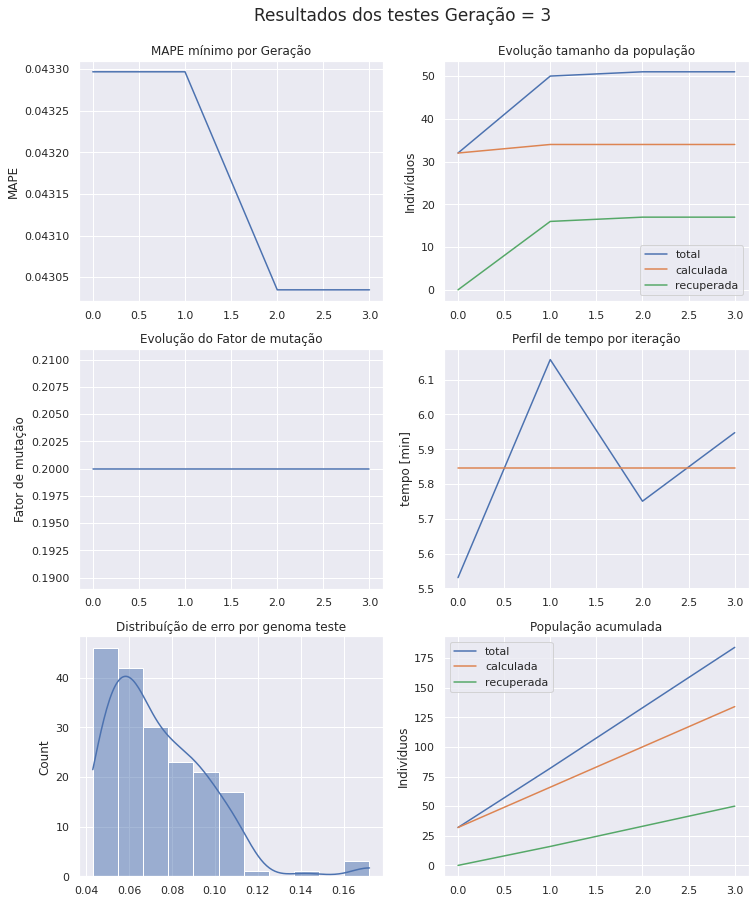

	 Min Erro Atual 0.04303 x 0.04303 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 4 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [32 55 22 15 50  7 36 52 21 36 41 23 37]
Projenitores [32 28 35 50 16 12 26  6 14 23 24 25 51]
Projenitores [39 44  9 11 18 52 35  0 55  0 36 48 31]
Projenitores [39 44  9 50 16 52 26  6 14  0 36 48 51]
Projenitores [ 3 44 30 56 17 43  7 51 41 20 21 48 35]
Projenitores [23  6 35  0 34 19 51 62 58 46 53 44 49]
Projenitores [12 63 34  7  7  7 54 61 10 48 60 35 50]
Projenitores [30 50  1 54 41 21  5  6 41  4 18 10  0]
Projenitores [57 44 24 32 21 36  8 17 22  0  6 49 20]
Projenitores [33 23 13 46 59 61 39 58 43 24 30  0 33]
Projenitores [ 2 59 35 63 17 57 48 36 58 21 25 42 39]
Projenitores [29 10 35 46 25  6 26 12 10 57 58 28 50]
Projenitores [ 4 22 57 40 53 59 44 48 34  3 42 37 58]
Projenitores [62 50 57 27 41 29  5  4 41 47 18 48 58]
Projenitores [ 3 59 31 56 17 40 48 51 52 2

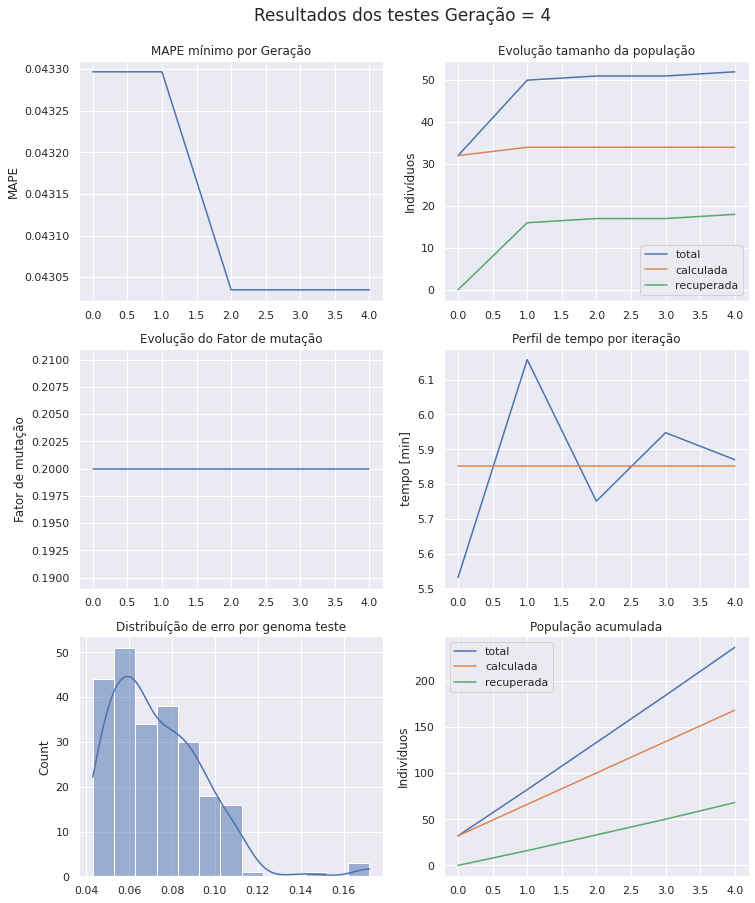

	 Min Erro Atual 0.04303 x 0.04303 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 5 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [46 56 34 48 63 43  5 21 16 41 11 42 32]
Projenitores [32 28 22 15 50 12 26 52 21 36 24 25 37]
Projenitores [12 63 34  7  7  7 54 61 10 48 60 35 50]
Projenitores [ 3 59 43 56 51 40 20 42 42 20 20 23 35]
Projenitores [57 23 24 32 59 61 39 58 22 24  6 49 20]
Projenitores [12 63 34  7  7 21 54  6 41 48 60 35 50]
Projenitores [42 28  7 49 15  0 18 39 44 48  0 44  9]
Projenitores [33 45 40 52 27 14 45 41 42 32 34 31 48]
Projenitores [40 36  5 28 43 29 49 61 46 42 52 48 31]
Projenitores [ 4 22 57 40 53 59 44 48 34  3 42 37 58]
Projenitores [32 60 43 33  8 52 30 33 15 22 56 53 34]
Projenitores [34 59 42 46 52 49 29 38 42 17  5 15 49]
Projenitores [62 50 57 27 53 29  5  4 34  3 18 48 58]
Projenitores [29 59 35 63 17 57 26 12 58 57 58 28 50]
Projenitores [43 59 18 63 28 16  5 35 13 3

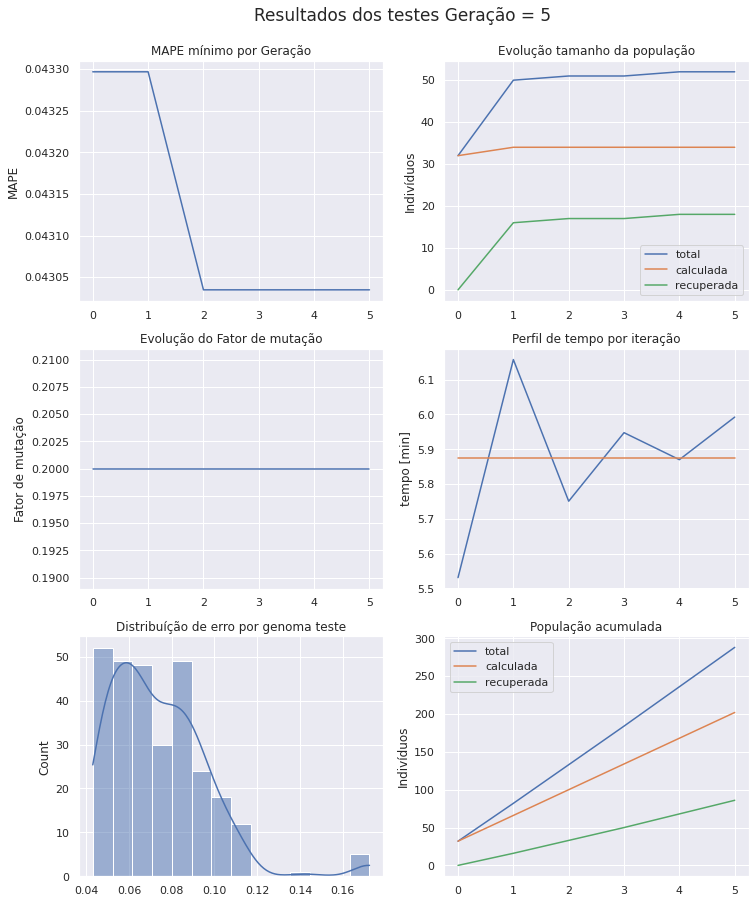

	 Min Erro Atual 0.04303 x 0.04303 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 6 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [29 50 57 27 53 57 26 12 58  3 58 48 50]
Projenitores [34 60 43 33 52 49 30 33 42 17  5 15 49]
Projenitores [42 38 10 26 62 45 33  2 59 57 38 32 63]
Projenitores [32 59 42 46  8 52 29 38 15 22 56 53 34]
Projenitores [ 3  9 30 56 29 43  7 51 41  6 21 51 27]
Projenitores [32 60 43 33  8 52 30 33 15 22 56 53 34]
Projenitores [12 63 34  7  7  7 54 61 10 48 60 35 50]
Projenitores [40 22  5 28 43 29 44 48 34 42 42 48 58]
Projenitores [14 39 15  0 38 19 39 34 26 58 29 27  6]
Projenitores [45  8 37  9 21 36 50 39 40 39 19 59 26]
Projenitores [21 42 49 63 19 61 28 51 33  8 43 22 24]
Projenitores [61  6 43 57 21 49 21 41 36 41 63 40 19]
Projenitores [42 28  7 49 15  0 18 39 44 48  0 44  9]
Projenitores [46 56 34 48 50 12 26 21 21 41 11 42 37]
Projenitores [32 28 22 15 63 43  5 52 16 3

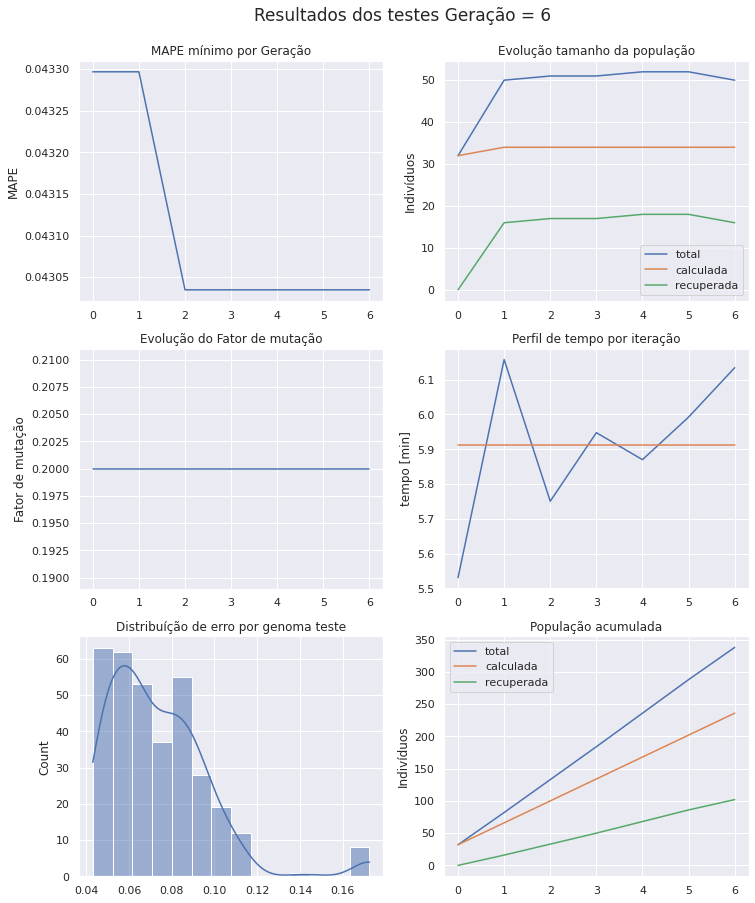

	 Min Erro Atual 0.04303 x 0.04303 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 7 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [42 38 10 26 62 45 33  2 59 57 38 32 63]
Projenitores [ 3 59 22 56 63 40 20 42 16 36 24 23 35]
Projenitores [42 28  7 49 15  0 18 39 44 48  0 44  9]
Projenitores [ 3 15 28 16  9 46 23 22 49 39 15 27 57]
Projenitores [10 34 23 38  7 41 52 28 11 51  0 37 32]
Projenitores [21  6 49 57 21 49 28 51 33 41 63 22 19]
Projenitores [34 50 43 27 53 49 26 12 58 17 58 15 50]
Projenitores [45  8 37  9 21 36 50 39 40 39 19 59 26]
Projenitores [46 56 34 48 50 12 26 21 21 41 11 42 37]
Projenitores [46 42 56 56 49 31 60 35 30  1  3 22 55]
Projenitores [26 53  2 23 15 41 21 54 46 37 26  9 47]
Projenitores [ 1 19 55 31 20 48 44 53 23 19 40 37 14]
Projenitores [32 59 42 46  8 52 29 38 15 22 56 53 34]
Projenitores [ 3  9 30 56 29 43  7 51 41  6 21 51 27]
Projenitores [12 63 34  7  7  7 54 61 10 4

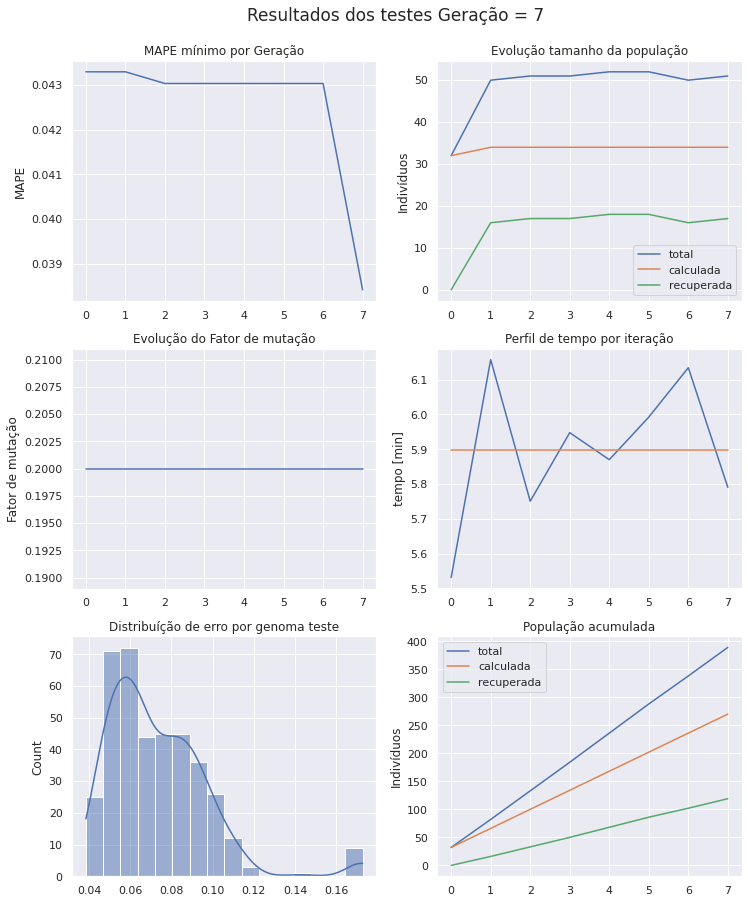

	 Min Erro Atual 0.03841 x 0.04303 Min Erro Anterior
	 parado a 0 epocas
-->>epoca 8 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 3 59 30 46  8 43 29 51 15  6 21 51 27]
Projenitores [ 1 53  2 23 15 41 44 53 46 19 40 37 14]
Projenitores [60 39 11 20  7  1 53 12  0 33 29  4 43]
Projenitores [26 19 55 31 20 48 21 54 23 37 26  9 47]
Projenitores [21 42 49 63 19 61 28 51 33  8 43 22 24]
Projenitores [26 53  2 23 15 41 21 54 46 37 26  9 47]
Projenitores [ 3 59 22 56 63 40 20 42 16 36 24 23 35]
Projenitores [46 42 56 48 49 12 60 35 21  1  3 42 55]
Projenitores [61 42 43 63 19 61 21 41 36  8 43 40 24]
Projenitores [30 46 35  7 31 31 46 41 44 54 22 14 18]
Projenitores [48 36 53 39  9 19 28  4  3 35 45 49 25]
Projenitores [57 61 19  9 32 12 47 12 47 24 19 19 15]
Projenitores [21  6 49 57 21 49 28 51 33 41 63 22 19]
Projenitores [ 3 38 10 56 62 45 33  2 59 57 38 32 35]
Projenitores [42 59 22 26 63 40 20 42 16 3

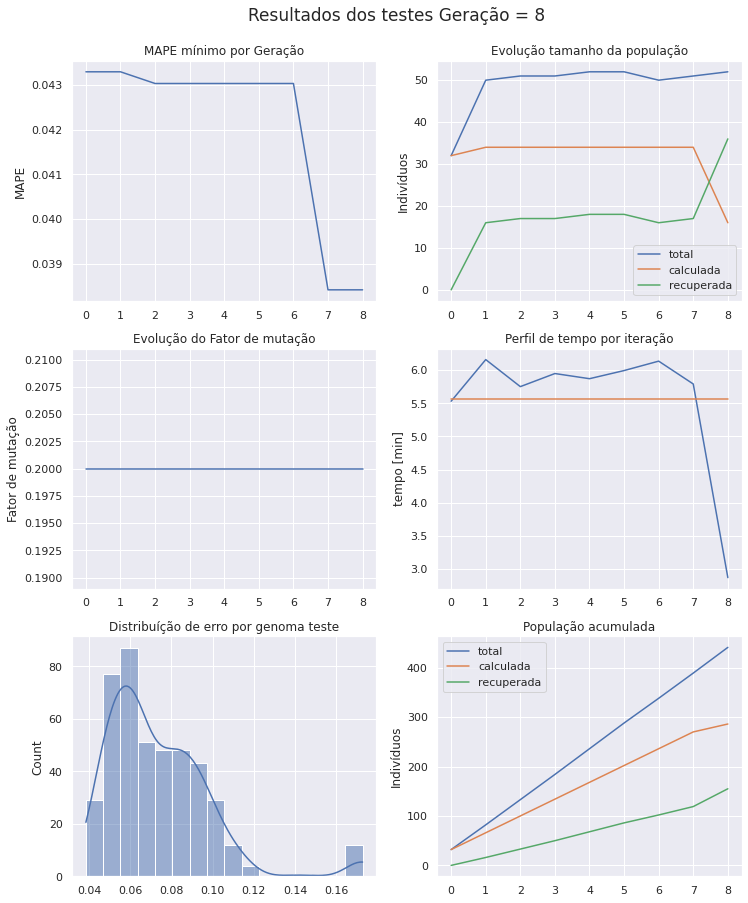

	 Min Erro Atual 0.03841 x 0.03841 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 9 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [21  6 49 57 21 45 33  2 33 41 63 22 35]
Projenitores [19 16 35 22 28 57 12 16 51 12 12 27 52]
Projenitores [42 59  7 26 15 40 20 42 44 48  0 23 63]
Projenitores [ 4 40  3 12 32 50 52 26 46  6 17 57 48]
Projenitores [61 46 43  7 19 31 46 41 44  8 22 14 24]
Projenitores [ 1 19 55 31 20 48 44 53 23 19 40 37 14]
Projenitores [46 59 56 56 49 40 20 42 16  1 24 23 55]
Projenitores [42 59 22 26 63 40 20 42 16 36 24 23 63]
Projenitores [57 61 19  9 32 12 47 12 47 24 19 19 15]
Projenitores [48 61 53  9 32 12 28  4  3 24 19 49 15]
Projenitores [26 19 55 20  7 48 53 12  0 37 29  4 47]
Projenitores [21 53  2 23 19 61 21 51 33 37 43 22 24]
Projenitores [59 37 30  1 31 62  5 51 62 28 44 27 25]
Projenitores [54 54 49 63 59 29 16 37 29  2 28 32 31]
Projenitores [ 3 38 10 56 62 49 28 51 59 5

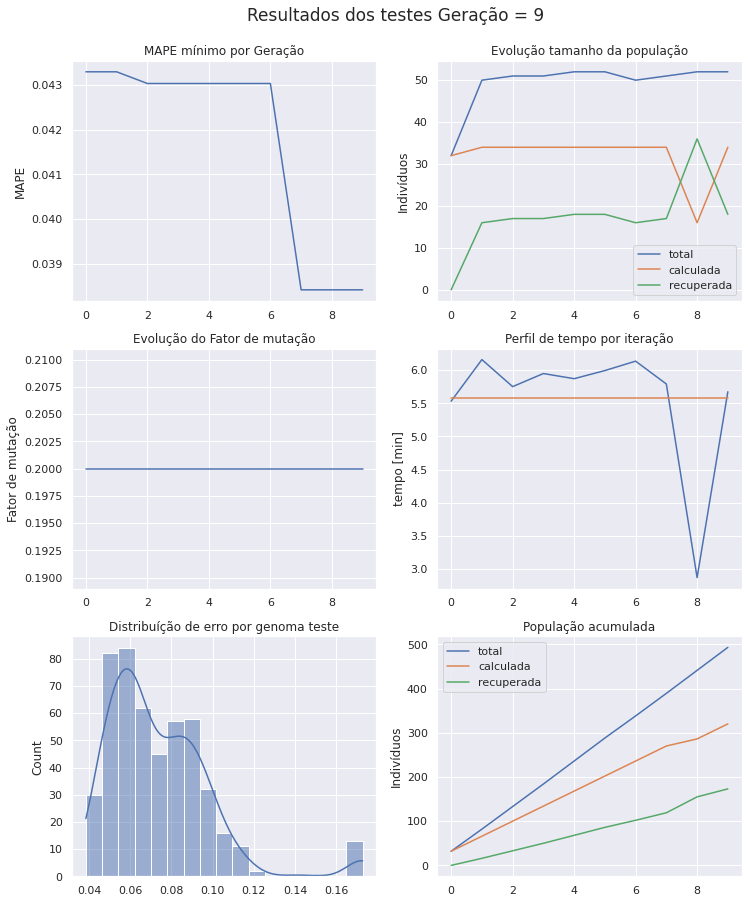

	 Min Erro Atual 0.03841 x 0.03841 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 10 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 3 15 28 16  9 46 23 22 49 39 15 27 57]
Projenitores [57 61 53  9 32 12 28  4  3 24 19 19 15]
Projenitores [19 16 49 22 28 57 33 16 33 12 63 27 35]
Projenitores [ 4 59  3 26 15 40 52 26 46 48  0 23 63]
Projenitores [48 61 19  9 32 12 47 12 47 24 19 49 15]
Projenitores [25 29 43 47 26 21 40 62 55 43 13  3 59]
Projenitores [22 50  4 14 35 37  7 40 14 32 44 15 55]
Projenitores [ 4 40  3 12 32 50 52 26 46  6 17 57 48]
Projenitores [ 9 24 30 39 49 63 42 22 15 44 16 30 19]
Projenitores [21 53  2 23 19 61 21 51 33 37 43 22 24]
Projenitores [61 46 43  7 19 31 46 41 44  8 22 14 24]
Projenitores [21 19  2 20  7 61 53 12 33 37 29 22 24]
Projenitores [12 63 43  7  7 61 21 41 36 48 60 35 50]
Projenitores [32 24 34  6  4 51 28 42 34 22 19 51  5]
Projenitores [48 61 53  9 32 12 28  4  3 

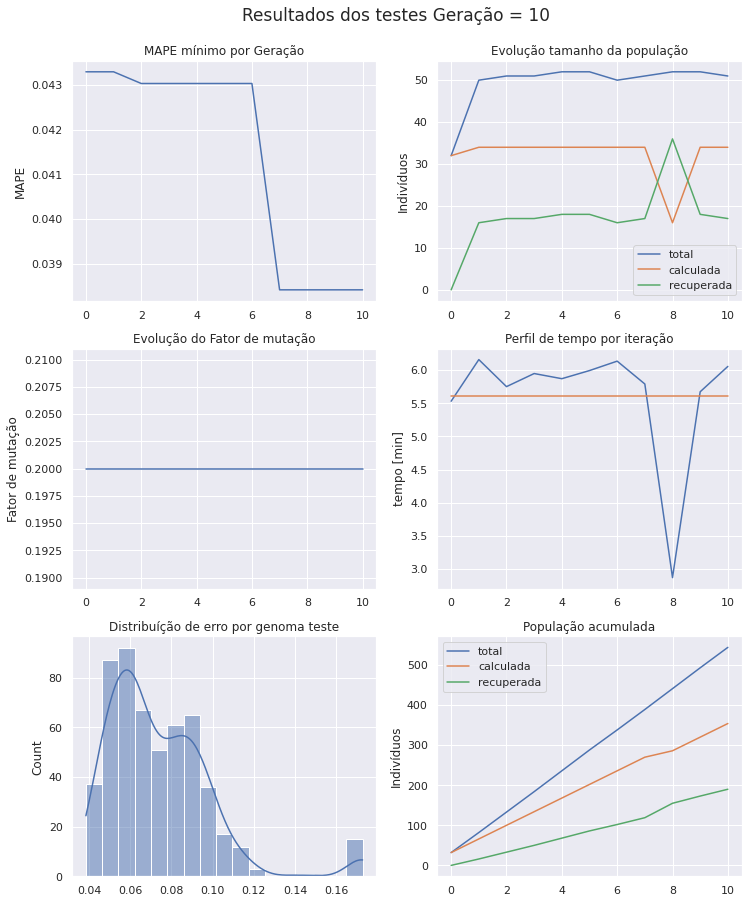

	 Min Erro Atual 0.03841 x 0.03841 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 11 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [48  0 53 10 32 50 28  4 47 33 22 49 21]
Projenitores [61 32  0 56 26 61 56 51 12 40  2 38  5]
Projenitores [ 7 26  8 61 36 32 50 41 43 23 14 58 53]
Projenitores [14 14 25 41 59 12 50 62 31 38 48 51 60]
Projenitores [22 50  4 14 35 37  7 40 14 32 44 15 55]
Projenitores [33  5 21 10 62 47 15 32  8 59 58  5 15]
Projenitores [57 61 28 16 32 46 23 22 49 24 15 19 57]
Projenitores [ 6 51 40 32 39 63 38 17 39  0 10 27 56]
Projenitores [54 22 61 23 36 34 43 39 21 26 34  0 34]
Projenitores [21 19  2 20  7 61 53 12 33 37 29 22 24]
Projenitores [25 29 43 47 26 21 40 62 55 43 19 49 59]
Projenitores [31  3 29 36 22 38 44 14 42 28 35 12 31]
Projenitores [ 4 59  3 26 15 40 52 26 46 48  0 23 63]
Projenitores [ 4 40  3 12 32 50 52 40 46 32 17 57 55]
Projenitores [61 46 43  7 19 31 46 41 44 

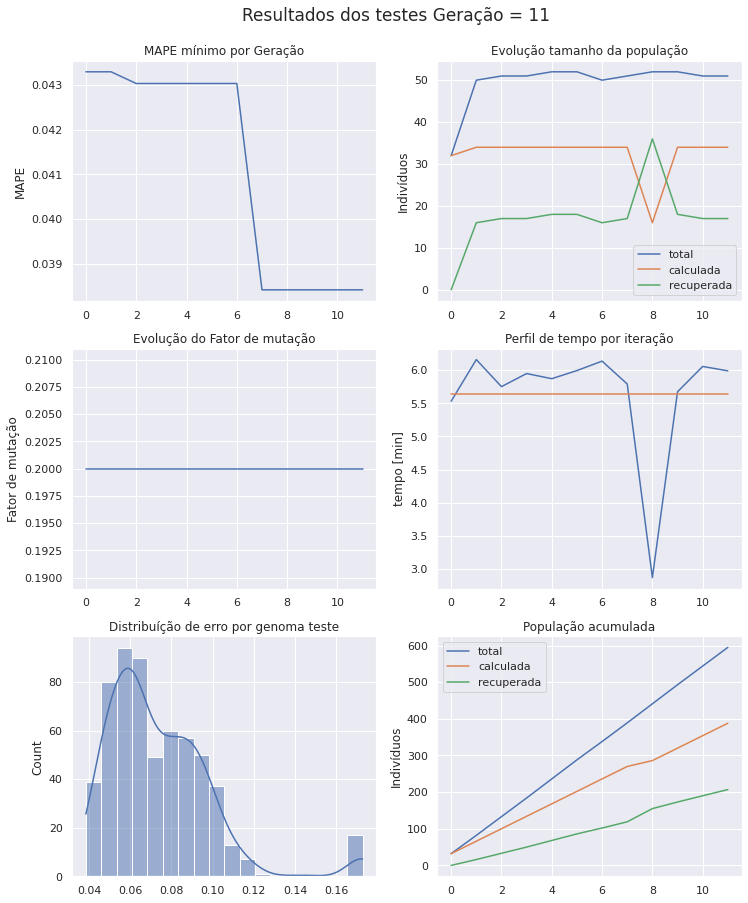

	 Min Erro Atual 0.03841 x 0.03841 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 12 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [21 19  2 20  7 61 53 12 33 37 29 22 24]
Projenitores [ 4 40  3 12 32 50 52 40 46 32 17 57 55]
Projenitores [45 61 62 36 55  3 25 26 37 53 59 37 55]
Projenitores [61 61 43  9 29 31 46 41 44 24 19 57 15]
Projenitores [31  3 29 36 22 38 44 14 42 28 35 12 31]
Projenitores [ 7 26  8 61 36 32 50 41 43 23 14 58 53]
Projenitores [ 4 59  3 26 15 40 52 40 46 32  0 57 55]
Projenitores [50 61  8  9 29 12 48  7  3 24 19 57 15]
Projenitores [33  5 21 10 62 47 15 32  8 59 58  5 15]
Projenitores [25  3 29 47 26 21 44 62 42 28 35 49 59]
Projenitores [42 18  4 19 60 28 27 28 52 53 53 35 51]
Projenitores [55 39 16 58 41 18  6 53 25  1 25 35 27]
Projenitores [31 29 43 36 22 38 40 14 55 43 19 12 31]
Projenitores [ 6 51 40 32 39 63 38 17 39  0 10 27 56]
Projenitores [48  0 53 10 32 50 28  4 47 

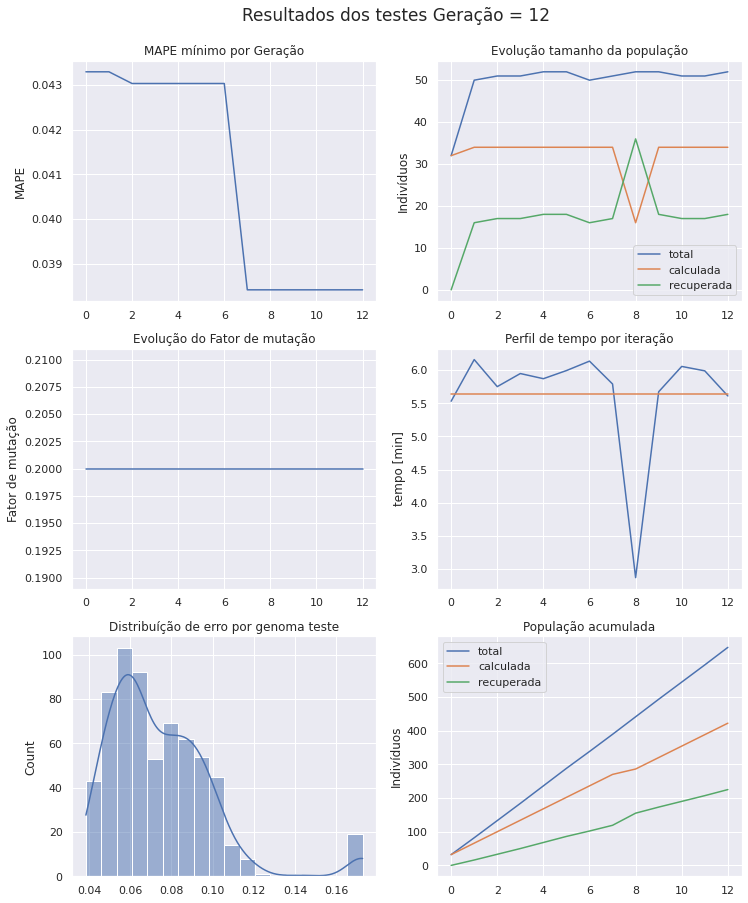

	 Min Erro Atual 0.03841 x 0.03841 Min Erro Anterior
Indice Mutação:  0.30000000000000004
	 parado a 0 epocas
-->>epoca 13 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [50 61  3  9 15 40 52 40  3 32  0 57 55]
Projenitores [33  3 29 47 62 47 15 32  8 28 35  5 15]
Projenitores [25  5 21 10 26 21 44 62 42 59 58 49 59]
Projenitores [48  0 48  4 32 16 28  4 47 50 22 49 25]
Projenitores [45 50 43  9 53 36 50 39 58 39 58 59 26]
Projenitores [31 51 40 36 22 38 38 14 39 43 10 12 56]
Projenitores [62 22 56  8 26 30 50 28 11  0 18 51 36]
Projenitores [31  3 29 36 22 38 44 14 42 28 35 12 31]
Projenitores [54 33 51 32  9 31 61 38 47 62 48 60 14]
Projenitores [59  7 10 36  7 14 11 25 17 48 55 28 56]
Projenitores [42 18  4 19 60 28 27 28 52 53 53 35 51]
Projenitores [ 4 59  3 26 15 40 52 40 46 32  0 57 55]
Projenitores [ 4 59  3 26 15 40 52 26 46 48  0 23 63]
Projenitores [ 6 51 40 32 39 63 38 17 39  0 10 27 56]
Proj

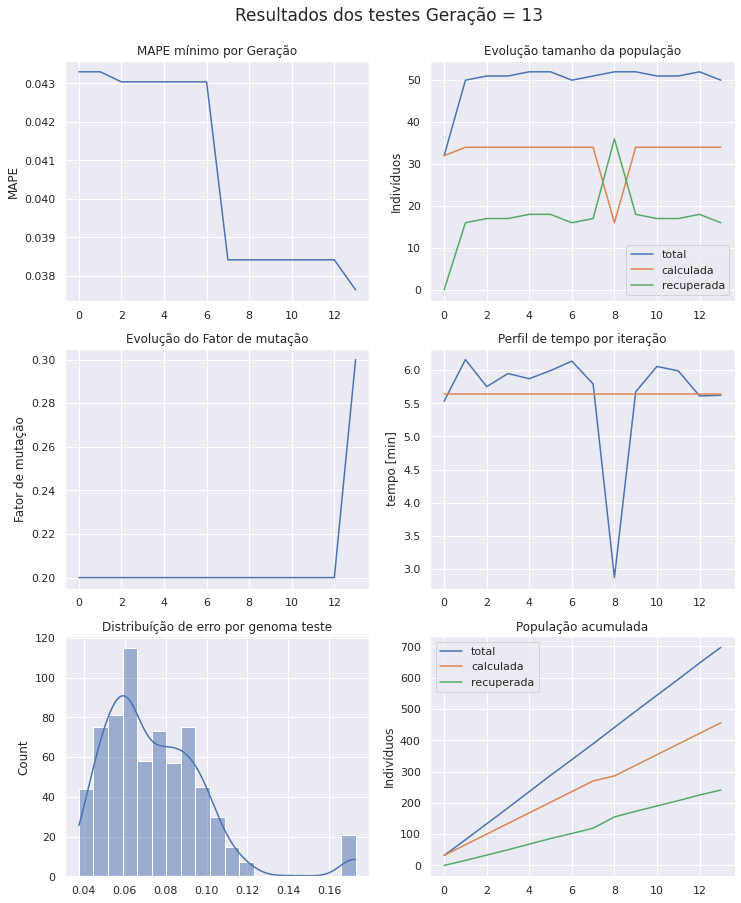

	 Min Erro Atual 0.03763 x 0.03841 Min Erro Anterior
	 parado a 0 epocas
-->>epoca 14 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [54  7 10 32  7 14 61 38 47 62 55 60 56]
Projenitores [42 59  4 19 60 28 27 40 52 32  0 57 51]
Projenitores [42  0 48  4 32 16 47 40 33 37 30 57 25]
Projenitores [ 4 51  3 32 15 40 38 26 46  0  0 23 56]
Projenitores [16 30 28 59 25  7 55  5 55 48 35 45 59]
Projenitores [59  7 10 36  7 14 11 25 17 48 55 28 56]
Projenitores [ 6  5 36 37 12 12 21 37 21 44 12  2  3]
Projenitores [51 63 32 58 37 57 49  5 52 40  0 32 55]
Projenitores [33  3  3  9 62 40 15 40  8 28 35 57 55]
Projenitores [ 6 51 40 32 39 63 38 17 39  0 10 27 56]
Projenitores [ 4 19  2 20 32 61 52 40 33 37 29 57 24]
Projenitores [28 37 12 43 47 56 22 33 60 27 15 31 28]
Projenitores [45 50 43  9 53 36 50 39 58 39 58 59 26]
Projenitores [39 11  6 13 59 18 42  5 55 59 58 36  6]
Projenitores [18 38 23 41 63 37 62 54 14 

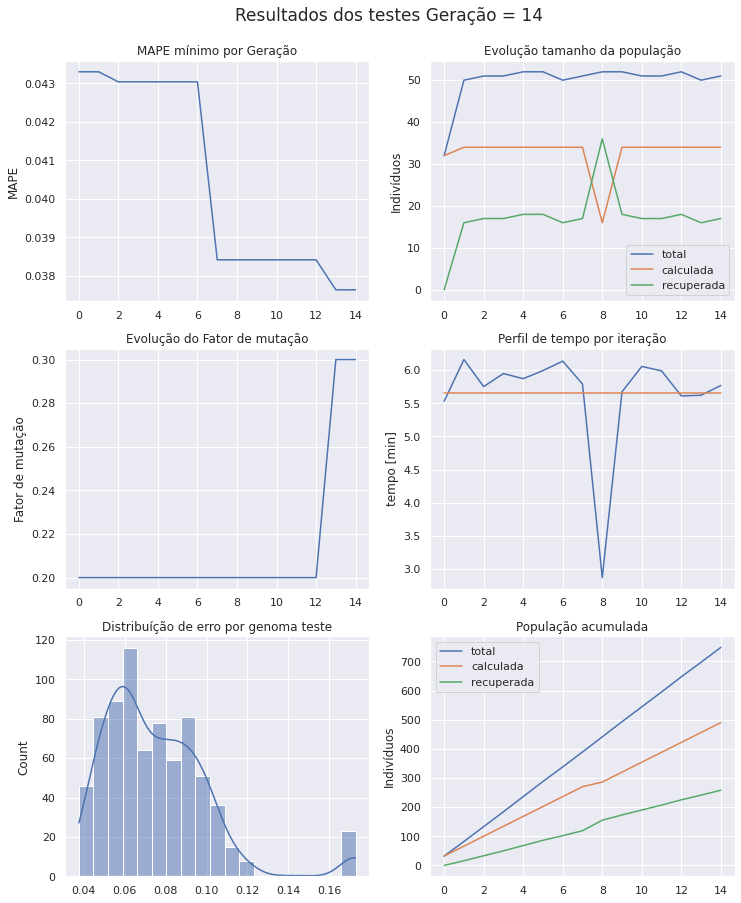

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 15 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [44 43 59 51 55 20 42 42 16 20 23 48  6]
Projenitores [28 37 12 43 47 56 22 33 60 27 15 31 28]
Projenitores [28 37  2 20 47 61 52 40 60 27 15 57 24]
Projenitores [10 35 46 25  6 26 12 10 57 58 28 50 12]
Projenitores [37 11 13  4 20 26 62 45 21 41 42 21 12]
Projenitores [51 63 32 58 37 57 49  5 52 40  0 32 55]
Projenitores [44 24 32 21 36  8 17 22  0  6 49 20  5]
Projenitores [18 38 29 47 63 37 15 32 14 18 58  5 15]
Projenitores [26 11 49 38 20  7 50 49 28 31 50 48 29]
Projenitores [42 51  3  4 32 16 47 40 46 37 30 23 25]
Projenitores [22 27 17 17  9 19 47 28 32 34 24  0 17]
Projenitores [45 50 43  9 53 36 50 39 58 39 58 59 26]
Projenitores [ 4 19 12 43 32 56 22 33 33 37 29 31 28]
Projenitores [16  7 28 36 25 14 55 25 17 48 35 45 56]
Projenitores [22 57 40 53 59 44 48 34  3 

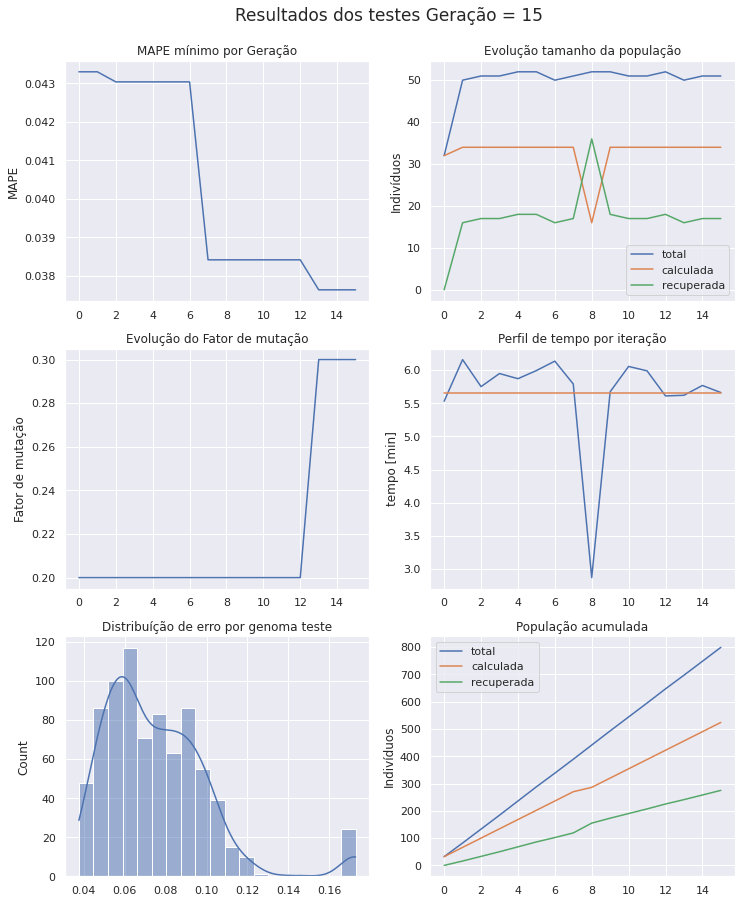

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 16 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [18 24 32 21 36  8 17 22 14  6 49 20 15]
Projenitores [18 38 29 47 63 37 15 32 14 18 58  5 15]
Projenitores [58 46 31 26 61 34 16 40 39 12 24 45 30]
Projenitores [17  8 62 13  0 34 62 28 16 24 27 15 17]
Projenitores [ 4 19 12 43 32 56 22 33 33 37 29 31 28]
Projenitores [46 12 46 53 45 40  0 36  3 25  2 15 39]
Projenitores [41 11 27 38 43 59 45 49 53 28 34 42 49]
Projenitores [23 40 61 35 23 36 61  3 21 23 44 61 49]
Projenitores [35  7 37  3 33 38 34 10 10 32 38 63 35]
Projenitores [16  7 28 36 25 14 55 25 17 48 35 45 56]
Projenitores [22 57 40 53 59 44 48 34  3 42 37 58 29]
Projenitores [44 24 32 21 36  8 17 22  0  6 49 20  5]
Projenitores [30 30  4 29  7 19 46  4 48 33 43 17 25]
Projenitores [26 11 49 38 20  7 50 49 28 31 50 48 29]
Projenitores [22 27 43 17 53 36 50 28 32 

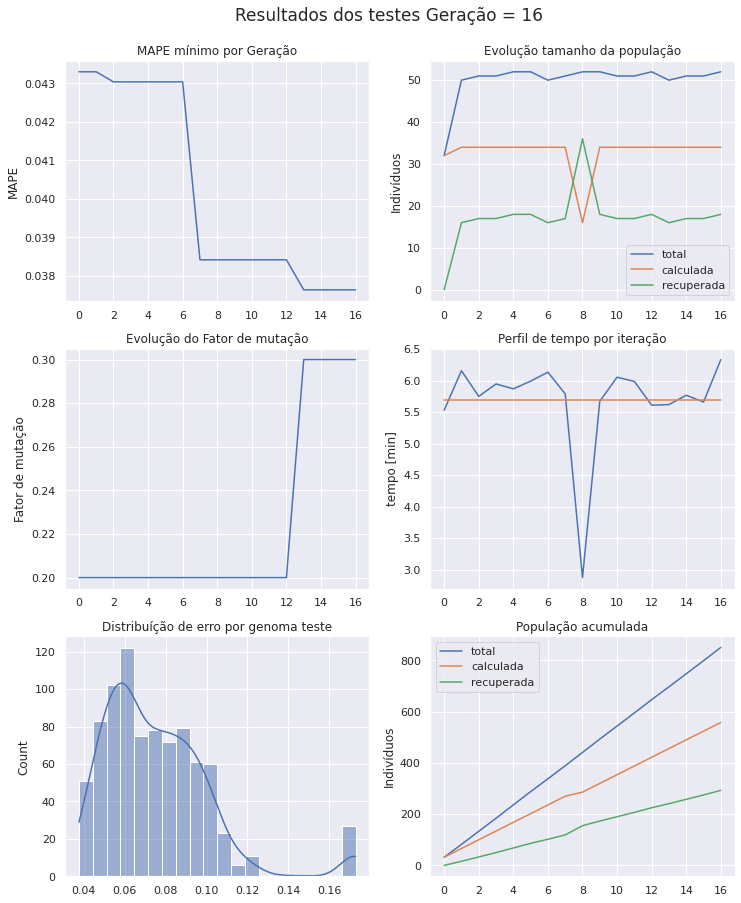

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 17 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [18 38 29 21 36 37 15 32 14 18 58 20 15]
Projenitores [41 11 27 38 23 36 61 49 53 28 34 61 49]
Projenitores [22 49 41 17 32 36 49 45 50 56  7 59 53]
Projenitores [44 24 32 21 36  8 17 22  0  6 49 20  5]
Projenitores [44 57 40 21 36  8 48 34  3  6 37 20  5]
Projenitores [18 24 32 21 36  8 17 22 14  6 49 20 15]
Projenitores [46 19 12 43 45 56 22 36  3 37  2 31 39]
Projenitores [28 63  3 11 11 30 12 27 34 26 17 38 52]
Projenitores [18 24 32 47 63  8 17 22 14  6 49  5 15]
Projenitores [18 38 29 47 63 37 15 32 14 18 58  5 15]
Projenitores [44 34 38 20 19 28 31 27 24  2 24 41 29]
Projenitores [35  7 28 36 33 14 34 25 10 48 38 63 56]
Projenitores [50 59 32 37 36  9 60 26 16 11  1  4 56]
Projenitores [47  3 53 15 11 27 19 46 20 16 14 59 25]
Projenitores [17  8 62 13  0 34 62 28 16 

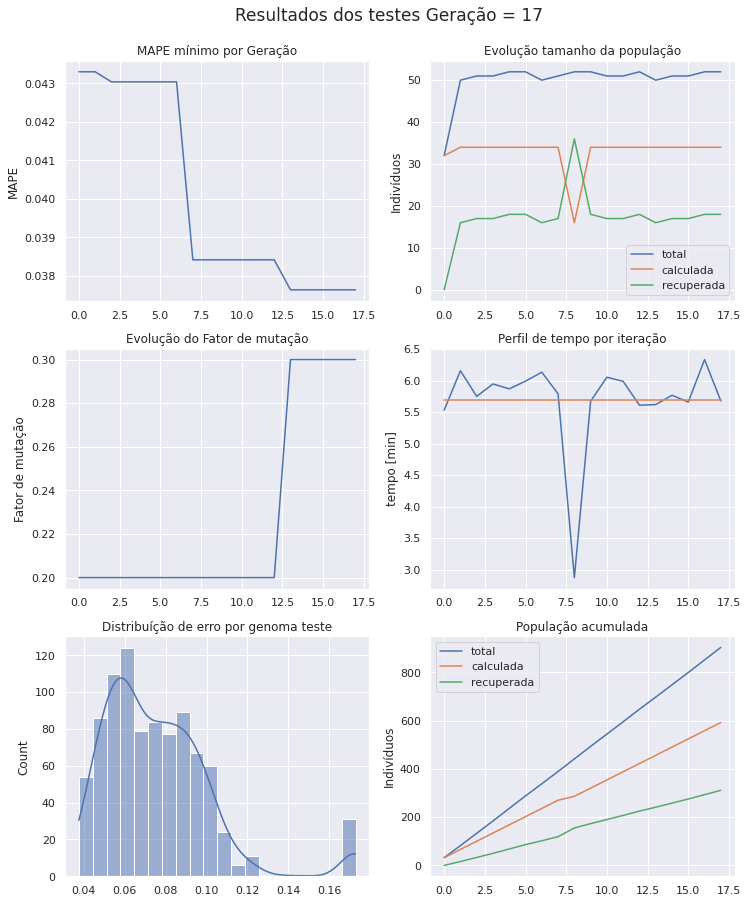

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 18 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [18 57 32 21 36  8 17 34 14  6 37 20  5]
Projenitores [33 53 20 10 32 55 61 56 25 21 39 32 57]
Projenitores [24 59  9  2  7 53  5 36 37 56 21 40 13]
Projenitores [47  3 53 15 11 27 19 46 20 16 14 59 25]
Projenitores [10  8 45 35 32  8 20 13 50 15 41  0 44]
Projenitores [35  7 28 36 33 14 34 25 10 48 38 63 56]
Projenitores [39 34 10 54 32 41 18 22  6  2  7 39 48]
Projenitores [18 38 29 47 63 37 15 32 14 18 58  5 15]
Projenitores [26 30 56 22 18 23 35 34 22 13 22 26 41]
Projenitores [19 25 49 14 13 20 52 43  6 13 56 59 15]
Projenitores [27 49 49 47 13 40 14 45 23 16 28 42 45]
Projenitores [44 34 38 20 33 14 34 25 10 48 24 41 56]
Projenitores [22 49 41 17 32 36 49 45 50 56  7 59 53]
Projenitores [44 57 40 21 36  8 48 34  3  6 37 20  5]
Projenitores [45 50 43  9 53 36 50 39 58 

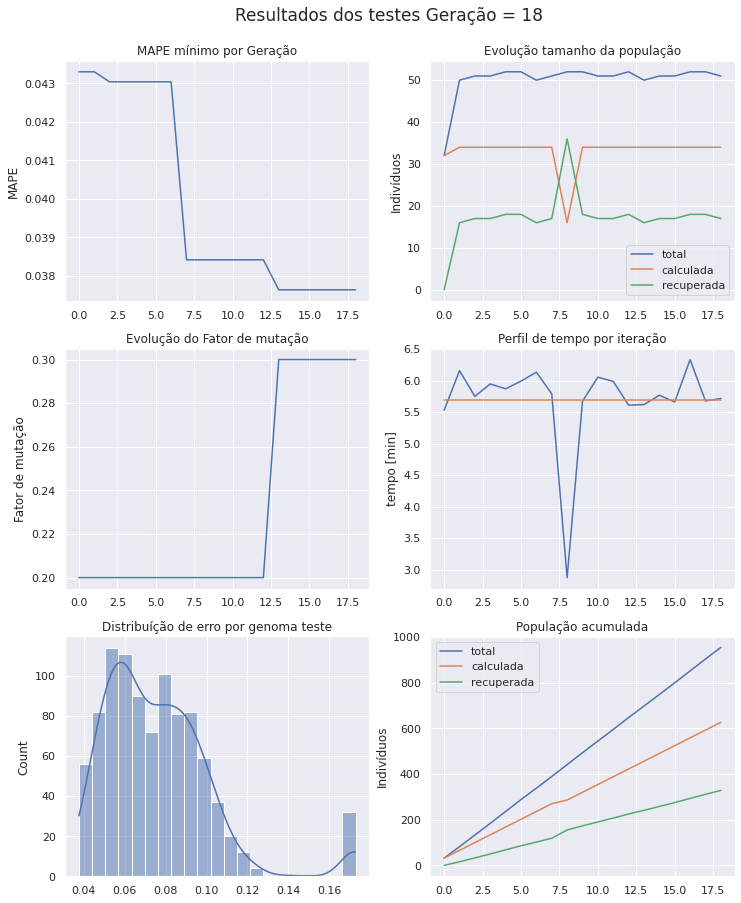

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
Indice Mutação:  0.4
	 parado a 0 epocas
-->>epoca 19 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [44 22 42 51 32 34 15  0 19  9 48  4 15]
Projenitores [44 57 40 21 36  8 48 34  3  6 37 20  5]
Projenitores [48  0 21  4 32 16 28 62 47 59 58 49 59]
Projenitores [49 49 55  1 36 27 48 50 48  6 25 55 22]
Projenitores [19 25 49 14 13 23 35 34 22 13 56 26 15]
Projenitores [39 34 29 47 63 41 18 32  6  2  7  5 15]
Projenitores [51 24 59  8 10 53 17 44  2 31 37 27 20]
Projenitores [35  7 45 35 32  8 20 13 50 15 38 63 44]
Projenitores [57 11 62 29 32 40 34 21 28  3 20 39  8]
Projenitores [35 54 56  0 22 26 33 42 59  6 63 31 31]
Projenitores [18 57 32 21 36  8 17 34 14  6 37 20  5]
Projenitores [52 14 17 39 35 17 28 22 38 41 10 13  6]
Projenitores [27 34 49 47 13 14 14 25 10 16 28 42 45]
Projenitores [ 5 48 22 23 48 31 56  5  9 33 32  9 15]
Projenitores [18 24 

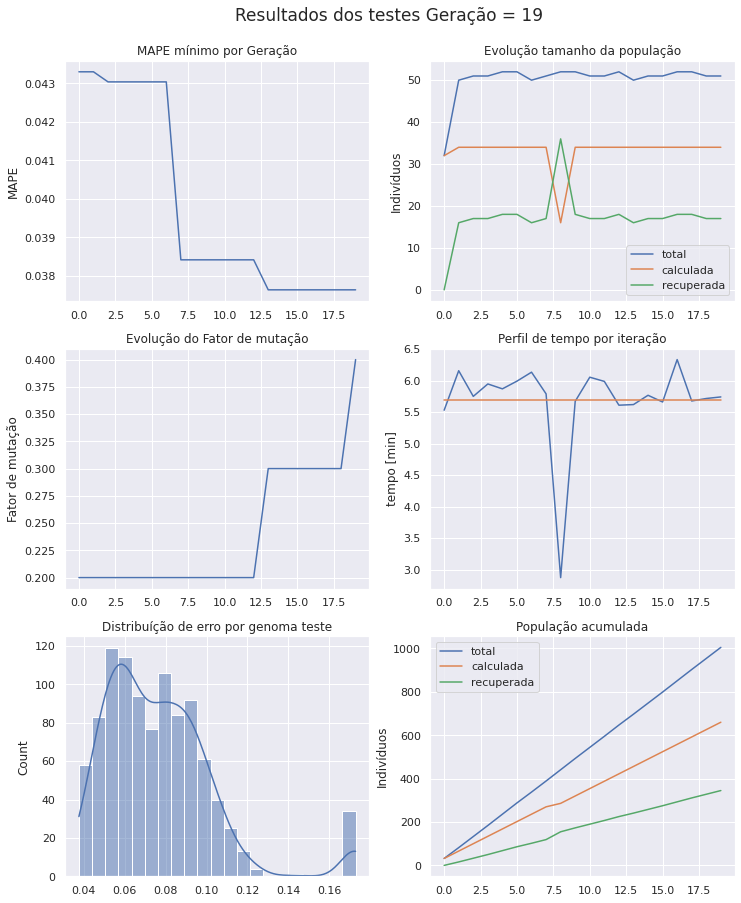

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 20 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [18 24 54 21 25 22 48 33 48 53 13 29 59]
Projenitores [39 49 32 15 22 63  5 47 33 47 47 50 62]
Projenitores [33 43 34 54 15  8 41 54 12  7 45 19 40]
Projenitores [35  7 54 36 33 22 34 33 48 53 13 29 56]
Projenitores [18 57 32 21 36  8 17 34 14  6 37 20  5]
Projenitores [51 24 59  8 10 53 17 44  2 31 37 27 20]
Projenitores [48  9 23 44 45  2 30 46 37 27 39 44  7]
Projenitores [49 49 55  4 36 27 28 62 47  6 25 55 59]
Projenitores [48  0 21  1 32 16 48 50 48 59 58 49 22]
Projenitores [44 57 40 51 36  8 48 34  3  6 48 20  5]
Projenitores [33 30  4 22 56 27 38 55 61 16 32 31  2]
Projenitores [37 28  4 41  6 48 59 23 41 50 56 24 40]
Projenitores [35 11 56  0 22 26 34 42 59  6 20 39 31]
Projenitores [24 26 38 21 51  6 32  6 30 34  7 31 30]
Projenitores [45 24 20 40 58 57 17 49 63 

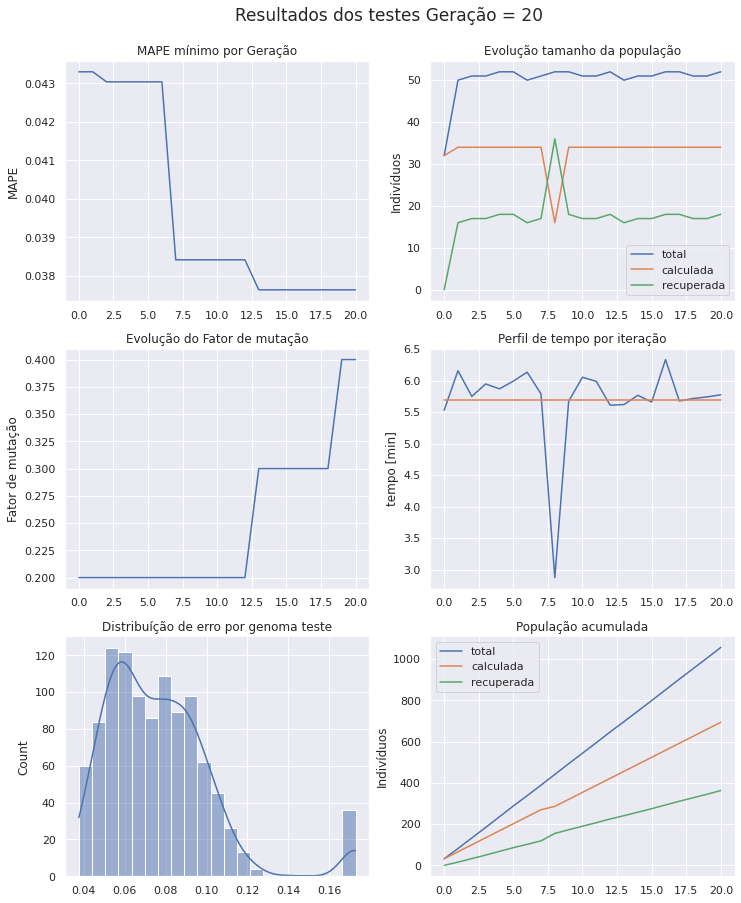

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 21 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [18 57 32 21 36  8 17 34 14  6 37 20  5]
Projenitores [50 21 31  8 43 60 20 10 26 38 27 35 17]
Projenitores [ 0  9 58 26  6 18 44 43 50 39  6 35 20]
Projenitores [ 8 50 25 29 22 13  3 12 51 40 11 46 12]
Projenitores [59 26 18  6  8 42 38 60 43 32 57 47 15]
Projenitores [33  7 54 36 33  8 41 33 48 53 45 19 40]
Projenitores [21  5 37  7  5  9  8 52 54  1 25 44 62]
Projenitores [46 21 49 53  2 23 21 59 40 18 47 50 56]
Projenitores [48  0 21  1 32 16 48 50 48 59 58 49 22]
Projenitores [35 11 56  0 22 26 34 42 59  6 20 39 31]
Projenitores [48  0 21  4 32 16 28 62 47 59 58 49 59]
Projenitores [51 24 59  8 36 53 17 44  2 31 37 27 20]
Projenitores [12 10 28  1 56  1 32 21 53  6 22 21 55]
Projenitores [44 57 40 51 36  8 48 34  3  6 48 20  5]
Projenitores [14 52 39 20 32 38 37 56  7 

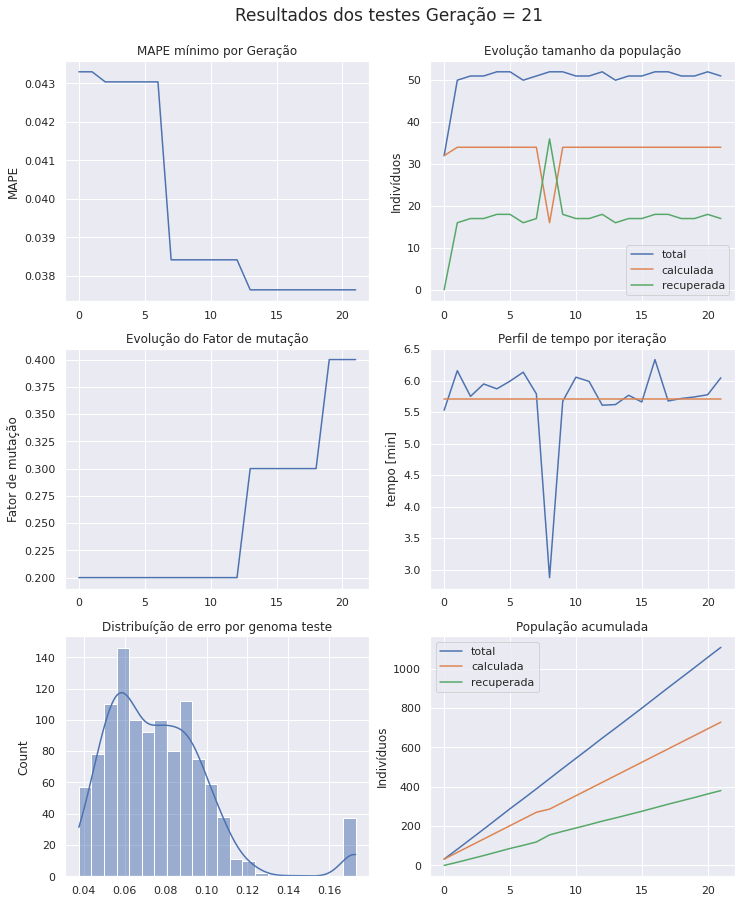

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 22 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [59 26 18  6  8 42 38 60 43 32 57 47 15]
Projenitores [46 63 48 63  5 26 39 22 33 33 55 33 38]
Projenitores [14 52 39 20 32 38 37 56  7 38 29  5 27]
Projenitores [12 10 28  1 56  1 32 21 53  6 22 21 55]
Projenitores [ 8 50 25 29 22 13  3 12 51 40 11 46 12]
Projenitores [18 57 32  8 36 60 17 34 14 38 37 35 17]
Projenitores [31 58 24  2 27 20 34 35 43 41 62 36 63]
Projenitores [39 44 11 22 38 42 16  9 21 29 62 36 63]
Projenitores [58 40 39 33 21  3 52 31 38  4 21  6  8]
Projenitores [44 56 45 37  9 60  1 44  1 50 25 25 37]
Projenitores [ 9 55 39 20 35 34 37 40  7 38 29  5 51]
Projenitores [35 11 56  0 22 26 34 42 59  6 20 39 31]
Projenitores [51 24 59  8 36 53 17 44  2 31 37 27 20]
Projenitores [50 21 31 21 43  8 20 10 26  6 27 20  5]
Projenitores [46  5 49 53  5  9 21 52 54 

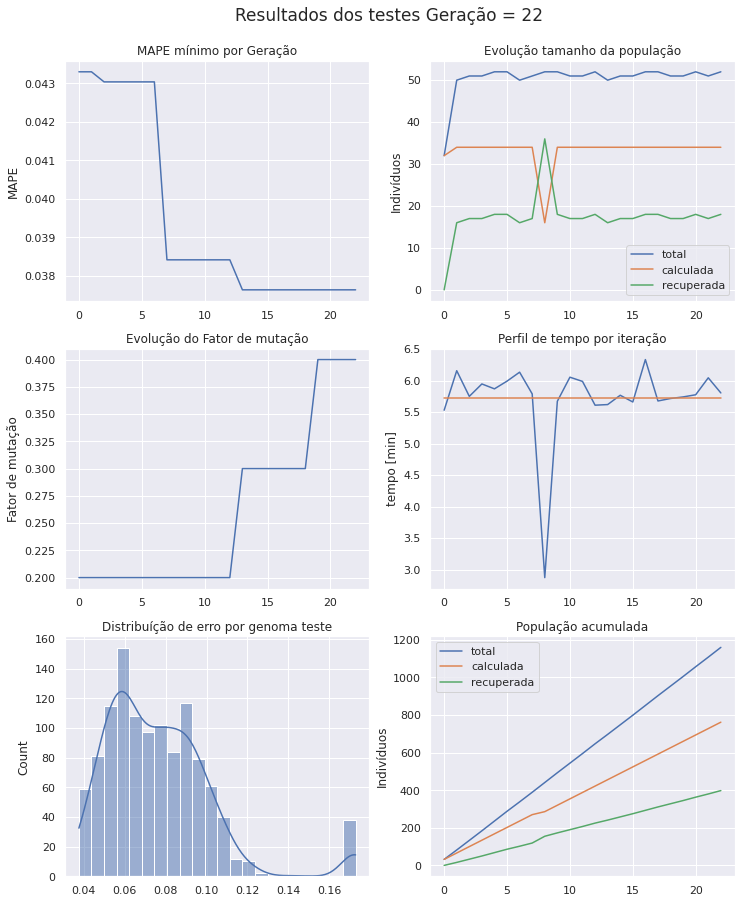

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 23 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [63 22 38 29 50 23 50 53 33  5 19 46 55]
Projenitores [46 26 48  6  8 42 38 22 33 32 55 33 38]
Projenitores [31 58 24  2 27 20 34 35 43 41 62 36 63]
Projenitores [46  5 49 53  5  9 32 34 53 18 47 21 56]
Projenitores [44 40 39 37 21  3  1 44 38  4 21 25  8]
Projenitores [31 58 11  2 27 20 34 35 43 29 62 36 63]
Projenitores [63 63 26  4 30 23 29 53 32 27  2 12  4]
Projenitores [30 43 15 14  5  1 15 22 51 18 19 28 17]
Projenitores [45 27 47 39 17 50 17 21 56 32 24 38 53]
Projenitores [51 24 59  8 36 53 17 44  2 31 37 27 20]
Projenitores [ 7 13 18 18 26 35 16 51 55 47 56 49  6]
Projenitores [15  4 33 28 20 17 26 43  4 27 19 50 24]
Projenitores [50 21 59 21 36 53 20 44 26  6 27 27 20]
Projenitores [35 11 39  0 35 26 37 40  7 38 20 39 31]
Projenitores [20 26 40  8 24  8 15 12 62 

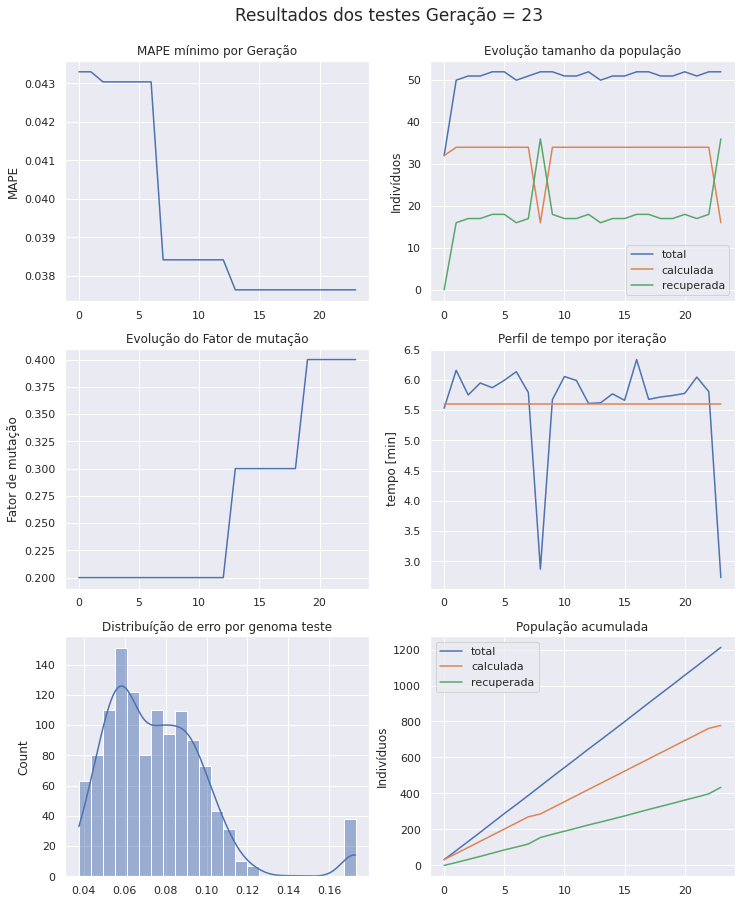

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
Indice Mutação:  0.5
	 parado a 0 epocas
-->>epoca 24 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [17 32 53  8  0  8 13 47 62 47  0 27 14]
Projenitores [20 26 40  8 24  8 15 12 62 47 19 41 14]
Projenitores [ 7 13 18 18 26 35 16 51 55 47 56 49  6]
Projenitores [46  5 49 53  5  9 32 34 53 18 47 21 56]
Projenitores [45 50 43  9 53 36 50 39 58 39 58 59 26]
Projenitores [50 21 59 21 36 53 20 44 26  6 27 27 20]
Projenitores [61  6 43 57 21 49 21 41 36 41 63 40 19]
Projenitores [36 40 38 19 56  8 60 14 53 49 51 51 27]
Projenitores [50 11 39  0 35 53 20 44 26 38 27 39 20]
Projenitores [63 63 26  4 30 23 29 53 32 27  2 12  4]
Projenitores [15 13 18 18 20 17 16 51  4 27 19 50 24]
Projenitores [ 4 54 60 34 58 12 59 63 15 47 52 39 62]
Projenitores [36 15 21 18 22 29 14  0  5 23 33 38  7]
Projenitores [31 58 49 53  5 20 34 35 43 18 47 21 56]
Projenitores [46 26 

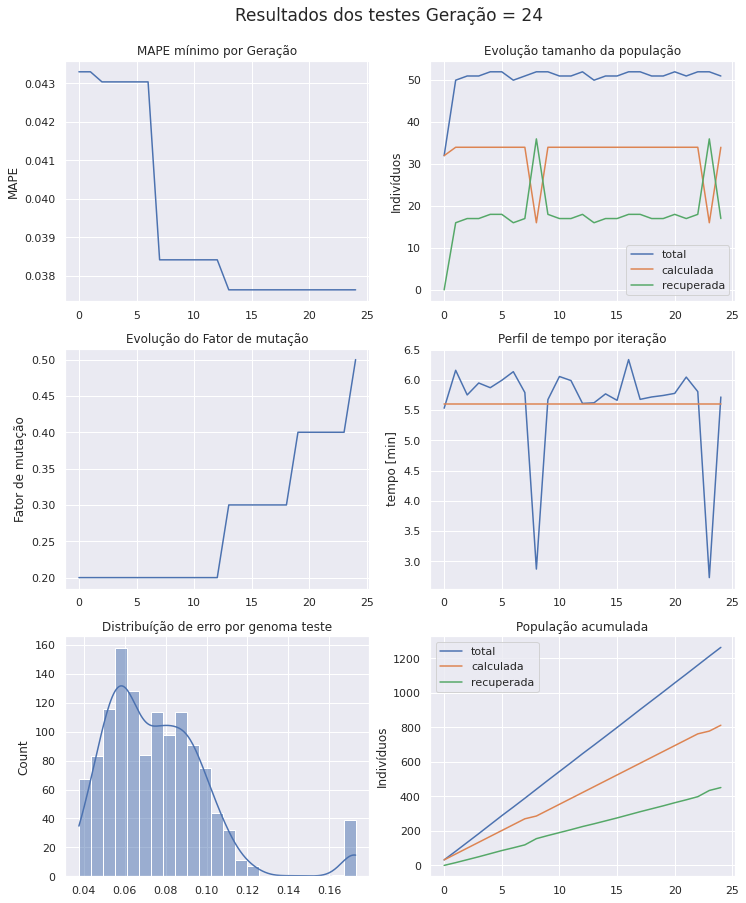

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 25 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [17 32 53  8  0  8 15 47 62 47 19 27 14]
Projenitores [50 21 59 21 36 53 20 44 26  6 27 27 20]
Projenitores [22 56  8 26 30 50 28 11  0 18 51 36 12]
Projenitores [25 63  4 29 43 45  7  6 49 22 19 25 33]
Projenitores [31 58 21 18 22 20 14 35  5 18 33 21 56]
Projenitores [15 52 30 30 18  4 34 25 46  6 55 26 32]
Projenitores [15 13 18 18 20 17 16 51  4 27 19 50 24]
Projenitores [31 58 49 53  5 20 34 35 43 18 47 21 56]
Projenitores [50 50 43 21 36 53 50 39 26  6 27 27 20]
Projenitores [27 52 28 51 25  5 32 55  3 20 50 63 51]
Projenitores [50 11 39  0 35 53 20 44 26 38 27 39 20]
Projenitores [50 11 39  4 30 23 29 53 26 38  2 12  4]
Projenitores [20 26 40  8 24  8 13 12 62 47  0 41 14]
Projenitores [36 40 38 19 56  8 60 14 53 49 51 51 27]
Projenitores [28 33 34 47 36  7  2 12 31 

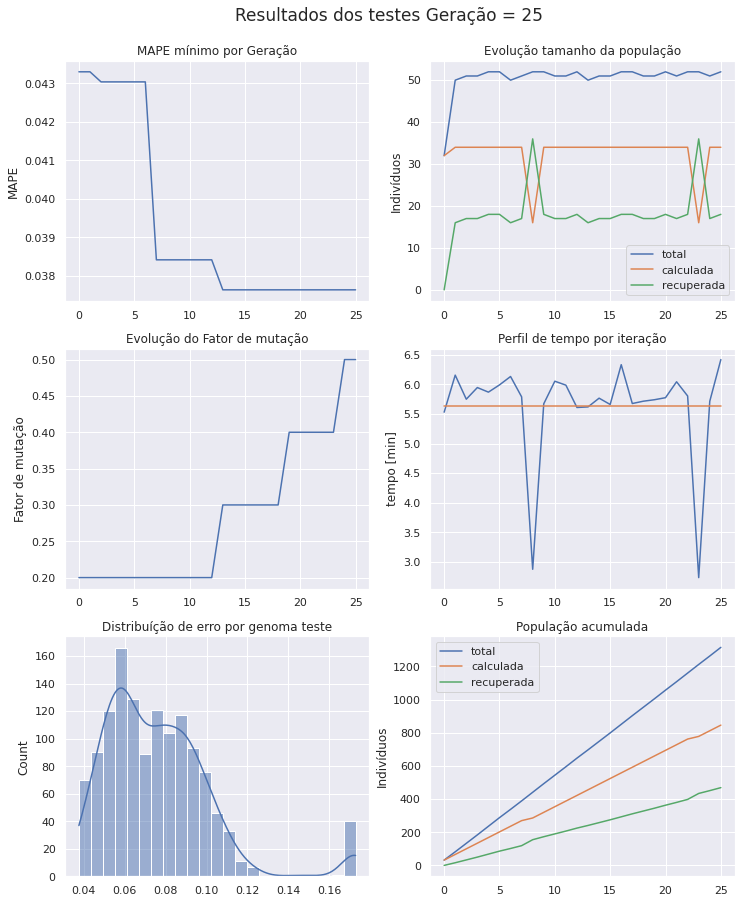

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 26 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [48 33 15 47 16 56 37 49 18 46 23 47 50]
Projenitores [17 32 53  8  0  8 15 47 26  6 19 27 14]
Projenitores [15 13 18 18 20 17 16 51  4 27 19 50 24]
Projenitores [46 33 48 14  8  7 15 12 31 50 19 25 39]
Projenitores [50 52 43 51 36  5 50 39  3 20 50 27 51]
Projenitores [15 58 18 53  5 20 34 51 43 18 47 50 24]
Projenitores [50  4 58 13 53 28 19 26 18  0 48 51 20]
Projenitores [ 8 46  8  2 57 46 15 54 31 55 22 41 56]
Projenitores [54 31 46 16 52 22 37 60 36 21 56 49 32]
Projenitores [20 26 40  8 24  8 13 12 62 47  0 41 14]
Projenitores [56 44 59 48 60 40  3 41 42 10  7 59 38]
Projenitores [ 6 22  4  9 16 41 16 27 53 25  3 38 49]
Projenitores [20 40 38  8 24  8 13 14 62 47 51 51 14]
Projenitores [50 11 39  0 30 53 20 44 26 38 27 12 20]
Projenitores [ 8 32 15 56 35 56  7 59 25 

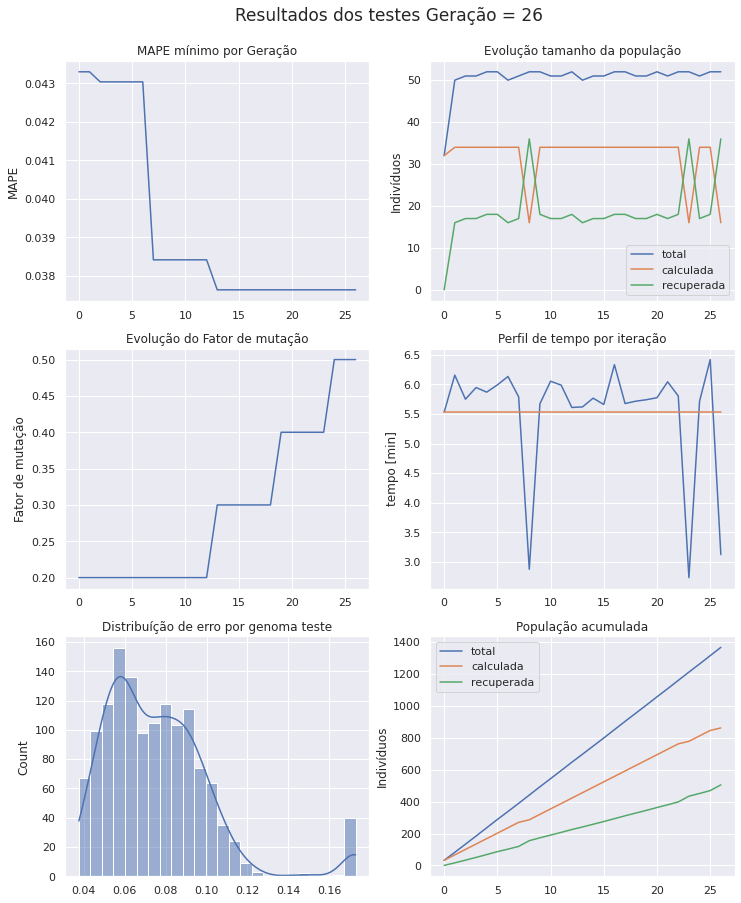

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 27 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [15 58 18 53  5 20 34 51 43 18 47 50 24]
Projenitores [61  6 43 57 21 49 21 41 36 41 63 40 19]
Projenitores [42 38 44 52 50 57  4 62 22 13 62 12 35]
Projenitores [50 11 39  0 30 53 20 44 26 38 27 12 20]
Projenitores [50 52 43 51 36  5 50 39  3 20 50 27 51]
Projenitores [17 32 53  8 16 56 37 47 18  6 19 27 50]
Projenitores [32 49 18 29 15 45 28 20 26 16  6 38 24]
Projenitores [56 44 59 48 60 40  3 41 42 10  7 59 38]
Projenitores [ 8 32 15 52 35 57  7 59 22 13 25 58 35]
Projenitores [ 3 15  2 22  5  5 18 37 29 12 28  6 49]
Projenitores [ 8  4  8 13 53 28 15 26 18 55 48 51 56]
Projenitores [42 38 10 26 62 45 33  2 59 57 38 32 63]
Projenitores [20 40 38  8 24  8 13 14 62 47 51 51 14]
Projenitores [48 33 15 47  0  8 15 49 26 46 23 47 14]
Projenitores [54 26 46 16 52 22 13 12 62 

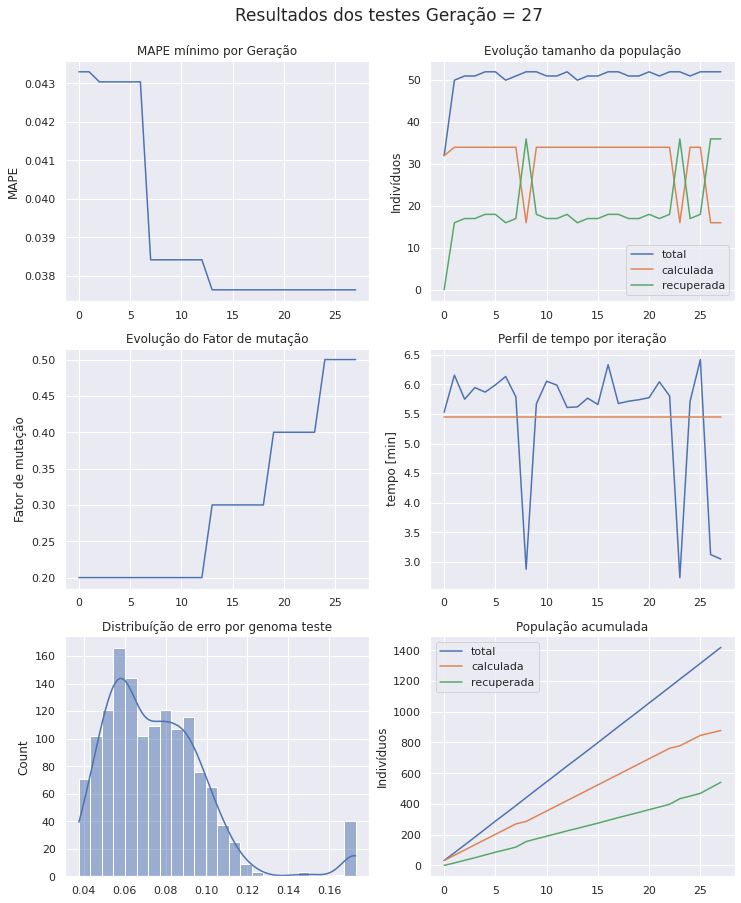

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 28 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [50 40 38  8 24 53 20 44 26 47 27 51 20]
Projenitores [25 29 30 19  2 34 47 46 59  8 41 51 37]
Projenitores [ 6 27  4 23  8 55 33 24 59 50 18  7 32]
Projenitores [54 26 46 16 52 22 20 44 26 21  0 51 14]
Projenitores [ 8  4  8 13 53 28 15 26 18 55 48 51 56]
Projenitores [32 49 18 29 15 45 28 20 26 16  6 38 24]
Projenitores [63 22 38 29 50 23 50 53 33  5 19 46 55]
Projenitores [42 38 10 26 62 45 33  2 59 57 38 32 63]
Projenitores [50 38 39  0 30 53 20 62 22 13 62 12 20]
Projenitores [42 11 44 52 50 57  4 44 26 38 27 12 35]
Projenitores [43 44 29  0 33 62  4 31 38 37 20  2 26]
Projenitores [63 63 26  4 30 23 29 53 32 27  2 12  4]
Projenitores [42 38  8 26 53 45 15 26 18 55 38 32 63]
Projenitores [17 32 53  9  0 63 13 47 47 31  0 27 23]
Projenitores [33  8  6 14 54 30 49 60  3 

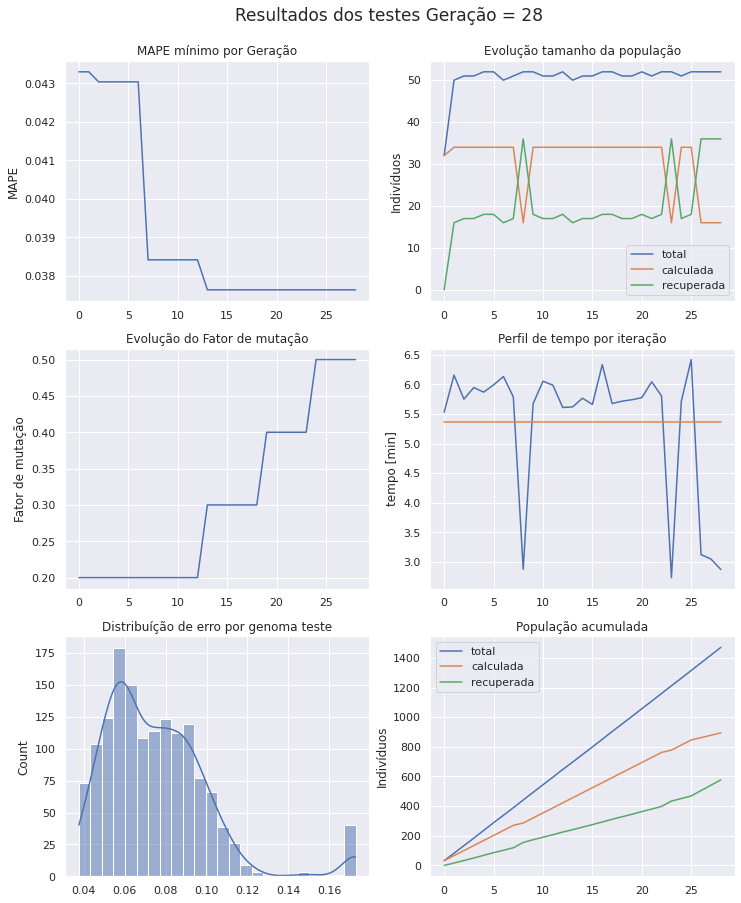

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
Indice Mutação:  0.6
	 parado a 0 epocas
-->>epoca 29 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [32 49 18 29 15 45 28 20 26 16  6 38 24]
Projenitores [ 0  0 29 19  4 38  0 16 24  3 49 48 45]
Projenitores [15 58 18 53  5 20 34 51 43 18 47 50 24]
Projenitores [17 32 53  9  0 63 13 47 47 31  0 27 23]
Projenitores [ 8  4  8 13 53 28 15 26 18 55 48 51 56]
Projenitores [25 29 30  8  2 53 47 46 26 47 27 51 20]
Projenitores [50 21 31  8 43 60 20 10 26 38 27 35 17]
Projenitores [43 44 29  0 33 62  4 31 38 37 20  2 26]
Projenitores [15 58 18 53  5 20 34 60 43 18 47 37 24]
Projenitores [23 56 24 51 53 10 13 31 26 34 50 19 53]
Projenitores [42 22 10 26 62 45 33  2 33 57 38 46 63]
Projenitores [54  8 34 28 36 56 25 54 33  9 15 26 28]
Projenitores [42 38  8 26 53 45 15 26 18 55 38 32 63]
Projenitores [50 40 38 19 24 34 20 44 59  8 41 51 37]
Projenitores [42 38 

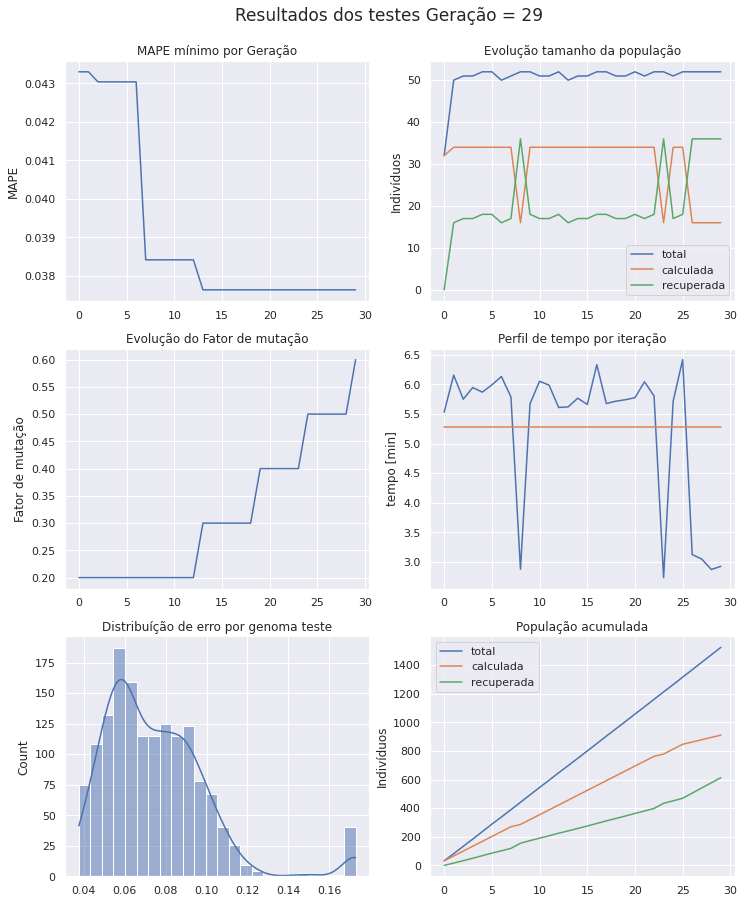

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 30 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [50 21 31  8 43 60 20 10 26 38 27 35 17]
Projenitores [15 58 18 53  5 20 34 60 43 18 47 37 24]
Projenitores [42 38 53  9  0 63 13 47 47 55 38 27 23]
Projenitores [33  8  6 14 54 30 49 60  3  0 53 37 62]
Projenitores [32  0 18 19  4 38  0 20 26  3  6 38 24]
Projenitores [63 63 26  4 30 23 29 53 32 27  2 12  4]
Projenitores [ 8 29 30  8  2 28 47 26 18 47 48 51 56]
Projenitores [15 56 24 53 53 10 34 60 26 34 50 37 53]
Projenitores [ 0 49 29 29 15 45 28 16 24 16 49 48 45]
Projenitores [17 32 53  9  0 63 13 47 47 31  0 27 23]
Projenitores [ 0  0 29 19  4 38  0 16 24  3 49 48 45]
Projenitores [15  4 33 28 20 17 26 43  4 27 19 50 24]
Projenitores [42 22 34 26 36 45 25 54 33  9 38 46 63]
Projenitores [61 30 52 35 31 34 54 19 36 28  4 41 62]
Projenitores [54  8 10 28 62 56 33  2 33 

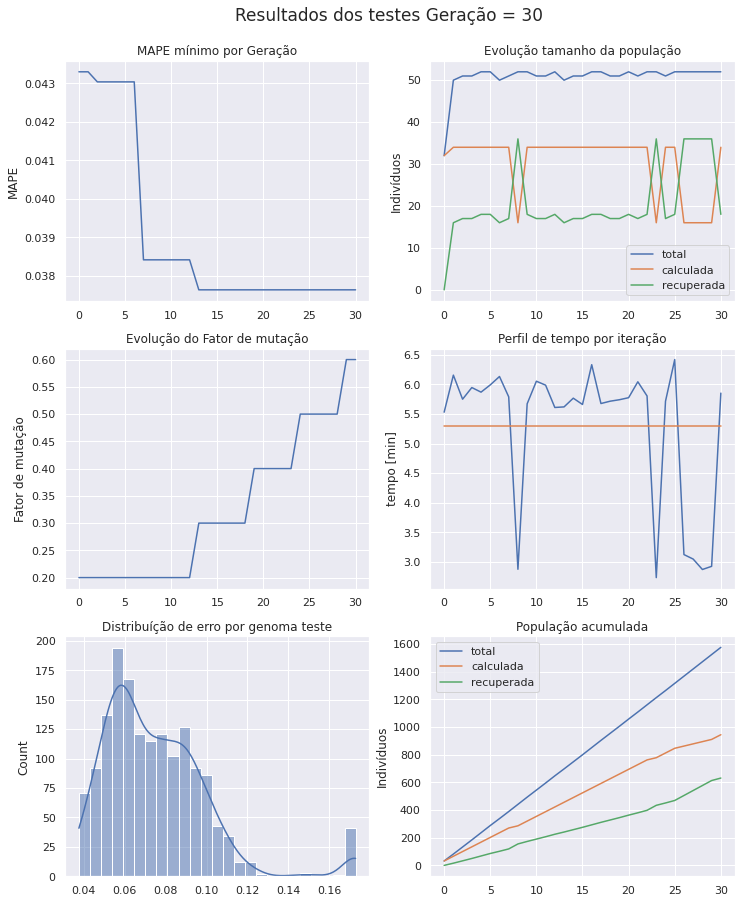

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 31 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [42 22 52 35 31 34 25 19 36  9 38 46 62]
Projenitores [15  0 33 28 20 38  0 43  4 27 49 48 45]
Projenitores [ 4 22 19 21  9 35 56 35 48 11 41 54 18]
Projenitores [ 0  4 29 19  4 17 26 16 24  3 19 50 24]
Projenitores [48  0 21  4 32 16 28 62 47 59 58 49 59]
Projenitores [15  4 33 28 20 17 26 43  4 27 19 50 24]
Projenitores [42 38 53  9  0 63 13 47 47 55 38 27 23]
Projenitores [17 32 29 29 15 63 13 47 24 16 49 48 23]
Projenitores [45 50 43  9 53 36 50 39 58 39 58 59 26]
Projenitores [12  4 30  6 46 56 52 10 30  9  2  1 58]
Projenitores [37  9 40 37 43 43 26  7  8 21  8 28 63]
Projenitores [16 11 39 58 17 39 49 63 33 11 14 42 15]
Projenitores [ 8 29 30  8  2 28 47 26 18 47 48 51 56]
Projenitores [15 21 18 53 43 20 34 60 26 38 47 37 24]
Projenitores [50 58 31  8  5 60 20 10 43 

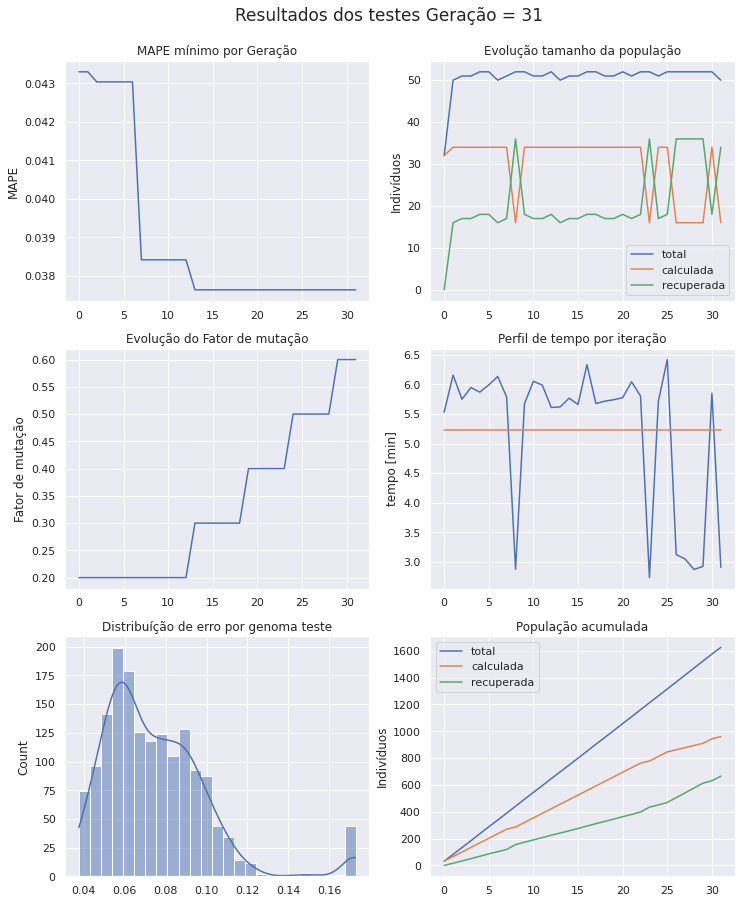

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 32 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [59 37 30  1 31 62  5 51 62 28 44 27 25]
Projenitores [ 8 29 30  8  2 28 47 26 18 47 48 51 56]
Projenitores [50 58 31  8  5 60 20 10 43 18 27 35 17]
Projenitores [15  4 33 28 20 17 26 43  4 27 19 50 24]
Projenitores [ 0  4 29 21  9 17 56 35 48  3 41 54 24]
Projenitores [37  9 40 37 43 43 26  7  8 21  8 28 63]
Projenitores [25 54  8 62 44 29 53 43 20 52 54  2 18]
Projenitores [48  4 33 28 32 16 26 62 47 27 58 49 59]
Projenitores [42 13 60 41 49 37  4 19 57 15 62 37 30]
Projenitores [15  0 33 28 20 38  0 43  4 27 49 48 45]
Projenitores [10 34 23 38  7 41 52 28 11 51  0 37 32]
Projenitores [15 22 33 35 31 38 25 19 36 27 38 48 62]
Projenitores [ 5 40  5  7  8 62 42 31 41 57 16 19  7]
Projenitores [ 1 19 55 31 20 48 44 53 23 19 40 37 14]
Projenitores [40 38 63 15 26 51 62  7 27 

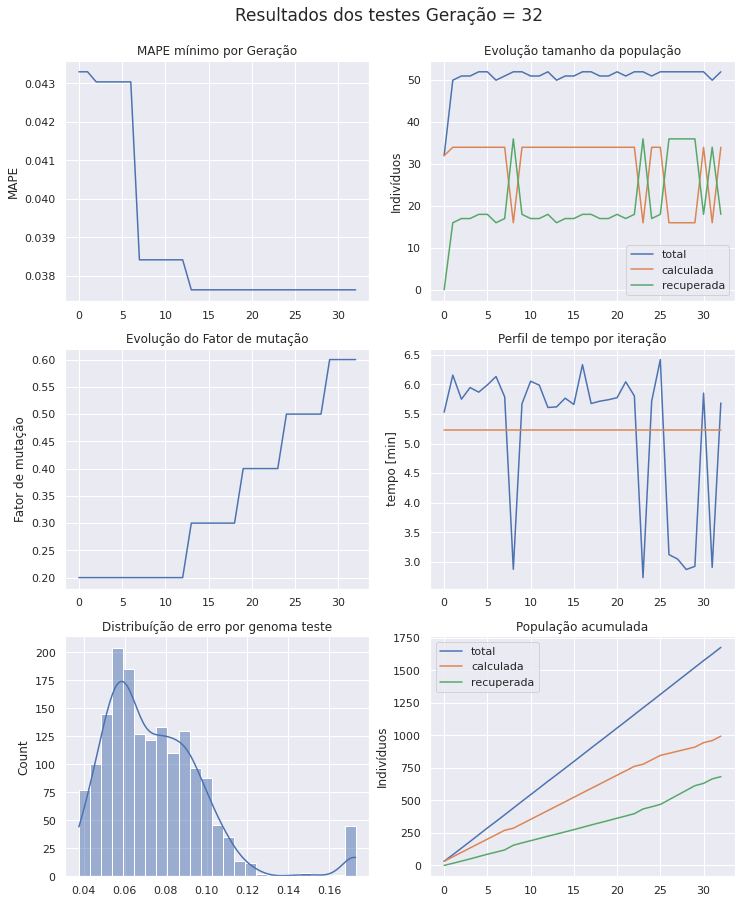

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 33 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 0  9 29 37 43 43 26  7  8  3  8 28 24]
Projenitores [19 31  8 26  2 56 52  3 44 61 14 32  4]
Projenitores [21 46 25 16 60 57 54 53 61 19 33 40 32]
Projenitores [ 1 19 55 31 20 48 44 53 23 19 40 37 14]
Projenitores [61  5 23 43 32 11 40 20 10 54 43 37 61]
Projenitores [15 22 33 35 31 38 25 19 36 27 38 48 62]
Projenitores [51 16 32 54  0 38 19 46 42 51 56 60 40]
Projenitores [15  0 33 28 20 38  0 43  4 27 49 48 45]
Projenitores [19 16 35 22 28 57 12 16 51 12 12 27 52]
Projenitores [ 3 45 11 60 22 13 57 45 11 56 16 24 29]
Projenitores [36 59 59 57  6 21 31 13  7 56 24 15 41]
Projenitores [10 22 33 35 31 38 52 19 36 27 38 37 62]
Projenitores [15  4 33 28 20 17 26 43  4 27 19 50 24]
Projenitores [ 0  4 29 21  9 17 56 35 48  3 41 54 24]
Projenitores [45 50 43  9 53 36 50 39 58 

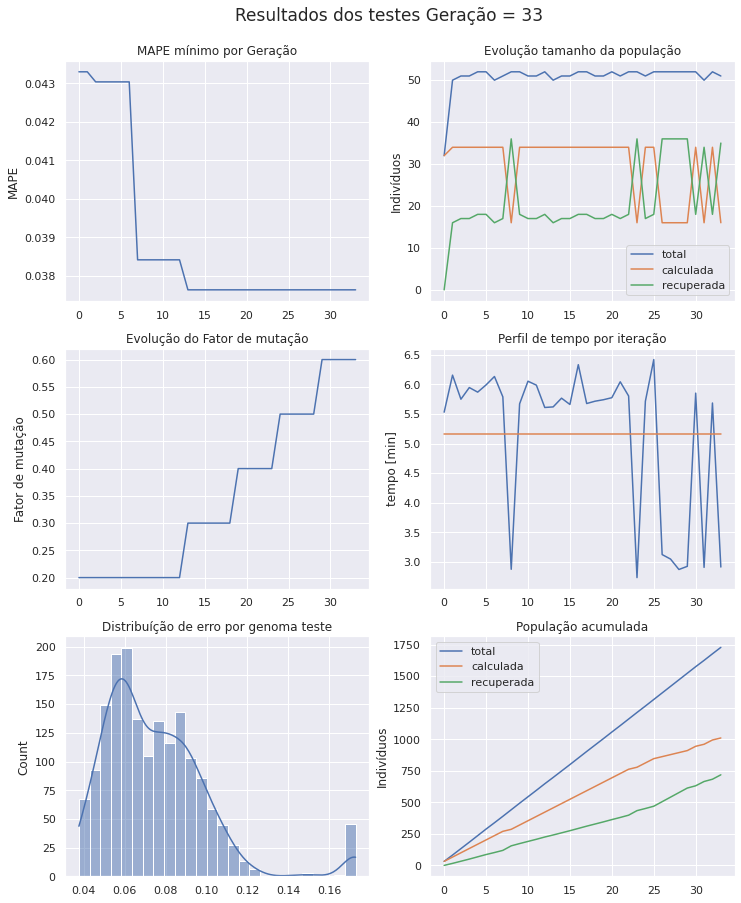

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
Indice Mutação:  0.7
	 parado a 0 epocas
-->>epoca 34 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [45 50 43  9 53 36 50 39 58 39 58 59 26]
Projenitores [19 16 35 22 28 13 57 45 11 12 12 24 52]
Projenitores [ 0 31  8 26 43 43 52  3  8 61  8 32 24]
Projenitores [21 19 55 31 60 48 44 53 61 19 33 40 32]
Projenitores [15  0 32 54  0 38  0 46  4 27 49 60 40]
Projenitores [ 6 26 56 56  0 21 37  7 15 60 59 41 27]
Projenitores [37 50 26 60 62  1 60 18 15 17 50  4  0]
Projenitores [21 46 25 16 60 57 54 53 61 19 33 40 32]
Projenitores [44 22 42 51 32 34 15  0 19  9 48  4 15]
Projenitores [36 59 59 57  6 21 31 13  7 56 24 15 41]
Projenitores [ 1 19 55 31 20 48 44 53 23 19 40 37 14]
Projenitores [10 59 33 35 31 21 52 13  7 27 38 37 62]
Projenitores [62 16 62  8 61  1 17 48 35 56 27 40 52]
Projenitores [ 1 58 57 49 57 63 37 22 34 41 53 19 53]
Projenitores [19 16 

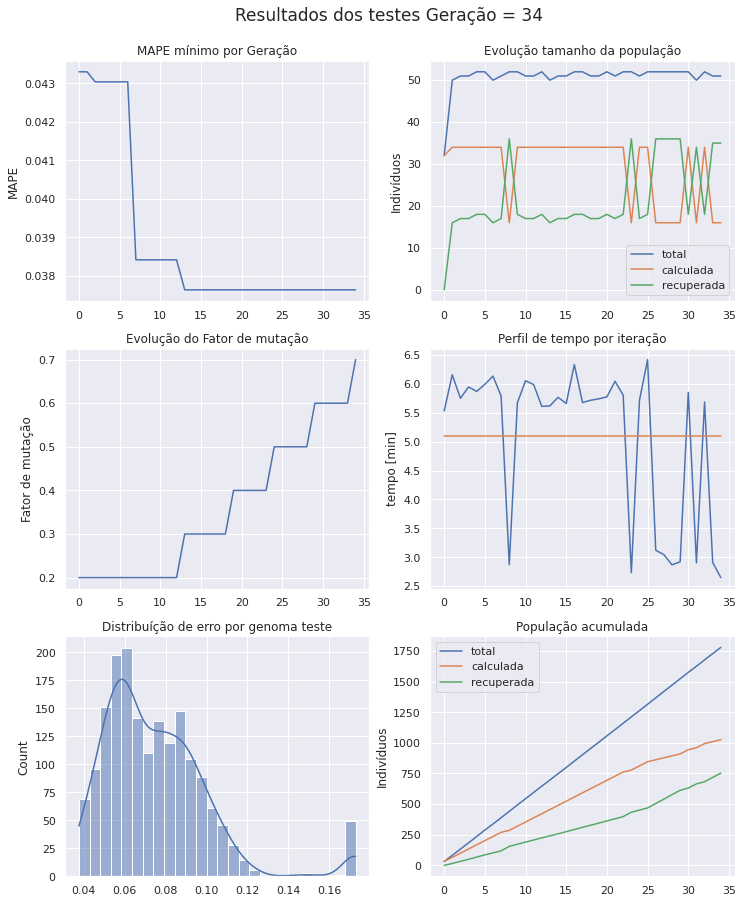

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 35 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 6 58 50 21 27  1 41 44 61 56 52  5 27]
Projenitores [22 36 31 32  0 18 61  1 52 43 25 31  5]
Projenitores [24 49 22 30 29 41 34  6 59 15 25 47 56]
Projenitores [19 16 35 22 28 13 57 45 11 12 12 24 52]
Projenitores [44 22 42 51 32 34 15  0 19  9 48  4 15]
Projenitores [ 6 26 56 56  0 21 37  7 15 60 59 41 27]
Projenitores [19 16 43  9 28 36 50 39 58 12 58 24 26]
Projenitores [35 16 56 22 22 57 33 42 51 12 12 31 52]
Projenitores [35 54 56  0 22 26 33 42 59  6 63 31 31]
Projenitores [44 59 42 51  6 34 31  0  7 56 48  4 41]
Projenitores [ 6 51 40 32 39 63 38 17 39  0 10 27 56]
Projenitores [19 54 35  0 28 26 12 16 59  6 63 27 31]
Projenitores [19 16 35 22 28 57 12 16 51 12 12 27 52]
Projenitores [10 59 33 31 20 48 44 53 23 19 40 37 62]
Projenitores [31  3 29 36 22 38 44 14 42 

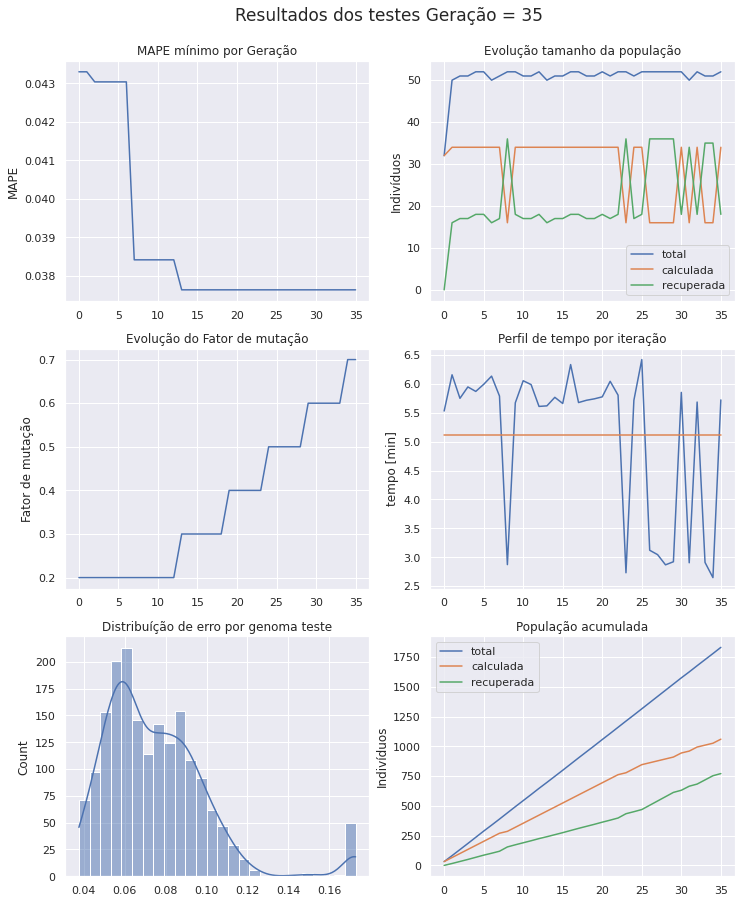

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 36 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [44 22 42 56 32 21 15  7 19  9 59  4 15]
Projenitores [55 58 23 17 48 57 41 53 48 26 63 48 20]
Projenitores [19 54 35  0 28 26 12 16 59  6 63 27 31]
Projenitores [19 51 35 32 39 63 12 17 39  6 63 27 56]
Projenitores [ 6 58 31 32 27 18 61  1 61 43 25 31 27]
Projenitores [10 59 33 35 31 21 52 13  7 27 38 37 62]
Projenitores [24 49 22 30 29 41 34  6 59 15 25 47 56]
Projenitores [35 59 42  0 22 26 31 42 59 56 48 31 31]
Projenitores [43 16 28 29 35 35 39 10 50 16 51  7 20]
Projenitores [35 16 43  9 22 36 33 39 58 12 58 31 52]
Projenitores [10 59 33 31 20 48 44 53 23 19 40 37 62]
Projenitores [ 0 36 56  4 20 21 52  8 58 29 21 32 60]
Projenitores [14 53 16 63 38 20 23 63  6  2 59 45 23]
Projenitores [19 16 33 31 20 57 12 53 51 19 40 37 62]
Projenitores [34 61 56  3 35 21 56 12 52 

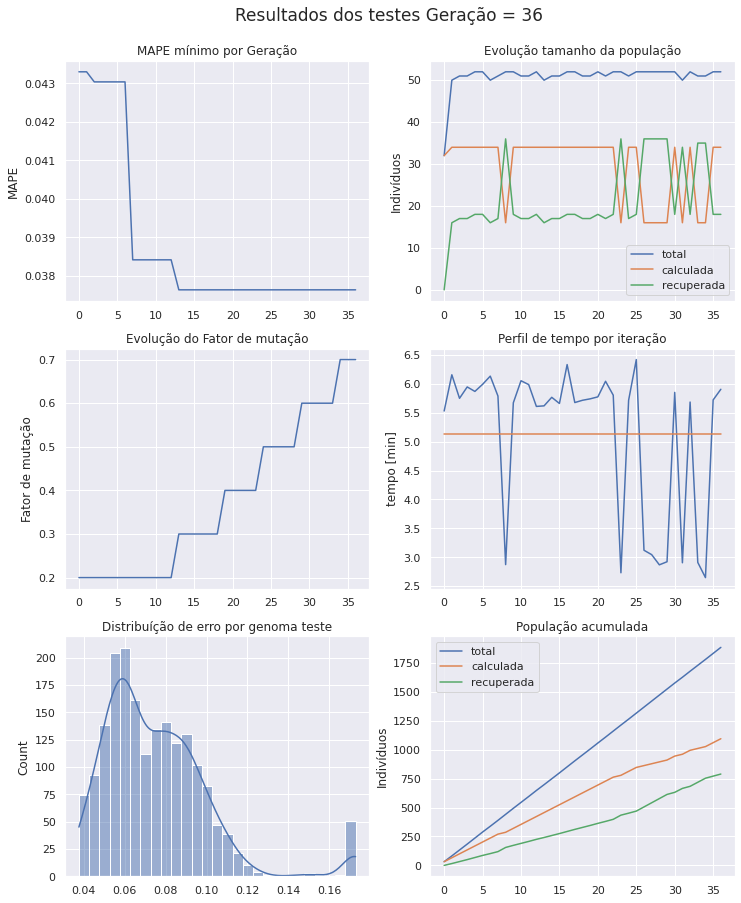

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 37 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [43 16 43 29 22 36 39 10 58 12 51 31 20]
Projenitores [34 61 56  3 35 21 56 12 52 57 37 22 17]
Projenitores [19 16 33 31 20 57 12 53 51 19 40 37 62]
Projenitores [34 16 35  3 35 21 56 12 59 12 12 24 17]
Projenitores [19 51 35 32 39 63 12 17 39  6 63 27 56]
Projenitores [24 49 22 30 29 41 34  6 59 15 25 47 56]
Projenitores [61 36 34 40 43 56 49 18 20 10 43  8 33]
Projenitores [45 50 43  9 53 36 50 39 58 39 58 59 26]
Projenitores [ 0 55 12 10 46  9  2 41 50 59 23 36 18]
Projenitores [35 59 42  0 22 26 31 42 59 56 48 31 31]
Projenitores [55 58 23 17 48 57 41 53 48 26 63 48 20]
Projenitores [58 34 10 14 11  6 51 15 29 33 29 34 60]
Projenitores [56 58 42  9 55  3  4 18 35 10  3 33 29]
Projenitores [19 61 56 22 28 13 34 45 52 57 37 22 52]
Projenitores [19 54 35 32 28 26 12 16 59 

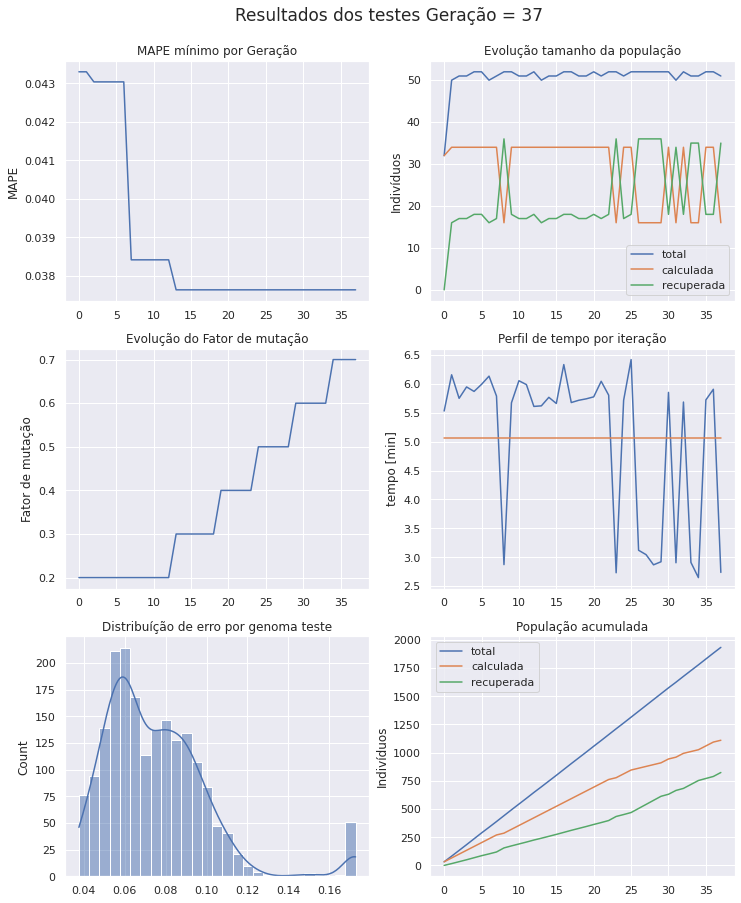

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 38 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [24 49 22 30 29 41 34  6 59 15 25 47 56]
Projenitores [34 16 56  3 35 36 39 12 52 57 51 31 17]
Projenitores [19 54 20 32 30 26  9 14 16  6 54  9 56]
Projenitores [27  6 20 45 30  8  9 14 16 13 54  9 14]
Projenitores [43 59 18 63 28 16  5 35 13 32 53 23 31]
Projenitores [43 61 43 29 22 21 56 10 58 12 37 22 20]
Projenitores [61 36 34 40 43 56 49 18 20 10 43  8 33]
Projenitores [42 28  7 49 15  0 18 39 44 48  0 44  9]
Projenitores [56 58 42  9 28  3  4 18 52 57  3 33 52]
Projenitores [55 55 57 12 12 45 36  7 21 58 41 38 15]
Projenitores [61 59 49 61 30 14 44 43 12 16 49 58 26]
Projenitores [ 0 59 12 10 22 26 31 42 50 56 23 36 18]
Projenitores [19 61 56 22 28 13 34 45 52 57 37 22 52]
Projenitores [19 51 35 32 39 63 12 17 39  6 63 27 56]
Projenitores [54 12 41 40 28 54 47 37  9 

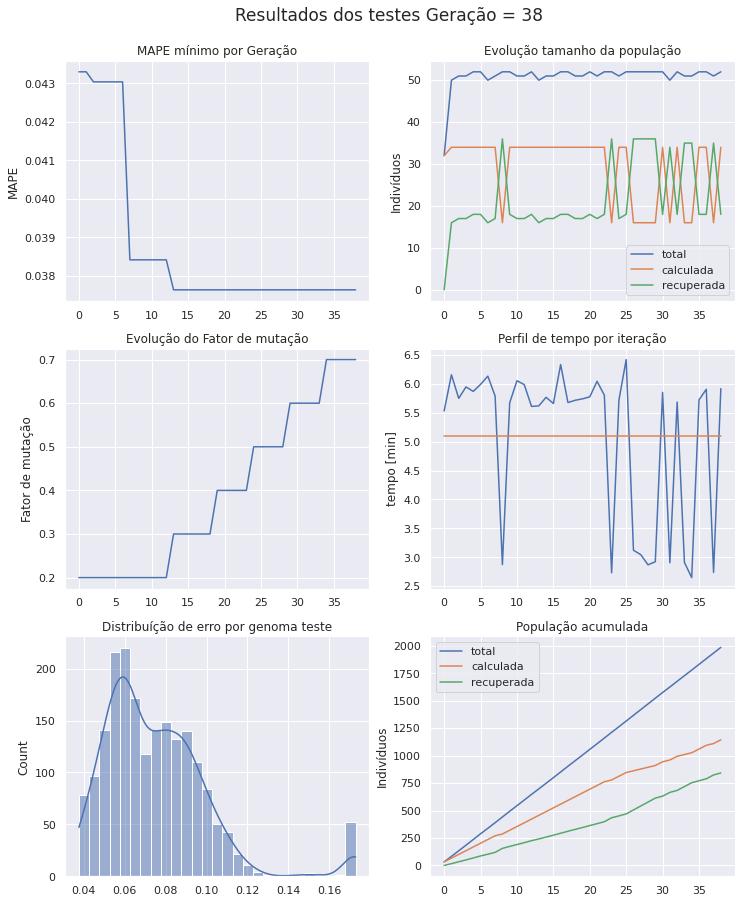

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
Indice Mutação:  0.7999999999999999
	 parado a 0 epocas
-->>epoca 39 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [32 40 58 35 15 26 34 51 32 20 44 13 31]
Projenitores [24 49 22 30 29 41 34  6 59 15 25 47 56]
Projenitores [33 48  1 56 55 17 21 20 63 34 21 26 61]
Projenitores [61 36 34 40 43 56 49 18 20 10 43  8 33]
Projenitores [34 16 56 30 35 36 39  6 59 15 51 47 56]
Projenitores [ 5 32 62 61 49 62  9 37 49 15 55 11 40]
Projenitores [56 58 42  9 28  3  4 18 52 57  3 33 52]
Projenitores [43 61 43 29 22 21 56 10 58 12 37 22 20]
Projenitores [42  7 49 22 56 46 35 35 35 56 14 27  7]
Projenitores [19 54 20 45 30 26  9 14 16  6 54  9 56]
Projenitores [ 0 59 12 61 30 26 44 43 12 16 49 58 18]
Projenitores [43 59 43 29 28 16  5 35 13 12 37 22 31]
Projenitores [42 28 35  1 37 56 16  2 31 10 19  0 39]
Projenitores [19 51 35 32 39 63 12 17 39  6 63 27 56]
Proje

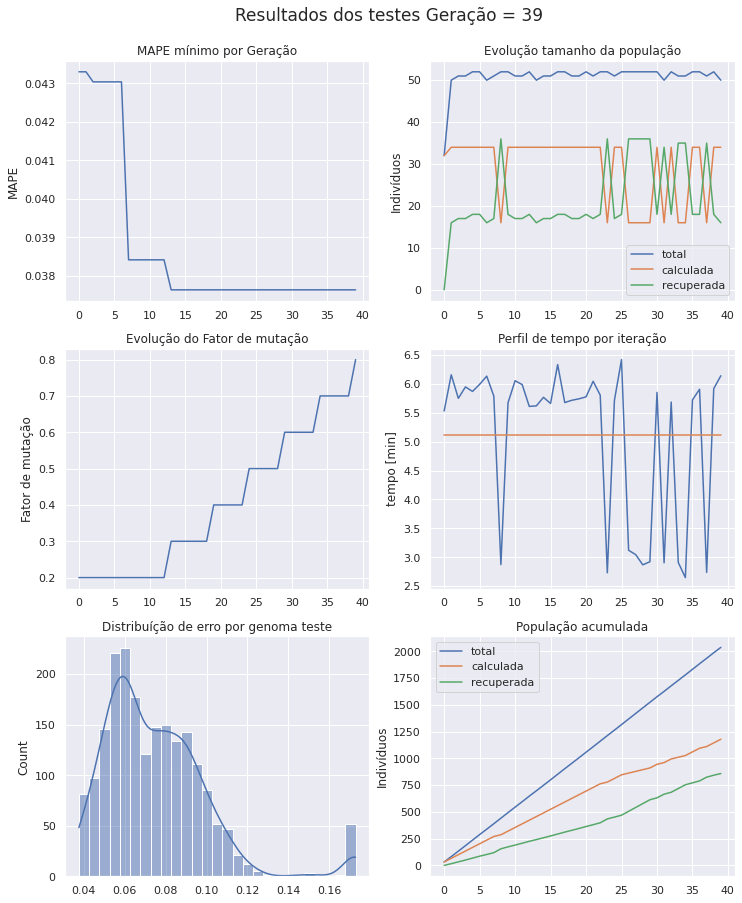

	 Min Erro Atual 0.03763 x 0.03763 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 40 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 0 59 12 61 28 26  5 35 12 16 49 22 18]
Projenitores [28  4 25 17  9 62 46 26 56  4 24 41 10]
Projenitores [32 49 58 30 29 41 34 51 32 20 44 13 31]
Projenitores [45 50 21  9 53 16 50 62 58 39 58 59 26]
Projenitores [ 0 59 12 61 30 26 44 43 12 16 49 58 18]
Projenitores [56 61 43  9 28 21  4 10 58 57  3 22 52]
Projenitores [12 37 18 28 10 46 33 45  5 44 54  2 22]
Projenitores [38 54 16 10 63 11 42 54 43 63 57 36 10]
Projenitores [42 28 35  1 39 56 12 17 31 10 63  0 56]
Projenitores [12 20 49 59 37 43 49 35 29 40 26 31 54]
Projenitores [33 48  1 56 55 17 49 20 20 34 21 26 33]
Projenitores [16  6 38 46  2 29  5 32  0  5 60 61 37]
Projenitores [49 63 34 28 39 24 42 35 13 29  8 35 61]
Projenitores [24 40 22 35 15 26 34  6 59 15 25 47 56]
Projenitores [24 49 22 30 29 41 34  6 59 

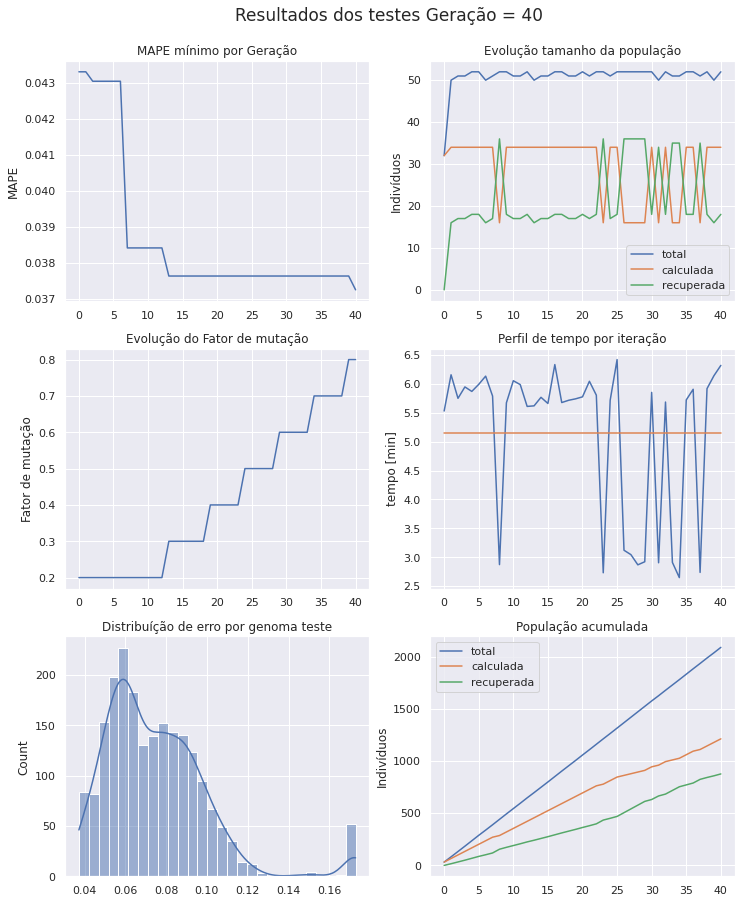

	 Min Erro Atual 0.03725 x 0.03763 Min Erro Anterior
	 parado a 0 epocas
-->>epoca 41 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [42 28 35  1 39 56 12 35 31 10 63  0 54]
Projenitores [28 34 15 22 45 36 40 26 52  9 19 40  5]
Projenitores [28  4 25 17  9 62 46 26 56  4 24 41 10]
Projenitores [56 59 12  9 28 26  4 43 12 16 49 58 52]
Projenitores [ 7 26 53 32 14 58 19 26  3 37 21 46 52]
Projenitores [54 41 60 17 51  7 13 31  4 63 30 63 41]
Projenitores [60 26 24 20 62 44 30 17 52 32 53 22 39]
Projenitores [11 54 39 57 49 53 39 44 44 21 30 41  7]
Projenitores [43 32 60 28 60 16 27 53 43  8 20  8 24]
Projenitores [42 17  9 32 13 62 44  7 28 36 61 42  8]
Projenitores [60 31 32 23 24 33 60 21 51 26 15 28 11]
Projenitores [12 54 18 28 10 11 42 45  5 63 54 36 10]
Projenitores [24 34 59 34 29 33 34  6 59 14 48 47 12]
Projenitores [12 20 49 59 37 43 49 17 29 40 26 31 56]
Projenitores [13 13 32 24 60 47 36 55 42 

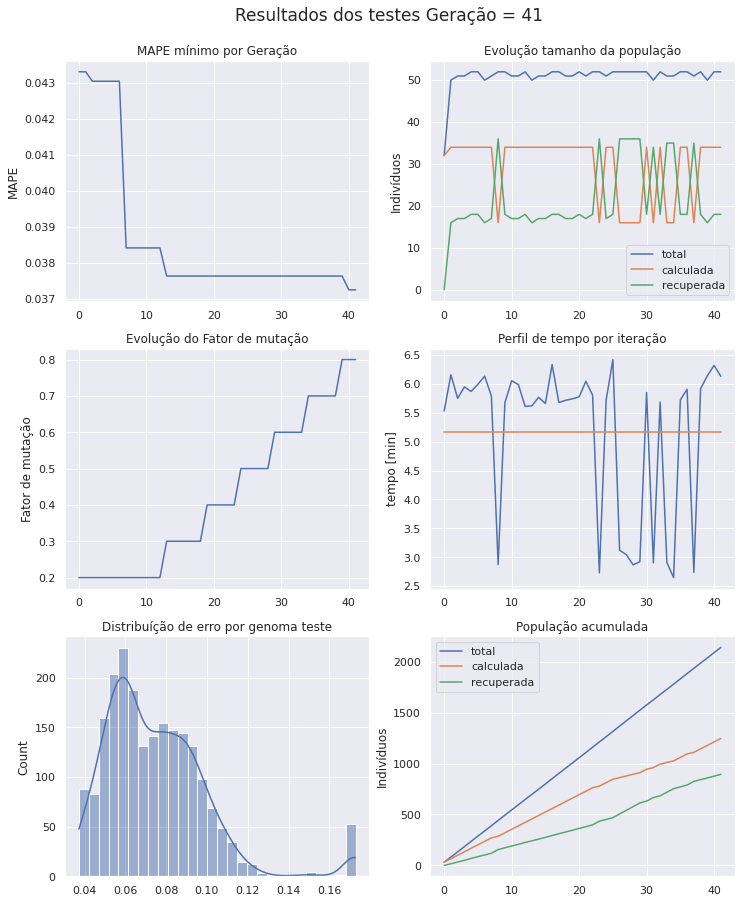

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 42 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [43 32 60 28 60 16 27 53 43  8 20  8 24]
Projenitores [12 34 59 59 37 33 34 17 59 40 26 31 12]
Projenitores [ 7 49 62 17  3 23  1 30 34 51 51  6 57]
Projenitores [16  6 38 46  2 29  5 32  0  5 60 61 37]
Projenitores [56 59 12  9 28 26  4 43 12 16 49 58 52]
Projenitores [16  6 32 24 60 29  5 55 42 56 60  6 23]
Projenitores [28 34 15 22 39 36 12 26 52  9 19  0 54]
Projenitores [ 2 30 24 52 51 26 59 47 34 32 14 21  5]
Projenitores [12 20 49 59 37 43 49 17 29 40 26 31 56]
Projenitores [11 26 24 57 49 53 39 44 52 21 53 41 39]
Projenitores [57 44  6 23 51 40 33  2  2 18 27 13 50]
Projenitores [42 28 35  1 45 56 40 35 31 10 63 40  5]
Projenitores [43 32  9 32 60 62 44  7 28 36 20 42  8]
Projenitores [12 54 32 28 24 33 60 45 51 26 54 28 11]
Projenitores [ 3 54 44 17  1 44 18 14  8 

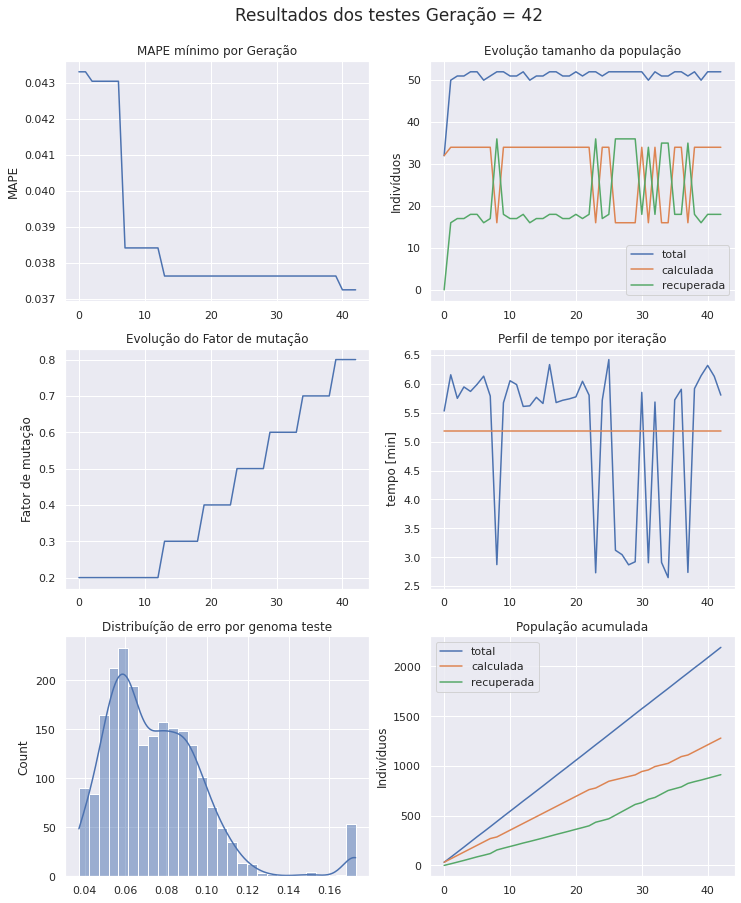

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 43 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [43 32  9 32 60 62 44  7 28 36 20 42  8]
Projenitores [57 44  6 23 51 40 33  2  2 18 27 13 50]
Projenitores [16  6 32 24 60 29  5 55 42 56 60  6 23]
Projenitores [ 2 55 46 19 22  4 58 35 31 58 19 32 20]
Projenitores [42 28 35  1 45 56 40 35 31 10 63 40  5]
Projenitores [39 58 27 21  4 60  1 23  6 21 17 11 24]
Projenitores [16  6 38 46  2 29  5 32  0  5 60 61 37]
Projenitores [12 20 49 59 37 43 49 17 29 40 26 31 56]
Projenitores [24 24 20 47 40 54  5 59 49 55 34 22  9]
Projenitores [48  0 21  4 32 16 28 62 47 59 58 49 59]
Projenitores [43 32 60 28 60 16 27 53 43  8 20  8 24]
Projenitores [12 20 24 57 37 53 49 44 52 21 26 41 56]
Projenitores [56  6 32  9 28 26  4 55 12 56 60  6 52]
Projenitores [56 59 12  9 28 26  4 43 12 16 49 58 52]
Projenitores [26 15 39 43 38 34 53 18 52 

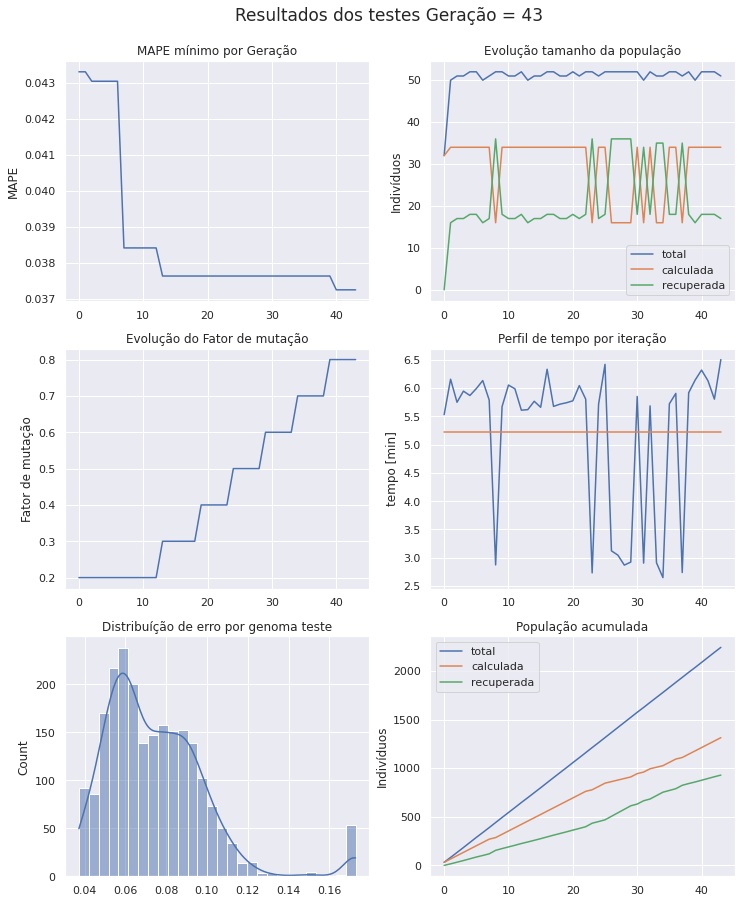

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 44 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [33 17 25 48 37 61 57 27 34 48  7 60 54]
Projenitores [56 59 12  9 28 26  4 43 12 16 49 58 52]
Projenitores [42 28  6  1 45 56 40 35  2 18 63 13 50]
Projenitores [16  6 38 46  2 29  5 32  0  5 60 61 37]
Projenitores [16 55 46 24 60  4  5 35 42 58 19 32 23]
Projenitores [12 20 24 57 37 53 49 44 52 21 26 41 56]
Projenitores [36 30 12 43 25 27 36 24 62 32  9 39 32]
Projenitores [39 58 35  1  4 56 40 35 31 21 63 40  5]
Projenitores [49  6 49  9 61 58 38 62 33 46 20 60  2]
Projenitores [16  6 32 24 60 29  5 55 42 56 60  6 23]
Projenitores [52 23 57  3 21  3 60 62 11 57 32 44 17]
Projenitores [43 32  6 32 60 40 44  7 28 18 20 13 50]
Projenitores [54 14 25 16 24 40 26 12 52 42 21 52 48]
Projenitores [29 21 60 21 28 44 41 62 51 58 58 37 17]
Projenitores [ 2 38 45 62 43 50 42  2 43 

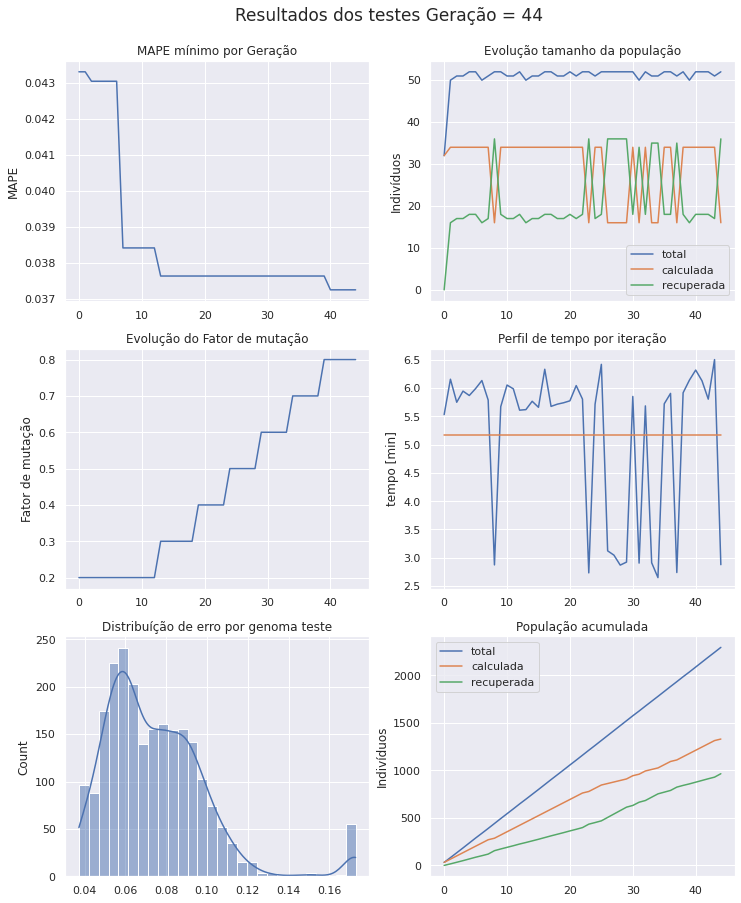

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 45 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [28 47 40  2 27 19 25 23 53 51 46 20 53]
Projenitores [12 20 24 57 37 53 49 44 52 21 26 41 56]
Projenitores [54 21 60 16 28 44 41 62 52 42 58 37 48]
Projenitores [13 38 45 62 43  4 56 25 43 14 51 33 55]
Projenitores [36 30 12 43 25 27 36 24 62 32  9 39 32]
Projenitores [49  6 49  9 61 58 38 62 33 46 20 60  2]
Projenitores [52 23 57  3 21  3 60 62 11 57 32 44 17]
Projenitores [54 14 25 16 24 40 26 12 52 42 21 52 48]
Projenitores [16 20 46 57 37 53 49 44 52 58 26 41 23]
Projenitores [48  0 21  4 32 16 28 62 47 59 58 49 59]
Projenitores [24 61 24  3 18 47  3 42 12 38 35 22 62]
Projenitores [36 48 25  3 39 60 35 50 30 29 49 33 18]
Projenitores [28 59 12 61  9 26  5 35 56 16 49 41 10]
Projenitores [16  6 38  1 45 29  5 32  2 18 60 13 37]
Projenitores [12 55 24 24 60  4  5 35 42 

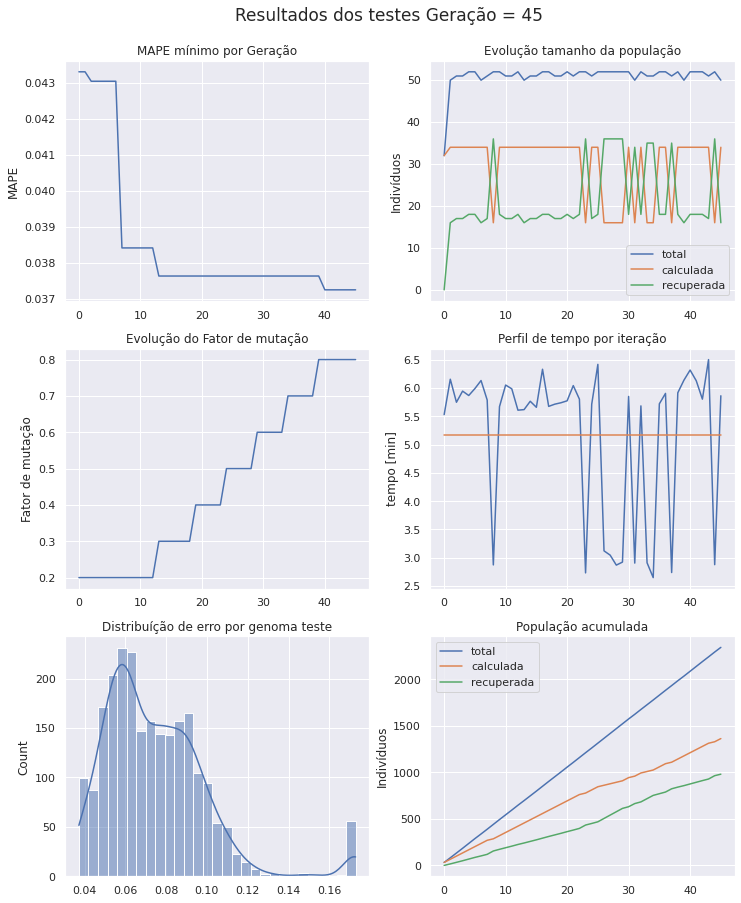

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
Indice Mutação:  0.8999999999999999
	 parado a 0 epocas
-->>epoca 46 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [16 20 46 57 37 53 49 44 52 58 26 41 23]
Projenitores [28 59 12 61  9 26  5 35 56 16 49 41 10]
Projenitores [45  1 31 50 58 44 46  3 16 34  5 28 12]
Projenitores [33 59 25  9 60  4  5 35 34 21  7 32 56]
Projenitores [24 61 24  3 18 47  3 42 12 38 35 22 62]
Projenitores [54 21 60 16 28 44 41 62 52 42 58 37 48]
Projenitores [28  6 38  1 45 26  5 35 56 16 49 41 10]
Projenitores [12 55 24 24 60  4  5 35 42 21 19 32 56]
Projenitores [36 30 12 43 25 27 36 24 62 32  9 39 32]
Projenitores [36 48 25  3 39 60  3 50 30 29 49 22 18]
Projenitores [54 39 13 28 21 39 52 47  6 12 48 43 52]
Projenitores [ 4 27 36 32 63 27 21 25 61 63 34 36 37]
Projenitores [24 61 24  3 18 47 35 42 12 38 35 33 62]
Projenitores [52 23 57  3 21  3 60 62 11 57 32 44 17]
Proje

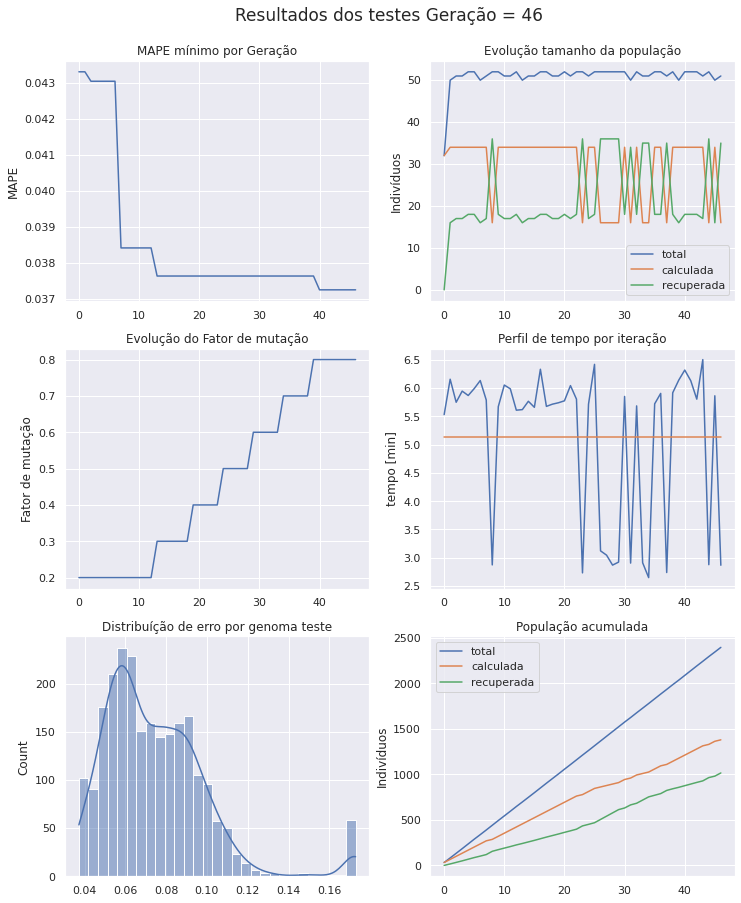

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 47 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [54 61 60 16 18 47  3 62 52 38 35 22 62]
Projenitores [62 22 56  8 26 30 50 28 11  0 18 51 36]
Projenitores [ 4 39 36 32 21 27 52 47 61 63 48 43 37]
Projenitores [50 29 27  2 32 61 10  2  4 31 56 10  2]
Projenitores [45  1 31 50 58 44 46  3 16 34  5 28 12]
Projenitores [28 47 40  2 27 19 25 23 53 51 46 20 53]
Projenitores [42 27 52 28 51 25  5 32 55  3 20 50 63]
Projenitores [55 17 30  0 44 59 24 32  0  0 34 49 44]
Projenitores [36 30 12 43 25 27 36 24 62 32  9 39 32]
Projenitores [54 39 13 28 21 39 52 47  6 12 48 43 52]
Projenitores [54 33 51 32  9 31 61 38 47 62 48 60 14]
Projenitores [12 15 52 30 30 18  4 34 25 46  6 55 26]
Projenitores [24 61 24  3 18 47 35 42 12 38 35 33 62]
Projenitores [59 17 48 55 48 41 11 32  0  9 51 38 59]
Projenitores [24 61 24  3 18 47  3 42 12 

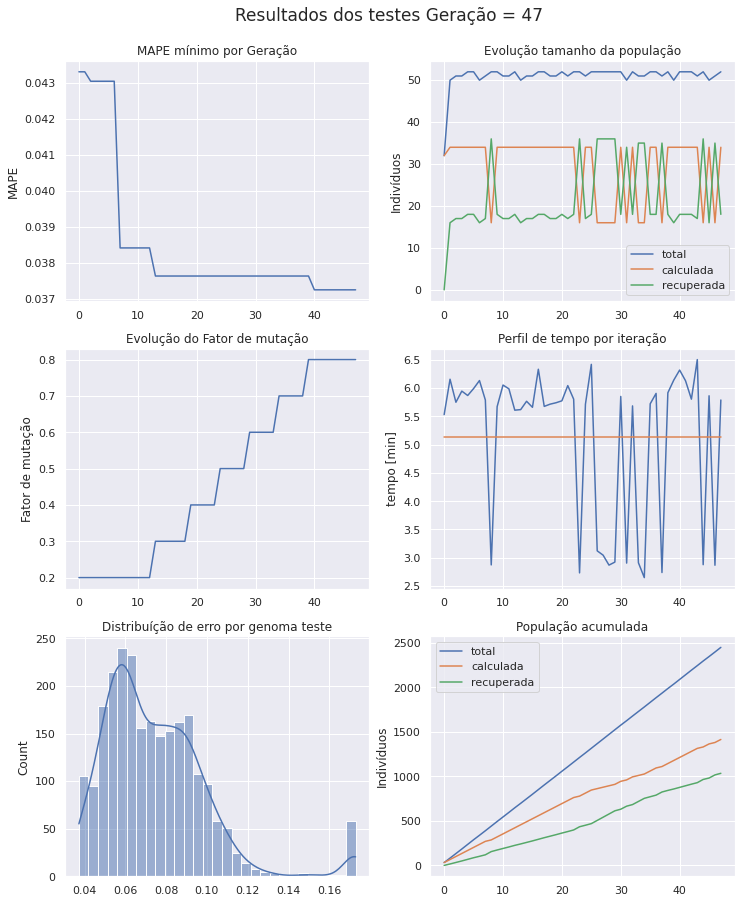

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 48 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [40 40 17 42 20 59  1 50  0 62  6  4 37]
Projenitores [62 22 56 16 18 30 50 62 11 38 18 22 36]
Projenitores [ 8 53  8 51 42  8 30 59 22  1 36  2 53]
Projenitores [42 27 52 28 51 25  5 32 55  3 20 50 63]
Projenitores [50 26 60 62  1 60 18 15 17 50  4  0 56]
Projenitores [24 54 21 25 22 48 33 48 53 13 29 59 39]
Projenitores [24 17 48  3 18 47 35 42 12 38 51 38 59]
Projenitores [55 17 30  0 44 59 24 32  0  0 34 49 44]
Projenitores [36 30 12 43 25 27 36 24 62 32  9 39 32]
Projenitores [24 61 24  3 18 47  3 42 12 38 35 22 62]
Projenitores [28  1 31 50 58 44 46  3 16 51 46 28 12]
Projenitores [51 61 24  4 18 43 45 42  6 38 22 22 62]
Projenitores [12 15 52 30 30 18  4 34 25 46  6 55 26]
Projenitores [36 30 12 43 21 39 52 47 62 32 48 39 32]
Projenitores [54 61 60  8 26 47  3 28 52 

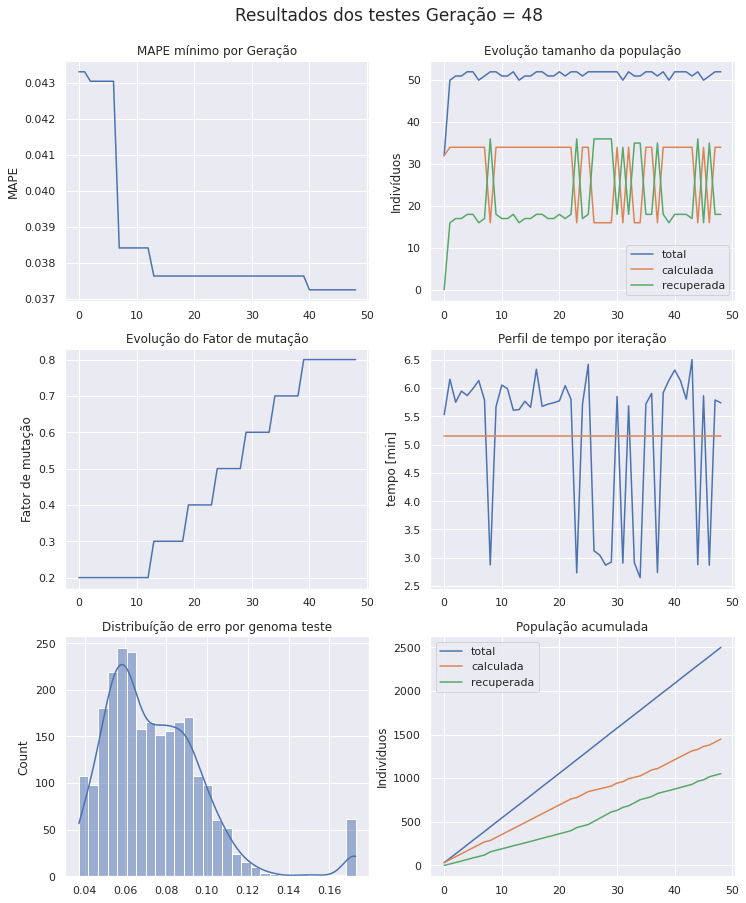

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 49 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [28  1 24 50 58 44 46  3 16 38 46 22 12]
Projenitores [55 17 30  0 44 59 24 32  0  0 34 49 44]
Projenitores [24 17 30  0 44 47 24 32  0 38 51 38 44]
Projenitores [28 24 62 23 38 55 50 15 57  9 36  6 22]
Projenitores [54 39 13  8 21 47  3 28  6  0 35 43 62]
Projenitores [ 8  2 57 46 15 54 31 55 22 41 56 35  5]
Projenitores [44 52 50 57  4 62 22 13 62 12 35 32 39]
Projenitores [51 61 24  4 18 43 45 42  6 38 22 22 62]
Projenitores [40 40 17 42 20 59 50 62  0 38  6  4 37]
Projenitores [48  0 21  4 32 16 28 62 47 59 58 49 59]
Projenitores [36 61 12  3 25 27  3 42 12 32 35 22 62]
Projenitores [40 40 17 42 20 59  1 50  0 62  6  4 37]
Projenitores [ 8 53 52 28 51  8 30 32 22  1 20  2 63]
Projenitores [42 27 52 28 51 25  5 32 55  3 20 50 63]
Projenitores [24  6 34 49  4  1 18 32 23 

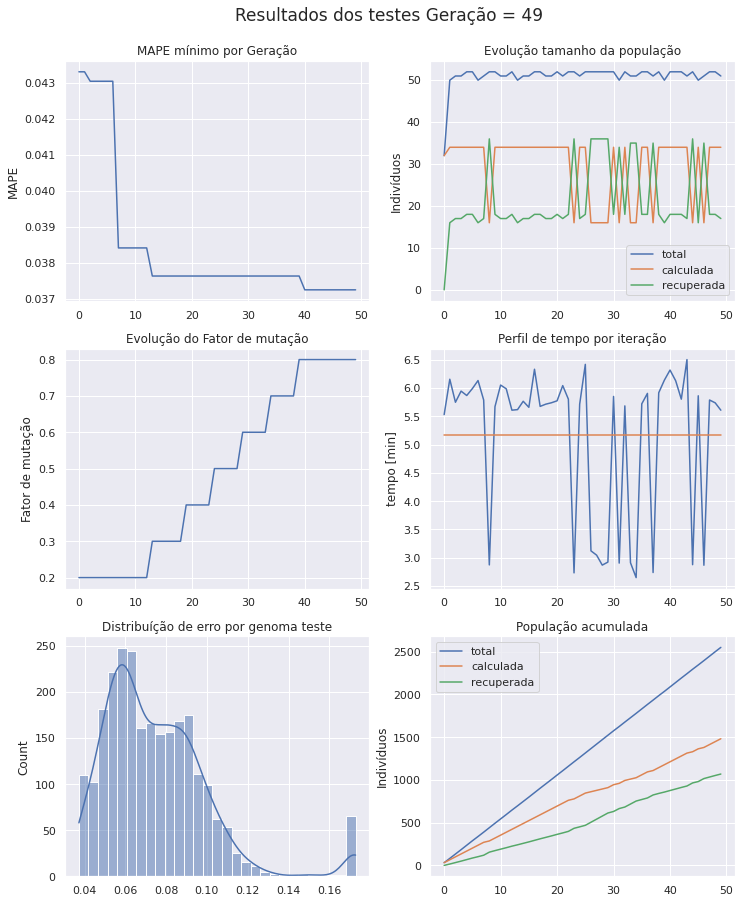

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 50 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [47 17 44  6  1 39 53 49 61 30 38 19 46]
Projenitores [42 27 52 28 51 25  5 32 55  3 20 50 63]
Projenitores [42 27  8 51 42 25  5 59 55  3 36 50 53]
Projenitores [44 52 50 57  4 62 22 13 62 12 35 32 39]
Projenitores [24 24 30  0 44 47 24 32 57 38 51 38 44]
Projenitores [40 40 17 42 20 59  1 50  0 62  6  4 37]
Projenitores [39 31 52 22  0 17  1  5 54 22 21 10 41]
Projenitores [ 8  2 13  8 21 47 31 55  6  0 35 35  5]
Projenitores [ 3  3  9 62 25 54 56 46 37 26  2  1 24]
Projenitores [24 17 30  0 44 47 24 32  0 38 51 38 44]
Projenitores [ 0  3 53  7 32 24 53 35 30 44 10 29 23]
Projenitores [28 17 30  0 44 44 24  3  0 38 46 22 12]
Projenitores [ 1 56 45  7 34 39 13 20 13 28  3 42 56]
Projenitores [11 15 13 35 19 44 53 43 39  9 57 32 18]
Projenitores [54 10 46 42 49 36  3 22  5 

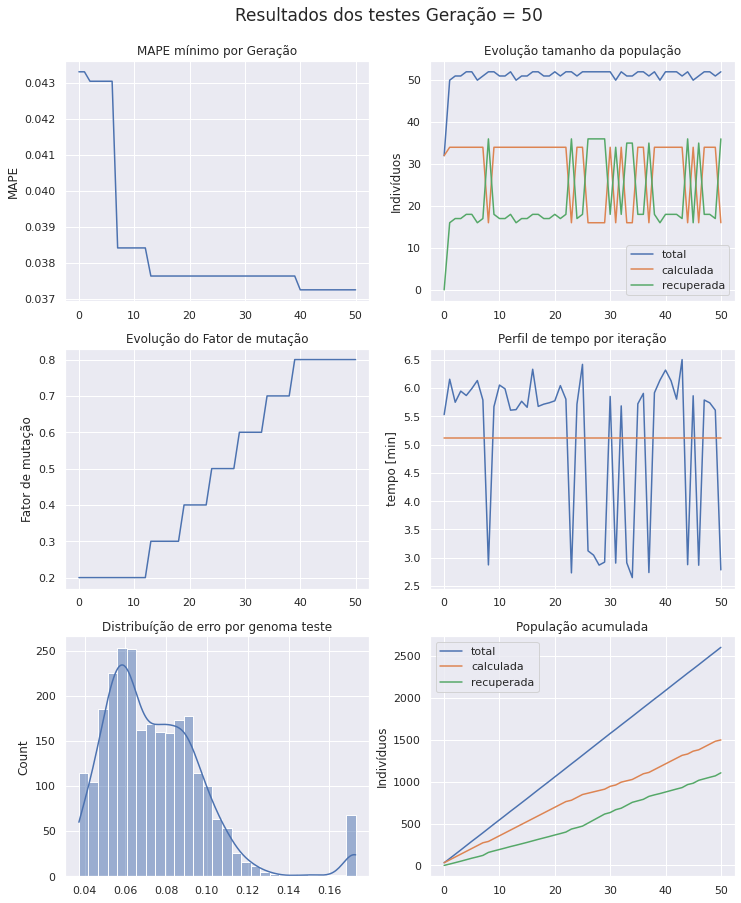

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 51 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [11 15 13 35 19 44 53 43 39  9 57 32 18]
Projenitores [ 0 17 30  0 44 44 53  3  0 38 46 29 12]
Projenitores [28 59 12 61  9 26  5 35 56 16 49 41 10]
Projenitores [24 61 24  3 18 47  3 42 12 38 35 22 62]
Projenitores [39 31 52 22  0 17  1  5 54 22 21 10 41]
Projenitores [40 40 17 42 20 59  1 50  0 62  6  4 37]
Projenitores [13 30 24 61  2  3 30 34 43 13 48 40  8]
Projenitores [25 10 46 42 49 38  3 26  5 37 19 35 34]
Projenitores [51 16 32 54  0 38 19 46 42 51 56 60 40]
Projenitores [48  0 21  4 32 16 28 62 47 59 58 49 59]
Projenitores [ 2 57 34 62 35 30 59  3 18 46 35 20 17]
Projenitores [11 56 45 35 34 39 13 20 39  9  3 42 18]
Projenitores [19 31  8 26  2 56 52  3 44 61 14 32  4]
Projenitores [ 3 45 11 60 22 13 57 45 11 56 16 24 29]
Projenitores [39  2 

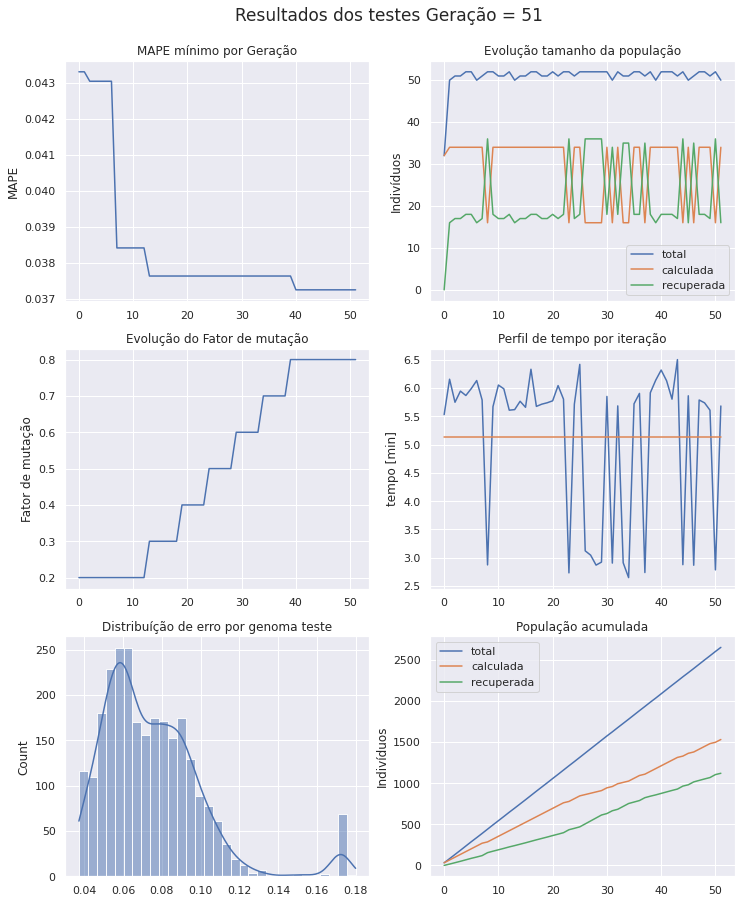

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 52 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [11 15 13 35 44 44 53  3 39  9 46 32 18]
Projenitores [40 40 17 42 20 59  1 50  0 62  6  4 37]
Projenitores [ 2 40 22 38  0 59 14 52 30 26 45  4 61]
Projenitores [ 2  5  1 33 25 10 18 54  8 14 17 57 15]
Projenitores [ 3 31  8 60  2 13 57 45 44 56 14 24 29]
Projenitores [55 16 29 14 22  4 11 19 48 49 14 47  3]
Projenitores [48  0 21  4 32 16 28 62 47 59 58 49 59]
Projenitores [19 31  8 26  2 56 52  3 44 61 14 32  4]
Projenitores [39 40 52 22 20 17  1  5 54 22 21  4 41]
Projenitores [ 4 50 59 45 41 58 63 15 49 18 31 49 22]
Projenitores [25 10 46 42 49 38  3 26  5 37 19 35 34]
Projenitores [51  0 32 54  0 16 28 46 47 51 56 60 40]
Projenitores [ 0 17 30  0 19 44 53 43  0 38 57 29 12]
Projenitores [13 30 24 61  2  3 30 34 43 13 48 40  8]
Projenitores [28 33 23 41 39 22 58 53 41 

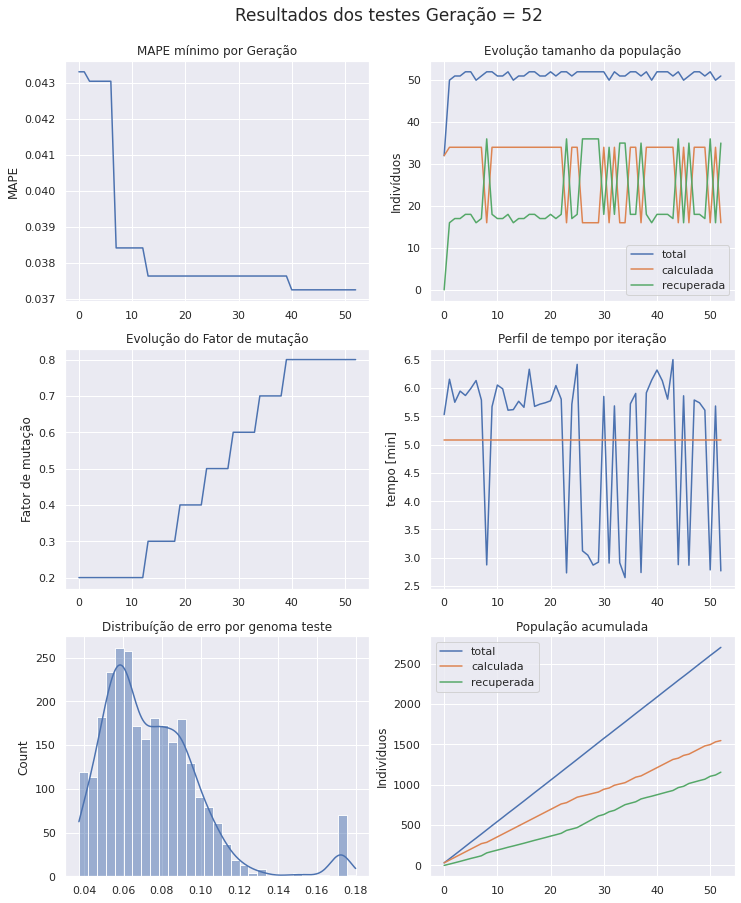

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 53 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [39 50 52 45 20 58  1  5 49 18 31  4 22]
Projenitores [51  0 32 54 49 16 28 46 47 51 56 35 40]
Projenitores [25 10 46 42  0 38  3 26  5 37 19 60 34]
Projenitores [ 0 30 24  0 19  3 53 34  0 38 48 40 12]
Projenitores [ 4 40 59 22 41 17 63 15 54 22 21 49 41]
Projenitores [ 6 22  4  9 16 41 16 27 53 25  3 38 49]
Projenitores [48  0 21  4 32 16 28 62 47 59 58 49 59]
Projenitores [18  7  7 55 29 54 46 39  5 25  1 24 35]
Projenitores [19 31  8 26  2 56 52  3 44 61 14 32  4]
Projenitores [40 40 17 42 20 59  1 50 39  9  6 32 37]
Projenitores [ 3 31  8 60  2 13 57 45 44 56 14 24 29]
Projenitores [40 40 17 42 20 59  1 50  0 62  6  4 37]
Projenitores [54 31 46 16 52 22 37 60 36 21 56 49 32]
Projenitores [ 8 32 15 56 35 56  7 59 25 61 25 58 19]
Projenitores [ 3  2 52 22 21 47  1 55 54 

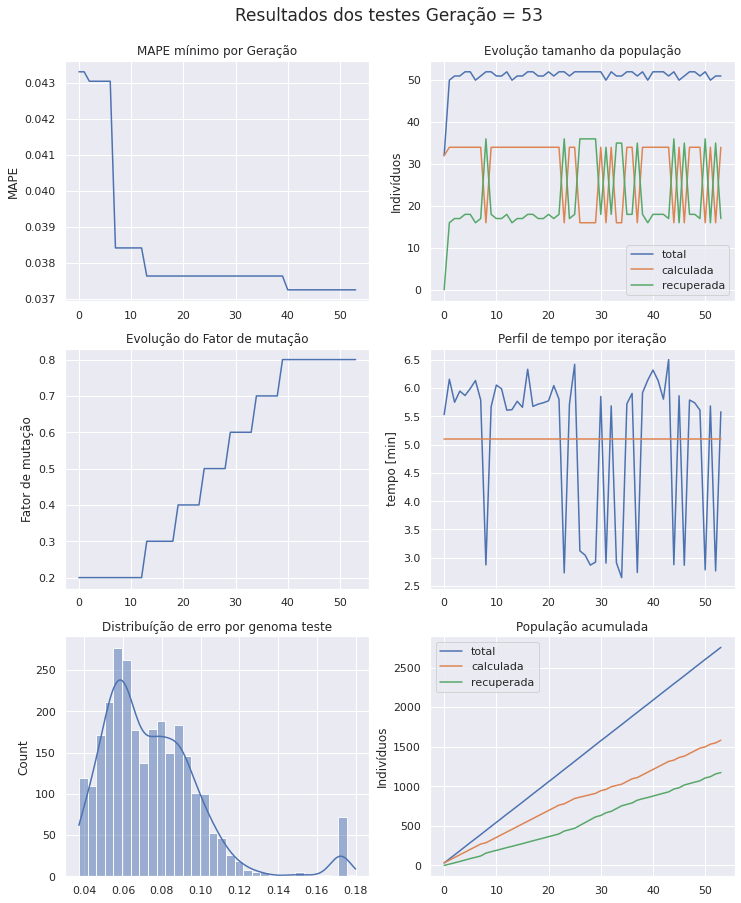

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 54 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [55 23 20  8 62 47 19 21 49 59 58 46 19]
Projenitores [ 8 32 15 56 35 56  7 59 25 61 25 58 19]
Projenitores [ 4 50 59 45 41 58 63 15 49 18 31 49 22]
Projenitores [48  0 21  4 32 16 28 62 47 59 58 49 59]
Projenitores [ 0 30 24  0  0  3 53 34  5 38 19 40 12]
Projenitores [40 40 17 42 20 59  1 50  0 62  6  4 37]
Projenitores [48 10 45 47 21  8 55 39 23 39 18 17 27]
Projenitores [ 6 40 59  9 16 41 63 15 53 22  3 38 49]
Projenitores [61 54 24 62 53 45 49 25 17 33 21 21 13]
Projenitores [25 10 46 42  0 38  3 26  5 37 19 60 34]
Projenitores [17 49 54  2 61 44 24 28 10 53 10  0  8]
Projenitores [39 50 52 45 20 58  1 46 49 51 56  4 22]
Projenitores [ 3 27 35 46 14 13 17 37 36 48  8 33  6]
Projenitores [62 22 30  9 48  9  0 16 20  2 37 20 11]
Projenitores [27 37 19 35 18 50 42 23 41 

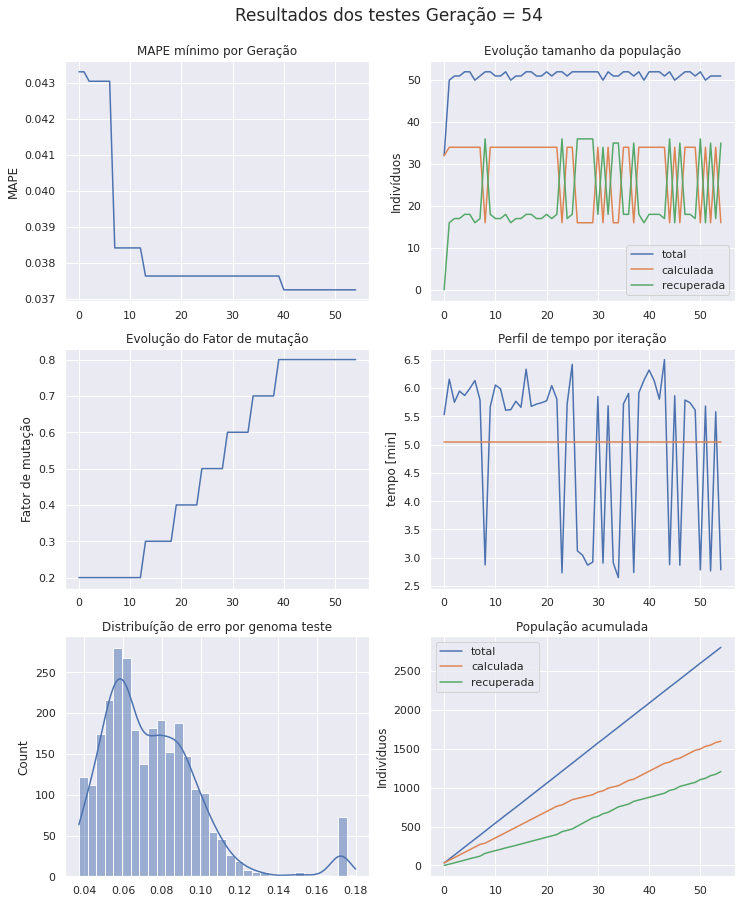

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 55 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [17 50 52 45 20 58 24 46 49 51 56  0 22]
Projenitores [28 59 12 61  9 26  5 35 56 16 49 41 10]
Projenitores [25 10 46 42  0 38  3 26  5 37 19 60 34]
Projenitores [ 0 30 24  0  0  3 53 34  5 38 19 40 12]
Projenitores [27 39  2 60 10 50 42 23 25 16 13 24 38]
Projenitores [ 3 27 35 46 14 13 17 37 36 48  8 33  6]
Projenitores [24 61 24  3 18 47  3 42 12 38 35 22 62]
Projenitores [13 30 24 61  2  3 30 34 43 13 48 40  8]
Projenitores [29  3 35 39  9  9 41 23  3 46 26 50 44]
Projenitores [48 40 45 47 16 41 55 15 23 39  3 17 27]
Projenitores [31 39  2 60 10 63 61  6 25 22 13 24 38]
Projenitores [31 37 19 35 18 63 61  6 41 22 60 38  8]
Projenitores [50 27 14 41 58  1 36 10 22 43 40 11  2]
Projenitores [ 3 22 30 46 48  9  0 16 36 48 37 20  6]
Projenitores [19 31  8 26  2 56 52  3 44 

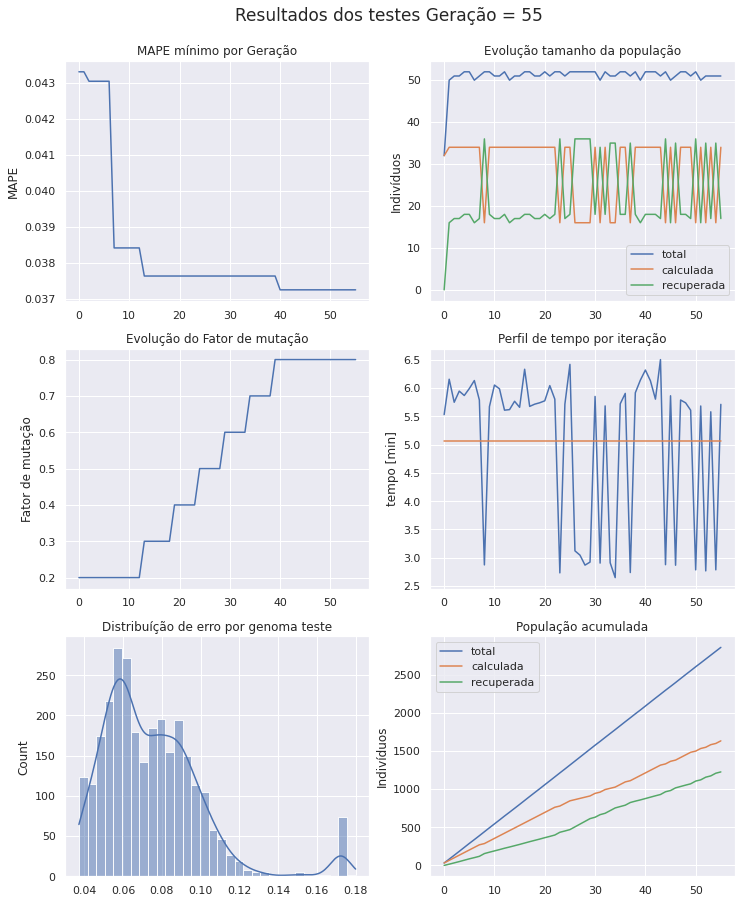

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 56 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [13 30 24 61  2  3 30 34 43 13 48 40  8]
Projenitores [ 3 27 14 41 48  1  0 10 22 43 37 20  6]
Projenitores [46 42 12 37 12 32 55 53 21 43 14 19 45]
Projenitores [19 31  8 26  2 56 52  3 44 61 14 32  4]
Projenitores [ 0 30 24  0  0  3 53 34  5 38 19 40 12]
Projenitores [40 40 17 42 20 56  1 50  0 61  6 32  4]
Projenitores [17 59 52 45  9 26 24 35 56 51 56 41 10]
Projenitores [41 58 63 15 49 18 31 49 22  2  5  1 33]
Projenitores [50 27 14 41 58  1 36 10 22 43 40 11  2]
Projenitores [13 30 24  3 18  3  3 42 12 38 48 22 62]
Projenitores [39 22 58 53 41 56 20 28 19 19 55 63 46]
Projenitores [28 50 12 61 20 58  5 46 49 16 49  0 22]
Projenitores [29 40 45 39 16  9 41 23  3 39  3 50 27]
Projenitores [31 37 19 35 10 63 61  6 41 22 13 24  8]
Projenitores [62  9 

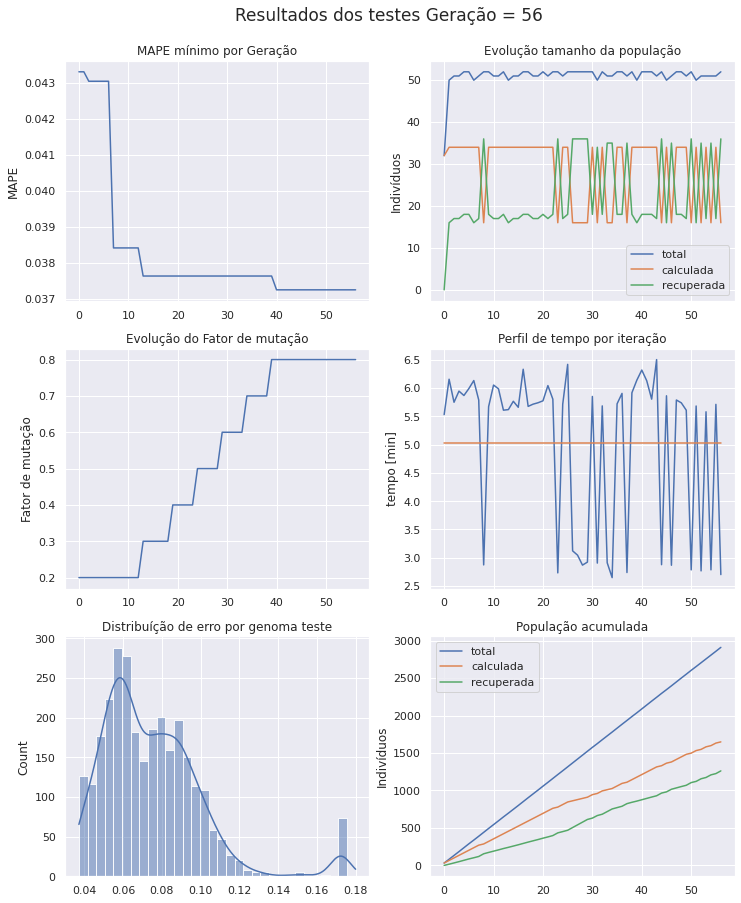

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 57 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [46 42 12 37 12 32 55 53 21 43 14 19 45]
Projenitores [28 50 58 61 20 58  5 46 19 19 49 63 46]
Projenitores [13 30 24 61  2  3 30 34 43 13 48 40  8]
Projenitores [ 0 30 24  0  0  3 53 34  5 38 19 40 12]
Projenitores [29 40 45 39 16  9 41 23  3 39  3 50 27]
Projenitores [ 0 40 17  0  0  3 53 50  5 61  6 32 12]
Projenitores [ 0 31  9 15 53 18 30 29  7 46 40 30  1]
Projenitores [39 22 58 53 41 56 20 28 19 19 55 63 46]
Projenitores [50 27 14 41 58  1 36 10 22 43 40 11  2]
Projenitores [19 57  2  0 39 29 54 60 51 11 33 52 24]
Projenitores [ 7 15 59 48 21 47 25 23 53 59 22 37 63]
Projenitores [31 39  2 60 18 63 61 58 55 49 60 52 26]
Projenitores [39 22 12 53 41 56 20 28 49 16 55  0 22]
Projenitores [17 59 52 45  9 26 24 35 56 51 56 41 10]
Projenitores [19 31  8 26  2 56 52  3 44 

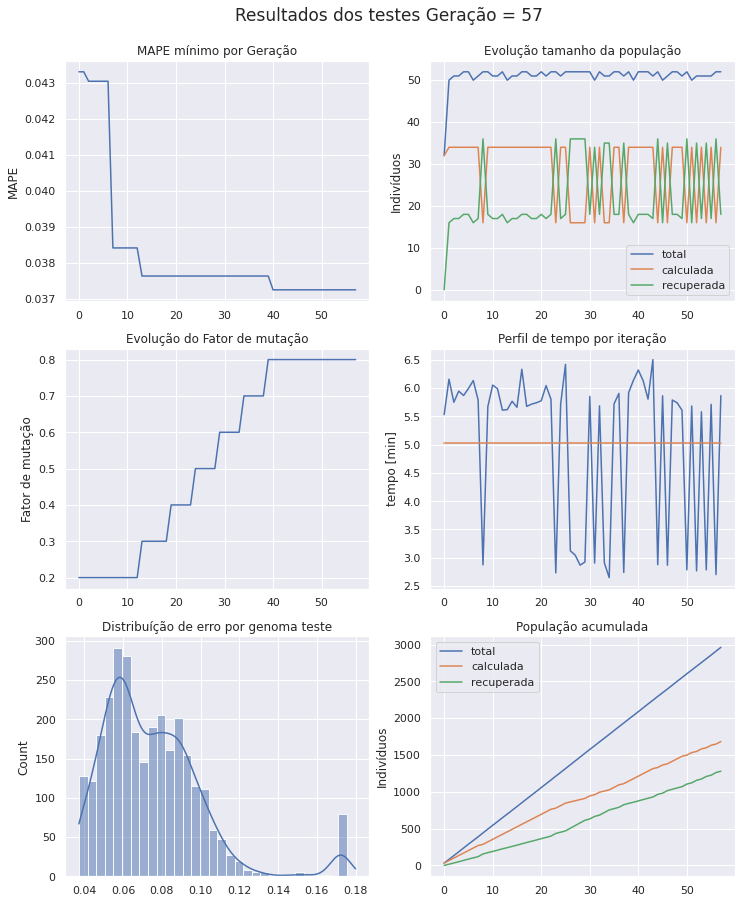

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 58 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 3 27 24 26  2 56 30  3 44 61 14 32  8]
Projenitores [45 21 20 20 49 60 45 24 11 55  1 41 18]
Projenitores [25 54 41  9 53  2 15 57 54  1 30 24 49]
Projenitores [19 27  2  0 58  1 36 60 51 43 33 52  2]
Projenitores [19 31  8 61  2  3 52 10 22 43 37 20  4]
Projenitores [17 59 52 45  9 26 24 35 56 51 56 41 10]
Projenitores [ 0 30 24  0  0  3 53 34  5 38 19 40 12]
Projenitores [31 39  2 60 18 63 61 58 55 49 60 52 26]
Projenitores [17 22 52 53  9 56 20 28 56 51 55 41 22]
Projenitores [ 7 15 59 48 18 47 61 58 55 59 22 52 26]
Projenitores [15 54 11  4 22 61  6 59 39 44  9 11 18]
Projenitores [ 7 15 59 48 21 47 25 23 53 59 22 37 63]
Projenitores [50 27 14 41 58  1 36 10 22 43 40 11  2]
Projenitores [50 57 14 41 39 29 54 10 22 11 40 11 24]
Projenitores [13 30 24  0  0  3 53 34 43 

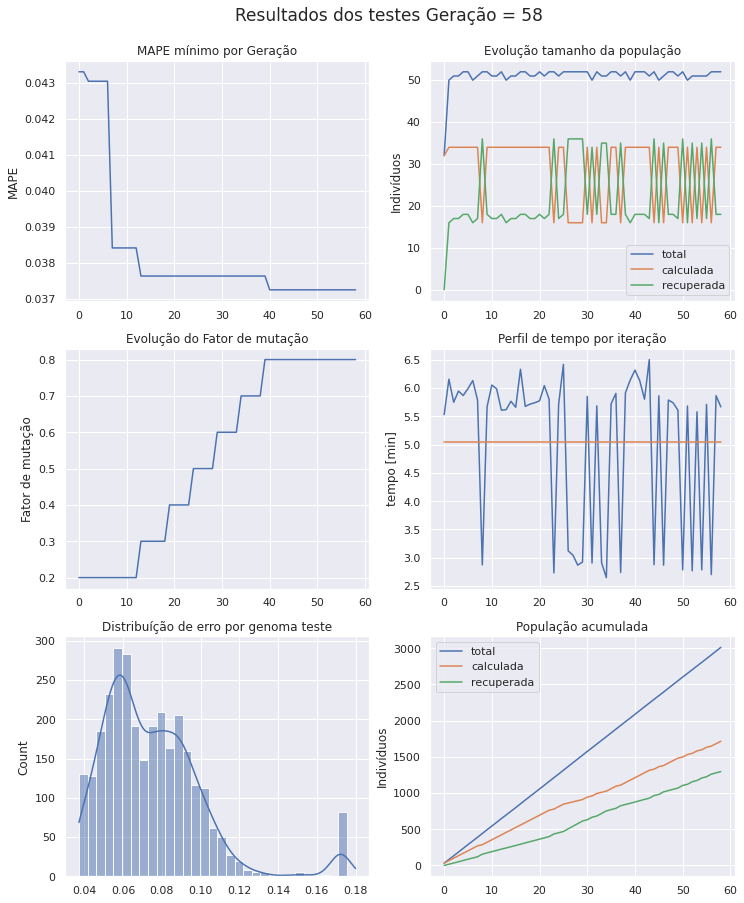

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 59 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [48  0 21  4 32 16 28 62 47 59 58 49 59]
Projenitores [ 3 27 24 26  2 56 30  3 44 61 14 32  8]
Projenitores [54  6 55 45 31 54 25  4 21 32 50 46 11]
Projenitores [ 0 30 24  0  0  3 53 34  5 38 19 40 12]
Projenitores [45 27 20 26  2 60 30 24 44 61 14 41 18]
Projenitores [11 43 13 61 34 44 15 21 12 63  3 44 60]
Projenitores [31 39  2 60 18 63 61 58 55 49 60 52 26]
Projenitores [ 0 30 24 39  0  3 41 34 43 38  3 40 12]
Projenitores [10  4 37 27 43 20 27  8 19 43 31 57 31]
Projenitores [48 54 59 20 26 62 26 55 43  8 43 23 29]
Projenitores [17 59 52 45  2 26 24 35 22 51 37 20 10]
Projenitores [50 57 14 41 39  1 54 10 22 11 40 11  2]
Projenitores [17 56 20  3 28 30 35 61 49 40 57 19 53]
Projenitores [ 4  1  8  6  5 26 18 33 43 25 53 29 45]
Projenitores [ 7 15 59 48  9 56 61 28 55 

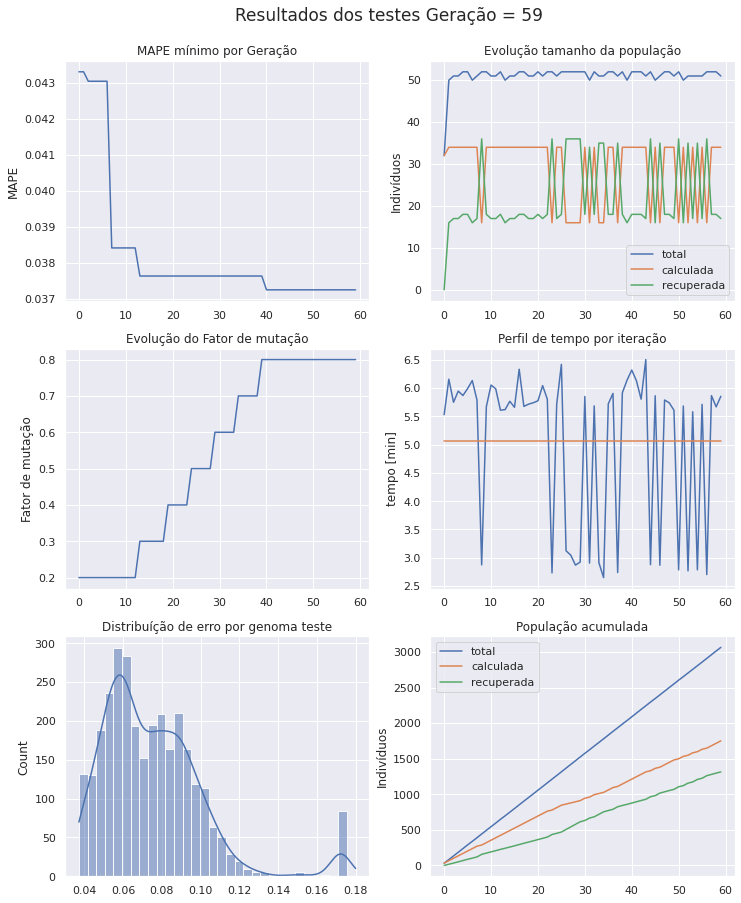

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 60 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [54 41 44 35 62 31 44 49  4 53 46  5 30]
Projenitores [41 53 61 21 20 22 50 58 15 51 44 30 42]
Projenitores [11 43 13 61 34 44 15 21 12 63  3 44 60]
Projenitores [17 22 52 53  9 56 20 28 56 51 55 41 22]
Projenitores [24 59 46 14 29 54 50 58 42 14  4 56 61]
Projenitores [28 59 12 61  9 26  5 35 56 16 49 41 10]
Projenitores [17 56 20  3 28 30 35 61 49 40 57 19 53]
Projenitores [48  0 21  4 32 16 28 62 47 59 58 49 59]
Projenitores [48 27 21  4  2 56 30 62 47 61 58 49  8]
Projenitores [10  4 37 27 43 20 27  8 19 43 31 57 31]
Projenitores [44 36 57 62 49 30 30 20 62 42  2 30  3]
Projenitores [ 1 27 51 54 13 38 51 28  9 24  6 45 21]
Projenitores [54  6 55 45 31  3 25 34  5 38 50 46 11]
Projenitores [50 57 52 45  2  1 24 35 22 51 40 11  2]
Projenitores [45 43 13 61 34 44 30 24 12 

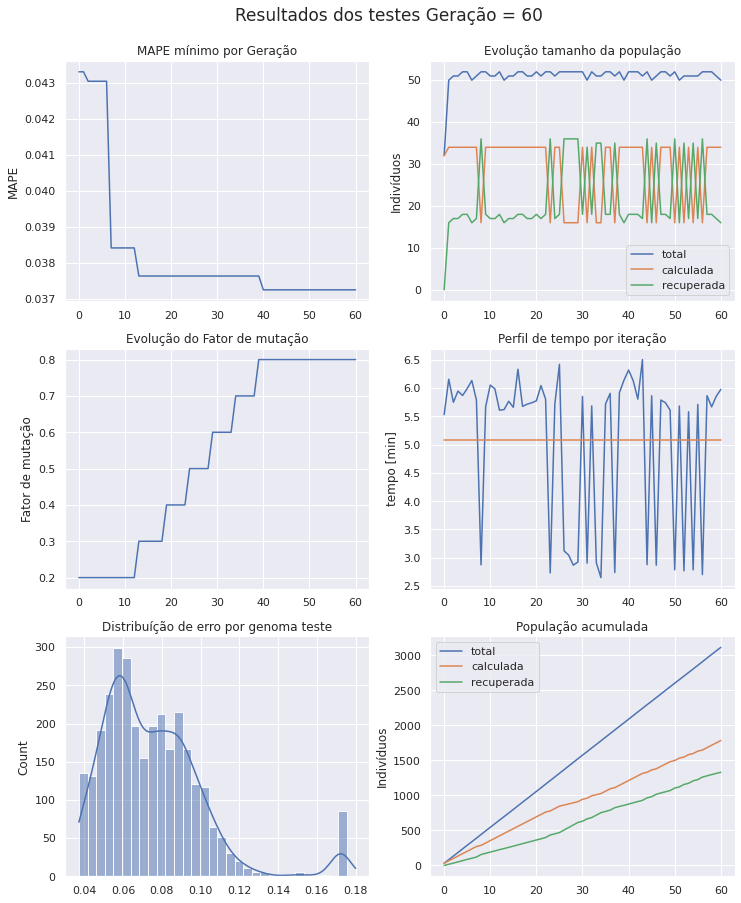

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 61 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [11 22 13 61 34 56 15 21 12 51  3 41 22]
Projenitores [50  6 55 45 31  1 25 34 22 38 50 11 11]
Projenitores [45  5 44 54  2 22 52 34 59 34  7 33 32]
Projenitores [48  0 20  3 32 30 35 61 49 40 57 19 53]
Projenitores [26 56  4 24 41 10 15 17 24 12 21  0 52]
Projenitores [17 56 21  4 28 16 28 62 47 59 58 49 59]
Projenitores [34 13 17 45  3 13 36 51 16 33 54 40 58]
Projenitores [52 24 53 61 47 60 12 37 18 28 10 46 33]
Projenitores [17 36 33 41 14 16 32 18 25 44  9 55 58]
Projenitores [46  9 18 61 11 61 45 44 12  9 19 49 42]
Projenitores [32  0  5 60 61 37  6 25 54 40 37 28 57]
Projenitores [54 57 52 45  2  3 24 35  5 51 40 46  2]
Projenitores [48  0 21  4 32 16 28 62 47 59 58 49 59]
Projenitores [48 27 21  4  2 56 30 62 47 61 58 49  8]
Projenitores [14 54 

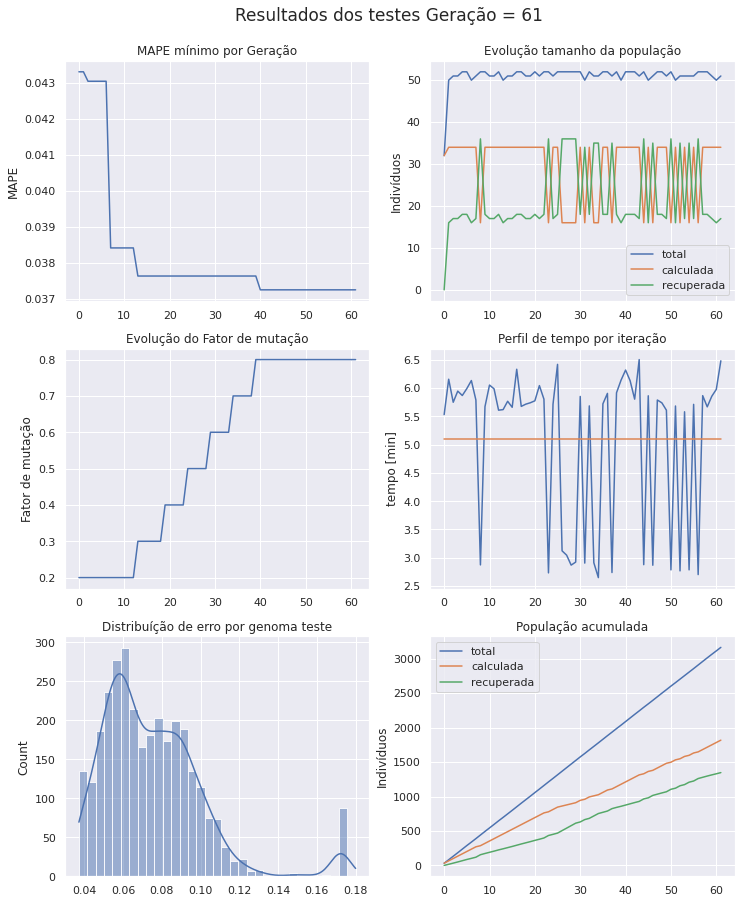

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 62 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [15 59 42 37  2 25 24 11 43 18  0  7 21]
Projenitores [34 52 34 43 24 60 31 12 42  8 55 52 51]
Projenitores [26 56  4 24 41 10 15 17 24 12 21  0 52]
Projenitores [40 34 44  6 11 41 53 63 58 19 62  4 19]
Projenitores [17 36 33 61 14 16 32 44 25 44  9 55 42]
Projenitores [25 29  2 26 55 38 12  9 11 30 29 36 57]
Projenitores [63 60 52 60  2  8  8 40  8 11 58 16 17]
Projenitores [46  9 18 41 11 61 45 18 12  9 19 49 58]
Projenitores [50  6 55 45 31  1 25 34 22 38 50 11 11]
Projenitores [34 58 38 35 44 13 51  0  0 30 52 54 29]
Projenitores [32  0  5 60 61 37  6 25 54 40 37 28 57]
Projenitores [42 37 48 37 38 60  0  5 41 46  7  4 32]
Projenitores [52 34  2 28 45 24 25 17 41 28 46 55 38]
Projenitores [26 56 21  4 28 16 28 62 24 12 58 49 59]
Projenitores [54  6 55 45 31 28 14 41  5 

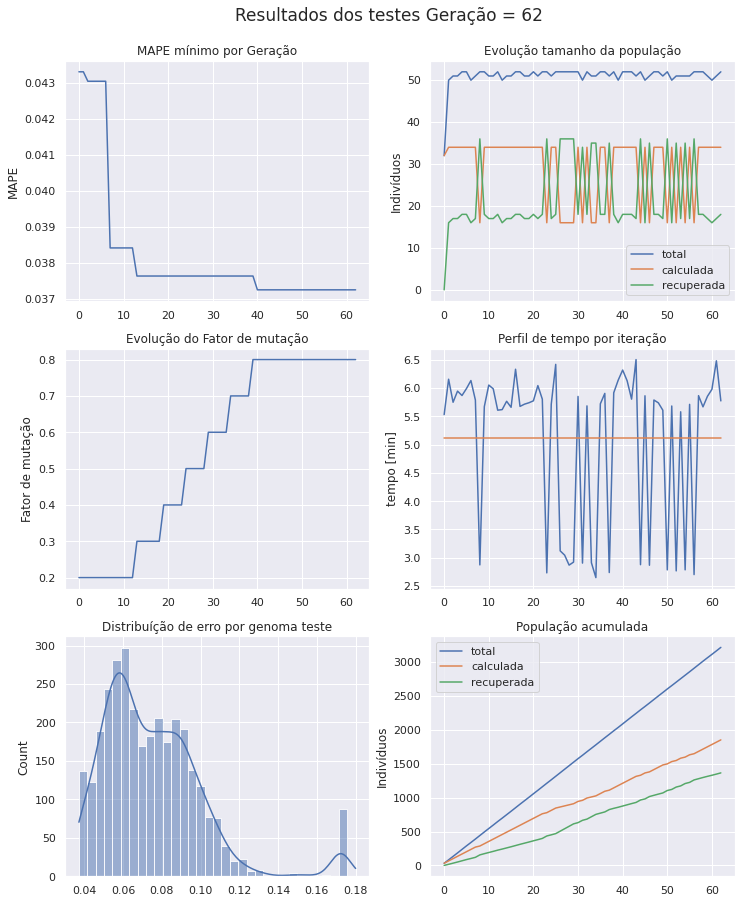

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 63 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [33  6 55 57  2 20 14 46  7 28  8  0 56]
Projenitores [ 1 44 18 14  8 38 51 63 36 10 23  0 45]
Projenitores [54 60 26 45 31 28 55 41  5 15 50 44 43]
Projenitores [34  6 55 45 31  1 51 34 22 30 52 11 29]
Projenitores [17 29 33 26 14 16 12 44 25 30  9 55 57]
Projenitores [26 34  2  4 45 16 28 62 41 12 58 55 38]
Projenitores [40 34 44  6 11 41 53 63 58 19 62  4 19]
Projenitores [42 37 48 37 38 60  0  5 41 46  7  4 32]
Projenitores [26 56 21  4 28 16 28 62 24 12 58 49 59]
Projenitores [32  0  5 37 61 37  0 25 54 40  7  4 57]
Projenitores [30 34 16 21 33  7 54 18 10  7 49 62 17]
Projenitores [32  0  5 60 61 37  6 25 54 40 37 28 57]
Projenitores [50  6 55 45 31  1 25 34 22 38 50 11 11]
Projenitores [50 58 38 35 44 13 25  0  0 38 50 54 11]
Projenitores [40 56 44 24 11 10 53 17 58 

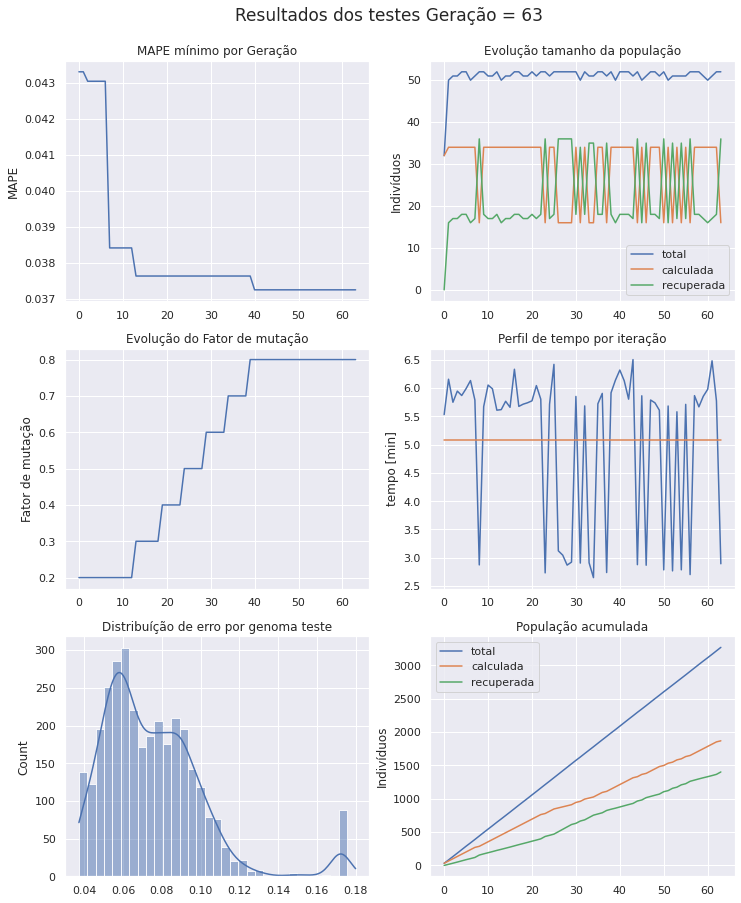

	 Min Erro Atual 0.03725 x 0.03725 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 64 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [11 43 13 61 34 44 15 21 12 63  3 44 60]
Projenitores [33 44 55 14  8 20 51 46 36 10 23  0 56]
Projenitores [39 24 35 42  4 25 54 57 10 47 34 49 43]
Projenitores [34  6 55 45 31  1 51 34 22 30 52 11 29]
Projenitores [17 29 33 26 14 16 12 44 25 30  9 55 57]
Projenitores [32  0  5 37 28 16  0 62 54 40 58  4 57]
Projenitores [17 14  6 55 59 27 36 50 30 17 27 34 41]
Projenitores [50  6 55 45 31  1 25 34 22 38 50 11 11]
Projenitores [ 4  1  8  6  5 26 18 33 43 25 53 29 45]
Projenitores [17 29 33 26 45 16 12 44 41 30 58 55 57]
Projenitores [52 56 21 28 28 24 25 17 24 28 46 49 59]
Projenitores [30 34 16 21 33  7 54 18 10  7 49 62 17]
Projenitores [40 34 44 37 11 60  0  5 41 19  7  4 19]
Projenitores [ 1  6 18 57  2 38 14 63  7 28  8  0 45]
Projenitores [26 56 21  4 61 37 28 25 24 

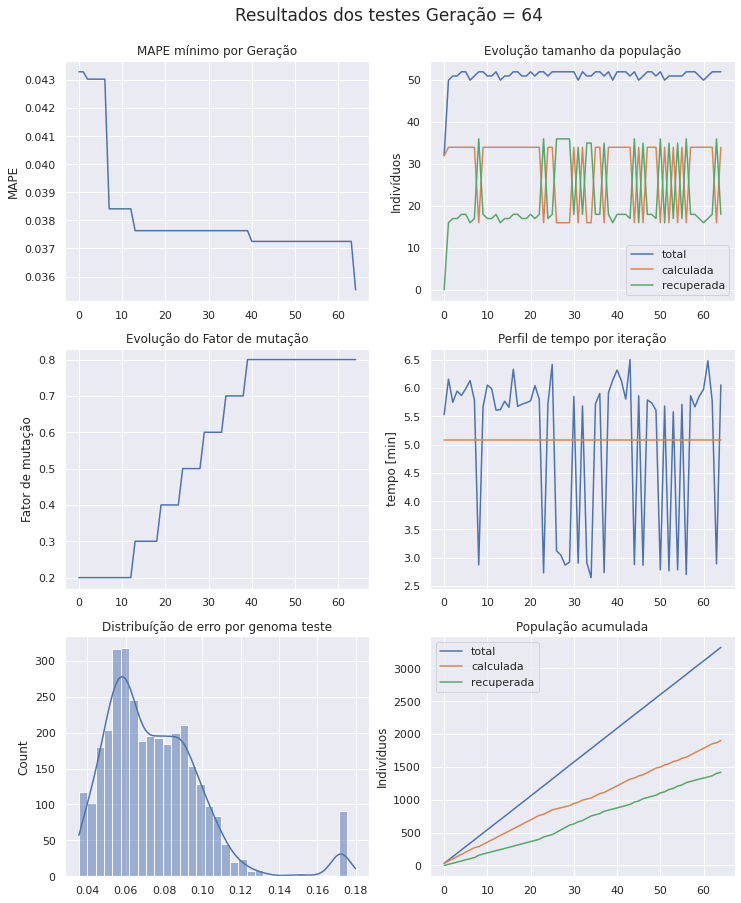

	 Min Erro Atual 0.03553 x 0.03725 Min Erro Anterior
	 parado a 0 epocas
-->>epoca 65 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [52 34 16 28 33  7 54 17 24 28 49 62 17]
Projenitores [33 23 56 24 29 11 39 51 45 14 20  0  1]
Projenitores [28 59 12 61  9 26  5 35 56 16 49 41 10]
Projenitores [40  6 18 57  2 38 14  5 41 19  8  4 45]
Projenitores [11 43 13 61 34 44 15 21 12 63  3 44 60]
Projenitores [32  0  5 37 28 16  0 62 54 40 58  4 57]
Projenitores [17 29 33 26 45 16 12 44 41 30 58 55 57]
Projenitores [52 56 21 28 28 24 25 17 24 28 46 49 59]
Projenitores [30 34 16 21 33  7 54 18 10  7 49 62 17]
Projenitores [ 4 29  8 26  5 16 18 33 43 25 53 55 57]
Projenitores [32 29 33 37 14 16 12 44 25 30 58  4 57]
Projenitores [ 9 56 21  4 32 51 59 25 24 50 43  2 12]
Projenitores [17 29 33 26 14 16 12 44 25 30  9 55 57]
Projenitores [33 44 55 61  8 20 51 21 36 63 23  0 60]
Projenitores [35 43 40 41 42 62 22 46 36 

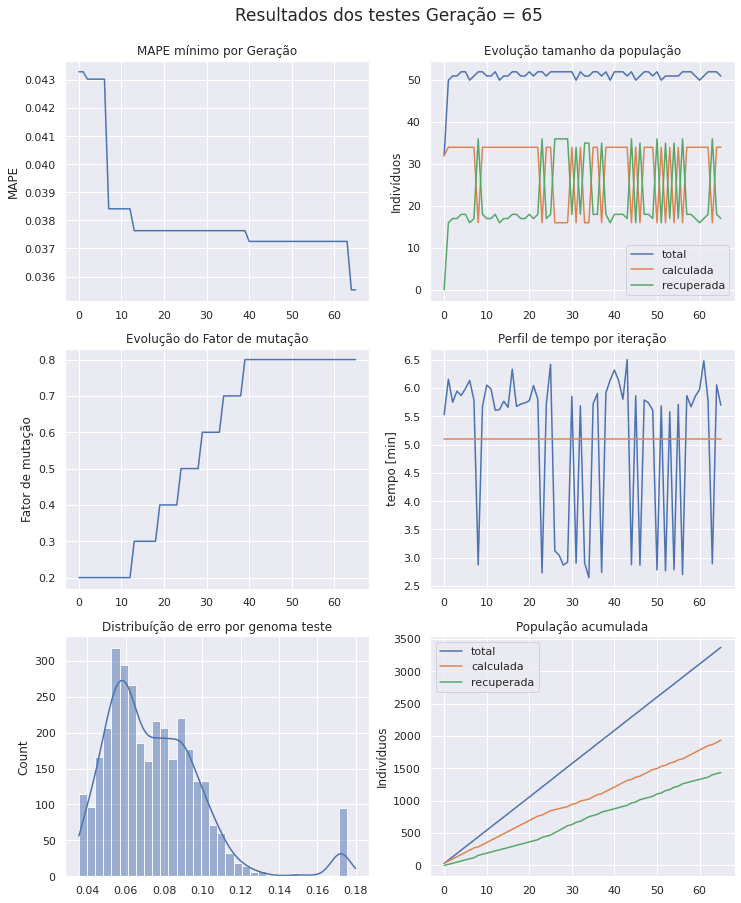

	 Min Erro Atual 0.03553 x 0.03553 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 66 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 9 56 21  4 14 51 59 25 25 50 43  2 57]
Projenitores [52 34 16 28 33  7 54 17 24 28 49 62 17]
Projenitores [33 34 56 24 33 11 39 51 45 28 20 62  1]
Projenitores [38 43 32 25  3 14 22 46 36 31 54 54 50]
Projenitores [ 9 56 21  4 32 51 59 25 24 50 43  2 12]
Projenitores [ 7 53 11  5 18 53  5 53 29  5 21 49  8]
Projenitores [ 3 44 44 60 23 42  2 21  1 49  1 21  7]
Projenitores [58  0  0 21 38 26 22 33 20 24  7 37 30]
Projenitores [14 52 12 63 58  4  9 18  4 54 33 12  8]
Projenitores [57 14 50 31 20  2  0 14 56 12 30 42 40]
Projenitores [28 59 18 57  9 26 14  5 41 19  8 41 10]
Projenitores [52 23 16 28 29  7 54 17 24 14 49  0 17]
Projenitores [60 31  4 19  2  4 60 18  8 14 58 44 12]
Projenitores [28 59 12 61  9 26  5 35 56 16 49 41 10]
Projenitores [13 51 46 18  7 24 28 49 17 

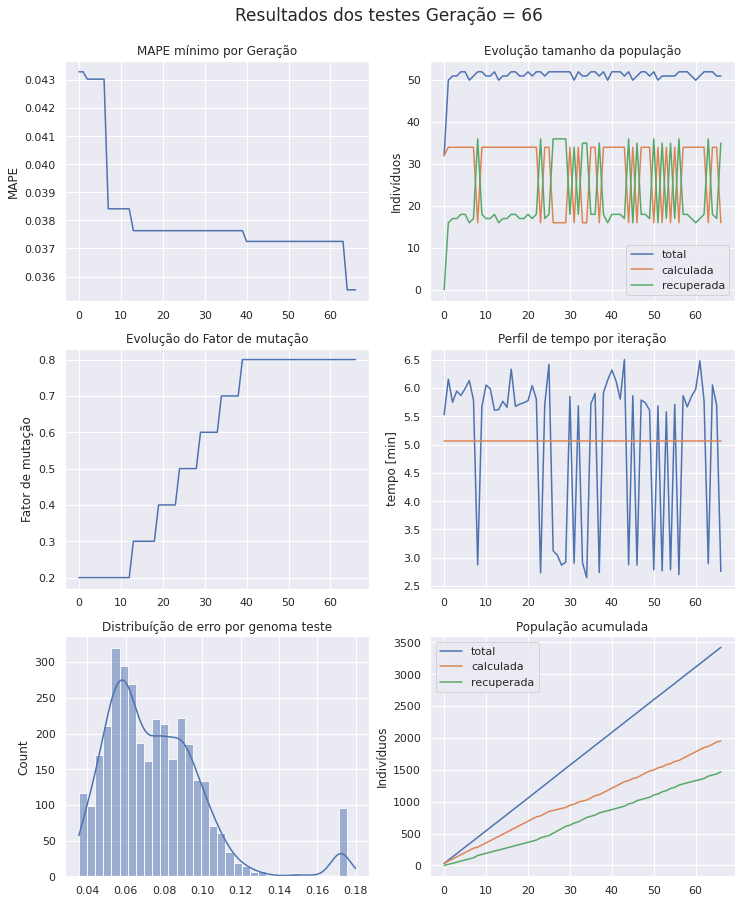

	 Min Erro Atual 0.03553 x 0.03553 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 67 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [52 23 16 57  9  7 54  5 41 14 49  0 17]
Projenitores [ 9 56 21  4 14 51 59 25 25 50 43  2 57]
Projenitores [38 43 56 24 33 14 39 51 45 28 20 62 50]
Projenitores [42 17  9 32 13 62 44  7 28 36 61 42  8]
Projenitores [ 7 26 53 32 14 58 19 26  3 37 21 46 52]
Projenitores [61 58 30 21 44  0 35 13 21  4 34 29  5]
Projenitores [17 51 46 18 45 24 25 44 41 54  9 55 58]
Projenitores [14 12 19 36  9 26 50 60  5 20 55 31 41]
Projenitores [39 63 45 39  0 60 12 40 57  4 42 53 36]
Projenitores [43 32 60 28 60 16 27 53 43  8 20  8 24]
Projenitores [28 12 28 47 46 10 11 35 21 28 49  8 25]
Projenitores [13 51 46 18  7 24 28 49 17 54  9 32 58]
Projenitores [28 59  4 19  9 26  5 35 56 16 49 41 12]
Projenitores [13 29 21 26  7 16 28 49 17 28 58 32 59]
Projenitores [60 26 24 20 62 44 30 17 52 

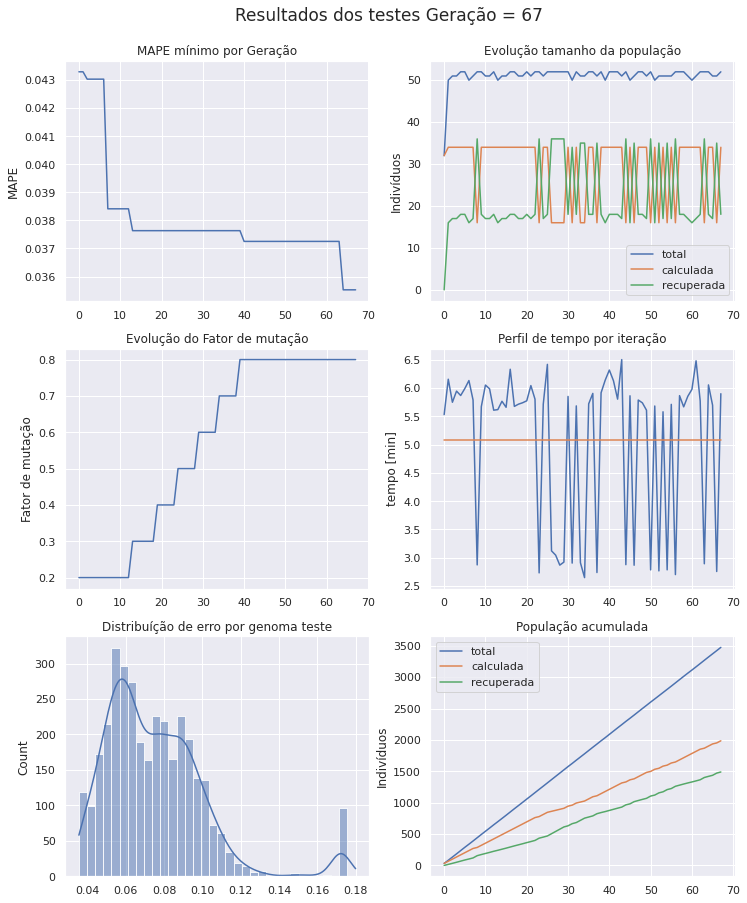

	 Min Erro Atual 0.03553 x 0.03553 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 68 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [60 14 24 31 20 44 30 18 56 32 30 22  8]
Projenitores [46  6 20  3 31 46 12 12  5 44 26 11 59]
Projenitores [ 8 27 43 60 26 13 56 60 37 62 56 50 22]
Projenitores [18  6 29 15 46 53 16 51 37 50 29 12 40]
Projenitores [14 12 19 36  9 26 50 60  5 20 55 31 41]
Projenitores [57 54 14  4 29  5 10 63 28 58 10  5 40]
Projenitores [ 9 23 21 57  9  7 54  5 25 14 43  0 17]
Projenitores [10 13  7 14 45 48 33 60 58  8 60 16 14]
Projenitores [42 29 29  1  9 44 38 61 30 52 30 11  5]
Projenitores [28 59  4 19  9 26  5 35 56 16 49 41 12]
Projenitores [ 7 58 30 32 14  0 35 13 21  4 34 46 52]
Projenitores [43 61 38 18  3  2 28 18 11 40 52 44 51]
Projenitores [ 7 26 53 32 14 58 19 26  3 37 21 46 52]
Projenitores [14 51 46 36 45 24 25 44  5 20 55 31 58]
Projenitores [13 51 46 18  7 24 28 49 17 

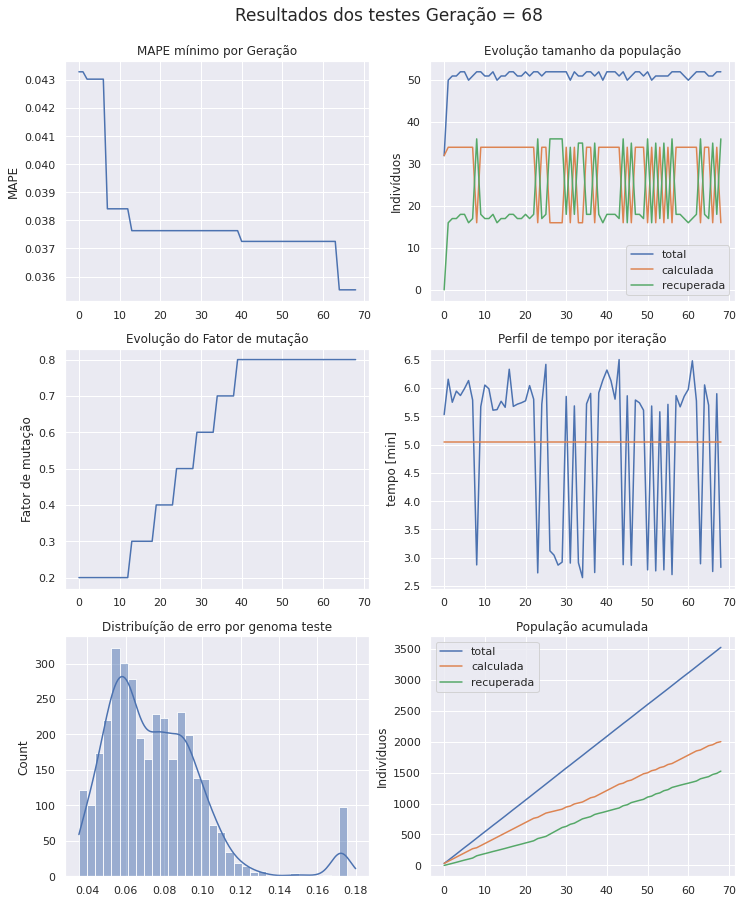

	 Min Erro Atual 0.03553 x 0.03553 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 69 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [34 12 30 49 51 56 40 28 63 50 11 28  8]
Projenitores [11  4 38 55 16 29 15 51 19 55 33 44 20]
Projenitores [52 11 30 12 45 45  2 27 14 40 45 29 30]
Projenitores [46  6 20  3 31 46 12 12  5 44 26 11 59]
Projenitores [20 57 27  4  5 19  1 42 44 57 21 57 56]
Projenitores [43 51 16 29 60 31 46 55 51 56 29 58 41]
Projenitores [14 51 46 36 45 24 25 44  5 20 55 31 58]
Projenitores [10 13  7 14 45 48 33 60 58  8 60 16 14]
Projenitores [45 61 62 36 55  3 25 26 37 53 59 37 55]
Projenitores [60 14 24  3 20 44 30 12 56 32 26 22 59]
Projenitores [ 8  6 29 60 26 13 16 60 37 50 29 12 40]
Projenitores [ 8 27 43 60 26 13 56 60 37 62 56 50 22]
Projenitores [ 9 23 21 57  9  7 54  5 25 14 43  0 17]
Projenitores [52 22 24 51 50  3 48  2 61 45 20 54 54]
Projenitores [42 29 29  1  9 44 38 61 30 

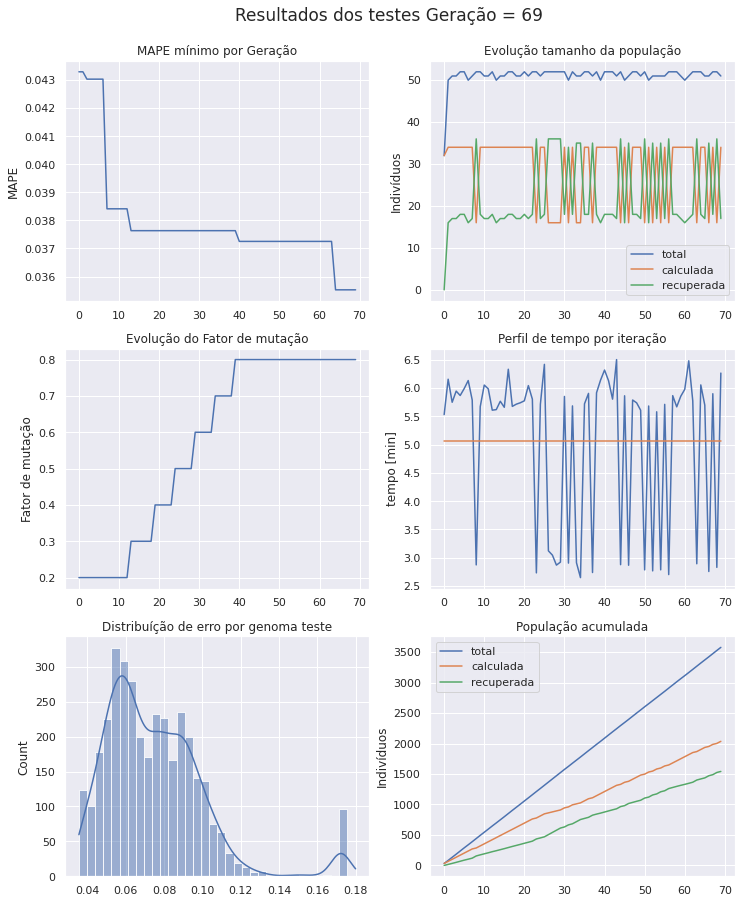

	 Min Erro Atual 0.03553 x 0.03553 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 70 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [45  1 52 58 24 22 48 24 58 29 10 25 42]
Projenitores [52 22 24 51 50  3 48  2 61 45 20 54 54]
Projenitores [ 8 27 43 60 26 13 56 60 37 62 56 50 22]
Projenitores [39 13  7 50 32 48 53  0 38 60 48  3 59]
Projenitores [46 11 20  3 31 46  2 12  5 44 45 11 59]
Projenitores [32 43  0  7  6 56 43 36 13 32  2  0 11]
Projenitores [14 51 46 36 45 24 25 44  5 20 55 31 58]
Projenitores [43 51 16  4  5 19  1 55 44 57 29 57 41]
Projenitores [56 17 25 42 57 28 58 61 14 54 16 49 21]
Projenitores [52 11 30 12 45 45  2 27 14 40 45 29 30]
Projenitores [13 26 46 20 62 24 28 49 17 12 53 42 39]
Projenitores [11 12 30 49 51 29 15 28 19 55 11 44  8]
Projenitores [42  5 49 40 52 48  9 46 17 15 29 22 56]
Projenitores [ 0  8 57  9 61 63 63 44  4 27 47 61 56]
Projenitores [40 30 

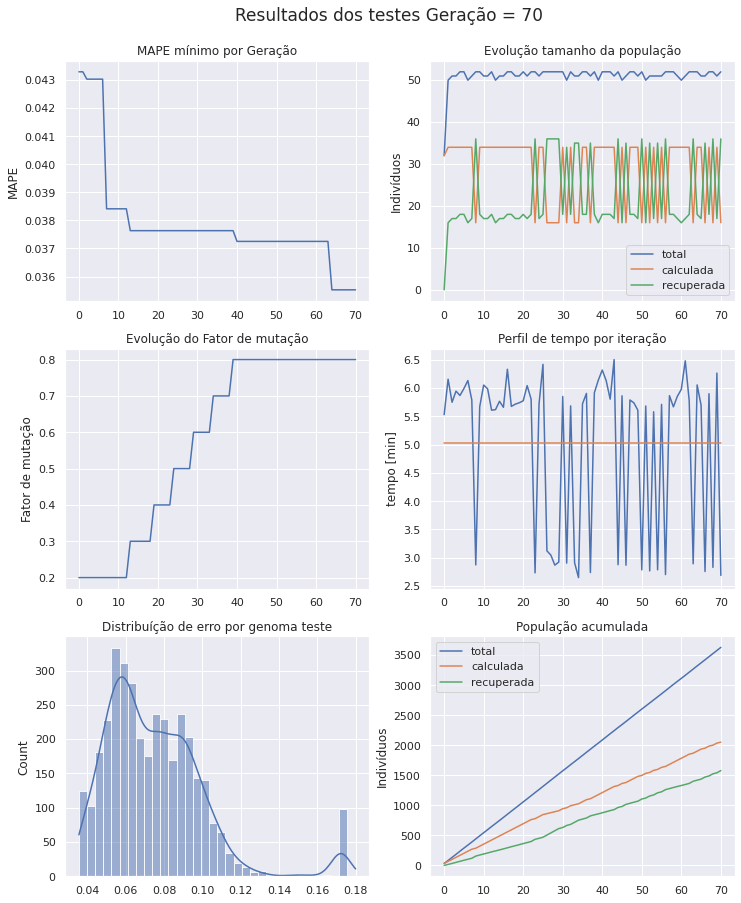

	 Min Erro Atual 0.03553 x 0.03553 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 71 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [46 43 20  7  6 56 43 36 13 44  2  0 59]
Projenitores [19 31  8 26  2 56 52  3 44 61 14 32  4]
Projenitores [21 46 25 16 60 57 54 53 61 19 33 40 32]
Projenitores [ 0  8 57  9 61 63 63 44  4 27 47 61 56]
Projenitores [61  5 23 43 32 11 40 20 10 54 43 37 61]
Projenitores [11 12 30 49 51 29 15 28 19 55 11 44  8]
Projenitores [51 16 32 54  0 38 19 46 42 51 56 60 40]
Projenitores [52 11 30 12 45 45  2 27 14 40 45 29 30]
Projenitores [22 16 51 16 62 10 20 52 56 35 50 33 14]
Projenitores [ 3 45 11 60 22 13 57 45 11 56 16 24 29]
Projenitores [36 59 59 57  6 21 31 13  7 56 24 15 41]
Projenitores [13 12 30 49 51 29 28 28 19 55 11 42  8]
Projenitores [39 13  7 50 32 48 53  0 38 60 48  3 59]
Projenitores [46 11 20  3 31 46  2 12  5 44 45 11 59]
Projenitores [28 59 12 61  9 26  5 35 56 

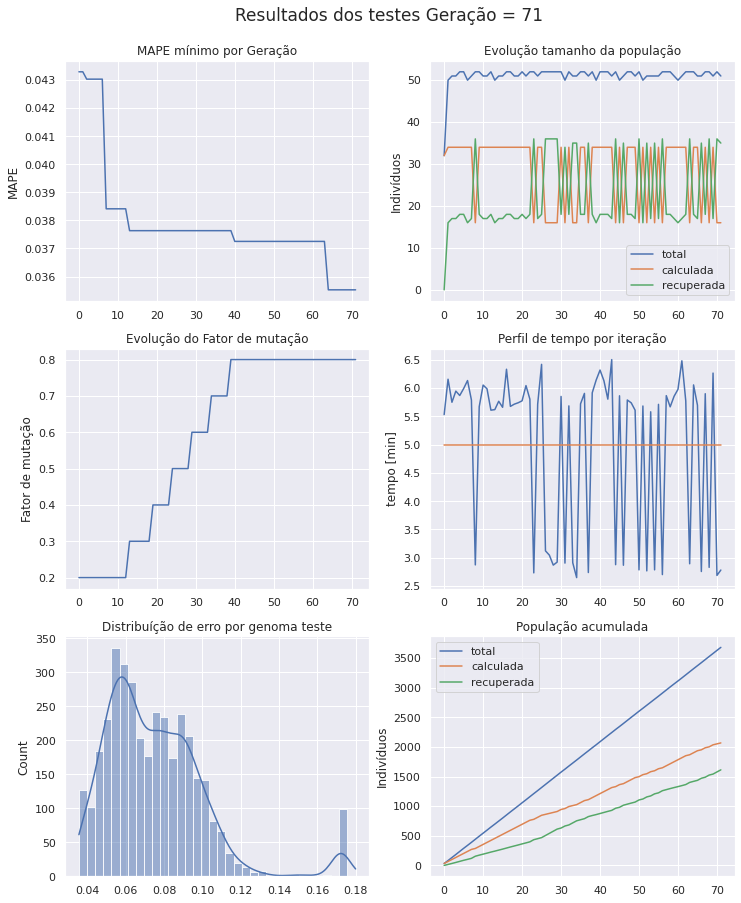

	 Min Erro Atual 0.03553 x 0.03553 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 72 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [46 31  8 26  6 56 52  3 13 61  2 32 59]
Projenitores [36 59 59 57  6 21 31 13  7 56 24 15 41]
Projenitores [22 16 51 16 62 13 57 45 11 35 50 24 14]
Projenitores [46 11  7 50 31 46  2 12  5 44 45  3 59]
Projenitores [56 62 47 50 17 63 12 24 26 39 48 59 22]
Projenitores [ 3 45 11 60 22 10 20 52 56 56 16 33 29]
Projenitores [51 24 59  8 10 53 17 44  2 31 37 27 20]
Projenitores [38 40 40 17 42 20 59  1 50  0 62  6  4]
Projenitores [11 12 23 43 32 11 40 20 10 54 11 44 61]
Projenitores [62 16 62  8 61  1 17 48 35 56 27 40 52]
Projenitores [49 49 55  1 36 27 48 50 48  6 25 55 22]
Projenitores [13 60 45 28 15 59 59 32 29 19 25  6 55]
Projenitores [28 59 12 61  9 26  5 35 56 16 49 41 10]
Projenitores [39 13 20  3 32 48 53  0 38 60 48 11 59]
Projenitores [20 57 27  4  5 19  1 42 44 

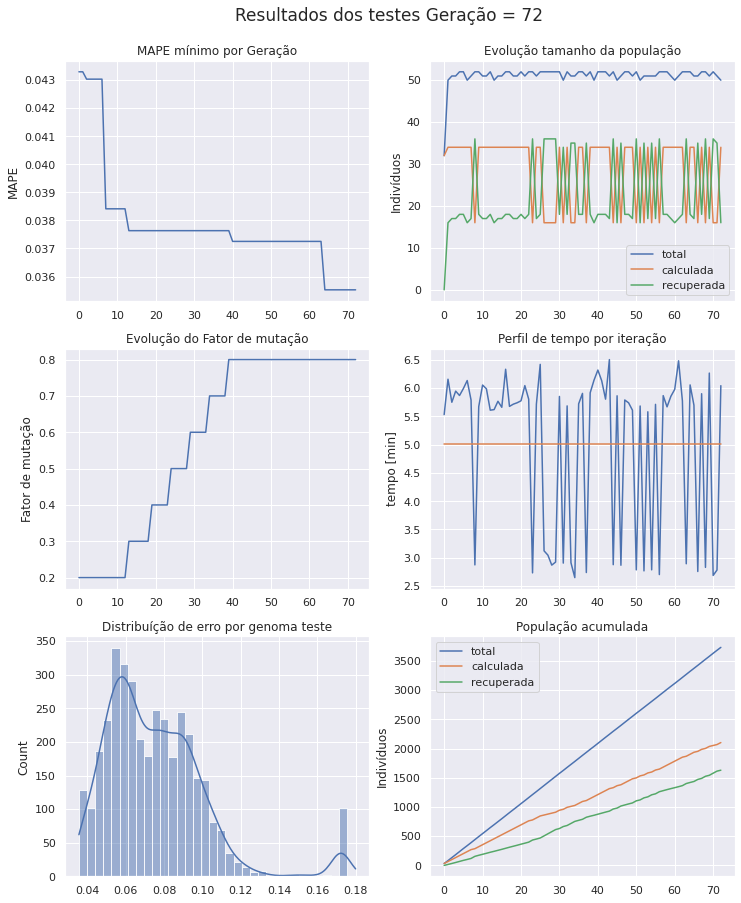

	 Min Erro Atual 0.03553 x 0.03553 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 73 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [28 36 24 30 60  2 20 30 39 54 44  9 28]
Projenitores [38 40 40 17 42 20 59  1 50  0 62  6  4]
Projenitores [53 13 29 21 18 16 33 11 15 43 14  0 10]
Projenitores [53 44 27 28 13 33  4  8 38 25 51 35 25]
Projenitores [11 12 23 43 32 11 40 20 10 54 11 44 61]
Projenitores [51 24 59 17 10 20 17 44 50  0 37 27 20]
Projenitores [26 44  9 22 36  0 34 15 51 63 46 63 12]
Projenitores [ 7 46 22 53 31 40 24  9 32  7 56 28 37]
Projenitores [28 59 12 61  9 26  5 35 56 16 49 41 10]
Projenitores [15 20 32  8 36 38 28 23 16 49 53 17 10]
Projenitores [13 49 45 28 15 59 48 32 29 19 25 55 22]
Projenitores [48 52 10 63 63 33 14 27 51  2 25 33 12]
Projenitores [45 12 14 62 55 48  2 50 30 16 20  2 54]
Projenitores [51 24 59  8 10 53 17 44  2 31 37 27 20]
Projenitores [39 13 20  3 32 48 53  0 38 

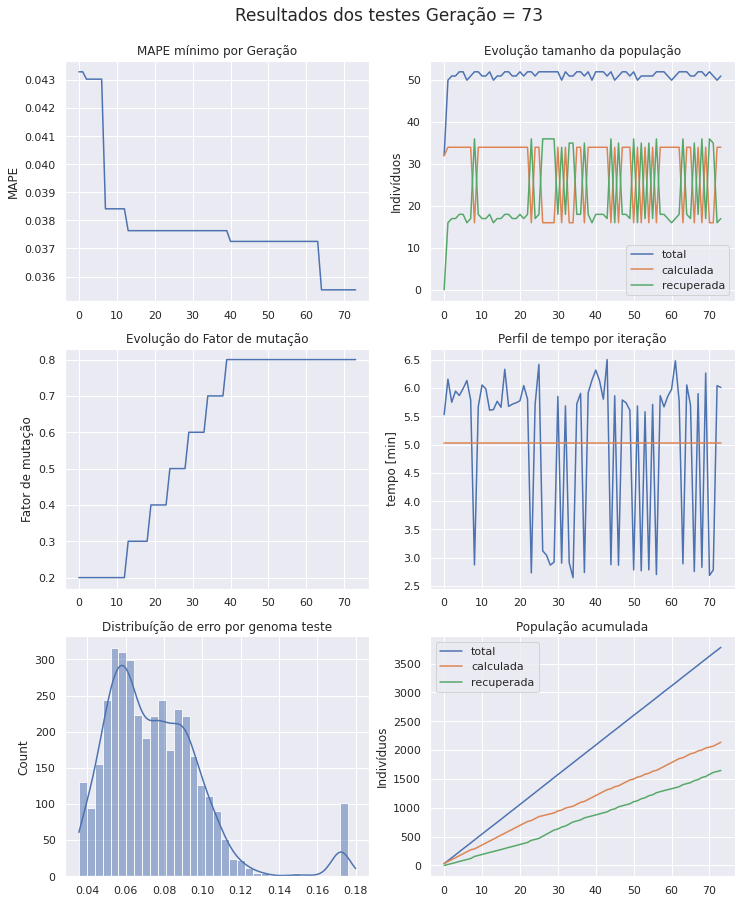

	 Min Erro Atual 0.03553 x 0.03553 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 74 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [48 49 10 28 15 59 48 27 29  2 25 33 12]
Projenitores [15 20 32  8 36 38 28 23 16 49 53 17 10]
Projenitores [45 12 14  8 10 53  2 50  2 16 37  2 54]
Projenitores [27  8 55 54  9 37 35 19 63 56 15 63  0]
Projenitores [11  5  6 51 48 33  0 55  9 27 34 39 26]
Projenitores [18 21  0 51 24 47 46 29 16 58 18 62 38]
Projenitores [ 3 20 32 28 16 26 30 56 22 18 23 35 34]
Projenitores [59  0 51 36 50 47  3 53 15 11 27 19 46]
Projenitores [26 44  9 22 36  0 34 15 51 63 46 63 12]
Projenitores [ 7 46 22 22 31 40 24 15 51  7 46 28 12]
Projenitores [53 44 27 28 13 33  4  8 38 25 51 35 25]
Projenitores [13 49 45 28 15 59 48 32 29 19 25 55 22]
Projenitores [34 26 17 38 52 50 59 32 37 36  9 60 26]
Projenitores [11 24 23 17 32 11 40 20 10  0 37 27 61]
Projenitores [53 44 27 21 18 33 33 11 15 

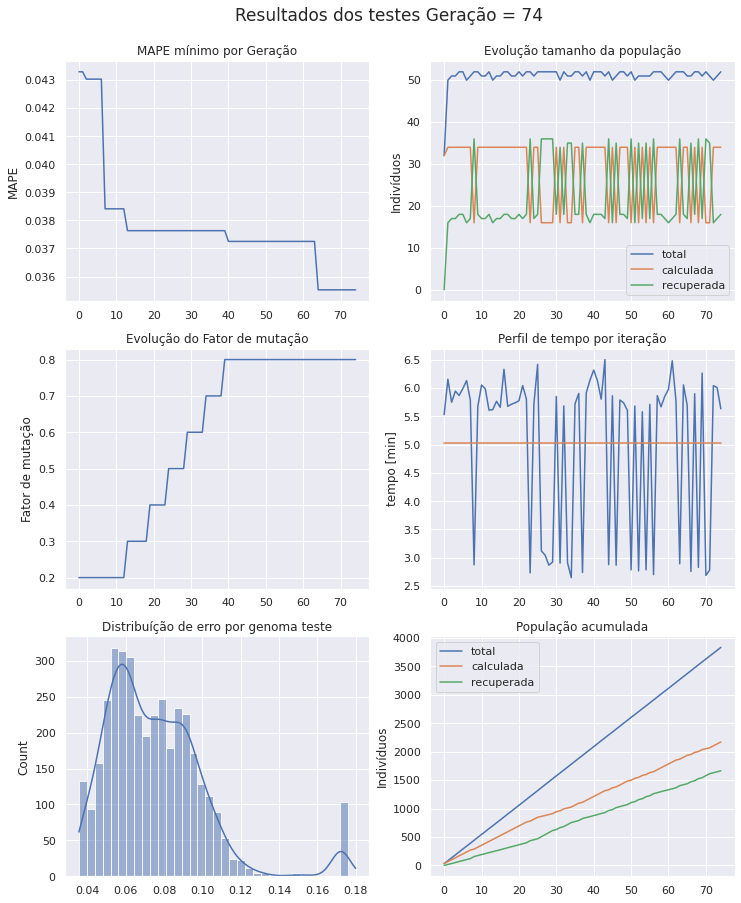

	 Min Erro Atual 0.03553 x 0.03553 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 75 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [59 20 51 28 50 26  3 53 15 18 27 35 46]
Projenitores [53  5 16 35 20 26 44 47 23 33 43 34 23]
Projenitores [15  9  3 33 46 58 49 51 22 53 42  9 12]
Projenitores [11 24 17 38 52 50 40 32 10  0 37 60 61]
Projenitores [11  5  6 51 48 33  0 55  9 27 34 39 26]
Projenitores [52  3 40 13 23 42 34 50 47 23  1 27 53]
Projenitores [44 48 14 27 13 57 52  0  8 26 24 17 40]
Projenitores [20 57 27  4  5 19  1 42 44 57 21 57 56]
Projenitores [28 59 12 61  9 26  5 35 56 16 49 41 10]
Projenitores [13 49 45 28 15 59  4  8 29 25 25 35 25]
Projenitores [34 26 17 38 52 50 59 32 37 36  9 60 26]
Projenitores [27  8 55 54  9 37 35 19 63 56 15 63  0]
Projenitores [13 49 45 28 15 59 48 32 29 19 25 55 22]
Projenitores [45 12 14  8 10 53  2 50  2 16 37  2 54]
Projenitores [49 22 

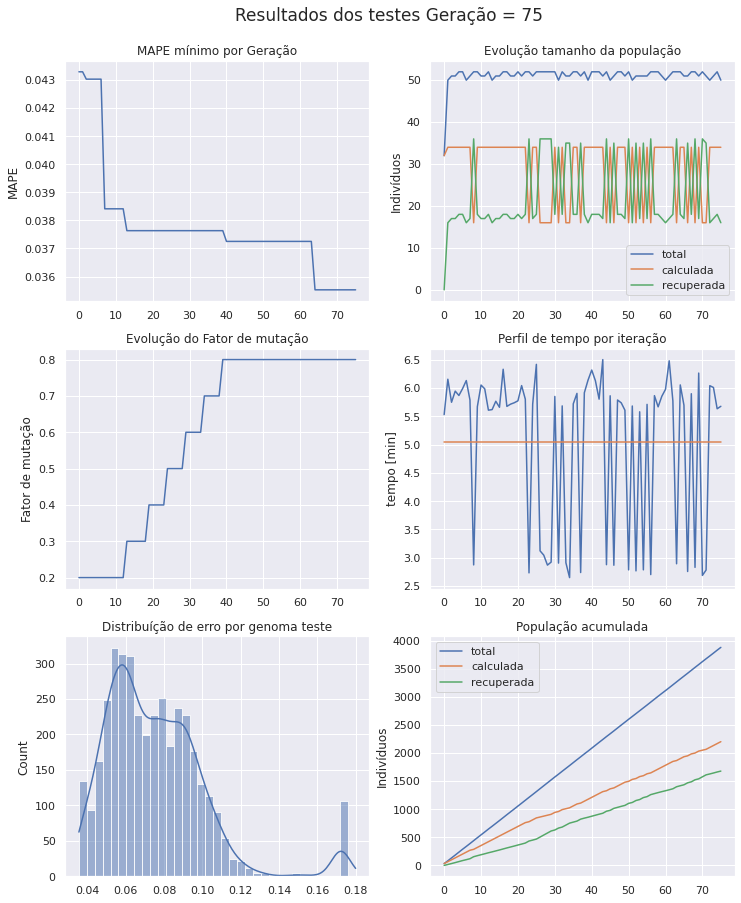

/usr/local/lib/python3.7/dist-packages/pandas/core/generic.py:5170: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


	 Min Erro Atual 0.03553 x 0.03553 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 76 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [28 59 12 61  9 26  4 35 29 16 25 41 10]
Projenitores [27 26 55 38 52 50 35 32 37 56 15 60  0]
Projenitores [47  5 16 21  2 24 53 24 47  4 57 48 13]
Projenitores [13 49 14 28 10 59  2 32  2 19 25 55 54]
Projenitores [36 14 11 16  1 53 35 22 62  2 20 46 33]
Projenitores [13 49 45 28 15 59  4  8 29 25 25 35 25]
Projenitores [ 2 55 11 50  7 33 35 58 18  2 51 41  9]
Projenitores [45  5  9 11 57 43 13 31 21 30 11  1 27]
Projenitores [53  5 51 35 50 26  3 47 15 33 43 35 23]
Projenitores [45 12 14  8 10 53  2 50  2 16 37  2 54]
Projenitores [49 22 16 46  2 33 53 25 47 25 57 48 13]
Projenitores [10  1 20 59 22 22 63 56 48 22 38 45 54]
Projenitores [11  5  6 51 48 33  0 55  9 27 34 39 26]
Projenitores [28 47  2 21 58 62 59 46 31 16  7 16  7]
Projenitores [34 43 39  5  4 48  5 26  2 

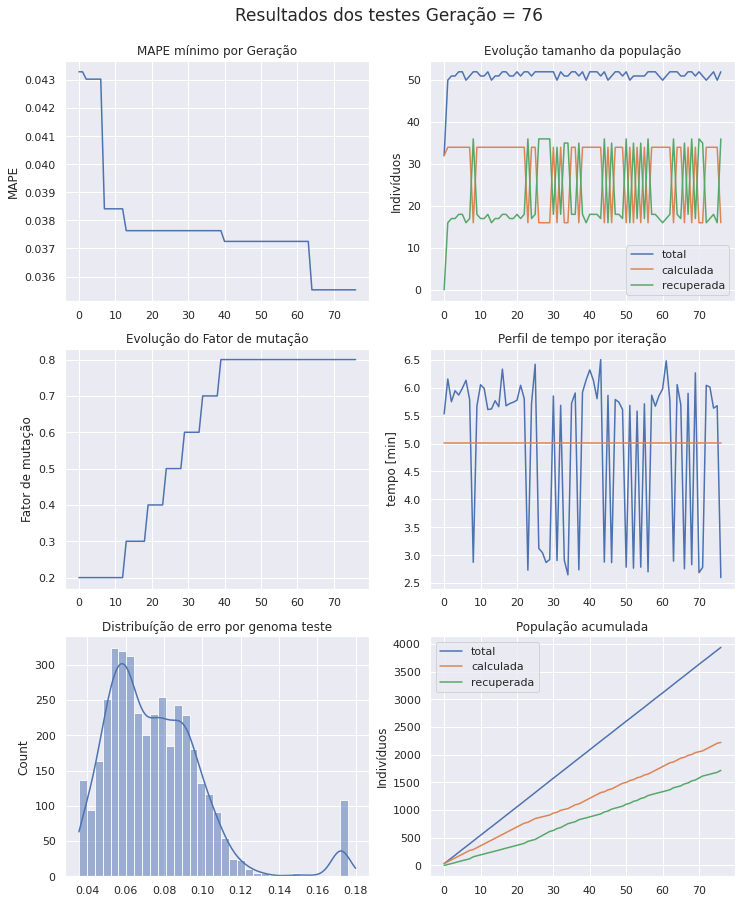

	 Min Erro Atual 0.03553 x 0.03553 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 77 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [22 27 17 17  9 19 47 28 32 34 24  0 17]
Projenitores [28  5  6 21 48 62  0 46  9 16 34 39  7]
Projenitores [13  5 16 28 10 59  2 32 47 19 25 48 54]
Projenitores [44 43 59 51 55 20 42 42 16 20 23 48  6]
Projenitores [53 58 44 51 34 39 12 21 33  1  6 40 57]
Projenitores [34 43 39  5  4 48  5 26  2 16 33 29 24]
Projenitores [13 49 45 28 15 59  4  8 29 25 25 35 25]
Projenitores [45  5  9 11 57 43 13 31 21 30 11  1 27]
Projenitores [ 2 55 11 50  7 33 35 58 18  2 51 41  9]
Projenitores [10  1 20 59 22 22 63 56 48 22 38 45 54]
Projenitores [36 49 11 28  1 59 35  8 29 25 20 46 25]
Projenitores [34 60 17 12 51  0 22 18  6 36 57 21  4]
Projenitores [36 14 11 16  1 53 35 22 62  2 20 46 33]
Projenitores [13 14 45 16 15 53  4 22 62  2 25 35 33]
Projenitores [28 47  2 21 58 62 59 46 31 

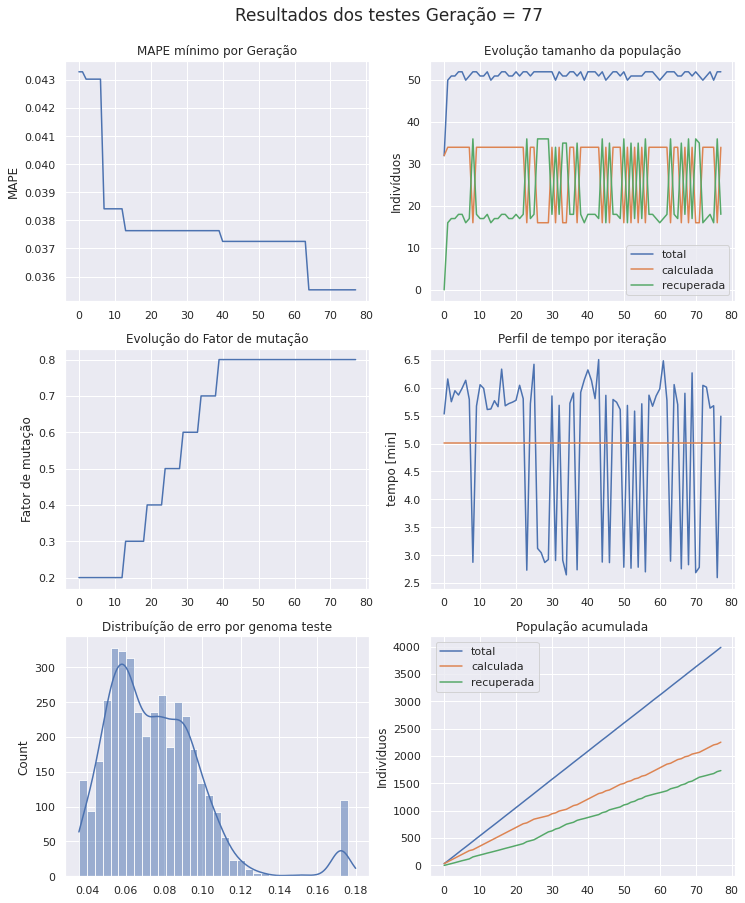

	 Min Erro Atual 0.03553 x 0.03553 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 78 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [45  5 45 28 57 43  4 31 29 25 11 35 25]
Projenitores [36 14 11 16 15 53 35 22 62  2 20 46 33]
Projenitores [34 49 17 12 51  0 35  8  6 36 20 21  4]
Projenitores [14 13 15 47 33 37  7  3 24 24 13  5 26]
Projenitores [10 55 11 59 22 22 63 56 18  2 51 41  9]
Projenitores [34 59 22 30 46 24  6 21  8 50 53 60  6]
Projenitores [22 27 17 17  9 19 47 28 32 34 24  0 17]
Projenitores [19 37 18 35 54  0 34  0  5 20 28  9 60]
Projenitores [34 43 39  5  4 48  5 26  2 16 33 29 24]
Projenitores [34 58 44 51 34 48  5 26 33 16  6 29 57]
Projenitores [16 45 29 29 15 59 57  0 56 20  9 36 13]
Projenitores [53 43 39  5  4 39 12 21  2  1 33 40 24]
Projenitores [47 29 38 29 18 39 22  0 61 49 35 62 47]
Projenitores [20 57 27  4  5 19  1 42 44 57 21 57 56]
Projenitores [45  5  9 11 57 43 13 31 21 

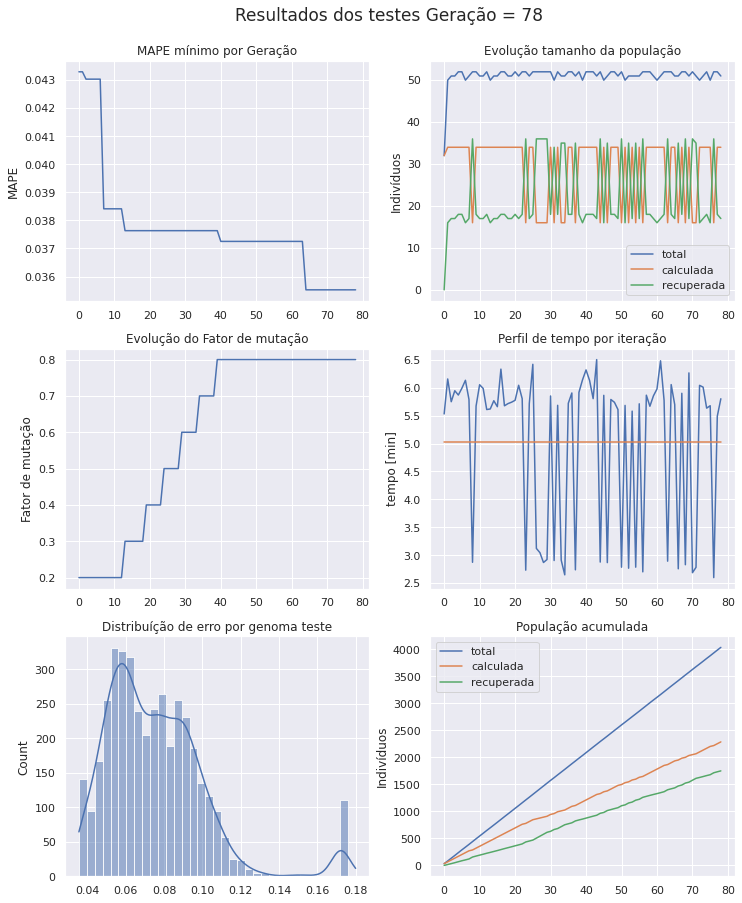

	 Min Erro Atual 0.03553 x 0.03553 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 79 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [20 52 33 15  9 50 44 33 28 25 34 25 20]
Projenitores [34 59 22 30 46 24  6 21  8 50 53 60  6]
Projenitores [45  5  9 11 57 43 13 31 21 30 11  1 27]
Projenitores [36  5 45 28 57 43  4 31 29 25 11 46 25]
Projenitores [44 57 23 14 28 11 27 35 34 30 32 34 39]
Projenitores [14 13 15 47 33 37  7  3 24 24 13  5 26]
Projenitores [34 58 39  5 34 48  5 26 33 16 33 29 57]
Projenitores [10 59 22 30 22 22 63 21 18  2 53 60  6]
Projenitores [18 16 31 56 56 26 41 13 45 11 43  4 47]
Projenitores [45  5 45 28 57 43  4 31 29 25 11 35 25]
Projenitores [19 37 18 35 54  0 34  0  5 20 28  9 60]
Projenitores [53 43 39  5 15 59 12  0  2 20 33 40 24]
Projenitores [16 45 29 29  4 39 57 21 56  1  9 36 13]
Projenitores [10 55 11 59 22 22 63 56 18  2 51 41  9]
Projenitores [45 14 11 16 15 53 35 22 62 

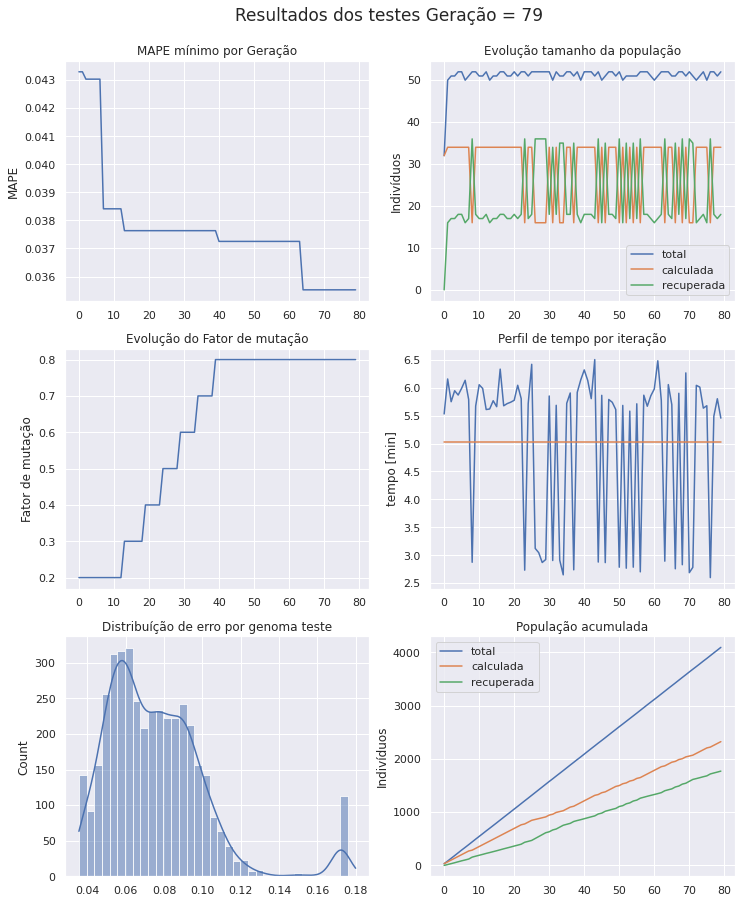

	 Min Erro Atual 0.03553 x 0.03553 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 80 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [14 13 15 47 33 37  7  3 24 24 13  5 26]
Projenitores [20 52 33 15  9 50 44 33 28 25 34 25 20]
Projenitores [13 41 33  4 23 30 28 39 27 39  9  7 22]
Projenitores [10 45 29 29  4 39 63 56 18  2  9 41  9]
Projenitores [36  5  9 11 57 43  4 31 21 25 11  1 25]
Projenitores [17 17 60 16  0 31 37  9  0 52 60 38 62]
Projenitores [10 55 11 59 22 22 63 56 18  2 51 41  9]
Projenitores [22 32  2  3 62 31 35 27 18 62 54 13 58]
Projenitores [45  5 45 28 57 43 13 31 29 30 11 46 27]
Projenitores [40 16 62 10  4 22 19 21  9 35 56 35 48]
Projenitores [21  8 28 63 45 30 59 25 25 14 17 21 62]
Projenitores [34 59 22 30 46 24  6 21  8 50 53 60  6]
Projenitores [61 22 42 16 47 53 35 56 62 40 34 21 59]
Projenitores [10 59 39  5 22 48  5 21 18 16 53 60 57]
Projenitores [18 16 

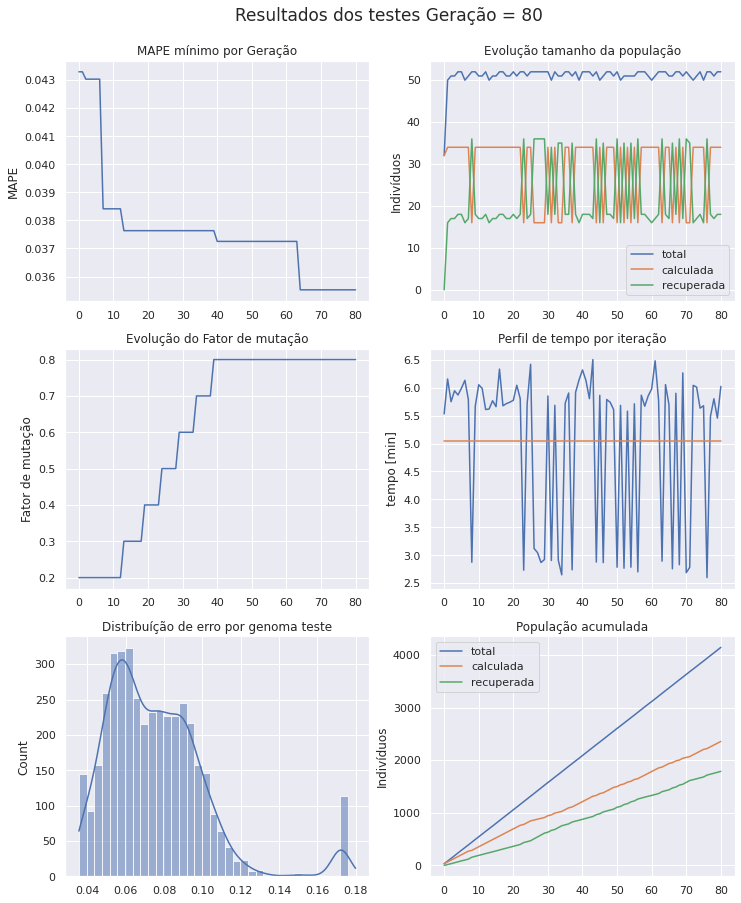

	 Min Erro Atual 0.03553 x 0.03553 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 81 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [42 62  8 55 18 58 28  7 52 32 44 17 21]
Projenitores [20 57 27  4  5 19  1 42 44 57 21 57 56]
Projenitores [18 16 31 56 50 48  4 31 29 43 43  4 25]
Projenitores [40  5 45 10  4 22 13 31 29 35 56 35 48]
Projenitores [28 20 36 24 34 21 26 21 59 28 39 40  7]
Projenitores [17  5  9 11  0 31 37 31 21 52 11 38 25]
Projenitores [19 11 12  0 36 42 37 31 58 38  7 57 13]
Projenitores [28 59 12 61  9 26  5 35 56 16 49 41 10]
Projenitores [ 2 59  4 22  3 36 53  2 25 49 12  3 18]
Projenitores [10 55 11  3 22 22 63 27 18 62 51 41 58]
Projenitores [21  8 28 63 45 30 59 25 25 14 17 21 62]
Projenitores [13 41 33 29  4 39 63 56 27  2  9  7 22]
Projenitores [54 25 34 62  8 40 36 41 49 44 46 48 28]
Projenitores [10 45 29 29  4 39 63 56 18  2  9 41  9]
Projenitores [33 34 57 34 63 55 30 53  7 

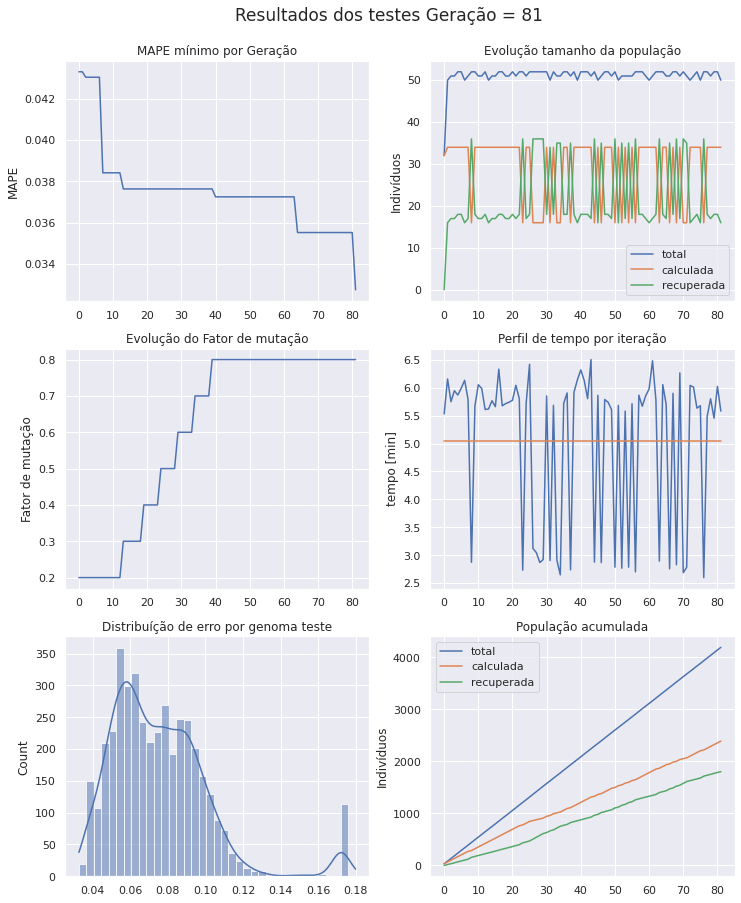

	 Min Erro Atual 0.03276 x 0.03553 Min Erro Anterior
	 parado a 0 epocas
-->>epoca 82 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [25 17 26 44 36 41 14 21 49 12 57 51 48]
Projenitores [42 62  8 55 18 58 28  7 52 32 44 17 21]
Projenitores [60 45 35 26 50 59 53 23 29 59 41  2 53]
Projenitores [50 46 14 56 47 29  7 58 31 17 34 12 39]
Projenitores [20 57  8  4 18 19 28  7 52 57 21 17 21]
Projenitores [23 21  2 59  9 50 51 18  5 46 55 40  8]
Projenitores [28 20 36 24 34 21 26 21 59 28 39 40  7]
Projenitores [21  8 28 63 45 30 59 25 25 14 17 21 62]
Projenitores [33 34 57 34 39 55 30 53  7  1 15  9 51]
Projenitores [37 43 19 47 54 31 55 31 53 30 38 21 12]
Projenitores [ 2 59  4 22  3 22 53 27 18 49 12 41 58]
Projenitores [28 59 12 61  9 26  5 35 56 16 49 41 10]
Projenitores [33 34 57 34 63 55 30 53  7  1  5  9 47]
Projenitores [10 45 29 29  4 39 63 56 18  2  9 41  9]
Projenitores [13  8 28 63  4 30 63 25 25 

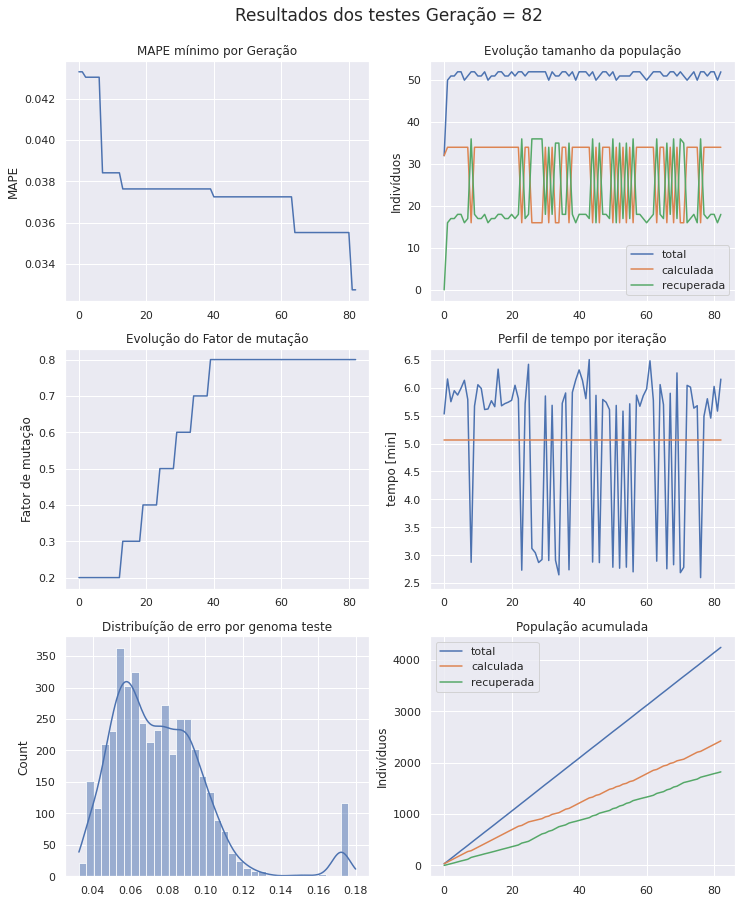

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 83 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [33 34 57 34 39 55 30 53  7  1 15  9 51]
Projenitores [10 34 57 34  4 39 30 56  7  1  5  9 47]
Projenitores [ 7 41 47 41 62 56 48 24 60 52 42 33 55]
Projenitores [18 16 45 56 50 48 13 31 29 43 56  4 25]
Projenitores [20 57  8  4 18 19 28  7 52 57 21 17 21]
Projenitores [13 16 45 63 50 48 63 31 29 43 56 21 62]
Projenitores [25 62  8 44 18 58 28 21 52 32 44 51 21]
Projenitores [47 42 63 23 28 49 39 45  5  8 52  3  4]
Projenitores [10 45 29 29  4 39 63 56 18  2  9 41  9]
Projenitores [28 20 36 63 34 30 26 21 59 28 17 21 62]
Projenitores [45  8 16 19  8 22 28  6  7  3 55 47 54]
Projenitores [42 17 26 55 36 41 14  7 49 12 57 17 48]
Projenitores [33 34 19 47 54 55 55 31  7  1 38 21 12]
Projenitores [28 59 12 61  9 22  5 35 18 49 12 41 58]
Projenitores [23 24 21 42 55 35 31 60 42 

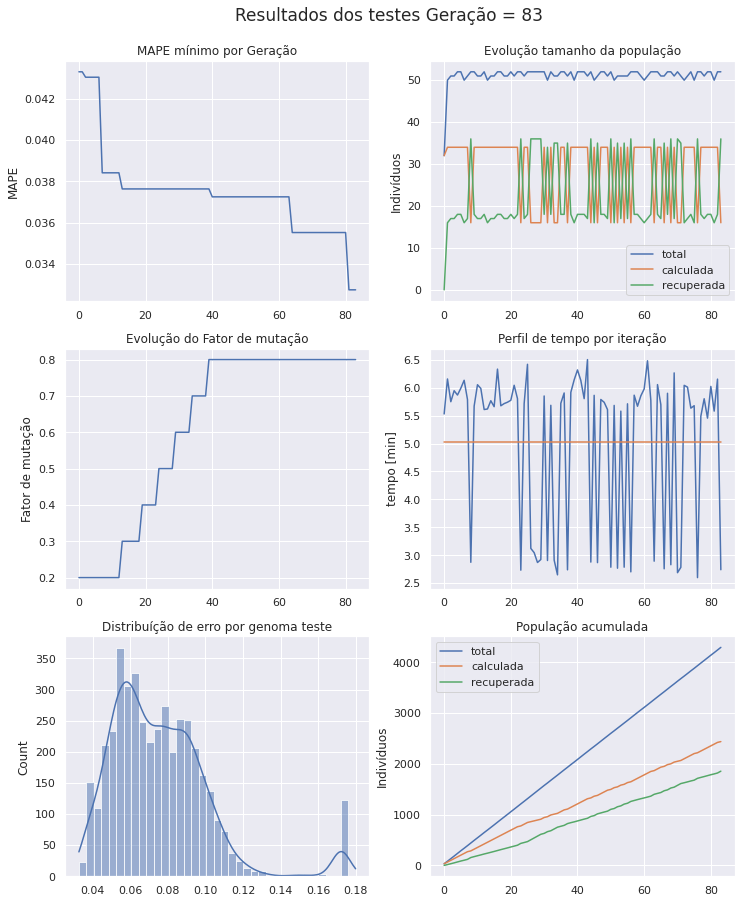

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 84 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 4 52  6 41 43 62 39 49 58  3 42 37 21]
Projenitores [19 57  2  0 39 29 54 60 51 11 33 52 24]
Projenitores [16 59 49  7 54 16 59 10 61 61 24 26 24]
Projenitores [10 34 57 34  4 39 30 56  7  1  5  9 47]
Projenitores [28 20 36 63 34 30 26 21 59 28 17 21 62]
Projenitores [13 16 45 63 50 48 63 31 29 43 56 21 62]
Projenitores [33 34 57 34  4 39 30 53  7  1 15  9 47]
Projenitores [33 45 29 29 63 55 63 60 42 54  9 49 62]
Projenitores [20 57 27  4  5 19  1 42 44 57 21 57 56]
Projenitores [28 20 29 29 34 39 26 56 18  2 17 41 62]
Projenitores [ 7 15 59 48 21 47 25 23 53 59 22 37 63]
Projenitores [23 24 21 42 55 35 31 53 18  2  3 41  9]
Projenitores [33 45 29 29 63 55 63 53 18  2  9 41  9]
Projenitores [45  8 26 19  8 22 28  6 49 12 55 17 48]
Projenitores [ 2 55 46 19 22  4 58 35 31 

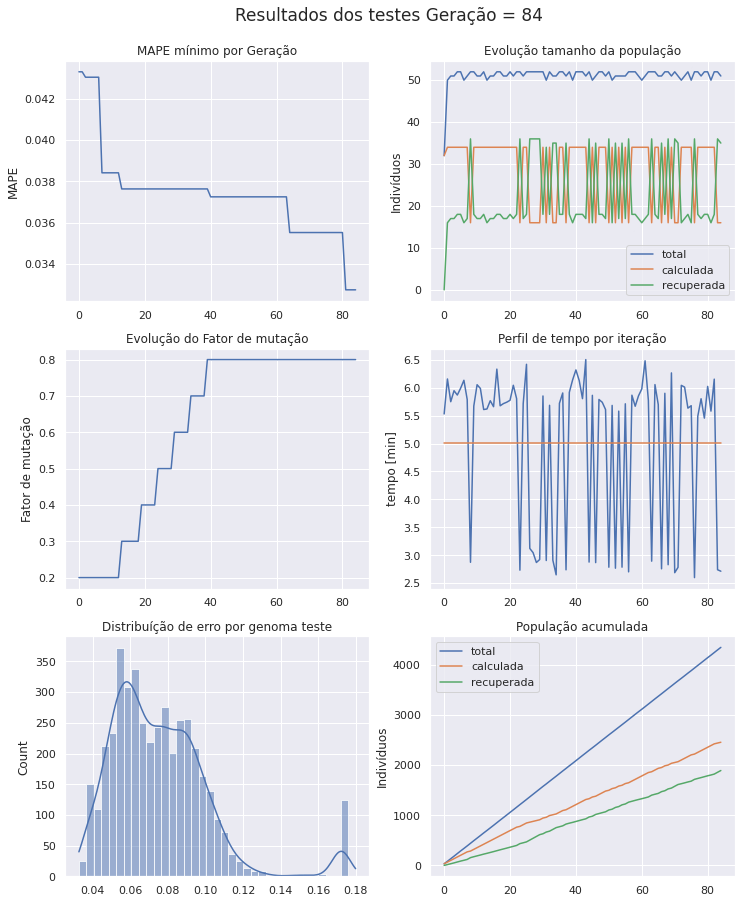

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 85 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [28 20 36 63 34 48 26 31 59 28 56 21 62]
Projenitores [55 58 23 17 48 57 41 53 48 26 63 48 20]
Projenitores [ 7 15 59 48 21 47 25 23 53 59 22 37 63]
Projenitores [23 15 21 48 21 47 31 23 53  2  3 41 63]
Projenitores [ 4 52  2  0 43 29 54 60 58 11 33 52 21]
Projenitores [ 2 55 46 19 22  4 58 35 31 58 19 32 20]
Projenitores [19 57  2  0 39 29 54 60 51 11 33 52 24]
Projenitores [20 20 29  4  5 19 26 42 44  2 17 57 56]
Projenitores [43 16 28 29 35 35 39 10 50 16 51  7 20]
Projenitores [33 34 57 34 63 39 63 53  7  1 15 49 62]
Projenitores [33 45 29 29 63 55 63 53 18  2  9 41  9]
Projenitores [34 61 56  3 35 21 56 12 52 57 37 22 17]
Projenitores [15 32 48 15 61  2 34 22 42  2 40 25  1]
Projenitores [33 45 26 19  8 55 63  6 18 12 55 17 48]
Projenitores [33 45 29 29  4 55 30 60 42 

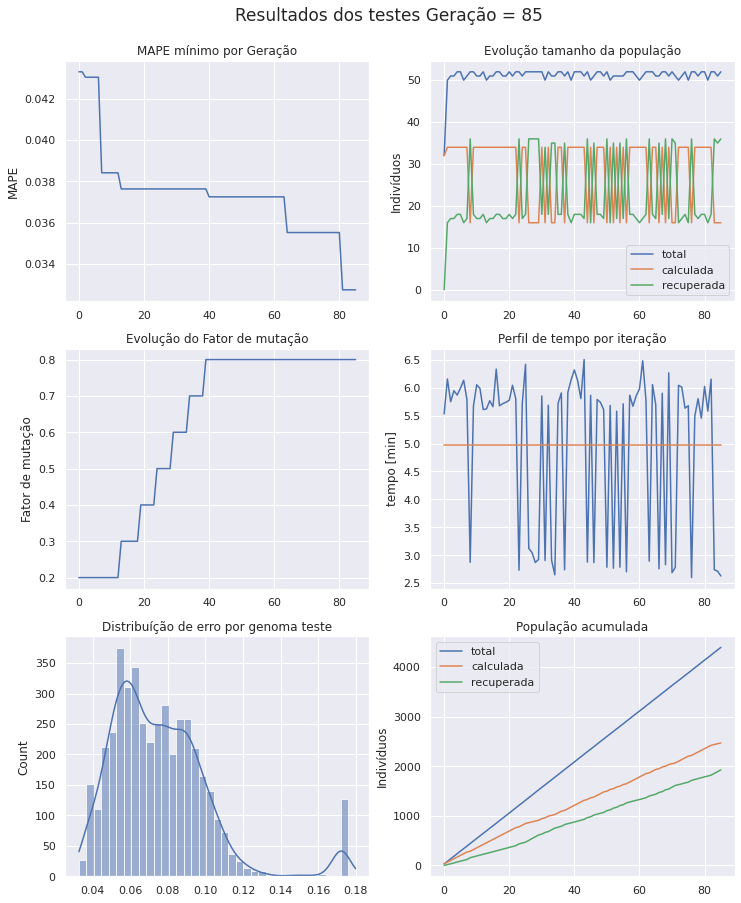

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 86 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [33 34 57 34 63 39 63 53  7  1 15 49 62]
Projenitores [33 45 29 29  4 55 30 60 42 54  9  9 47]
Projenitores [27  6 20 45 30  8  9 14 16 13 54  9 14]
Projenitores [19 45 29 41 39 62 39 49 42 54  9  9 24]
Projenitores [15 32 48 15 61  2 34 22 42  2 40 25  1]
Projenitores [23 15 21 48 21 47 31 23 53  2  3 41 63]
Projenitores [33 32 26 15  8 55 34  6 42  2 55 17 48]
Projenitores [20 57 27  4  5 19  1 42 44 57 21 57 56]
Projenitores [19 57  2  0 39 29 54 60 51 11 33 52 24]
Projenitores [34 61 56  3 35 21 56 53 18  2  9 22 17]
Projenitores [ 4 39 20 11 16 51 27 59 26 40 22  5 26]
Projenitores [25 63 21 30 28 18  9 52 40 29 50 40 49]
Projenitores [33 45 29 29 63 55 63 12 52 57 37 41  9]
Projenitores [20 20 29  4  5 19 26 42 44  2 17 57 56]
Projenitores [55 58 23 17 48 57 41 53 48 

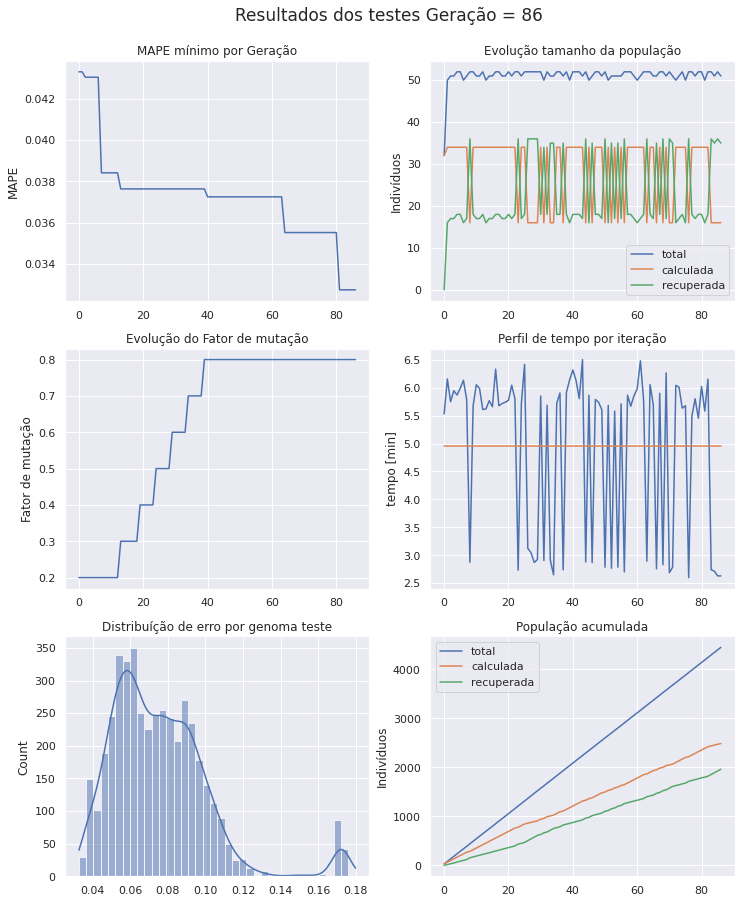

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 87 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [59  7 10 36  7 14 11 25 17 48 55 28 56]
Projenitores [20 20 29  4  5 19 26 42 44  2 17 57 56]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [30 18 16  9 35  1 26 60 12 55 51 49 26]
Projenitores [19 61 56  3 39 29 54 60 51  2  9 52 24]
Projenitores [20 57 26  4  8 55 34  6 44  2 55 17 48]
Projenitores [62 22 56  8 26 30 50 28 11  0 18 51 36]
Projenitores [15 15 48 15 21 47 31 22 42  2  3 41 63]
Projenitores [54 33 51 32  9 31 61 38 47 62 48 60 14]
Projenitores [39 42 24 19 14 47 19  0 42  0 33 15  8]
Projenitores [33 28 33 34 47 36  7  2 12 31 50 23 25]
Projenitores [52 25 61  6 47 15 43 59 53 47 55 42 28]
Projenitores [25 39 21 30 16 18 27 59 40 29 22  5 49]
Projenitores [30 26 30 34 38 11 45 13 44 18 30 37 50]
Projenitores [51 25 

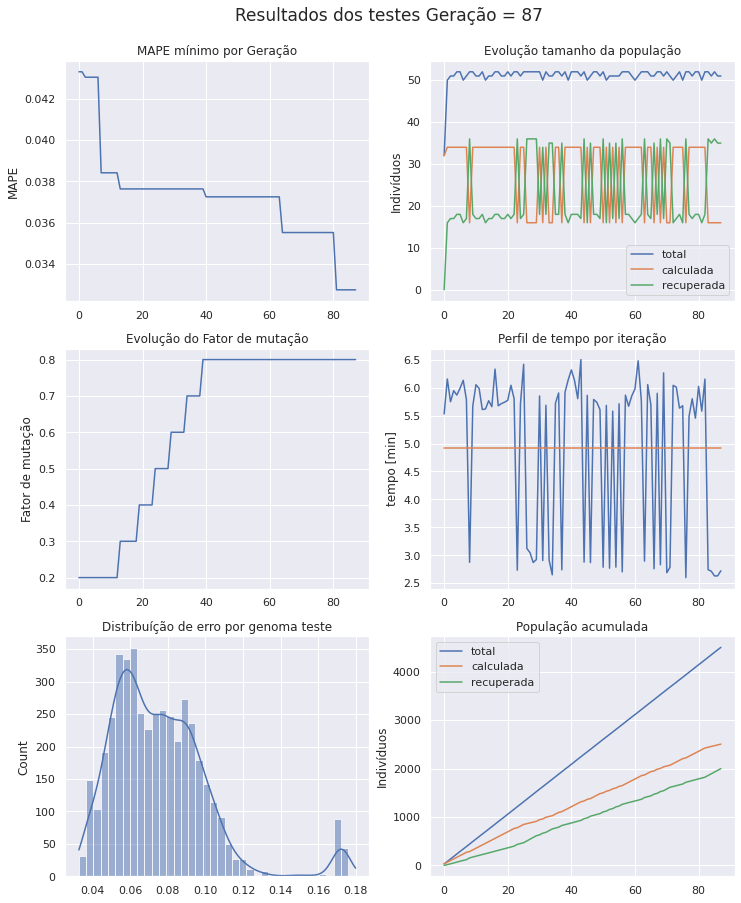

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 88 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [25 26 30 34 16 18 45 13 44 29 30  5 49]
Projenitores [30 18 16 29 35  1 63 41 49 55 51 49 28]
Projenitores [62 52 44 31 24  5 31 30 48 52 51 35 58]
Projenitores [50 54  7 52 21 36 24 11 10 31 59 45 29]
Projenitores [19 61 56  3 39 29 54 60 51  2  9 52 24]
Projenitores [33 28 61 34 47 15  7 59 53 47 50 42 28]
Projenitores [30 39 21 30 38 11 27 59 40 18 22 37 50]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [23 15 63 48 21 43 31  7  6 49 22 19 63]
Projenitores [54 45 29  9  8 39 26 60 12 44 46 41 26]
Projenitores [54 42 51 32  9 31 19 38 47 62 33 15 14]
Projenitores [20 20 29  4  5 19 26 42 44  2 17 57 56]
Projenitores [39 49 32 15 22 63  5 47 33 47 47 50 62]
Projenitores [51 25 63  4 29 43 45  7  6 49 22 19 25]
Projenitores [37 28  4 41  6 48 59 23 41 

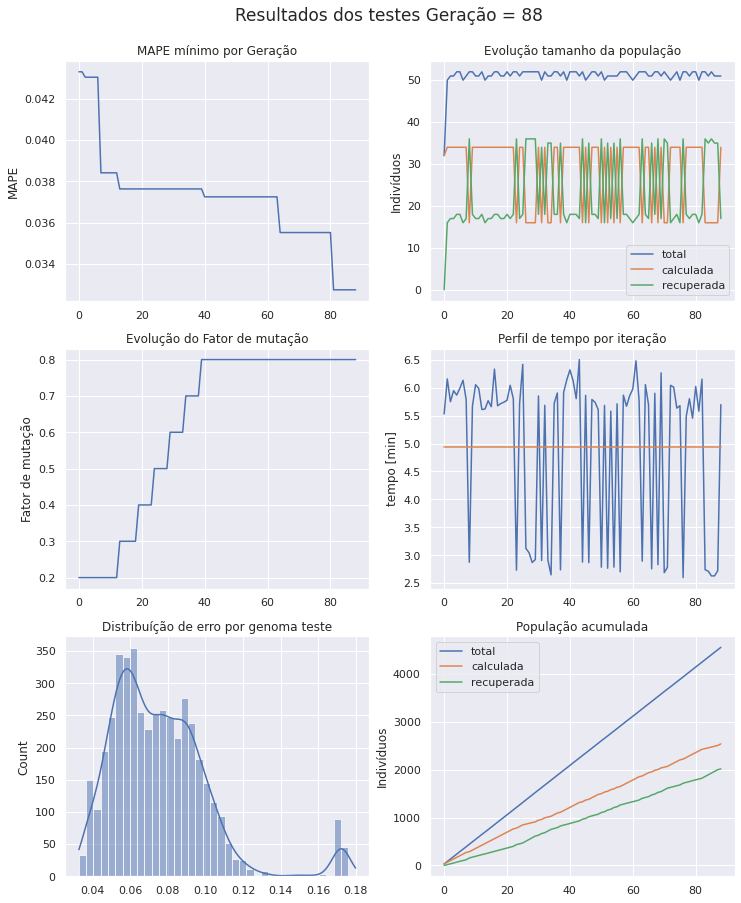

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 89 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [25 18 16 34 35  1 45 41 44 29 30  5 28]
Projenitores [54 39 29 29  8 39 27 41 40 44 22 41 28]
Projenitores [33 30  4 22 56 27 38 23 61 50 32 31 40]
Projenitores [54 42 51 32  9 31 19 38 47 62 33 15 14]
Projenitores [20 20 51 32  9 19 26 42 44 62 33 57 14]
Projenitores [25 26 30 34 16 18 45 13 44 29 30  5 49]
Projenitores [19 61 61 34 47 29  7 59 51 47 50 42 24]
Projenitores [31 54 13  1 41 48 34 20 17 35 60 59 47]
Projenitores [30 26 30 29 16 18 63 13 49 55 51 49 49]
Projenitores [30 18 16 29 35  1 63 41 49 55 51 49 28]
Projenitores [13 54 36  8 33 23 13 28 35 58 55 13  4]
Projenitores [54 15 29 48  8 39 26  7 12 44 22 19 26]
Projenitores [57 58 40 24 61 27 44 55 18 33 40  6 24]
Projenitores [35 51 63 34 50 26 47 23 46 38 23 25 16]
Projenitores [62 52 44 31 24  5 31 30 48 

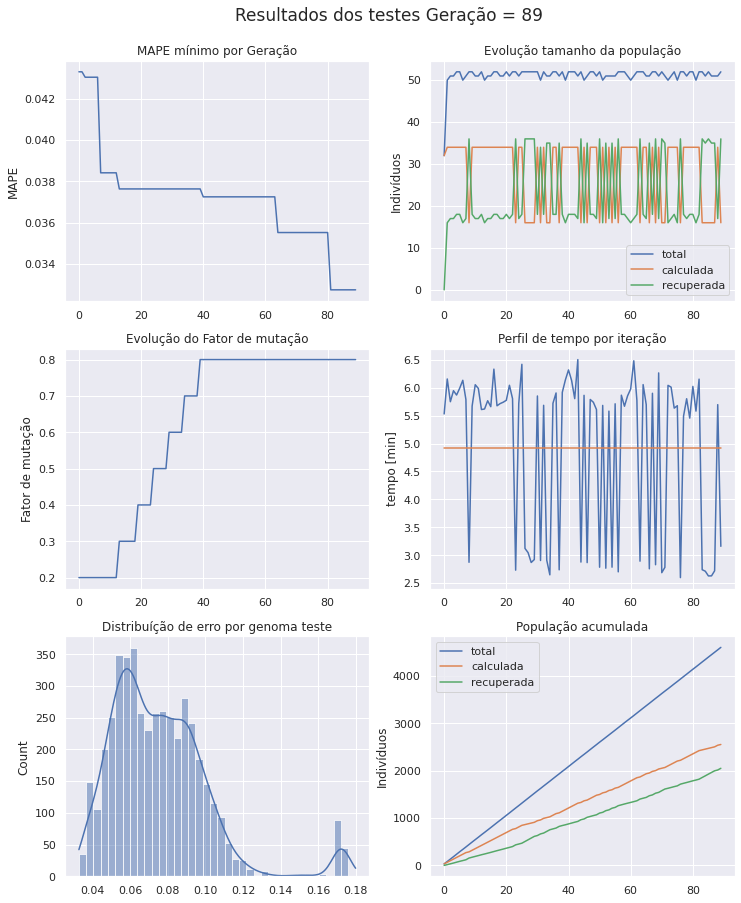

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 90 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [57 51 63 24 50 26 47 55 18 33 40  6 16]
Projenitores [36 52 39 31 24  5 61 36 43 52 26 35 58]
Projenitores [54 39 29 29  8 39 27 41 40 44 22 41 28]
Projenitores [32 12  1 30 60 41 24 18 51 33  2 44 28]
Projenitores [19 61 61 34 47 29  7 59 51 47 50 42 24]
Projenitores [13 54 36  8  8 39 26  7 12 44 55 13 26]
Projenitores [20 57 27  4  5 19  1 42 44 57 21 57 56]
Projenitores [54 42 51 32  9 31 19 38 47 62 33 15 14]
Projenitores [52 14 17 39 35 17 28 22 38 41 10 13  6]
Projenitores [27 49 49 47 13 40 14 45 23 16 28 42 45]
Projenitores [30 26 30 29 16 18 63 13 49 55 51 49 49]
Projenitores [19  9 48 28 51 47 10 59  4 23 14 63 21]
Projenitores [54 42 51 22 56 31 19 23 61 50 32 15 14]
Projenitores [54 15  5 17 42 20 54 48 22 37 13 49 50]
Projenitores [25 18 29 29  8  1 27 41 44 

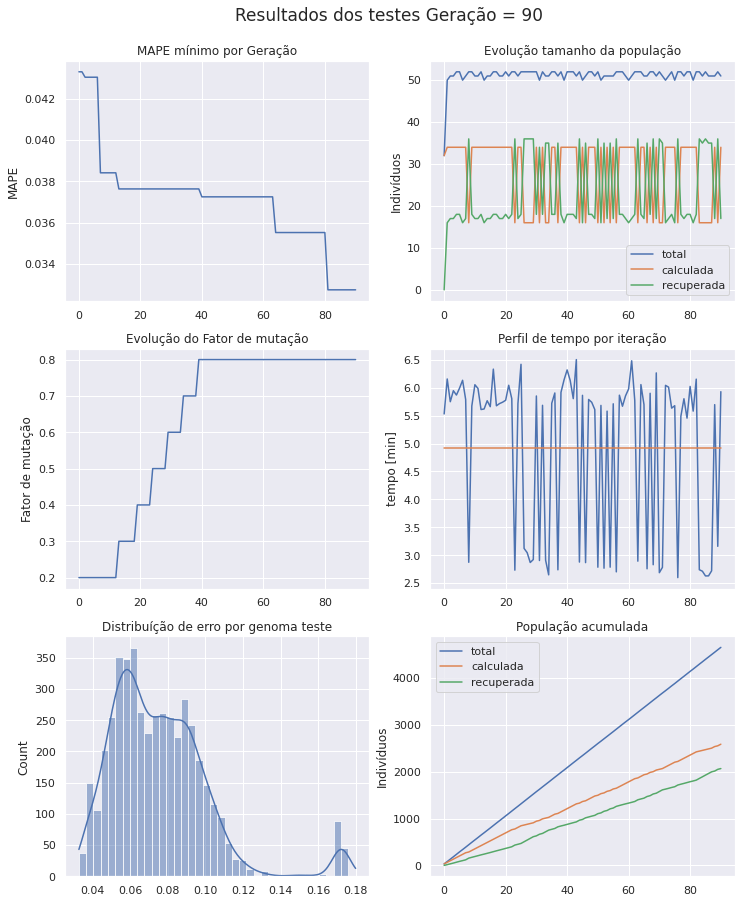

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 91 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [19 61 61 34 47 29  7 59 51 47 50 42 24]
Projenitores [56 31  9 56 12 40 17  6 42 24 22 22 56]
Projenitores [25 18 29 29  8  1 27 41 44 44 22  5 28]
Projenitores [54 42 51 22 56 31 19 23 61 50 32 15 14]
Projenitores [32 12  1 30 60 41 24 18 51 33  2 44 28]
Projenitores [36 52 63 31 24  5 61 36 43 33 26  6 16]
Projenitores [21 34 47 59 47  1 46 33 50  9 60 42 22]
Projenitores [59 38 59 29 24  0  2 14 24 39 53 28 20]
Projenitores [17 31 22 44 14  1  5 14 31 18 42 26 63]
Projenitores [28 40 47 28 15 60 32 13 38 17 10 25 31]
Projenitores [25 18 29  8 33 23 13 28 44 58 55  5  4]
Projenitores [27 49 49 47 13 40 14 45 23 16 28 42 45]
Projenitores [19  9 48 28 51 47 10 59  4 23 14 63 21]
Projenitores [57 51 39 24 50 26 47 55 18 52 40 35 58]
Projenitores [20 42 27 32  5 31  1 38 47 

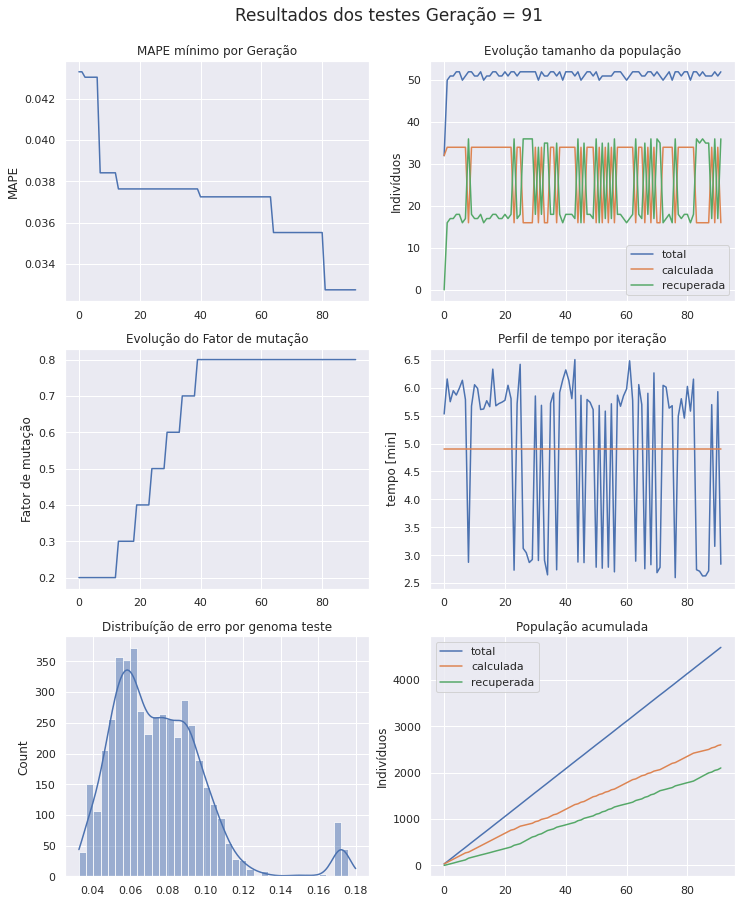

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 92 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [30 43 15 14  5  1 15 22 51 18 19 28 17]
Projenitores [10 55  2 50 15 62 30 36 32 24 51  5 34]
Projenitores [57 51 39 24 50 26 47 55 18 52 40 35 58]
Projenitores [36 52 63 31 24  5 61 36 43 33 26  6 16]
Projenitores [20 42 27 32  5 31 19 48 22 62 33 15 14]
Projenitores [61 30 52 35 31 34 54 19 36 28  4 41 62]
Projenitores [25 18 49  8 13 23 14 45 23 16 55  5  4]
Projenitores [63 63 26  4 30 23 29 53 32 27  2 12  4]
Projenitores [27 49 29 47 33 40 13 28 44 58 28 42 45]
Projenitores [27 49 49 47 13 40 14 45 23 16 28 42 45]
Projenitores [32 12  1 30 60 41 24 18 51 33  2 44 28]
Projenitores [17 40 47 44 15 60  5 14 38 17 10 26 31]
Projenitores [32 52 63 31 24 41 61 18 51 33  2  6 28]
Projenitores [25 29 30 19  2 34 47 46 59  8 41 51 37]
Projenitores [28 31 

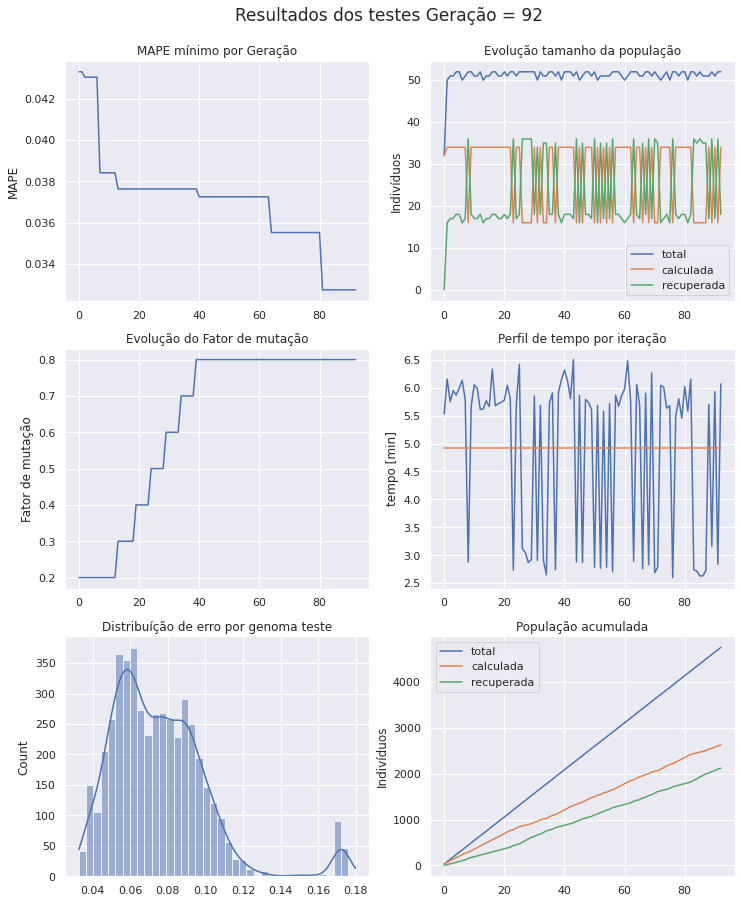

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 93 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [25 29 30 19  2 34 47 46 59  8 41 51 37]
Projenitores [25 52 63 19 24 41 47 46 51 33 41  6 37]
Projenitores [35 48 19 55  3 23  3 31  2 54 29 38 18]
Projenitores [27 49 49 47 33 40 14 28 23 58 28 42 45]
Projenitores [17 23 48 11 30 26 57  8 51 61 20 52 10]
Projenitores [36 52 63 31 24  5 61 36 43 33 26  6 16]
Projenitores [20 42 27 32  5 31 19 48 22 62 33 15 14]
Projenitores [30 43  2 50 15 62 15 22 51 24 51  5 17]
Projenitores [54 42  5 22 42 20  1 38 47 37 13 15 14]
Projenitores [47  7  0 35 60 55 37  1 30 27 31 29  6]
Projenitores [ 0 49 34 14 51 30 40 10  5 58 15 53 52]
Projenitores [25 63 26  8 30 23 29 45 32 27 55 12  4]
Projenitores [54 31 22 22 14  1  1 38 47 18 13 25 63]
Projenitores [32 12  1 30 60 41 24 18 51 33  2 44 28]
Projenitores [32 52 63 31 24 41 61 18 51 

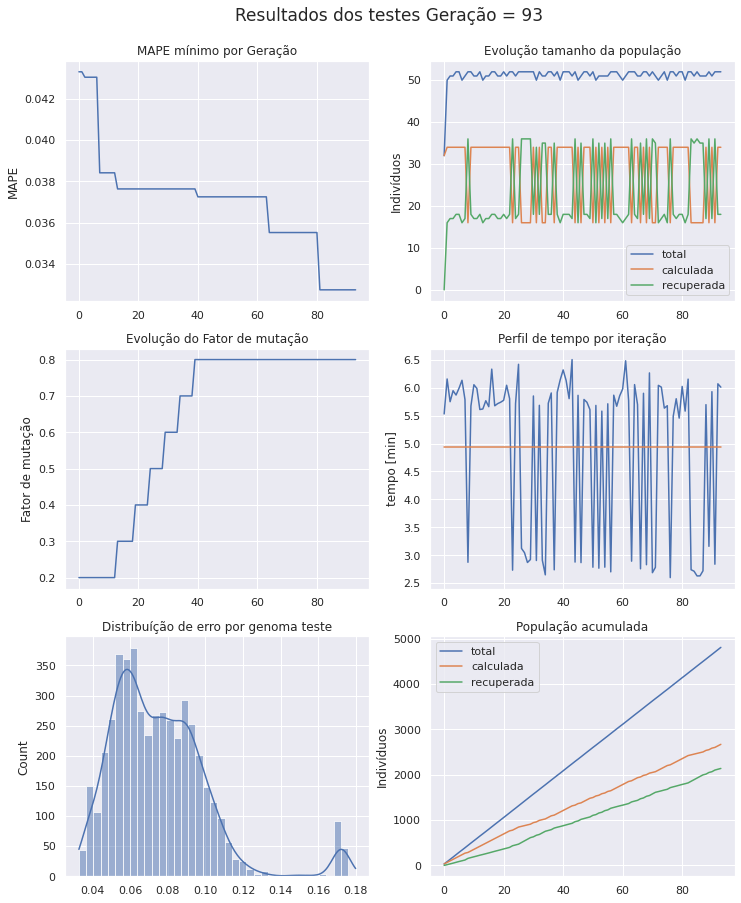

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 94 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [25 63 26 14 51 30 29 45  5 27 15 53  4]
Projenitores [36 52 63 31 24  5 61 36 43 33 26  6 16]
Projenitores [17 23 63 11 24 26 57  8 43 61 20 52 10]
Projenitores [54  7  0 35 42 55 37  1 47 27 13 29 14]
Projenitores [27 49 49 47 33 23  3 28 23 58 28 38 45]
Projenitores [10 55 63 31  5 41 61 18 51 18  2  6 28]
Projenitores [32 31 22 22 60 41 24 18 51 33  2 44 63]
Projenitores [35 48 19 55  3 40 14 31  2 54 29 42 18]
Projenitores [27 49 49 47 33 40 14 28 23 58 28 42 45]
Projenitores [36 32 24 51  5 34 63 63 26  4 30 23 29]
Projenitores [53 33  5 19 46 55 45 27 47 39 17 50 17]
Projenitores [31 38 37 20  2 26 10 32 31 49 34 53 10]
Projenitores [24 59 50 18  7 32 17 32 53  9  0 63 13]
Projenitores [25 52 63 19 24 41 47 46 51 33 41  6 37]
Projenitores [21 56 32 24 38 53  6 27  4 

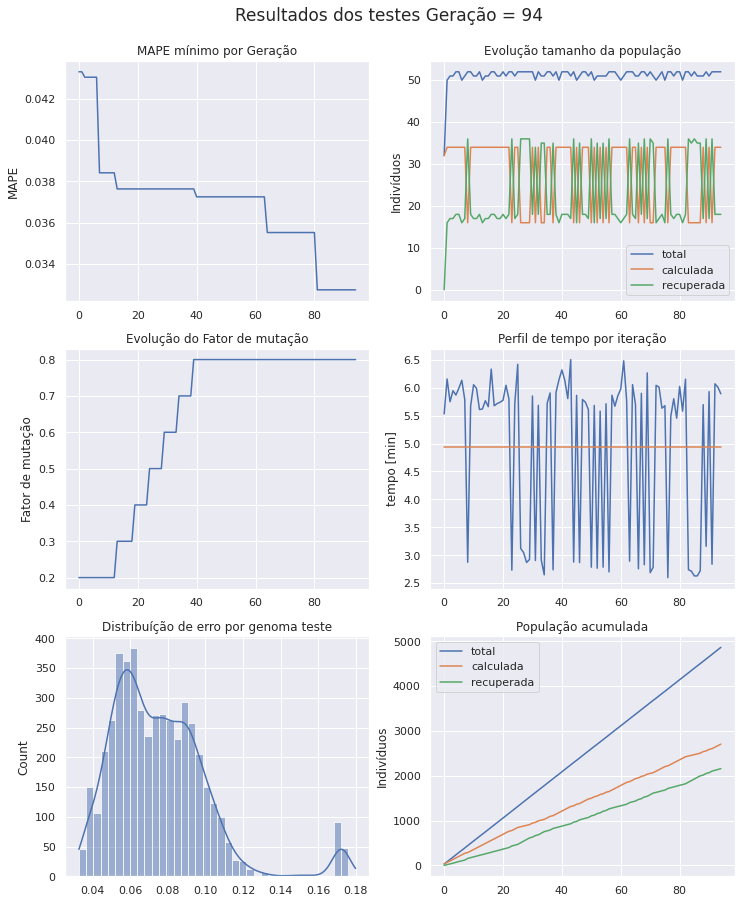

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 95 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [10 55 63 31  5 41 61 18 51 18  2  6 28]
Projenitores [61 36 43 40 26 62 31 44 51 40 53 25 35]
Projenitores [10 55 15 14  5  1 30 36 32 18 19 28 34]
Projenitores [25 52 63 19 24 41 47 46 51 33 41  6 37]
Projenitores [27 49 49 47 33 23  3 28 23 58 28 38 45]
Projenitores [25 63 26 14 51 30 29 36  5 27 26 53  4]
Projenitores [59 19 37 60 15 16 34 36  9 39 23 56 17]
Projenitores [53 33  5 19 46 55 45 27 47 39 17 50 17]
Projenitores [21 56 32 24  5 53 30 27  4 18  8 55 33]
Projenitores [16  1 49  1 54 40  5 30 54 50 11 45 28]
Projenitores [32 31 19 22 60 41 14 31 51 54 29 42 18]
Projenitores [52 11 21 45 50  4 62 13 16 56 44 27 13]
Projenitores [24 59 50 18  7 32 17 32 53  9  0 63 13]
Projenitores [36 52 63 31 24  5 61 45 43 33 15  6 16]
Projenitores [36 49 24 47  5 40 14 28 26 

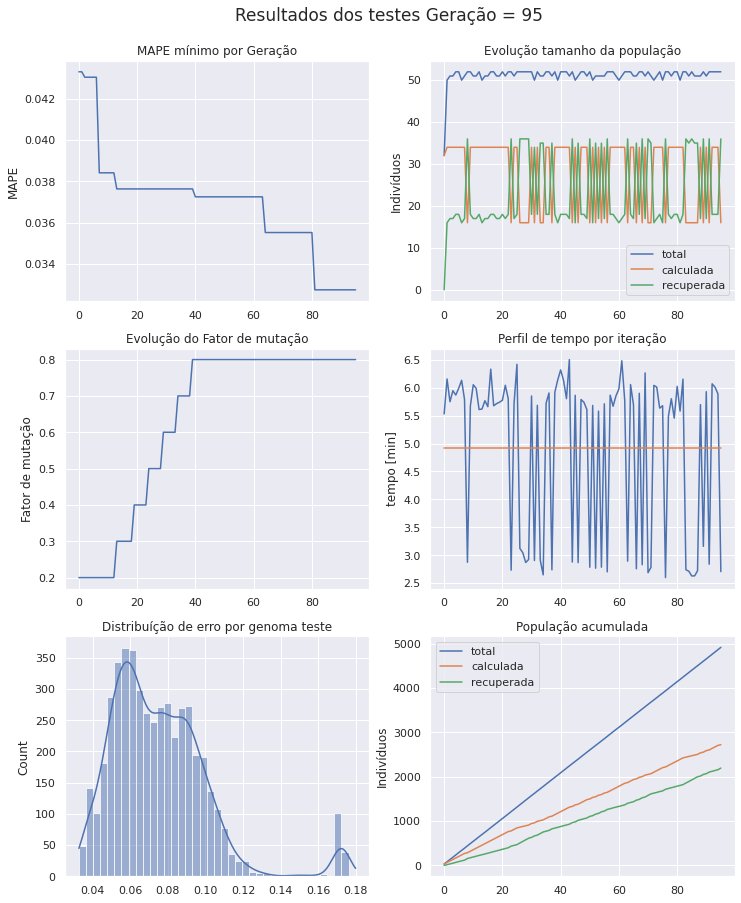

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 96 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [10 55 63 31  5 41 61 18 51 18  2  6 28]
Projenitores [25 29 30 19  2 34 47 46 59  8 41 51 37]
Projenitores [45 27 47 39 17 50 17 21 56 32 24 38 53]
Projenitores [21  1 49 24 54 40 30 27 54 50 11 55 28]
Projenitores [36 49 24 47  5 40 47 32 51 58 30  6 45]
Projenitores [21 56 32 24  5 53 30 27  4 18  8 55 33]
Projenitores [24 59 50 19 24 32 14 28 26  9  0 42 13]
Projenitores [43 44 29  0 33 62  4 31 38 37 20  2 26]
Projenitores [54 57 51  4  9 19 19 42 44 57 21 57 56]
Projenitores [25 55 63 19 24 41 47 36 32 18 19 28 37]
Projenitores [ 6 27  4 23  8 55 33 24 59 50 18  7 32]
Projenitores [36 52 50 31  7 32 61 32 43 33 15 63 13]
Projenitores [53 33  5 19 46 55 45 27 47 39 17 50 17]
Projenitores [10 32 31 49 34 53 10 50 16 17 20 42 39]
Projenitores [59 19 37 60 15 16 34 36  9 

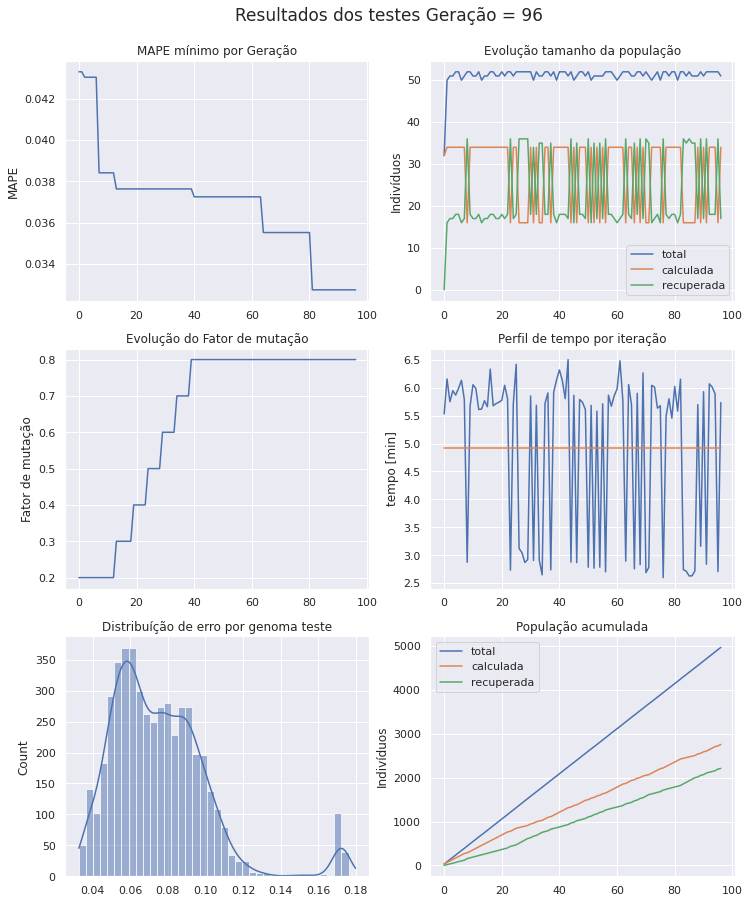

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 97 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [10 55  2 50 15 62 30 36 32 24 51  5 34]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [10 55 37 60 15 16 34 36  9 39 51  5 34]
Projenitores [54 57 51  4 24 19 19 36 32 57 21 57 37]
Projenitores [25 55 63 19 24 41 47 36 32 18 19 28 37]
Projenitores [45 27 49 24 54 40 30 27 56 50 24 38 53]
Projenitores [53 35 48 28 29 24 19 16 31 28 28 46  1]
Projenitores [44 30 42 44 42 41  1  5 42 22 17 49 59]
Projenitores [ 4 21 57 54 41 44 35 62 31 44 49  4 53]
Projenitores [21 56 32 47  5 53 30 27  4 58 30 55 33]
Projenitores [45 27 47 39 17 50 17 21 56 32 24 38 53]
Projenitores [12 22 31 41 27 12 19 39 32  8 57 50  8]
Projenitores [46  5 30 41 53 61 21 20 22 50 58 15 51]
Projenitores [ 6 45 21 62 19 12 63 41  6 40 31  0 47]
Projenitores [21  1 

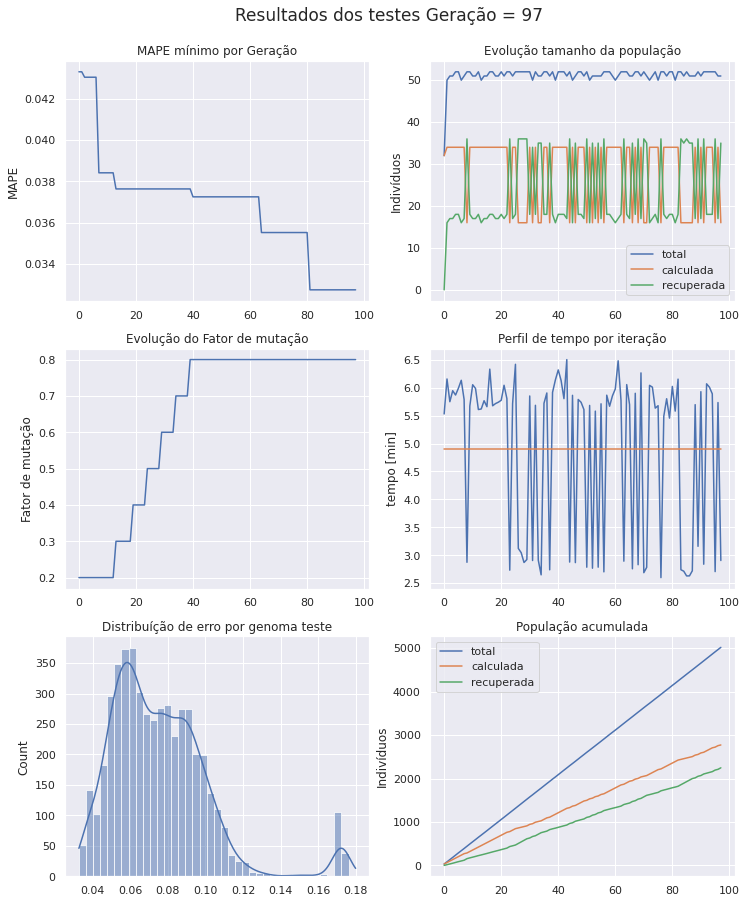

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 98 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 6  5 30 41 19 61 21 41  6 40 31 15 47]
Projenitores [54 57 37  4 24 19 34 36 32 57 51 57 37]
Projenitores [21 52 10 56  2 60 22  1 52 42 36 16 46]
Projenitores [45 22 31 41 17 12 17 39 32 32 24 50  8]
Projenitores [18 37 58 49 26 62 59 50 33 52 50 46  3]
Projenitores [10 55  2 50 15 62 30 36 32 24 51  5 34]
Projenitores [50 43 27 33 30 43  9 44 60 50 26 13 19]
Projenitores [54 57 51  4 24 19 19 36 32 57 21 57 37]
Projenitores [53 35 48 44 29 24 19 16 42 22 28 46 59]
Projenitores [44 30 42 44 42 41  1  5 42 22 17 49 59]
Projenitores [50 46 14 56 47 29  7 58 31 17 34 12 39]
Projenitores [25 55 63 24 24 41 30 27 32 50 24 38 53]
Projenitores [45 27 47 39 17 50 17 21 56 32 24 38 53]
Projenitores [10 55 29 50  8 62 63 41 49 24 51 41 28]
Projenitores [46 45 21 62 53 12 63 20 22 

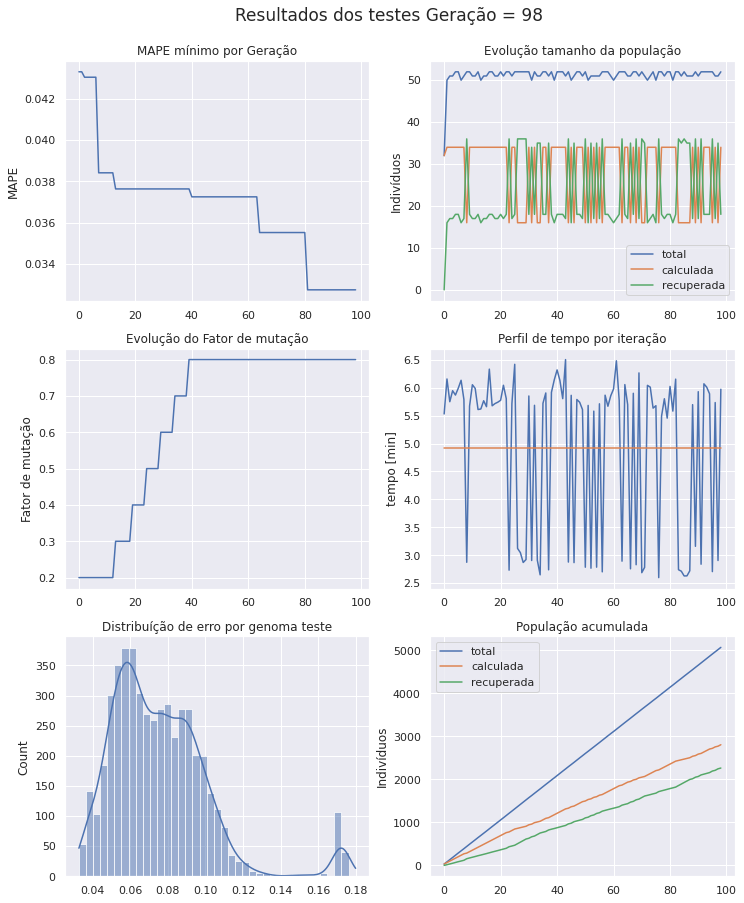

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 99 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [50 57 27  4 30 19  9 36 60 50 26 57 19]
Projenitores [10 37  2 49 26 62 59 50 32 24 51 46  3]
Projenitores [50 55 63 24 24 41 30 27 31 17 24 12 53]
Projenitores [ 9 12 13 40 60 58 61 30 48 28 21 45 48]
Projenitores [30 20 53  5 16 35 20 26 44 47 23 33 43]
Projenitores [10 55 29 50  8 62 63 41 49 24 51 41 28]
Projenitores [ 5  1 31 58 24 32 50 60  2 39 54 47 28]
Projenitores [43 25 52 41 33  6 63 43 19 16 43 33 25]
Projenitores [56 60  6 31 30  7 56 45 26 56 23  1  9]
Projenitores [21 56 32 47  5 53 30 27  4 58 30 55 33]
Projenitores [45 22 31 41 17 12 17 39 32 32 24 50  8]
Projenitores [18 37 58 49 26 62 59 50 33 52 50 46  3]
Projenitores [54 57 51  4  9 19 19 42 44 57 21 57 56]
Projenitores [32 43 57 10 47  7 27 62  9  8 17 40  5]
Projenitores [23 40 28 35 34 31 31 32 51 

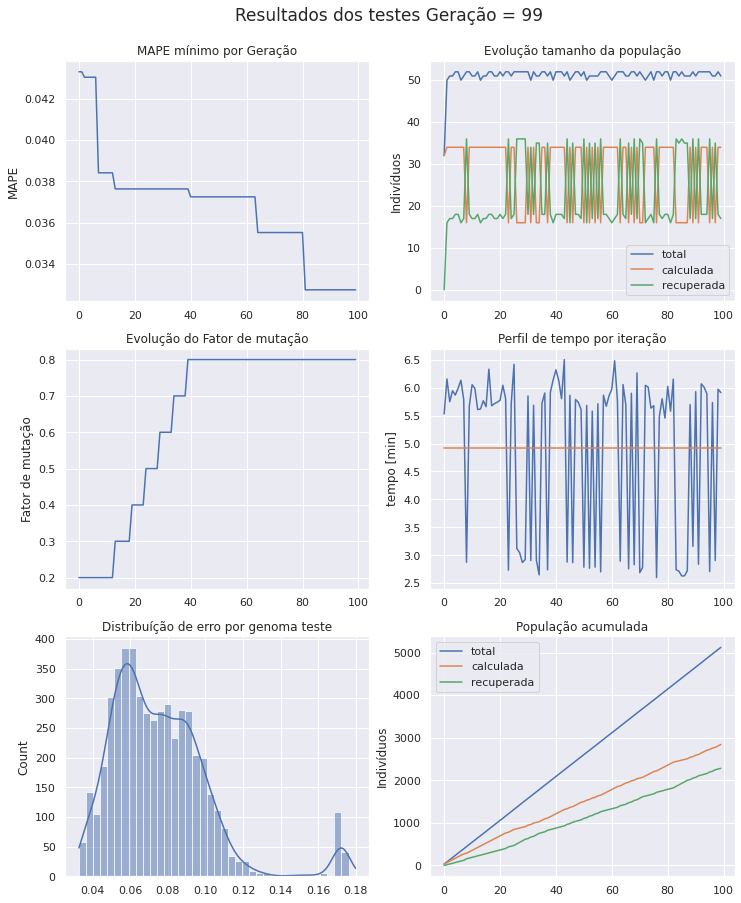

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 100 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [23 40 28 35 34 31 31 32 51 27 50 16 60]
Projenitores [56 60  6 31 30  7 56 27  4 58 30  1  9]
Projenitores [50 57 27 49 26 62  9 36 32 24 26 46 19]
Projenitores [50 12 63 40 60 58 30 30 48 17 24 45 53]
Projenitores [ 5 25 52 41 24 32 50 43 19 39 43 33 25]
Projenitores [29 52  6 26 56 56  0 21 37  7 15 60 59]
Projenitores [ 6  4 37 50 26 60 62  1 60 18 15 17 50]
Projenitores [50 55 63 24 24 41 30 27 31 17 24 12 53]
Projenitores [42 25 44 22 42 51 32 34 15  0 19  9 48]
Projenitores [45 22 31 41 17 12 17 39 32 32 24 50  8]
Projenitores [ 9 12 13 40 60 58 61 30 48 28 21 45 48]
Projenitores [45 37 58 41 26 62 59 39 33 32 24 46  3]
Projenitores [44 30 42 44 42 41  1  5 42 22 17 49 59]
Projenitores [ 6 55  1 58 57 49 57 63 37 22 34 41 53]
Projenitores [56 60  6 31 30  7 56 45 26

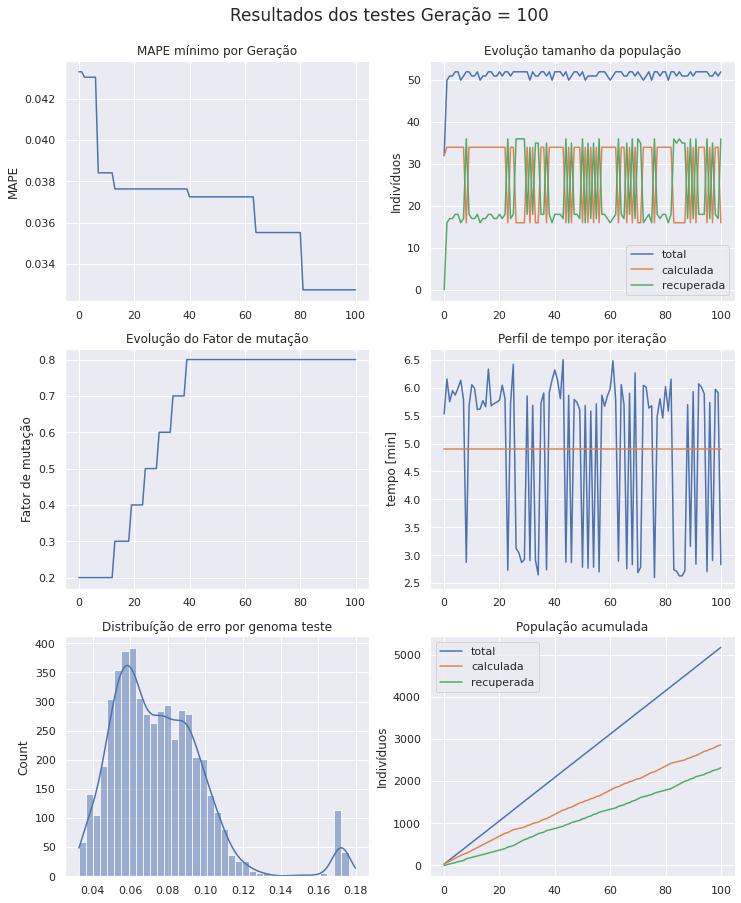

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 101 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [45 37 58 40 60 58 61 30 48 28 21 45  3]
Projenitores [42 25 44 22 42 51 32 34 15  0 19  9 48]
Projenitores [29 52  6 26 56 56  0 21 37  7 43 33 59]
Projenitores [10 60 35 31 56  7 22 26 26 56 23  6  9]
Projenitores [ 5 25 52 41 24 32 50 43 19 39 43 33 25]
Projenitores [54 57 51  4 47  7 19 42 44 57 21 57 56]
Projenitores [56 60  6 31 30  7 56 27  4 58 30  1  9]
Projenitores [ 6 30 42 44 57 49 57 63 42 22 34 41 53]
Projenitores [45 25 31 41 42 12 32 39 15  0 24 50 48]
Projenitores [ 6 55  1 58 57 49 57 63 37 22 34 41 53]
Projenitores [50 57 63 49 60 62 30 36 48 17 26 45 19]
Projenitores [56  7  6 54 30  0 56 45 33 42 59  1 63]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [ 7 26  8 61 36 32 50 41 43 23 14 58 53]
Projenitores [51 59 48  1  0 47 61 11  4

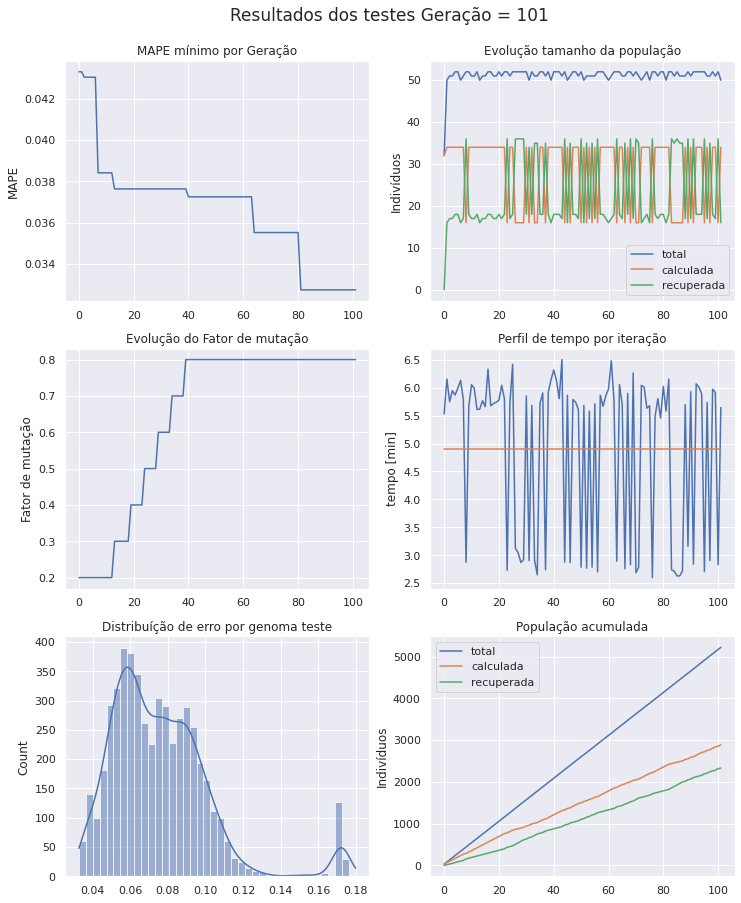

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 102 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [56  7 63 49 60  0 30 45 33 42 26  1 63]
Projenitores [ 5 25 52 41 24 32 50 43 19 39 43 33 25]
Projenitores [29 52  6 26 56 56  0 21 37  7 43 33 59]
Projenitores [ 6 25 31 58 42 49 32 63 37 22 24 41 48]
Projenitores [29 52  6 31 56  7 22 26 37 56 43  6 59]
Projenitores [51 55 63  1  0 47 61 11 31 36 24 12 53]
Projenitores [54 26 29 29 36 32 63 41 43 23 14 41 28]
Projenitores [10 60 35 26 56 56  0 21 26  7 23 33  9]
Projenitores [56 60  6 44 30  7 57 27 42 58 30  1  9]
Projenitores [31 26 54 49 43 42 48 59 26 24 44 24 34]
Projenitores [53 26 33 59 56  6 20 27 50 12 34 14 60]
Projenitores [ 4 16 39 61 39 19 42 48 19 39 15  8 40]
Projenitores [49 45 38 10 51 26  4 62 61  7 26 61 33]
Projenitores [45 37 58 40 60 58 61 30 48 28 21 45  3]
Projenitores [56 15

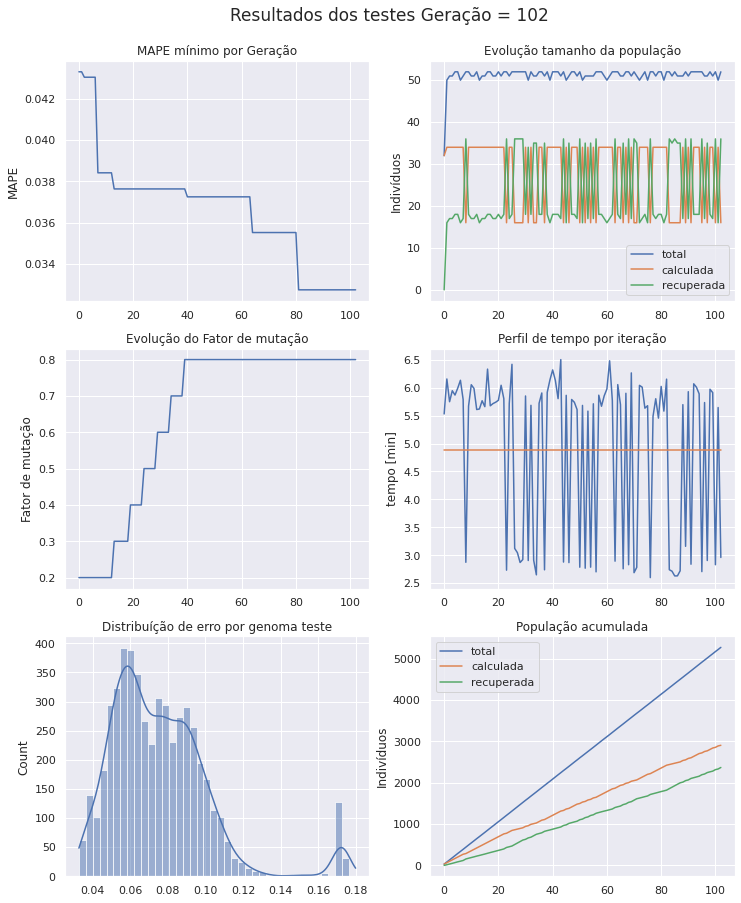

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 103 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [16 31 25 49 14 44 62  5 63 40  3 10 13]
Projenitores [56  7 63 49 60  0 30 45 33 42 26  1 63]
Projenitores [ 7 26  8 61 36 32 50 41 43 23 14 58 53]
Projenitores [ 4 16 39 61 39 19 42 48 19 39 15  8 40]
Projenitores [ 7 26  8 61 51 32 22 41 43 38 14 58 53]
Projenitores [34 29 13 62 45 27 24 33 48 56 62 15 27]
Projenitores [10 60 35 26 56 56  0 21 26  7 23 33  9]
Projenitores [59 19 37 60 15 16 34 36  9 39 23 56 17]
Projenitores [16  1 49  1 54 40  5 30 54 50 11 45 28]
Projenitores [ 6 52 31 58 42 49  0 63 37  7 24 33 48]
Projenitores [29 25  6 26 56 56 32 21 37 22 43 41 59]
Projenitores [47 23 46 38 23 25 16 47 18 54  2 39 43]
Projenitores [56 15 51 21 36 47 50  1 19 23 46 51 34]
Projenitores [61 36 43 40 26 62 31 44 51 40 53 25 35]
Projenitores [53 16 33 59 39 19 20 48 19

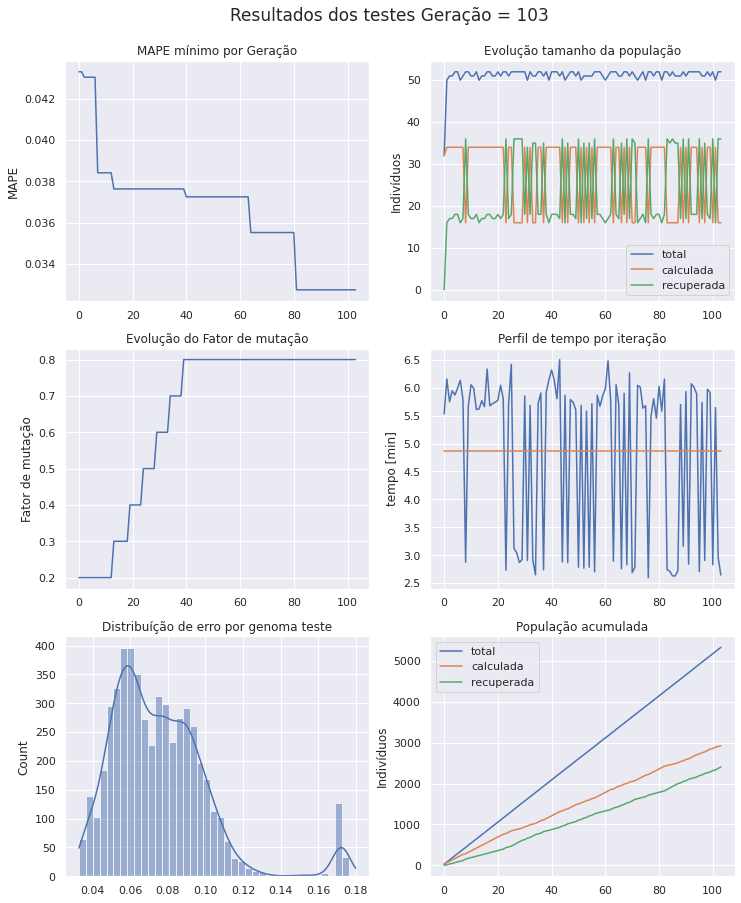

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 104 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [10 19 35 26 56 56  0 21  9  7 23 56  9]
Projenitores [56 15 43 40 26 62 31 44 51 23 46 25 35]
Projenitores [17 27  6 16 56 58 43 48 58 56 16 14 44]
Projenitores [ 6  1 49 58 42 49  5 63 37  7 24 45 28]
Projenitores [61 36 51 21 36 47 50  1 19 40 53 51 34]
Projenitores [14  3 57 39 45 63 39 19  9  2 62 26 60]
Projenitores [53 16 33 59 39 19 20 48 19 12 34 14 40]
Projenitores [47 23 46 38 23 25 16 47 18 54  2 39 43]
Projenitores [29 25  6 26 23 56 32 21 18 54 43 41 59]
Projenitores [ 7 26  8 61 45 32 24 41 43 38 62 58 53]
Projenitores [ 4 26  8 61 36 19 42 41 43 23 15  8 40]
Projenitores [47  6 23  1 54 47 42 40 46  9 10 30 27]
Projenitores [24 15 47 16 60 53 52 59 25  4 47 34 57]
Projenitores [ 0  9 58 26  6 18 44 43 50 39  6 35 20]
Projenitores [46 21 49 53  2 23 21 59 40

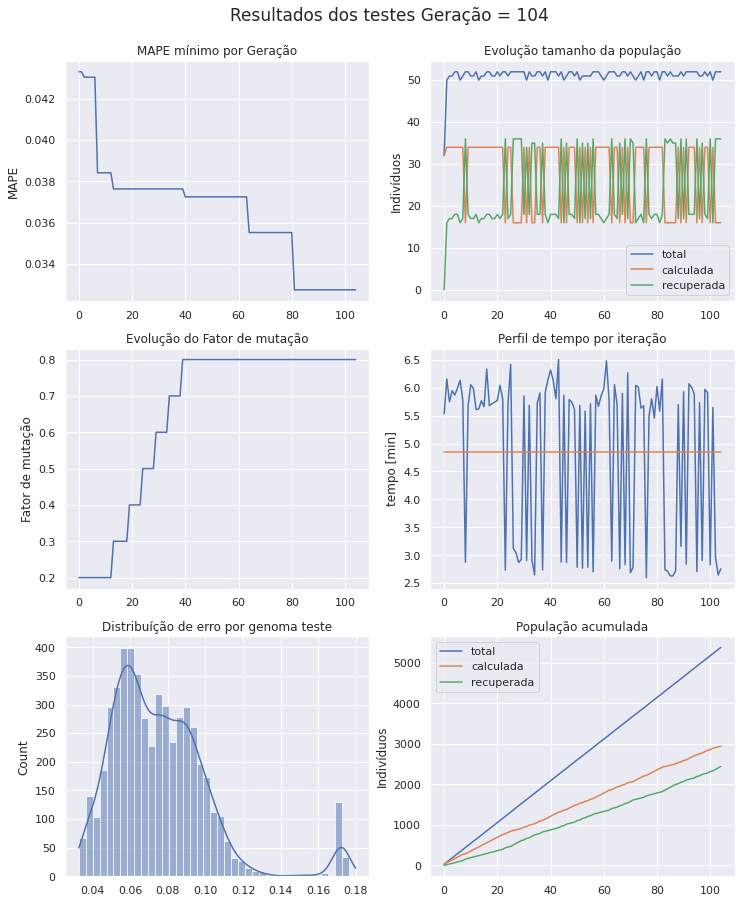

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 105 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [14 36 51 21 36 47 39 19  9 40 62 26 34]
Projenitores [29 26  8 61 45 32 24 41 43 54 62 41 53]
Projenitores [61 36 51 21 36 47 50  1 19 40 53 51 34]
Projenitores [ 0 15 58 26  6 18 44 59 50  4  6 35 20]
Projenitores [25 29 43 47 26 21 40 62 55 43 13  3 59]
Projenitores [ 0  9 58 26  6 18 44 43 50 39  6 35 20]
Projenitores [54 57 51  4 47  7 19 42 44 57 21 57 56]
Projenitores [21 33 46 28 12 55 33 42 60  4  1 17 44]
Projenitores [56 15 35 40 26 62  0 44  9 23 23 25  9]
Projenitores [51 39 63 37 30 26 57  1 16 62  8 59 23]
Projenitores [21 21 37  7  5  9 21 59 40 18 47 44 62]
Projenitores [24  9 47 16 60 53 52 43 25 39 47 34 57]
Projenitores [47 23 46 38 23 25 16 47 18 54  2 39 43]
Projenitores [46  5 49 53  2 23  8 52 54  1 25 50 56]
Projenitores [17  9 26 27 17 22 62 58  5

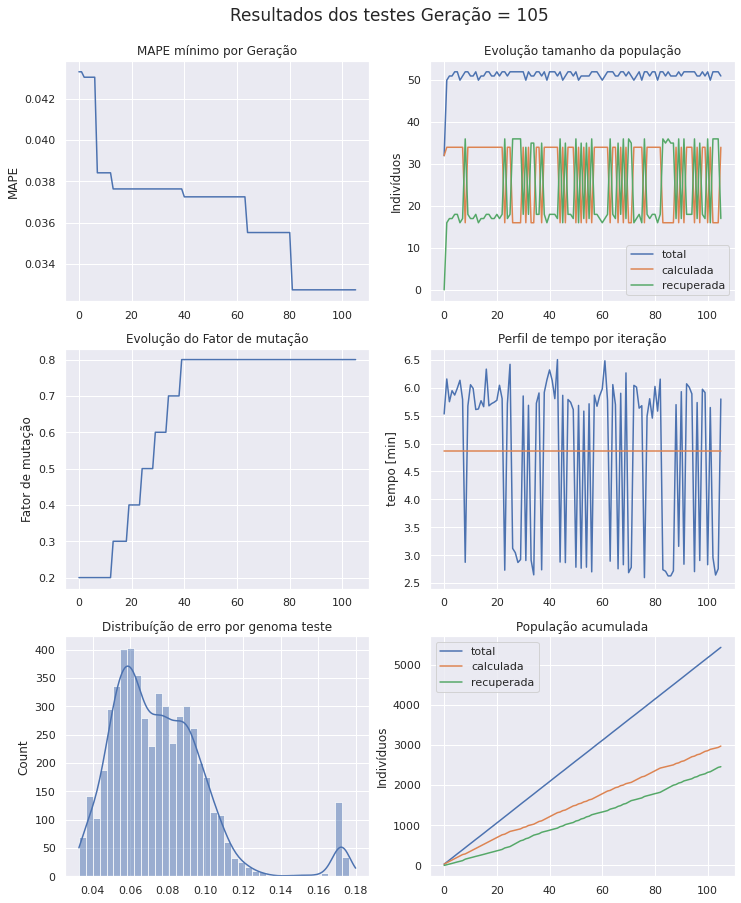

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 106 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [17  9 26 27 17 22 62 58  5 49 25 57  7]
Projenitores [62  7 61  6 32 42  6  0 39 24  7 54 28]
Projenitores [51 39 63 37 30 26 57  1 16 62  8 59 23]
Projenitores [ 0 15 51 21 36 47 44  1 19 40  6 35 20]
Projenitores [24  9 37  7  5 53 21 59 40 39 47 44 57]
Projenitores [17  9  6 16 56 58 43 58 58 49 16 14  7]
Projenitores [ 1 51 54 19 58  3 22 36 14 20 56  0 53]
Projenitores [46 23 46 53  2 25 16 47 54  1 25 39 43]
Projenitores [24 44 27 52 21 53 59 53 41 51 23 21 26]
Projenitores [14 46 37 38 59 28 37 48 11 41 39 41 52]
Projenitores [51 49  3  7 51 50 18 24 23 28 47 42  7]
Projenitores [25  7  1 42 31 20 26 25 21 49 47 22 18]
Projenitores [21 21 37  7  5  9 21 59 40 18 47 44 62]
Projenitores [59 31 50 13 37  3 47 33 36 61 30  6 34]
Projenitores [26  6 53 46 12 44 58 25 26

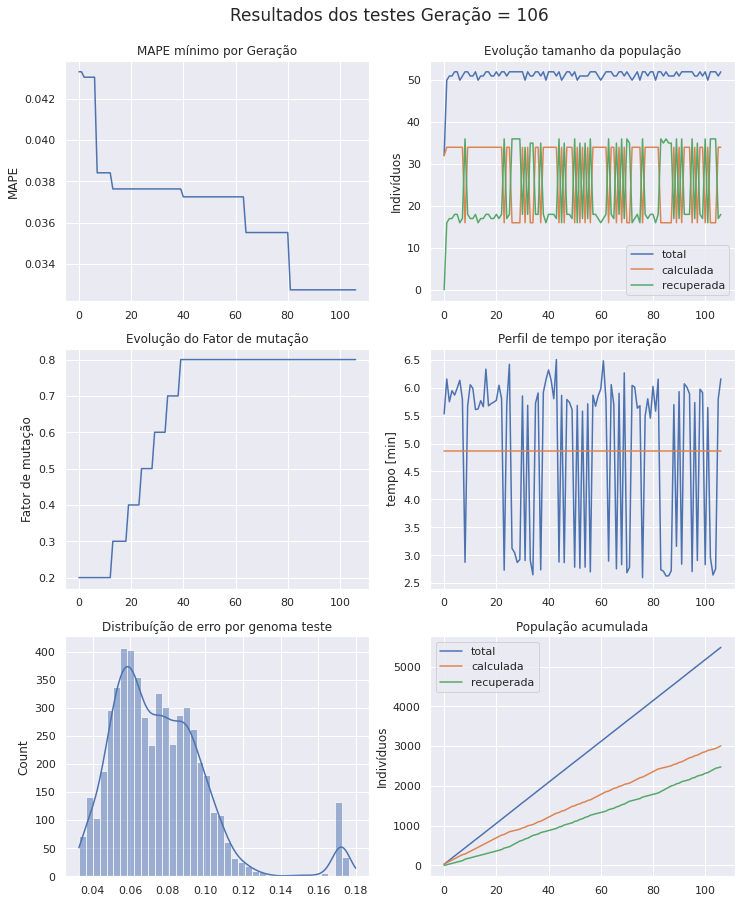

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 107 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [14 44 37 52 21 28 37 53 11 41 23 21 52]
Projenitores [62  7 61  6 32 42  6  0 39 24  7 54 28]
Projenitores [ 0 15 63 37 30 47 44  1 19 40  8 35 20]
Projenitores [42 22 41 19 60 53 13  1 44 39  6  4 61]
Projenitores [ 4 48 53 62 47 25 22 17 43 42 32  2  4]
Projenitores [51  7  3 42 31 50 26 25 21 28 47 22  7]
Projenitores [17 19  2 38 44 18 51 37 36 54 63 31 50]
Projenitores [37 15 33 23  5 57  1 57 34 12 23  5 48]
Projenitores [ 7 56 59  1 20 42 20 54 25 39 17  9 60]
Projenitores [54  2 52  1 25 62 18 57 17 38 57 13 31]
Projenitores [22 62 51 25 13 21 36 57 54  7 10 34 56]
Projenitores [29 26  8 61 45 32 24 41 43 54 62 41 53]
Projenitores [21 31 50 13  5  9 47 33 40 18 47 44 34]
Projenitores [29  6  8 46 45 44 24 25 43 54 33 61 53]
Projenitores [43 53

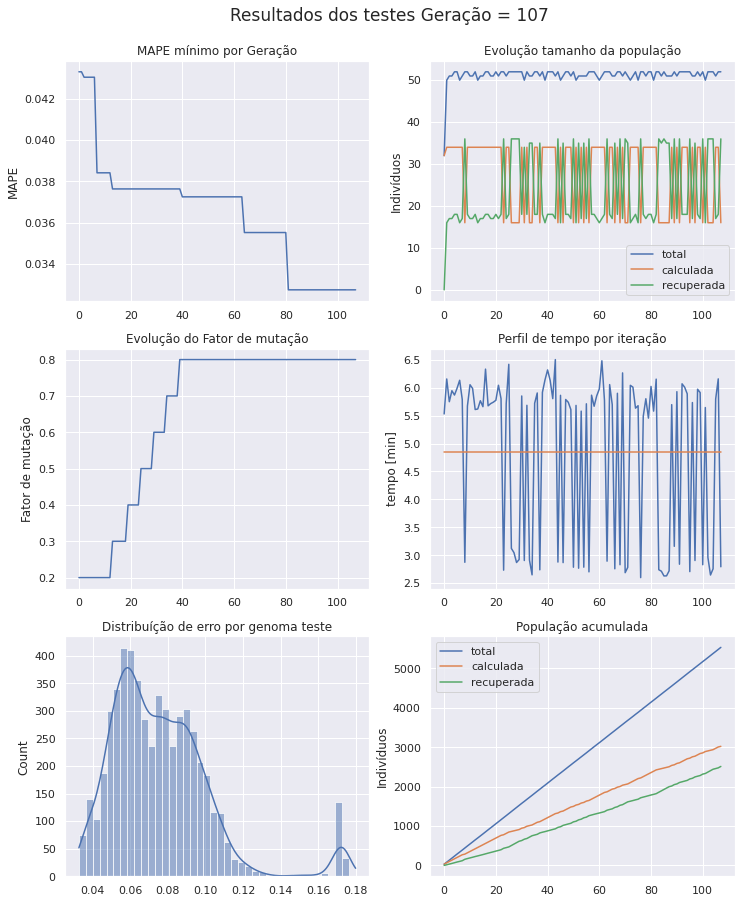

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 108 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [51  7  3 42 31 50 26 25 21 28 47 22  7]
Projenitores [14 44 37 52 21 28 37 53 11 41 23 21 52]
Projenitores [22  8 38 48 17 13 50 44 32 24 26 62 26]
Projenitores [29  6  8 13  5  9 24 25 40 18 33 44 53]
Projenitores [42 22 41 37 60 53 13  1 44 39  8  4 61]
Projenitores [ 2 44 38 47 16 24 32 48  6 33  5 17 26]
Projenitores [29  6  8 46 45 44 24 25 43 54 33 61 53]
Projenitores [42 29 29  1  9 44 38 61 30 52 30 11  5]
Projenitores [ 0 15 63 19 30 47 44  1 19 40  6 35 20]
Projenitores [ 1 14 63 59 33 54 18 55 56  4 28 55 21]
Projenitores [43 61 38 18  3  2 28 18 11 40 52 44 51]
Projenitores [62  7 61  6 32 42  6  0 39 24  7 54 28]
Projenitores [24 53 27 45 49 53 59 23 48 51 19 41 24]
Projenitores [17 15 33 38  5 57  1 57 36 54 63 31 48]
Projenitores [ 7  2 59  1 20 42 20 57 17

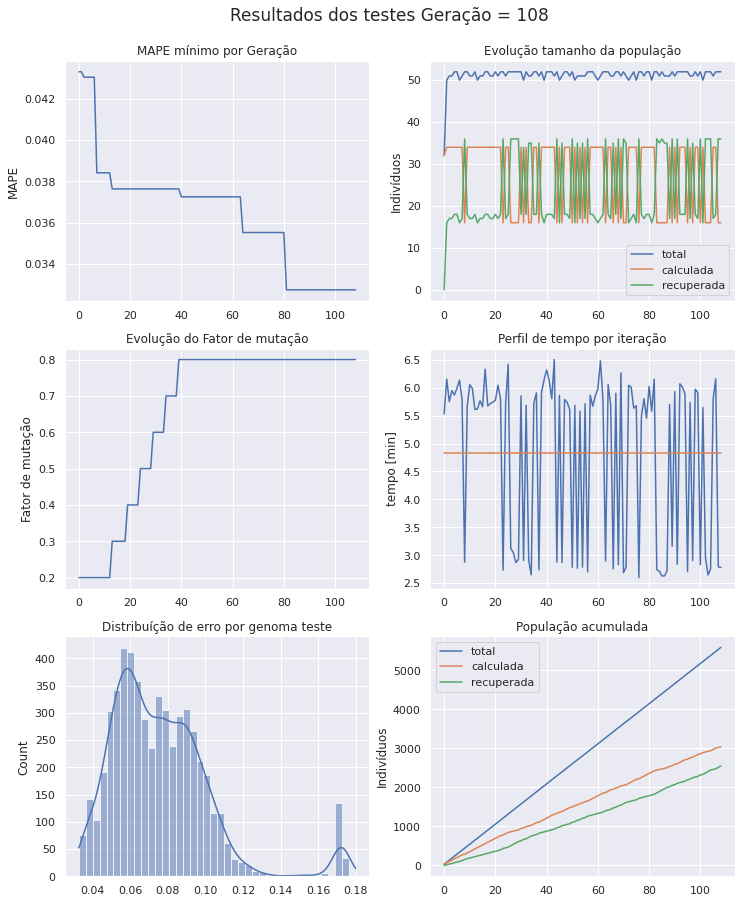

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 109 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 7  2 59  1 36 56 20 57 17 33 57  9 31]
Projenitores [19 11 12  0 36 42 37 31 58 38  7 57 13]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [ 2 22 41 37 16 24 32  1 44 33  8 17 61]
Projenitores [42 29 29 46  9 44 38 25 43 54 30 11 53]
Projenitores [17 15 33 38  5 57  1 57 36 54 63 31 48]
Projenitores [ 2 59  4 22  3 36 53  2 25 49 12  3 18]
Projenitores [29  6  8 46 45 44 24 25 43 54 33 61 53]
Projenitores [51  7  3 42 31 50 26 25 21 28 47 22  7]
Projenitores [22  8 38 13  5  9 24 25 32 18 33 62 26]
Projenitores [43  7 61  6 32  2  6 18 39 24 52 44 51]
Projenitores [20 20 28 58 56 32 40 32 37 34 31  4 43]
Projenitores [17 48 17 16 36 56 19 59  6 33 21 27 53]
Projenitores [42 44 38 47 60 53 13 48  6 39  5  4 26]
Projenitores [29  6  8 48 17 13 50 44 40

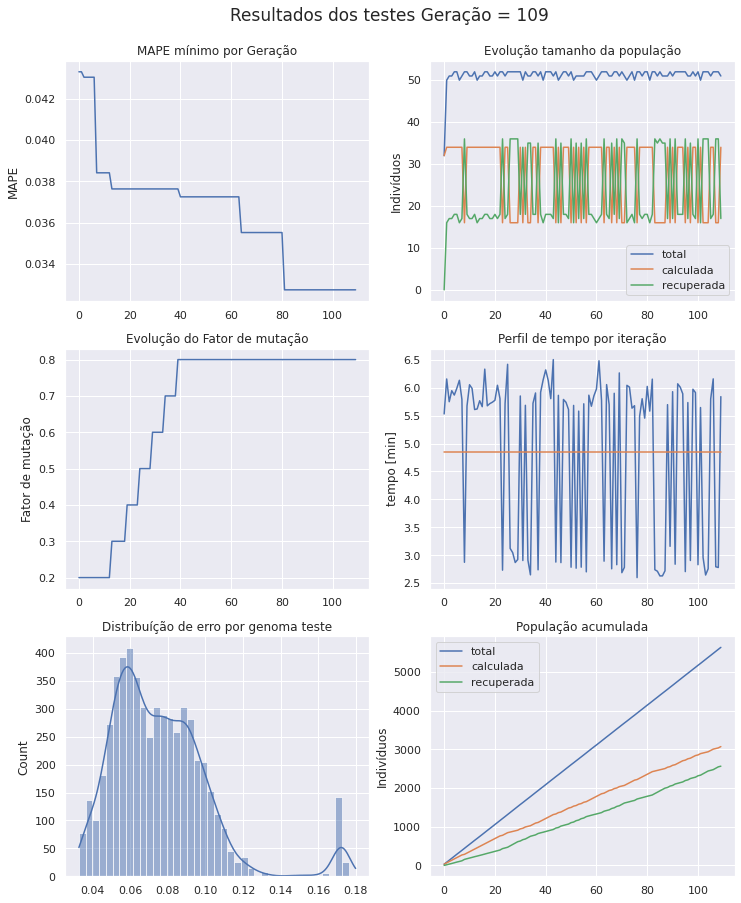

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 110 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [29  6  4 46 45 44 24 25 43 49 33  3 18]
Projenitores [35  0 14 23 54 39 61  8 50 54 22  5  0]
Projenitores [21 17 29  2 35 29 40 47 15 13 33 21 40]
Projenitores [19 19 46 24  5 53  7 26 60 19 21 37 28]
Projenitores [ 2 22 41 37 16 24 32  1 44 33  8 17 61]
Projenitores [17 44 17 47 36 56 19 48  6 33 21  4 26]
Projenitores [20 20 28 58 56 32 40 32 37 34 31  4 43]
Projenitores [22 62 51 61 13 21 24 57 54 54 62 34 56]
Projenitores [54 25 34 62  8 40 36 41 49 44 46 48 28]
Projenitores [43 20 61  6 56  2 40 18 37 34 52 44 51]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [56 53  9 24 53 58  9  5  7 49 60 38 38]
Projenitores [30  4  9  0  1 60 15 39 26 41 28 62 52]
Projenitores [ 0 59 11 28 63 19  5 18 63 34 30 58 30]
Projenitores [23 50 15 19 18 19  2 29 30

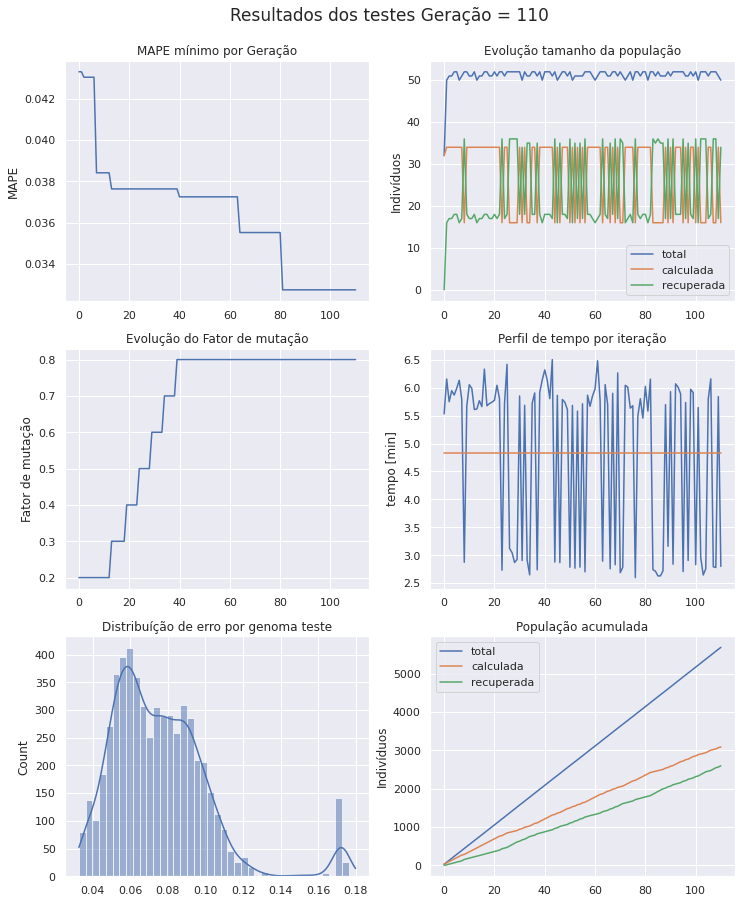

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 111 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [17 58 20 34 30 32 52 61 19 40 54  2  6]
Projenitores [23 50 12 19 36 19 37 29 58 62  7 57 13]
Projenitores [30  4 11  0 63 60  5 39 63 41 28 62 30]
Projenitores [ 2 44 17 37 36 56 19 48 44 33  8  4 26]
Projenitores [56 53  9 24 53 58  9  5  7 49 60 38 38]
Projenitores [ 0 59  9 28  1 19 15 18 26 34 30 58 52]
Projenitores [20 20 28 58 56 32 40 32 37 34 31  4 43]
Projenitores [54 53 29 24 53 58 63  5  7 44 46 38 28]
Projenitores [54 25 34 62  8 40 40 41 37 44 52 48 28]
Projenitores [43 20 61  6 56  2 40 18 37 34 52 44 51]
Projenitores [19 17 29 24 35 53  7 47 60 19 21 37 40]
Projenitores [35  0 14 23 54 39 61  8 50 54 22  5  0]
Projenitores [34 43 39  5  4 48  5 26  2 16 33 29 24]
Projenitores [54 25 34 62  8 40 36 41 49 44 46 48 28]
Projenitores [29  6 14 46 54 39 61 25 50

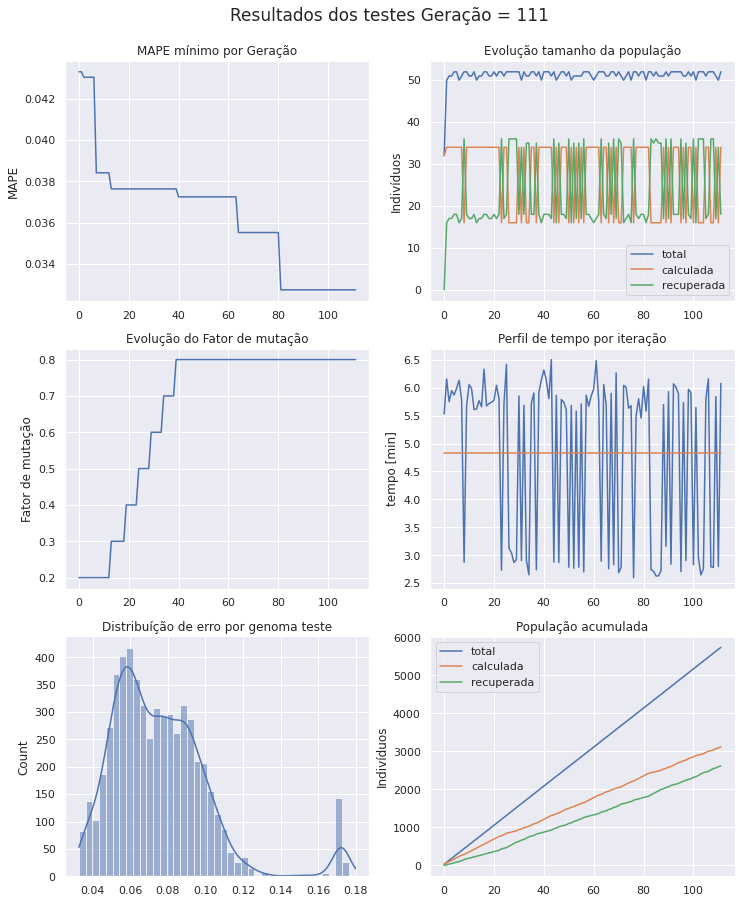

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 112 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [54 53 28 24 56 32 40 32  7 34 31 38 43]
Projenitores [39 40  5 59 57  3 48 52 48 11  1 41 10]
Projenitores [ 4 37 27 43 20 27  8 19 43 31 57 31 17]
Projenitores [59 30 36 23  7 43 30 37  9  7  7 13 31]
Projenitores [56 53  9 24 53 58  9  5  7 49 60 38 38]
Projenitores [56 20  3 28 30 35 61 49 40 57 19 53 51]
Projenitores [34 25 39  5  8 48  5 41  2 16 46 48 24]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [22 62 51 61 13 21 24 57 54 54 62 34 56]
Projenitores [19 17 14 24 35 39  7 47 60 19 21  5  0]
Projenitores [51 26 56 39  0 22 16 56 59 60 37 36 48]
Projenitores [34 43 39  5  4 48  5 26  2 16 33 29 24]
Projenitores [19 17 29 24 35 53  7 47 60 19 21 37 40]
Projenitores [30  4 11  0 63 60  5 39 63 41 28 62 30]
Projenitores [54 59

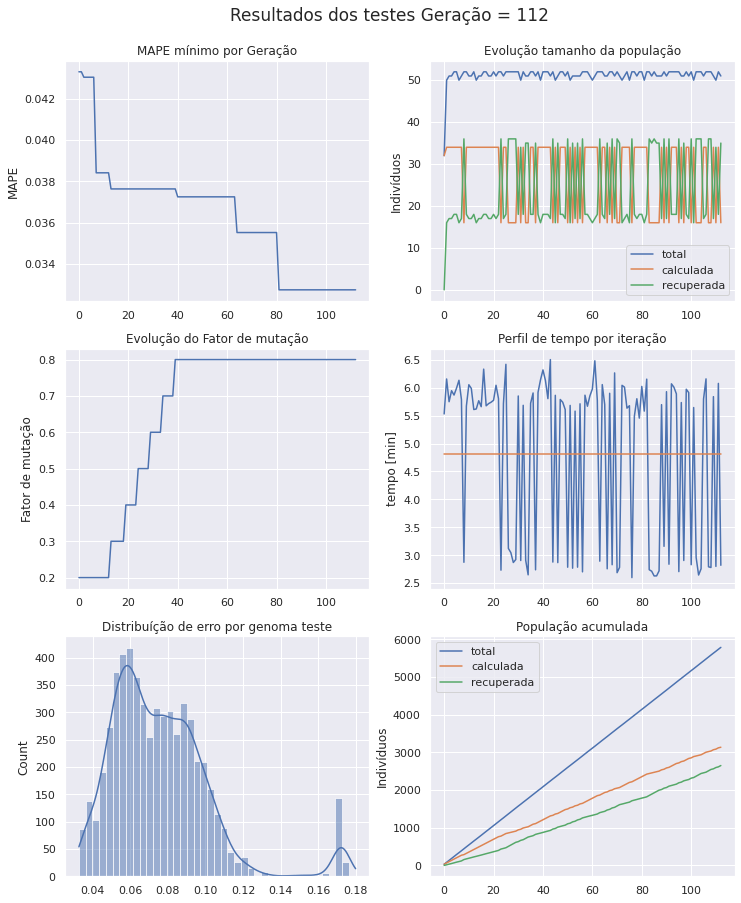

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 113 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [19 17 11 24 63 53  5 47 63 19 21 37 30]
Projenitores [59 37 27 23 20 43 30 19  9  7  7 13 17]
Projenitores [ 7 43 33 38 13 32 38 55 30 63 40  9  9]
Projenitores [32 62  9 21 34 61 33 32 55 35 23 29 48]
Projenitores [56 53  9 24 53 58  9  5  7 49 60 38 38]
Projenitores [34 26 39 39  0 22  5 56 59 16 33 36 24]
Projenitores [30  4 29  0 35 60  7 39 60 41 28 62 40]
Projenitores [ 4 37 27 43 20 27  8 19 43 31 57 31 17]
Projenitores [54 59 61 26 44 26 21 43 63 43 44 60 27]
Projenitores [ 4 30 36 43  7 27  8 37 43 31 57 31 31]
Projenitores [19 17 14 24 35 39 24 47 54 19 62  5  0]
Projenitores [39 40  5 59 57  3 48 52 48 11  1 41 10]
Projenitores [ 2 55 11 50  7 33 35 58 18  2 51 41  9]
Projenitores [30  4 11  0 63 60  5 39 63 41 28 62 30]
Projenitores [34 43 39  5  4 48  5 26  2

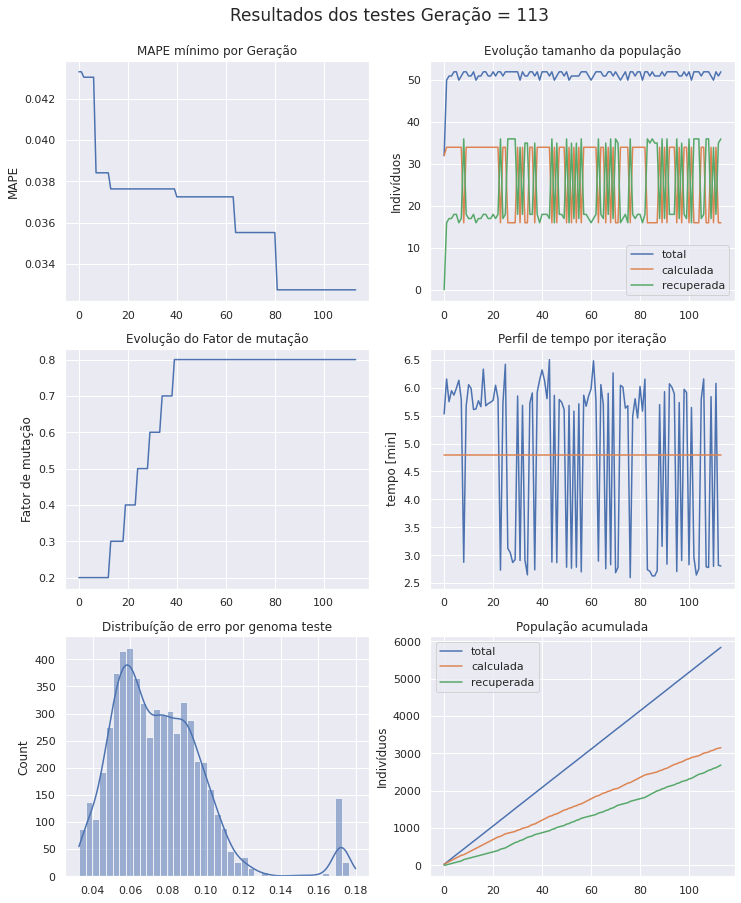

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 114 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 4 59 36 26  7 27  8 43 43 31 44 60 31]
Projenitores [30 55 11  0  7 60 35 58 18  2 28 41 30]
Projenitores [17 58 39 34 30 32 52 26 19 16 54  2 24]
Projenitores [ 2  4 11 50 63 33  5 39 63 41 51 62  9]
Projenitores [44 51 40 53 25 35 34 29 13 62 45 27 24]
Projenitores [39 40  5 59 57  3 48 52 48 11  1 41 10]
Projenitores [13 54 36  8 33 23 13 28 35 58 55 13  4]
Projenitores [29 26 47 51 33 50 17 27  6 16 56 58 43]
Projenitores [19 37 27 24 20 43  5 19 63 19 21 37 17]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [35  0 29 23 54 53 61  8 50 54 22 37 40]
Projenitores [60 40 43 34  9 21 27 34 38 55 53 39 11]
Projenitores [34 26 39 39  0 22  5 56 59 16 33 36 24]
Projenitores [31 54 13  1 41 48 34 20 17 35 60 59 47]
Projenitores [36  9 39 23 56 17 61 36 43

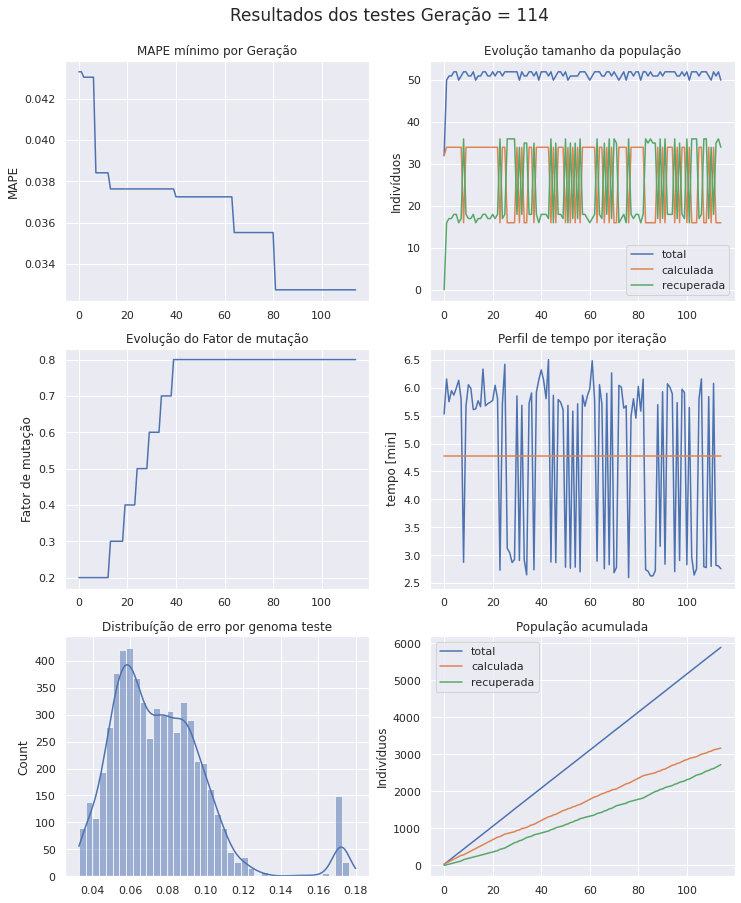

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 115 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [31 26 39  1  0 48  5 20 59 35 33 36 47]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [19 37 27 24 20 43  5 19 63 19 21 37 17]
Projenitores [22 27 17 17  9 19 47 28 32 34 24  0 17]
Projenitores [44 40 40 59 25  3 34 52 48 11 45 27 10]
Projenitores [24 15 41 14 13 21 60 10  2 29 30  2 12]
Projenitores [29 26 47 51 33 50 17 27  6 16 56 58 43]
Projenitores [32 62  9 21 34 61 33 32 55 35 23 29 48]
Projenitores [35 29 29 44  0 48 60 56  6 39 24 33 32]
Projenitores [34 60 17 12 51  0 22 18  6 36 57 21  4]
Projenitores [43 41 23  8 49 44  6 54 26 60 18 13  1]
Projenitores [13 54 36  8 33 23 13 28 35 58 55 13  4]
Projenitores [54 37 27 24  8 43 63 19 49 44 46 41 17]
Projenitores [52 17 37  6 51 19 48 60  4 54 40 63  4]
Projenitores [ 1 57 37  6 10 11 43 46  2

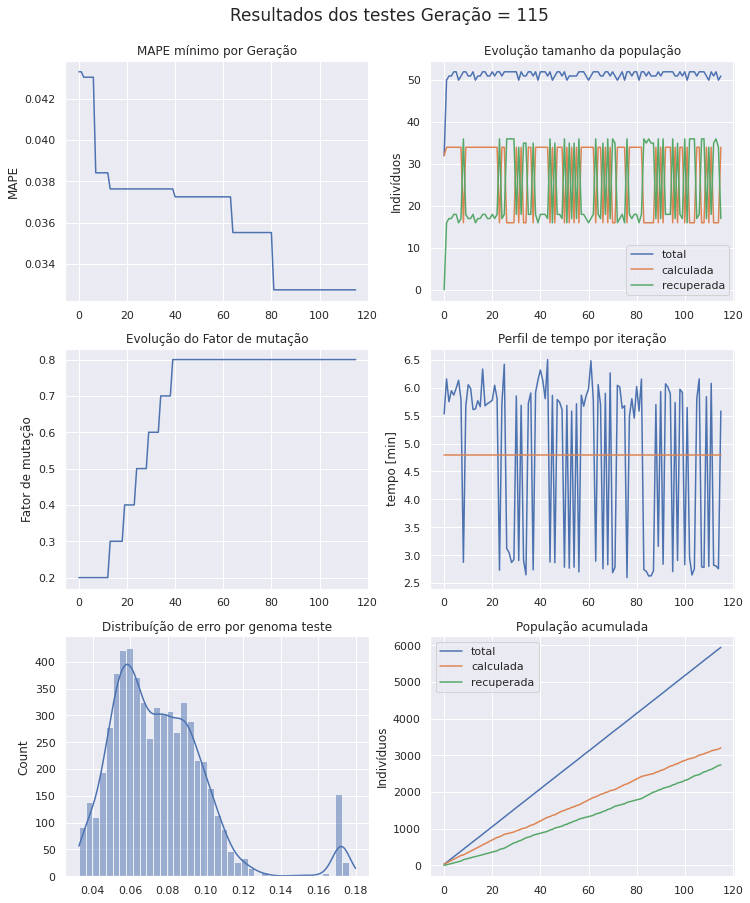

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 116 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 9 46 32 11 30 51 18 20  0 23 10 42 55]
Projenitores [31 45 39  1  0 48 63 20 59 44 46 41 28]
Projenitores [18 42 20  8 34 42 54 62 31  6 47 42 37]
Projenitores [24 15 41 14 13 21 60 10  2 29 30  2 12]
Projenitores [ 3 62 35 14 24 24 56 41 30 13 59 52 62]
Projenitores [50 59 16  5 55 19 51 26 25 48 42 32 12]
Projenitores [54 17 37 24 51 43 63 60  4 44 46 63 17]
Projenitores [29 26 47 51 33 50 17 27  6 16 56 58 43]
Projenitores [32 62  9 21 34 61 33 32 55 35 23 29 48]
Projenitores [52 17 37  6 51 19 48 60  4 54 40 63  4]
Projenitores [24 15 40 14 13  3 60 52  2 29 30  2 12]
Projenitores [ 1 57 43  6 54 11 43 34 50 54 60 39 11]
Projenitores [43 41 23  8 49 44  6 54 26 60 18 13  1]
Projenitores [34 60 17 12 51  0 60 18  6 36 24 33 32]
Projenitores [54 26 29 29  8 39  5 41 49

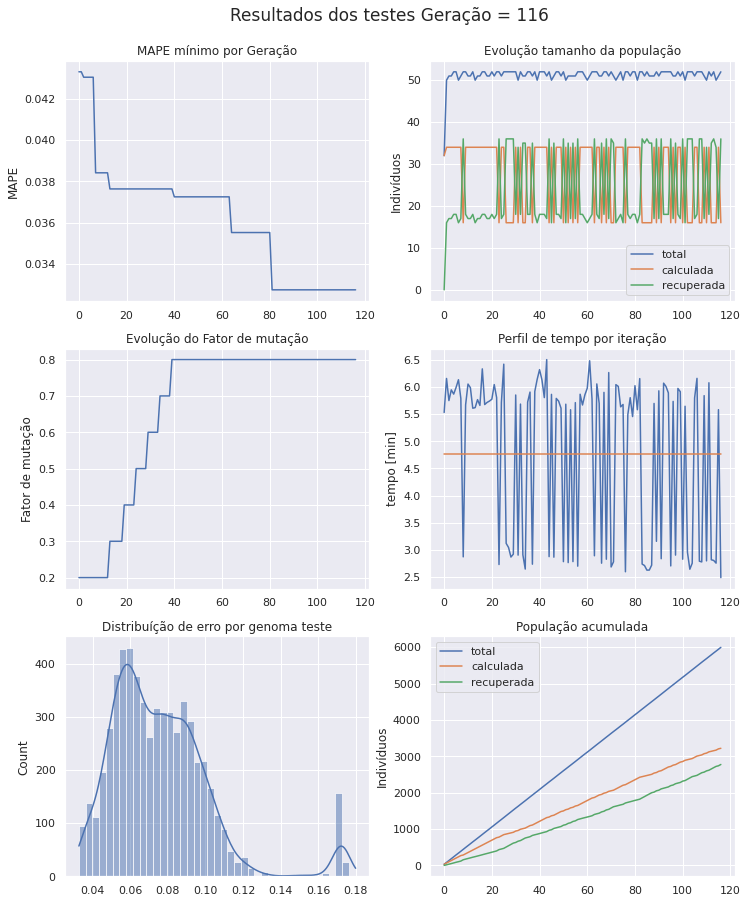

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 117 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [31 45 39  1  0 48 63 20 59 44 46 41 28]
Projenitores [34 60 17 12 51  0 60 18  6 36 24 33 32]
Projenitores [29 26 47 51 33 50 17 27  6 16 56 58 43]
Projenitores [24 15 41 14 13 21 60 10  2 29 30  2 12]
Projenitores [24 15 43 14 13  3 60 52  2 54 30 39 12]
Projenitores [35  0 29 23 54 53 61  8 50 54 22 37 40]
Projenitores [58 13 53 28 19 26 18  0 48 51 20 48 33]
Projenitores [54 17 37 24 51 43 63 60  4 44 46 63 17]
Projenitores [33  1 11 45 12  9 33 50 46 38 24 18  7]
Projenitores [ 8  2 57 46 15 54 31 55 22 41 56 35  5]
Projenitores [54 26 29 44  8 48 60 56 49 39 24 36 32]
Projenitores [33 51 60 12 38 56 22  9  4 41 62 42 32]
Projenitores [50 62 35 14 55 19 51 26 30 48 42 32 62]
Projenitores [46 16 52 22 37 60 36 21 56 49 32  3  3]
Projenitores [24 15

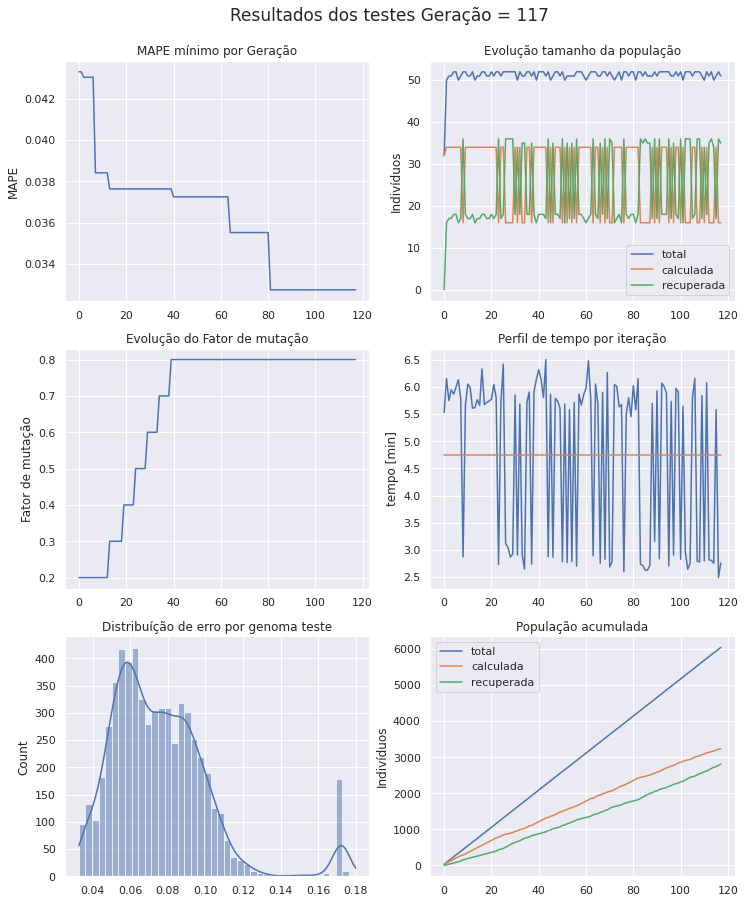

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 118 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [50 62 35 14 37 19 51 26 56 49 42 32  3]
Projenitores [52 41 41 29 26  0 60 62 22 34 12  6 40]
Projenitores [24 15 43 14 13  3 61 52  2 54 22 39 12]
Projenitores [55 38 18  9  9 13 21 43  1 31 14 16 48]
Projenitores [54 12 41 40 28 54 47 37  9 23 21  4 27]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [34 59 42 46 52 49 29 38 42 17  5 15 49]
Projenitores [54 26 29 44  8 48 60 56 49 39 24 36 32]
Projenitores [40 36  5 28 43 29 49 61 46 42 52 48 31]
Projenitores [12  4 44 55 20 43 49 18 56 21 50 57 22]
Projenitores [ 8  2 57 46 15 54 31 55 22 41 56 35  5]
Projenitores [33  2 11 45 15 54 31 55 46 41 24 18  7]
Projenitores [55 55 57 12 12 45 36  7 21 58 41 38 15]
Projenitores [33  1 11 45 12  9 33 50 46 38 24 18  7]
Projenitores [31 45 39  1  0 48 63 20 59

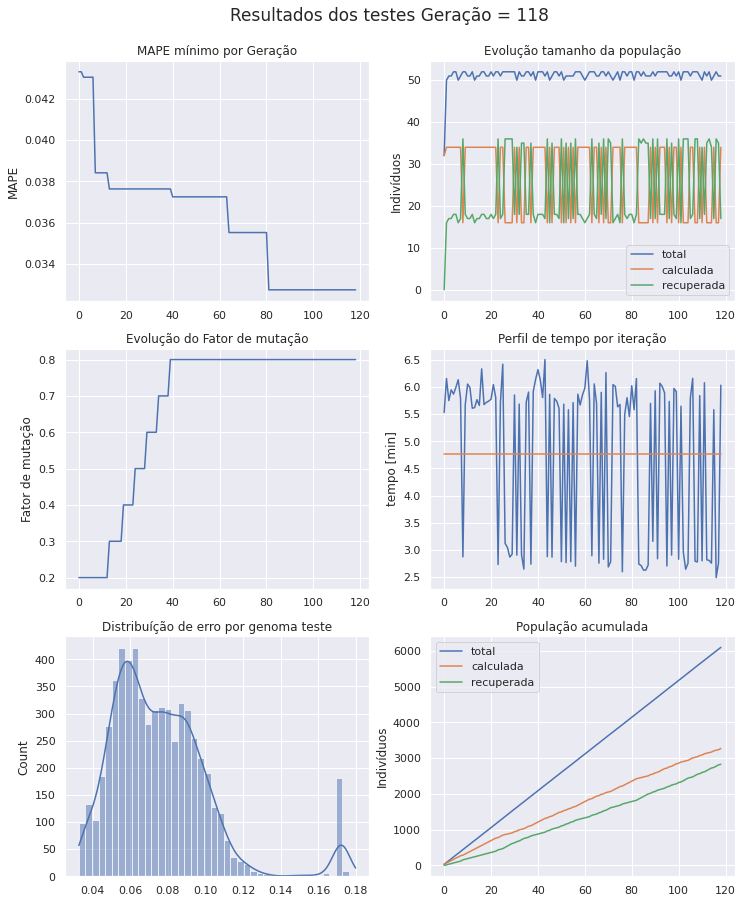

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 119 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [52 62 41 14 26  0 60 62 56 34 12 32  3]
Projenitores [34 59 42 44 52 48 29 56 42 17 24 15 49]
Projenitores [31 17 37 24  0 43 63 60  4 44 46 41 17]
Projenitores [ 8  2 57 46 15 54 31 55 22 41 56 35  5]
Projenitores [33  2 11 46 15 54 31 55 46 41 24 18  5]
Projenitores [50 62 35 14 37 19 51 26 56 49 42 32  3]
Projenitores [54 12 29 29 28 39 63 37 49 23 46 41 28]
Projenitores [ 5  2 22 48 44 39 61 43  7 57 60 30 62]
Projenitores [50 41 35 29 37 19 51 26 22 49 42  6 40]
Projenitores [52 41 41 29 26  0 60 62 22 34 12  6 40]
Projenitores [ 4 43 47 60 53 56 19 21 32  0 41 59  0]
Projenitores [40 36 44 55 20 43 49 18 46 21 52 57 31]
Projenitores [15 56  3 62 35 14 24 24 56 41 30 13 59]
Projenitores [27 63 15 31  1 19 53 47 19  2  5 49  5]
Projenitores [24 15 43 14 13  3 61 52  2

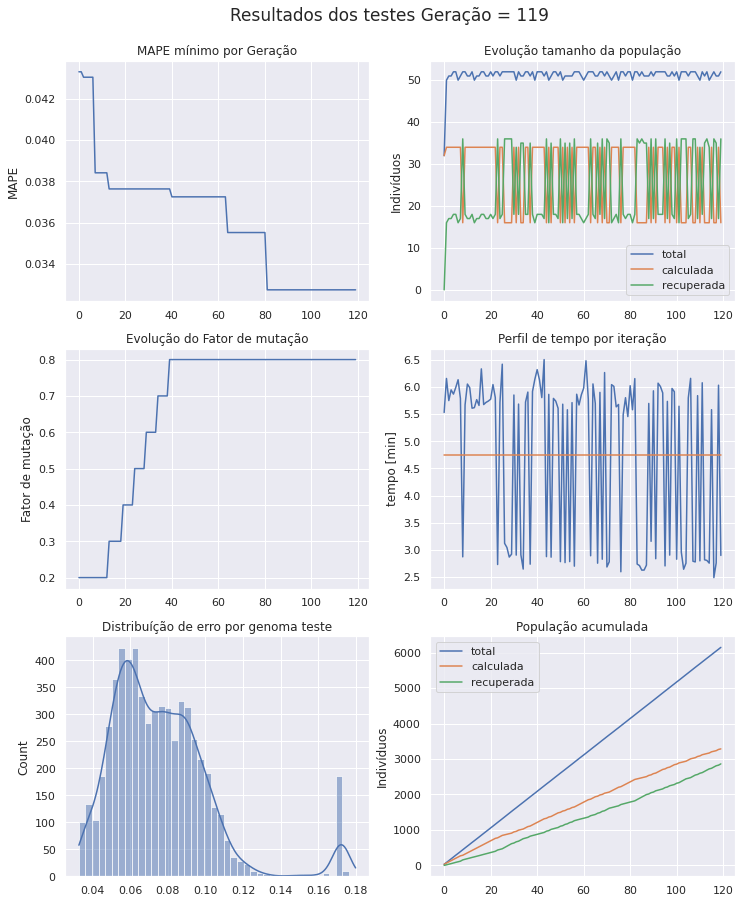

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 120 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [35  0 29 23 54 53 61  8 50 54 22 37 40]
Projenitores [52 62 41 14 26  0 60 62 56 34 12 32  3]
Projenitores [27 49 49 47 13 40 14 45 23 16 28 42 45]
Projenitores [54 12 29 29 28 39 63 37 49 23 46 41 28]
Projenitores [52 62 42 44 52  0 29 62 56 17 24 32 49]
Projenitores [54 15  5 17 42 20 54 48 22 37 13 49 50]
Projenitores [ 5  2 22 48 44 39 61 43  7 57 60 30 62]
Projenitores [14 15 36 14 13  3  6 55 30 54 63 39 12]
Projenitores [39 34 10 54 32 41 18 22  6  2  7 39 48]
Projenitores [26 43 22  7 35 53 47 46 60 51 34 36 36]
Projenitores [ 8  2 57 24  0 54 31 60  4 44 46 35  5]
Projenitores [27 56  3 31 35 14 24 47 19  2  5 49 59]
Projenitores [32 19  3 24 19 37 30 38 47 39  5 15 63]
Projenitores [ 2 20 19 48 54 32 61 28 55 18 31 28 30]
Projenitores [52 41 41 29 37 19 51 26 22

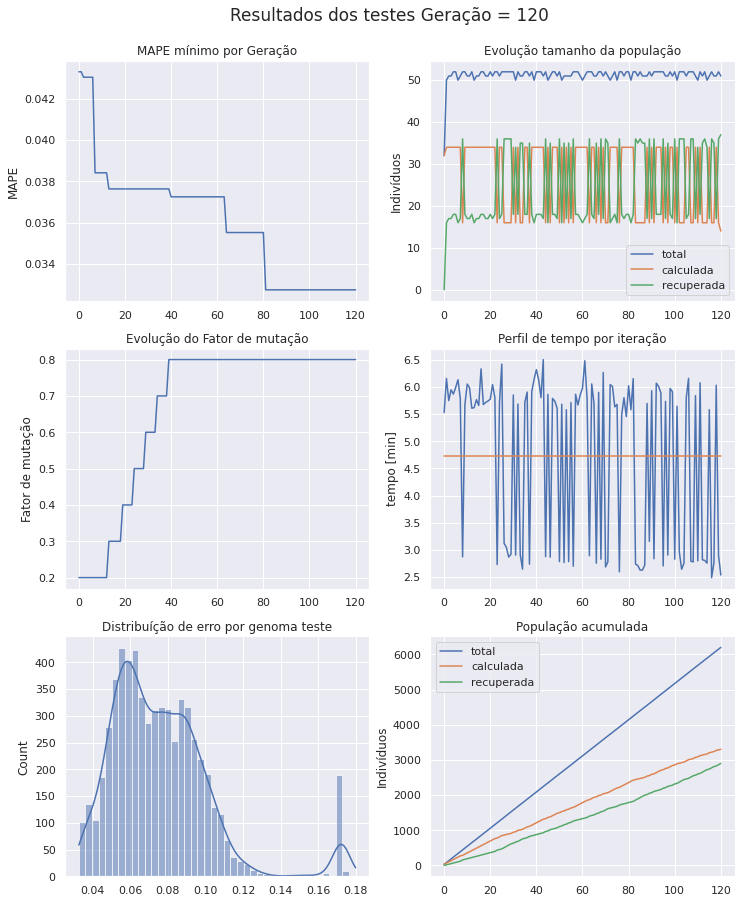

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 121 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [44 42 41  1  5 42 22 17 49 59 56 52  2]
Projenitores [35 62 29 23 26  0 60  8 50 34 22 37  3]
Projenitores [54 41 44 35 62 31 44 49  4 53 46  5 30]
Projenitores [ 5  2 22 48 44 39 61 43  7 57 60 30 62]
Projenitores [ 1 27 51 54 13 38 51 28  9 24  6 45 21]
Projenitores [41 53 61 21 20 22 50 58 15 51 44 30 42]
Projenitores [ 2 19  3 24 54 32 30 38 47 39 31 28 63]
Projenitores [26 43 22  7 35 53 47 46 60 51 34 36 36]
Projenitores [14 15 36 14 13  3  6 55 30 54 63 39 12]
Projenitores [ 2 20 19 48 54 32 61 28 55 18 31 28 30]
Projenitores [54 62 42 44 52  0 54 48 56 17 24 49 50]
Projenitores [50 41 35 29 37 19 51 26 22 49 42  6 40]
Projenitores [ 8  2 57 24  0 54 31 60  4 44 46 35  5]
Projenitores [26 34 22  7 32 41 47 46 60  2 34 36 36]
Projenitores [52  0 41 14 54 53 61 62 56

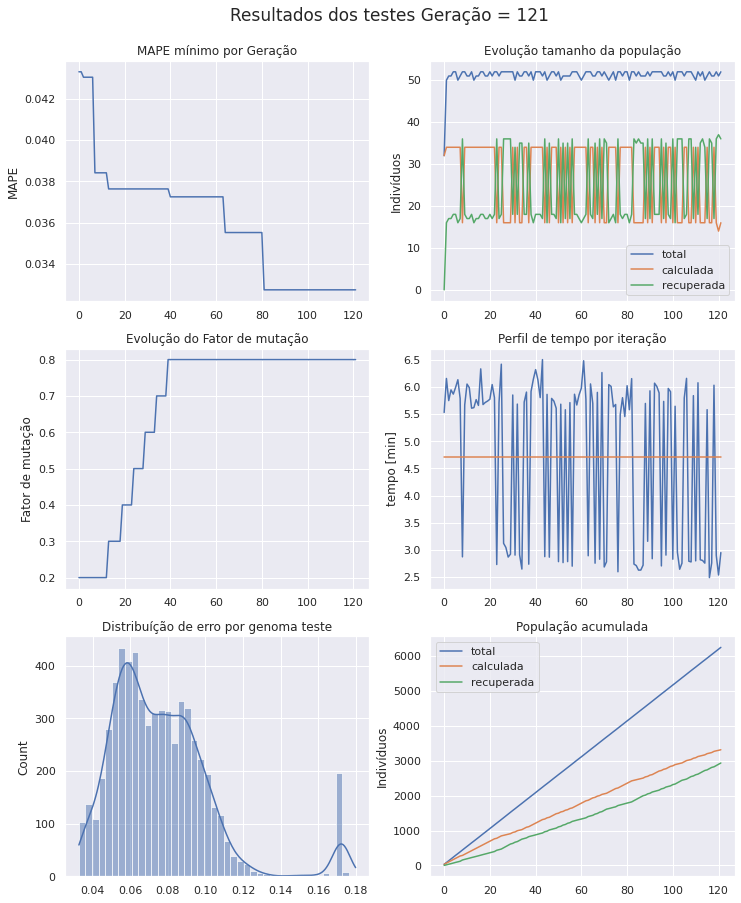

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 122 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [15 56 35 56  7 59 25 61 25 58 19  8 46]
Projenitores [54 41 22 48 44 31 44 43  4 53 60  5 62]
Projenitores [33 44 25 33 40 28  8 47 29 31 24 56 44]
Projenitores [ 2 19  3 24 54 32 30 38 47 39 31 28 63]
Projenitores [ 8  2 57 46 15 54 31 55 22 41 56 35  5]
Projenitores [28  7 53 33 14 44  9 52 42 18 33  7 48]
Projenitores [26  2 57  7  0 41 31 60 60  2 46 36  5]
Projenitores [26 43 22  7 35 53 47 46 60 51 34 36 36]
Projenitores [14 15 36 14 13  3  6 55 30 54 63 39 12]
Projenitores [52  0 41 14 54 53 61 62 56 54 12 32 40]
Projenitores [41 27 51 54 20 22 50 58  9 51 44 30 21]
Projenitores [39 34 10 14 32 53 61 62  6 54 12 39 40]
Projenitores [50 41 35 29 37 19 51 26 22 49 42  6 40]
Projenitores [14 20 36 48 13  3 61 28 55 54 31 28 30]
Projenitores [35 62

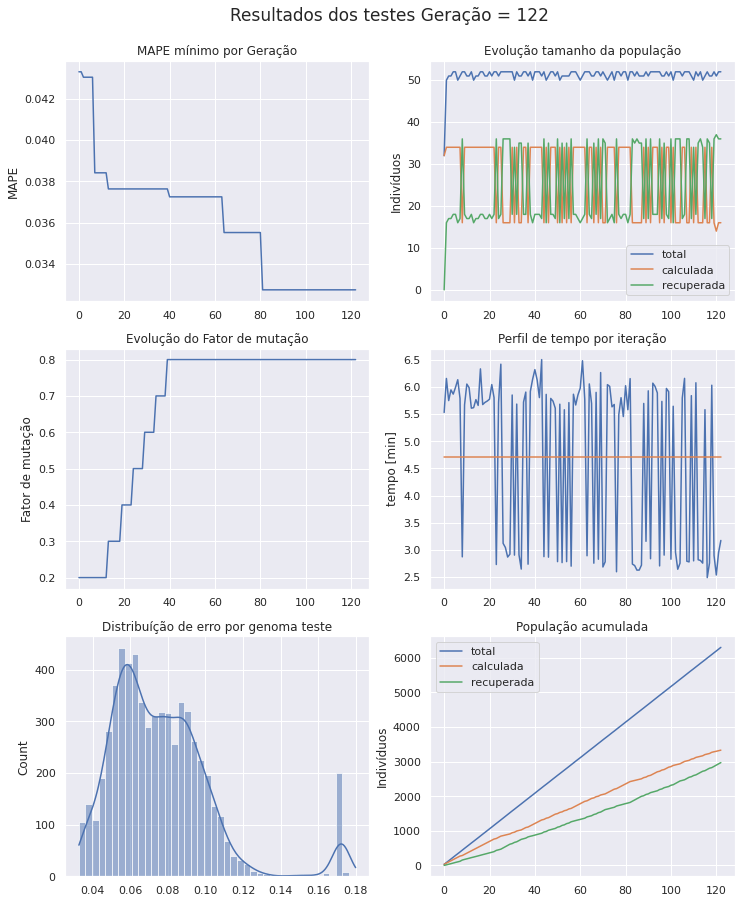

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 123 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [24  6 34 49  4  1 18 32 23 51 41 50  4]
Projenitores [46 16 52 22 37 60 36 21 56 49 32  3  3]
Projenitores [ 2 20 19 23 54  0 22 17 55 59 22 28  3]
Projenitores [54 57 37 23 21 39 45 43 37  9 56 62 62]
Projenitores [44 52 50 57  4 62 22 13 62 12 35 32 39]
Projenitores [33  1 11 45 12  9 33 50 46 38 24 18  7]
Projenitores [26 43 22  7 35 53 47 46 60 51 34 36 36]
Projenitores [33 51 60 12 38 56 22  9  4 41 62 42 32]
Projenitores [54 41 22 48 44 31 25 61  4 58 60  5 62]
Projenitores [39 34 10 14 32 53 61 62  6 54 12 39 40]
Projenitores [28 24 62 23 38 55 50 15 57  9 36  6 22]
Projenitores [50 41 35 29 37 19 51 26 22 49 42  6 40]
Projenitores [ 8  7 53 33 15 54 31 55 42 41 56 35 48]
Projenitores [35 62 29 48 26 32 61 28 50 18 31 37 30]
Projenitores [ 8  2 57 46 15 54 31 55 22

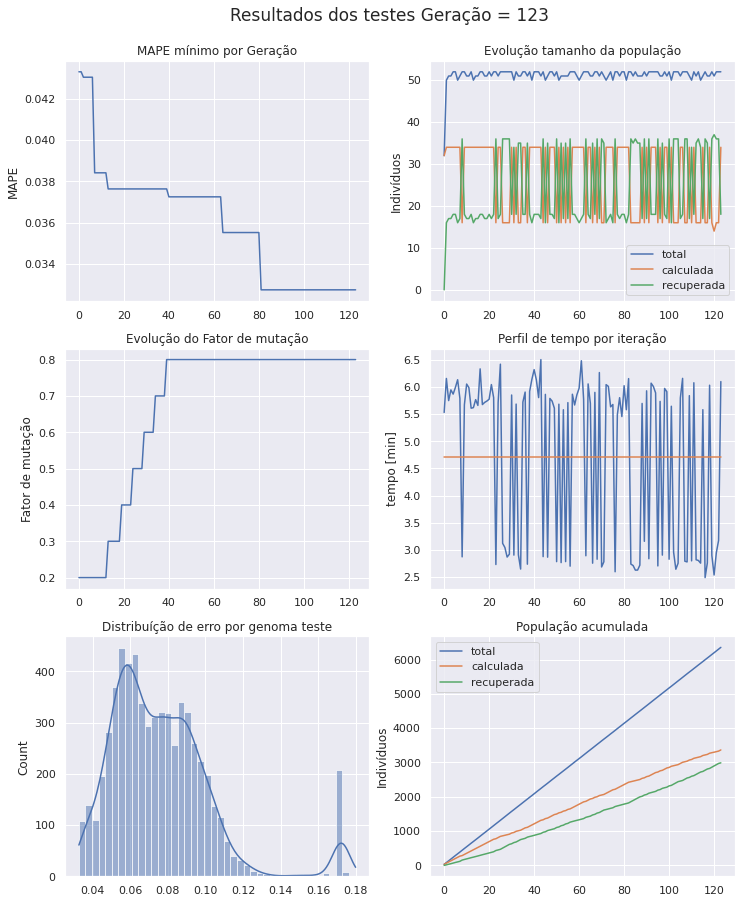

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 124 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [62 36 55  3 25 26 37 53 59 37 55 42 18]
Projenitores [ 8  7 53 33 15 54 31 55 42 41 56 35 48]
Projenitores [28 41 35 29 38 19 50 15 57 49 42  6 40]
Projenitores [48  4 61 16 47 48  1 50 30  9 25 11  4]
Projenitores [22 16 52 24 14 33 54 22 35 47 10 10 31]
Projenitores [54 41 22 48 44 31 25 61  4 58 60  5 62]
Projenitores [16 58 41 18  6 53 25  1 25 35 27  3 19]
Projenitores [34 49 60  7 21 44 59 40 56 17  0  0  2]
Projenitores [33 31 52 45 57 37 63  9 27 51 40 34 12]
Projenitores [ 2 57 37 23 54 39 45 17 55 59 22 62 62]
Projenitores [38 55 16 29 15 51 19 55 33 44 20  8 56]
Projenitores [35 62 29 48 26 32 61 28 50 18 31 37 30]
Projenitores [35  7 53 33 26 32 61 28 42 18 31 37 48]
Projenitores [33  1 50 57  4  9 22 50 62 12 24 32  7]
Projenitores [30 12 45 45  2 27 14 40 45

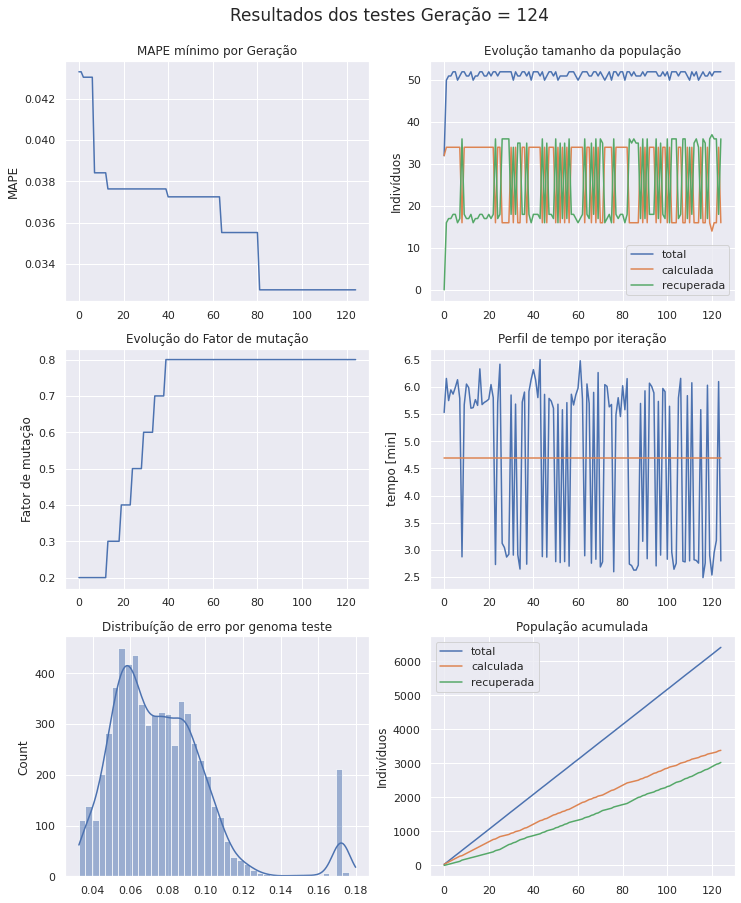

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 125 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [24 22  9 49 14 31 24 16 16 49  3 32 18]
Projenitores [17  8 62 13  0 34 62 28 16 24 27 15 17]
Projenitores [ 4 19 45 28 27 27 14 40 45 35 30 47  0]
Projenitores [25 63 39 21 61 52 60 42 29 11 38 18  6]
Projenitores [58 46 31 26 61 34 16 40 39 12 24 45 30]
Projenitores [41 11 27 38 43 59 45 49 53 28 34 42 49]
Projenitores [34 49 60  7 21 44 59 40 56 17  0  0  2]
Projenitores [57 57 34 44 26 15 34 27 12 63 30 22 52]
Projenitores [ 8  7 55  3 15 54 31 55 42 41 56 35 48]
Projenitores [35 62 29 48 26 32 61 28 50 18 31 37 30]
Projenitores [63 24 62 58 41 57 24 44 43 21 13 47  8]
Projenitores [35  7 53 33 26 32 61 28 42 18 31 37 48]
Projenitores [54 16 22 48 44 31 25 61 35 47 60 10 62]
Projenitores [30 12 60 45  2 28 52 53 53 29 51 42 47]
Projenitores [22 16 52 24 14 33 54 22 35

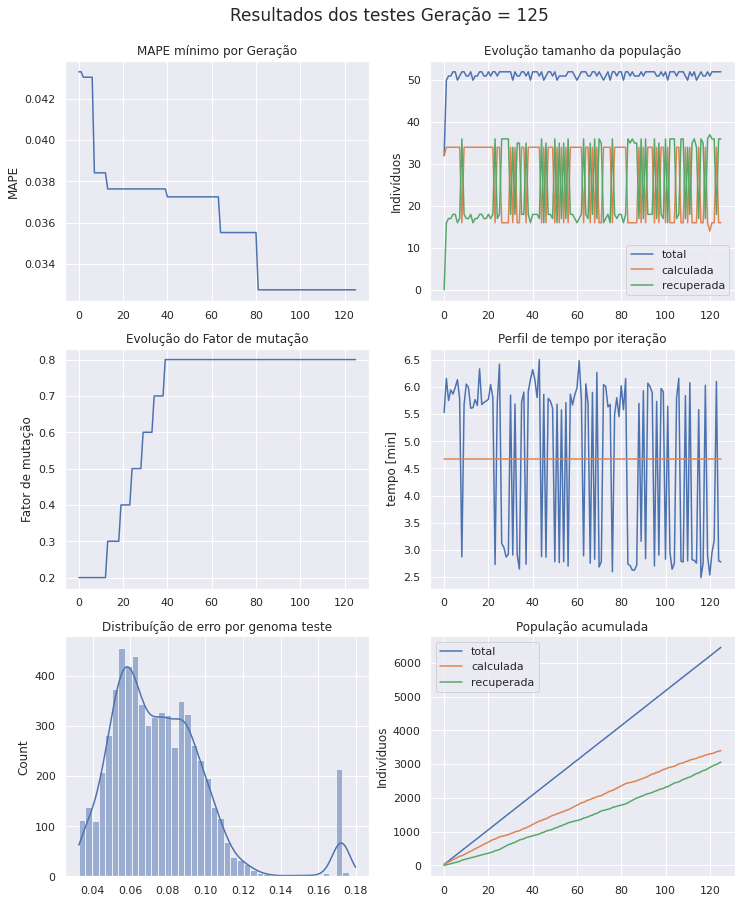

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 126 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [16 49 60  7 21 44 59 40 25 17  0  0 19]
Projenitores [46 42  0 47 23 40 28 47 19 22 25 52 11]
Projenitores [63 24 62 58 41 57 24 44 43 21 13 47  8]
Projenitores [ 4 63 39 21 27 52 60 40 45 35 30 18  6]
Projenitores [35 24 62 58 26 57 61 28 42 21 13 37  8]
Projenitores [16 16 52  7 21 44 59 22 35 47 10  0 19]
Projenitores [30 49 51 56 40 28 63 50 11 28  8 43 51]
Projenitores [54 12 60 45 44 31 25 61 53 47 60 10 47]
Projenitores [48  4 61 16 47 48  1 50 30  9 25 11  4]
Projenitores [38 55 16 29 15 51 19 55 33 44 20  8 56]
Projenitores [62 36 55  3 25 26 37 53 59 37 55 42 18]
Projenitores [16 29 60 31 46 55 51 56 29 58 41 57 32]
Projenitores [35  7 53 33 26 32 61 28 42 18 31 37 48]
Projenitores [16 58 41 18  6 53 25  1 25 35 27  3 19]
Projenitores [22 16 52 24 14 33 54 22 35

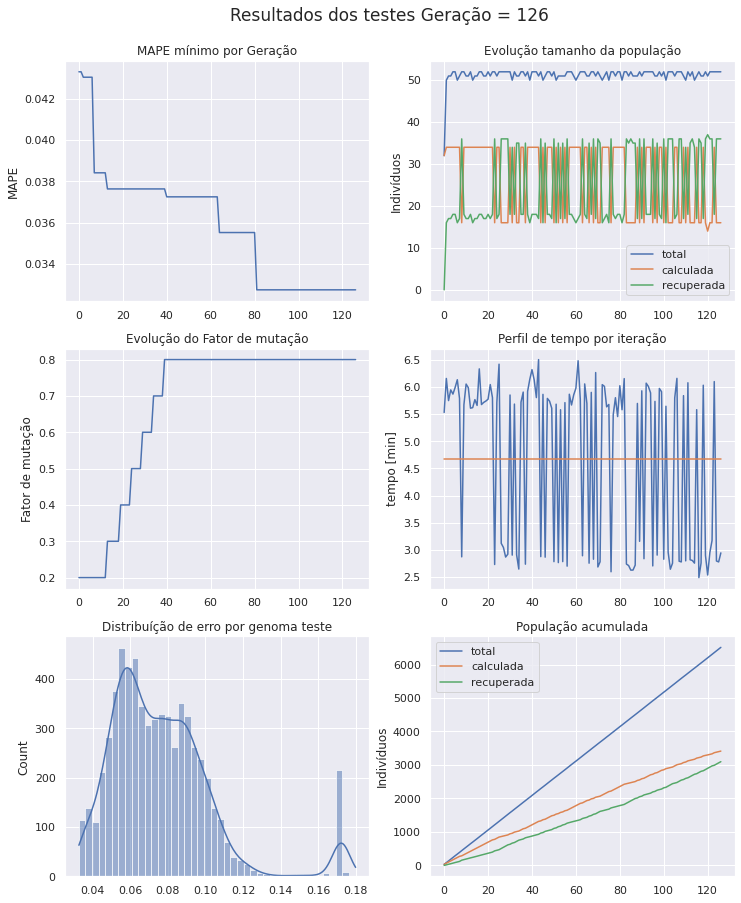

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 127 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [22 16 52 24 14 33 54 22 35 47 10 10 31]
Projenitores [48  4 61 16 47 48  1 50 30  9 25 11  4]
Projenitores [38 55 16 29 15 51 19 55 33 44 20  8 56]
Projenitores [10  4 56  0 37 39 55 57 53 13 39 22 45]
Projenitores [54 12 51 56 40 28 63 50 53 47  8 10 51]
Projenitores [43 53 63 45 49  7 34 23 48 10 19 33 24]
Projenitores [21 54 57  5 17 14 62  4 11 62 16 26 43]
Projenitores [ 7 36 41 52 15 21 48 13 25  4 62 42 23]
Projenitores [21 53 34 42 10 58  8 19 45 22 54 61  9]
Projenitores [37  5 19 20 28 43 42 46 13 10 40 18 16]
Projenitores [16 36 60  3 25 55 37 53 59 58 41 42 32]
Projenitores [ 4 19 45 28 27 27 14 40 45 35 30 47  0]
Projenitores [16 58 41 18  6 53 25  1 25 35 27  3 19]
Projenitores [54 12 60 45 44 31 25 61 53 47 60 10 47]
Projenitores [ 7 56

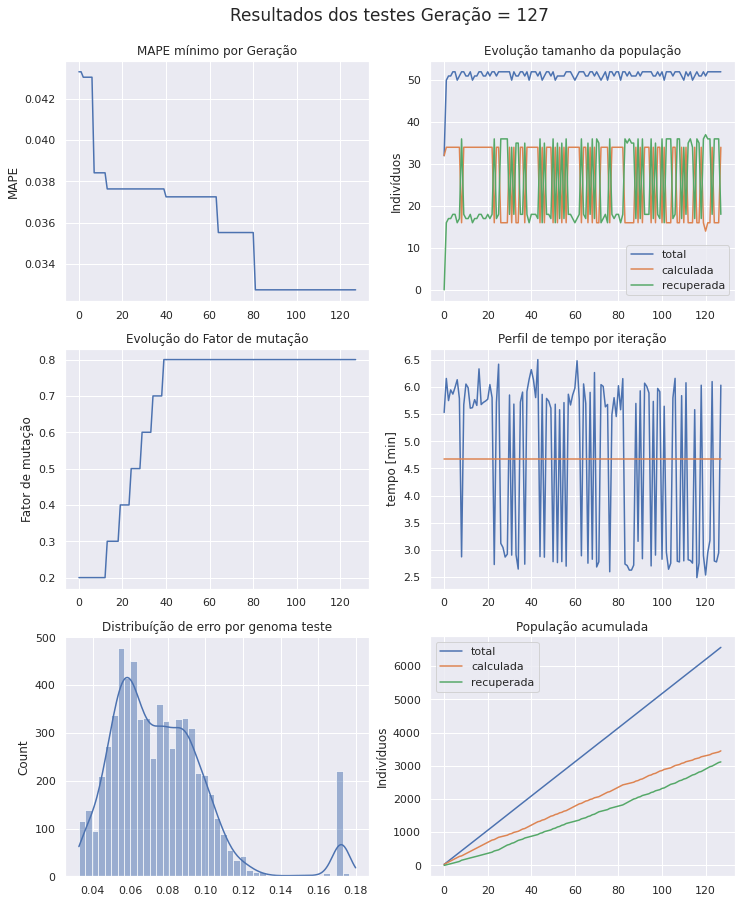

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 128 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [54 12 63 56 49 28 63 50 53 47 19 33 24]
Projenitores [27 34 26 17 38 52 50 59 32 37 36  9 60]
Projenitores [48 18 21  0 51 24 47 46 29 16 58 18 62]
Projenitores [54 12 60 45 44 31 25 61 53 47 60 10 47]
Projenitores [32 54 26  3 14  4 49 58 40 55 33 16 32]
Projenitores [ 4 19 45 28 27 27 14 40 45 35 30 47  0]
Projenitores [ 9 37 10  2  4 51 57 28 41 26 12 33 24]
Projenitores [37  5 19 20 28 43 42 46 13 10 40 18 16]
Projenitores [61 14 44 50 53 45 46 48 44 20 41  1 19]
Projenitores [26 16 11  1  4 56 28  4 33  9  3 22 21]
Projenitores [38  4 47 31 21 48 36 39 27 38 31 20 27]
Projenitores [ 4 19 60 28 25 55 37 53 45 58 30 42  0]
Projenitores [38 55 16 29 15 51 19 55 33 44 20  8 56]
Projenitores [54 12 51 56 40 28 63 50 53 47  8 10 51]
Projenitores [35  0 29 23 54 53 61  8 50

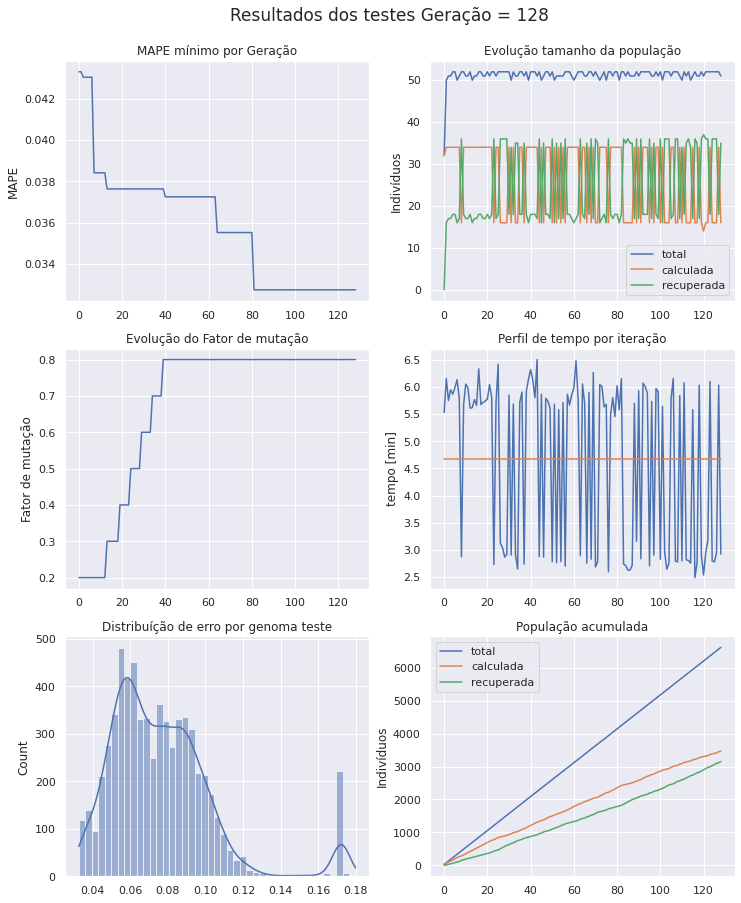

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 129 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [35  0 29 23 54 53 61  8 50 54 22 37 40]
Projenitores [61 14 44 50 53 56 28  4 33 20 41 22 19]
Projenitores [54 34 26 17 49 28 50 59 53 37 19  9 24]
Projenitores [48 12 60 45 51 31 25 46 29 47 58 18 62]
Projenitores [37  5 10  2  4 43 42 28 13 10 40 33 24]
Projenitores [ 6 26 56 56  0 21 37  7 15 60 59 41 27]
Projenitores [37 50 26 60 62  1 60 18 15 17 50  4  0]
Projenitores [48 18 21  0 51 24 47 46 29 16 58 18 62]
Projenitores [44 22 42 51 32 34 15  0 19  9 48  4 15]
Projenitores [38  4 47 31 21 48 36 39 27 38 31 20 27]
Projenitores [54 12 60 45 44 31 25 61 53 47 60 10 47]
Projenitores [ 4  4 60 28 25 48 37 39 27 58 30 42  0]
Projenitores [63 27  8 55 54  9 37 35 19 63 56 15 63]
Projenitores [ 1 58 57 49 57 63 37 22 34 41 53 19 53]
Projenitores [61 14 44 50 53 45 46 48 44

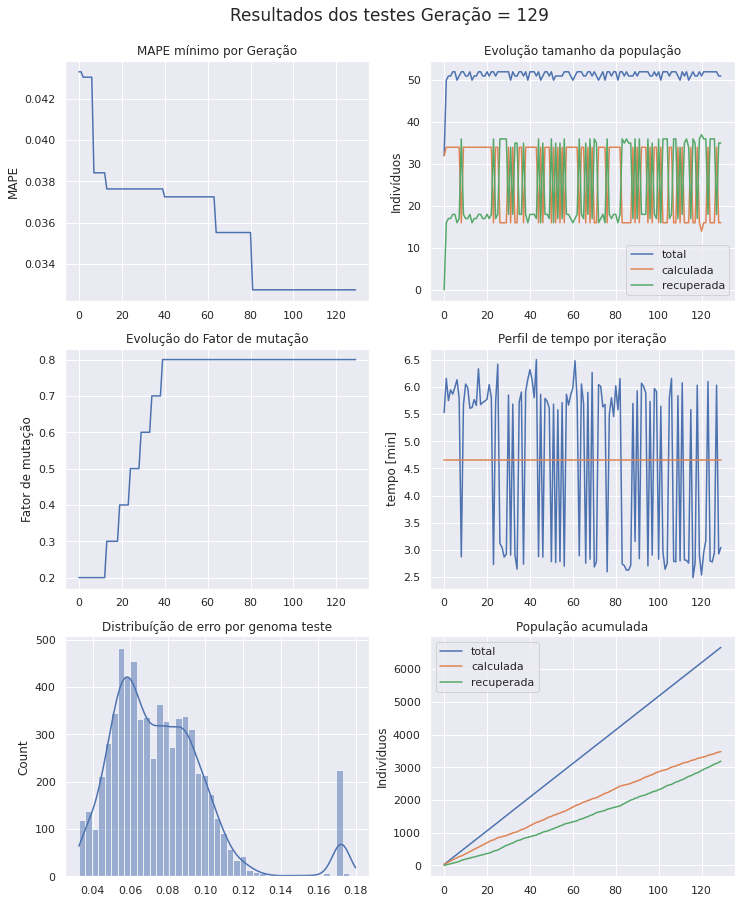

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 130 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [61 54 44  0 53 26 46 48 59  6 63  1 31]
Projenitores [61 32  0 56 26 61 56 51 12 40  2 38  5]
Projenitores [ 7 26  8 61 36 32 50 41 43 23 14 58 53]
Projenitores [14 14 25 41 59 12 50 62 31 38 48 51 60]
Projenitores [37 50 26 60 62  1 60 18 15 17 50  4  0]
Projenitores [31 54  3 54 10 55 58 16 62 37 23  4 51]
Projenitores [61 14 29 23 53 53 61  8 50 20 22 22 40]
Projenitores [ 6 51 40 32 39 63 38 17 39  0 10 27 56]
Projenitores [54 22 61 23 36 34 43 39 21 26 34  0 34]
Projenitores [ 4  4 60 28 25 48 37 39 27 58 30 42  0]
Projenitores [ 6 26 56 56  0 21 37  7 15 60 40 33 27]
Projenitores [31  3 29 36 22 38 44 14 42 28 35 12 31]
Projenitores [48 12 60 45 51 31 25 46 29 47 58 18 62]
Projenitores [48 18 21  0 51 24 47 18 29 17 58 18  0]
Projenitores [54 12 60 45 44 31 25 61 53

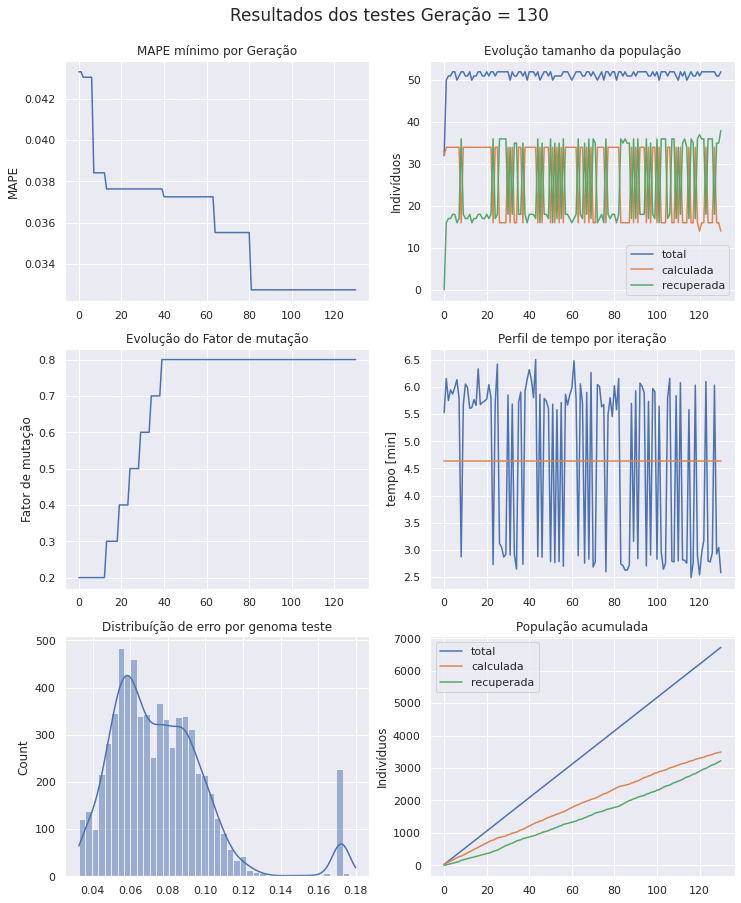

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 131 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 4 22 61 23 36 48 37 39 21 26 30  0  0]
Projenitores [35  0 29 23 54 53 61  8 50 54 22 37 40]
Projenitores [38 26 34 49 60  7 21 44 59 40 56 17  0]
Projenitores [37 50 26 60 62  1 60 18 15 17 50  4  0]
Projenitores [35 12 56 45 44 45 33 42 44 47 60 10 47]
Projenitores [55 39 16 58 41 18  6 53 25  1 25 35 27]
Projenitores [45 61 62 36 55  3 25 26 37 53 59 37 55]
Projenitores [31  3 29 36 22 38 44 14 42 28 35 12 31]
Projenitores [ 6  3 29 56  0 21 44  7 42 28 35 33 27]
Projenitores [42 18  4 19 60 28 27 28 52 53 53 35 51]
Projenitores [31 54  3 54 10 55 58 16 62 37 23  4 51]
Projenitores [ 6 51 40 32 39 63 38 17 39  0 10 27 56]
Projenitores [54 12 60 45 44 31 25 61 53 47 60 10 47]
Projenitores [61 14 29 23 53 53 61  8 50 20 22 22 40]
Projenitores [10 31 33 31 52 45 57 37 63

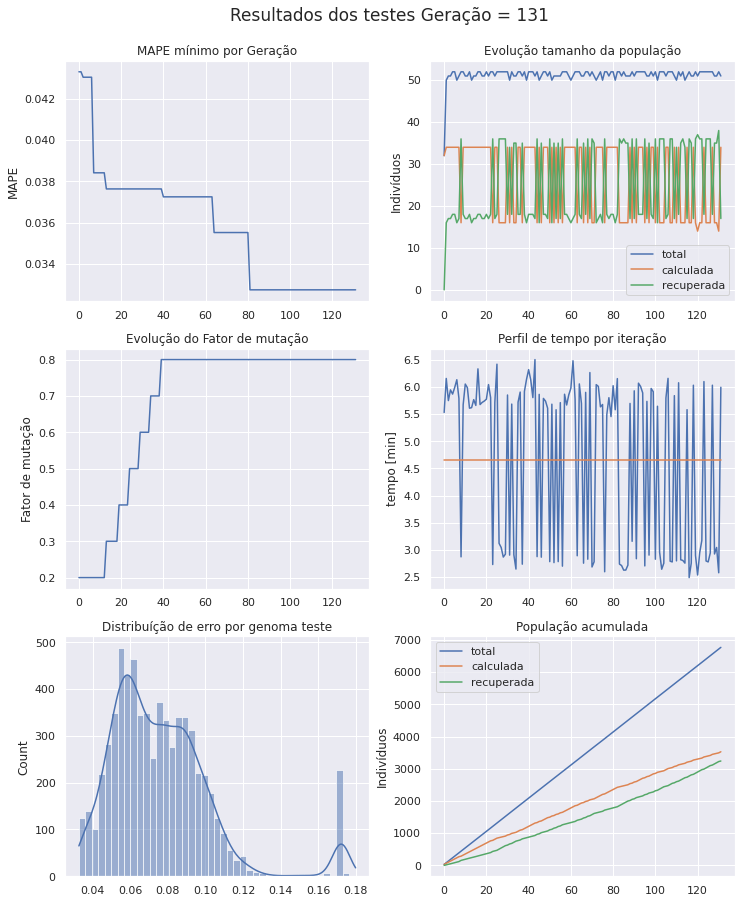

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 132 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [54 31 60 50 22 45 25 37 63  9 27 51 40]
Projenitores [56 40 63 35 26 21 46 45 22 21 62 34 32]
Projenitores [54 12 60 45 44 53 61 61 53 20 60 22 47]
Projenitores [60 50 28 23 63 14 20 44 18 55  0  5 30]
Projenitores [37 26 34 49 60  7 21 44 15 17 56  4  0]
Projenitores [31 54  3 54 10 55 58 16 62 37 23  4 51]
Projenitores [61 14 29 23 53 31 25  8 50 47 22 10 40]
Projenitores [33 41 40  9  6  9 32  5 58 60 41  3 32]
Projenitores [37 45 14  2 61 39 33  9 12 56 63 41 11]
Projenitores [42 18  4 19 60 28 27 28 52 53 53 35 51]
Projenitores [37 50 26 60 62  1 60 18 15 17 50  4  0]
Projenitores [38 26 34 49 60  7 21 44 59 40 56 17  0]
Projenitores [10 14 33 31 52 31 57 61 53 20 41 31 19]
Projenitores [35 12 56 45 44 45 33 42 44 47 60 10 47]
Projenitores [55 39

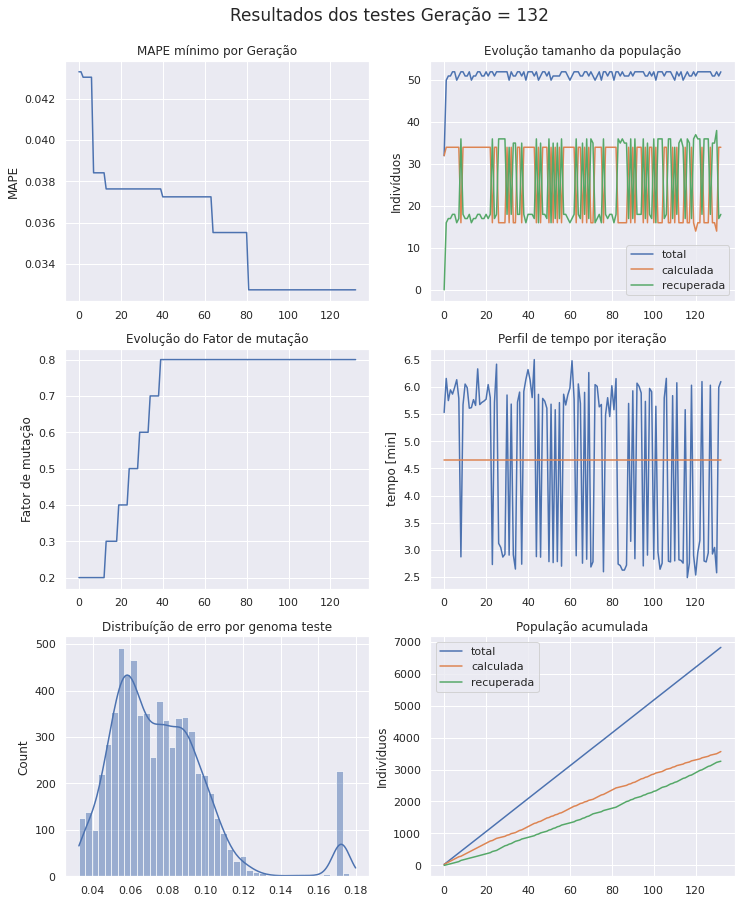

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 133 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [55 39 16 58 41 18  6 53 25  1 25 35 27]
Projenitores [37 45 14  2 61 39 33  9 12 56 63 41 11]
Projenitores [42 18  4 19 60 28 27 28 52 53 53 35 51]
Projenitores [35  3 43 59  8 41 48 40 44 28 31 24  0]
Projenitores [61 41 40 23  6  9 25  8 58 47 22  3 32]
Projenitores [48 24 55 26 17 47  6 42 39 28 29  1 42]
Projenitores [26 26 12 24 54 60 43  3 31 62 22 49 42]
Projenitores [11 63 58 29 38 24 42 36 20 58 41 63 17]
Projenitores [ 5  5  6 12 23 50  8 13 62 25 61 17  8]
Projenitores [33 47 25 42 14 29 23 45 26 62 14 50 59]
Projenitores [38 26 26 49 62  7 60 18 15 40 56  4  0]
Projenitores [38 50 26 60 62  1 60 18 59 40 50 17  0]
Projenitores [35 12 56 45 44 45 33 42 44 47 60 10 47]
Projenitores [33 41 40  9  6  9 32  5 58 60 41  3 32]
Projenitores [ 8 58 17 56 34 11 20 31  1

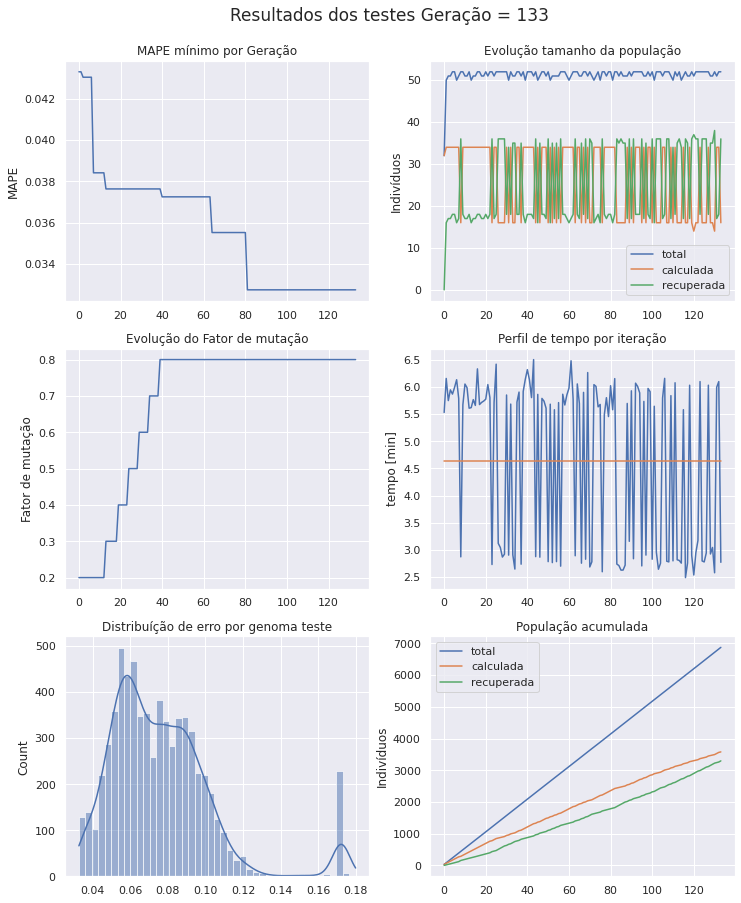

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 134 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [11 63 58 29 54 24 42 36 31 62 41 49 17]
Projenitores [42 18 49 35 34 21 20 23 50 42 23 57 41]
Projenitores [55 45 16 58 61 18 33 53 12 56 63 41 11]
Projenitores [35  0 29 23 54 53 61  8 50 54 22 37 40]
Projenitores [27 34 26 17 38 52 50 59 32 37 36  9 60]
Projenitores [61 41 40 23  6  9 25  8 58 47 22  3 32]
Projenitores [32 54 26  3 14  4 49 58 40 55 33 16 32]
Projenitores [49 58 45 37 61 58 16 57 17  1 41  9 38]
Projenitores [38 26 26 49 62  7 60 18 15 40 56  4  0]
Projenitores [ 8 58 17 56 34 11 20 31  1 42  6 39 41]
Projenitores [38 26 26 49 62  1 60 18 15 40 56 17  0]
Projenitores [35 12 56 45  6  9 32 42 44 60 60  3 47]
Projenitores [42 18 49 35 39 21 38 23 50 48 23 57 44]
Projenitores [26 26 12 24 54 60 43  3 31

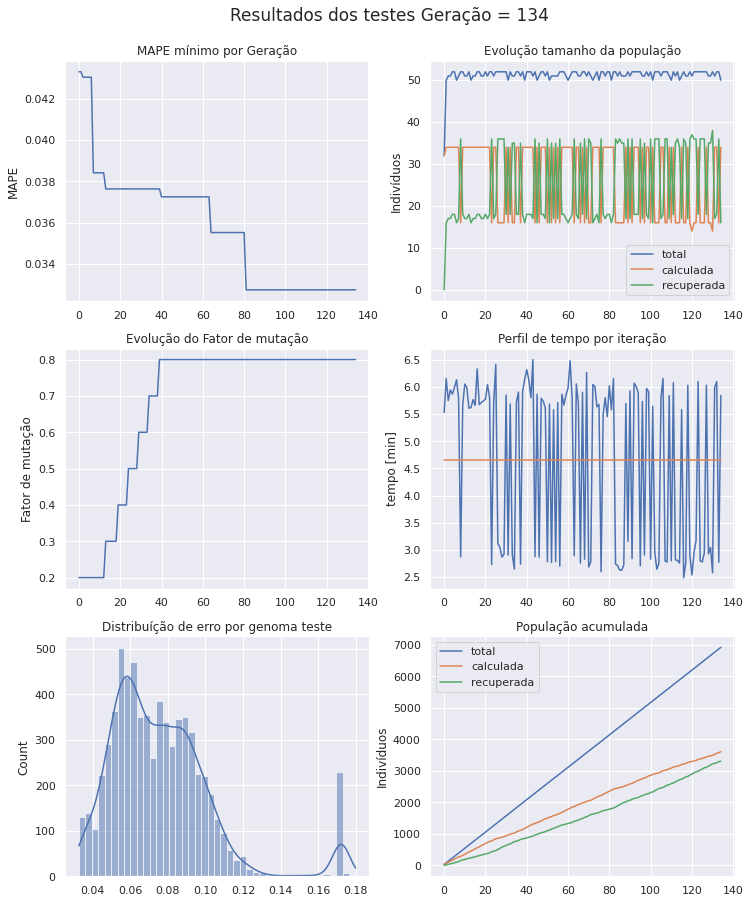

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 135 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 8 26 17 49 62  1 60 18  1 40  6 39 41]
Projenitores [54 63 58 29  8 24 63 36 49 62 41 49 28]
Projenitores [42 18 49 35 34 21 20 23 50 42 23 57 41]
Projenitores [35 18 56 35  6 21 38 42 50 48 60 57 44]
Projenitores [ 3 44 32 41 62  0  6 16  5  5 12 31  3]
Projenitores [20 18 43 28 58 28 45 51 17 40 13 28 20]
Projenitores [61 41 40 23  6  9 25  8 58 47 22  3 32]
Projenitores [49 58 45 37 61 58 16 57 17  1 41  9 38]
Projenitores [38 26 45 37 62 58 16 18 15 40 56  9  0]
Projenitores [59 37 59 23 11 48 51  6 57 54 32 21 27]
Projenitores [49 58 26 49 61  7 60 57 17  1 41  4 38]
Projenitores [27 34 26 17 38 52 50 59 32 37 36  9 60]
Projenitores [26 26 12 24 54 60 43  3 31 62 22 49 42]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [55 45 16 58 61 18 33 53 12

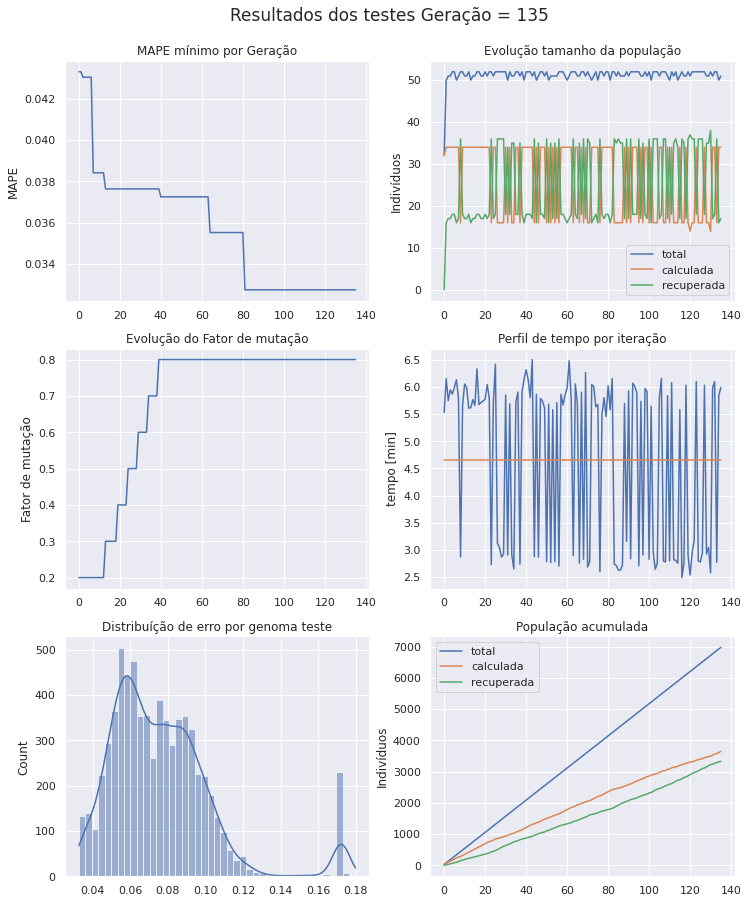

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 136 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [33 21 21 13 31 44  9 59 62 28  9  5 17]
Projenitores [16 60 38  8 38 40 54 15 22 12 58 28 31]
Projenitores [ 3 44 32 41 62  0  6 16  5  5 12 31  3]
Projenitores [42 53 57 16 31 39  2 60 10 63 61  6 25]
Projenitores [59 37 45 23 11 58 51 18 15 54 56  9 27]
Projenitores [ 0 19  9  3 47 58  6 57 22 52 28 40 39]
Projenitores [20 44 32 41 58 28 45 16 17  5 12 28 20]
Projenitores [38 26 59 37 62 48 16  6 57 40 32 21  0]
Projenitores [54 63 58 29  8 24 63 36 49 62 41 49 28]
Projenitores [39 49 48  2  3 27 35 46 14 13 17 37 36]
Projenitores [49 58 26 49 61  7 60 57 17  1 41  4 38]
Projenitores [ 1 19 27 39 17 49 54  2 61 44 24 28 10]
Projenitores [22 13 24 38 27 37 19 35 18 50 42 23 41]
Projenitores [49 58 40 37 61 58 25  8 17 47 22  9 32]
Projenitores [55 28 37 12 43 18 56 22 33

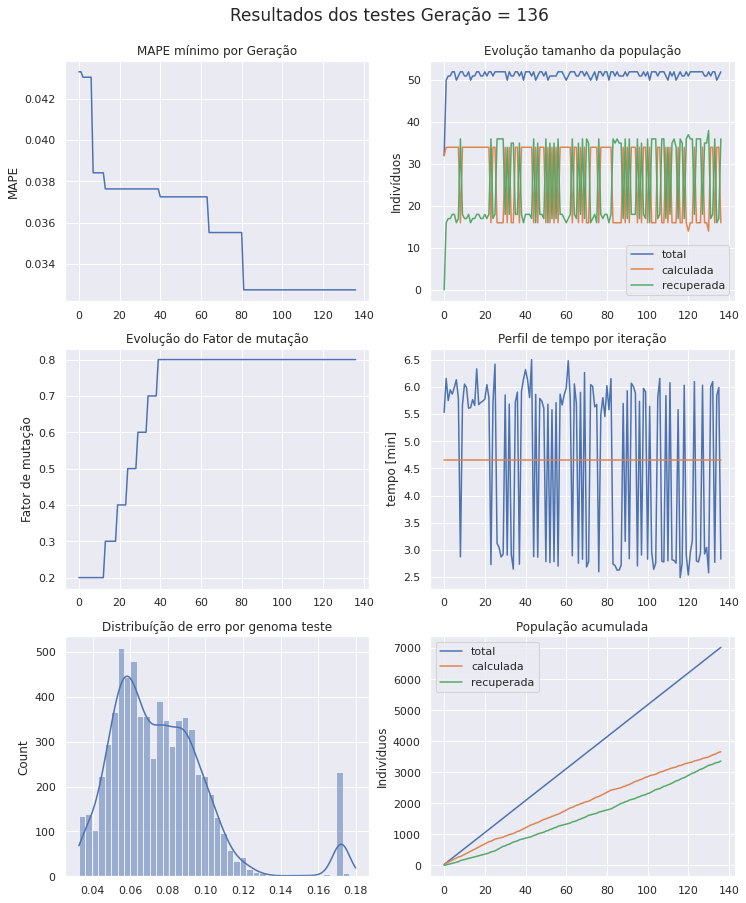

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 137 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [38 26 59 37 58 48 45  6 17  5 12 21  0]
Projenitores [22 58 40 38 61 37 19 35 17 50 42  9 32]
Projenitores [ 1 19 27 49 17 49 60  2 61 44 41  4 10]
Projenitores [18 21 63 21 53 63 31 57 20 28 52 60 31]
Projenitores [39 63 58 29  8 24 35 36 49 13 17 49 36]
Projenitores [30 34 16 21 33  7 54 18 10  7 49 62 17]
Projenitores [16 60 38  8 38 40 54 15 22 12 58 28 31]
Projenitores [48 15 52  1  2 38  1 37  0  3 54 44 17]
Projenitores [ 0 19  9  3 47 58  6 57 22 52 28 40 39]
Projenitores [59 19 45  3 11 58  6 18 15 52 56  9 39]
Projenitores [ 3 23  1 30 34 51 51  6 57 62 60 43 57]
Projenitores [ 0 37  9 23 47 58 51 57 22 54 28 40 27]
Projenitores [29 10 14 11 25 40 29 22  0 63 56 14 32]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [54 63

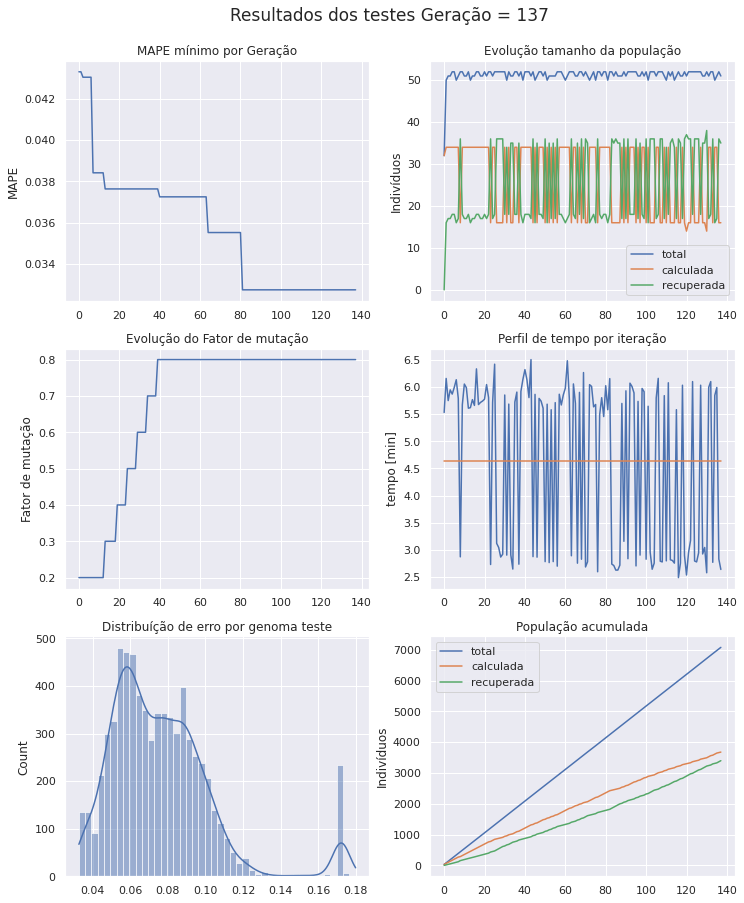

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 138 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 5  2 58 44 63 28 14 36 49 41 16 49 23]
Projenitores [22 26 59 37 58 48 45  6 17  5 12  9  0]
Projenitores [39 34 16 21  8 24 35 18 49 13 49 62 17]
Projenitores [21  6 23 40  3 29 56 25 27  4 36 19 24]
Projenitores [48 15 52  8 38 38 54 37 22 12 58 28 31]
Projenitores [38 58 40 38 61 37 19 35 17 50 42 21 32]
Projenitores [38 26 59 37 58 48 45  6 17  5 12 21  0]
Projenitores [ 1 19 27 49 17 49 60  2 61 44 41  4 10]
Projenitores [ 3 23  1 30 34 51 51  6 57 62 60 43 57]
Projenitores [61 22 42  7 47 39 25 56 21 40 34 21 59]
Projenitores [ 3 23  1 30 47 58 51 57 57 54 60 43 57]
Projenitores [47 52 53 10  2 33 34 35 47 41 50 63 47]
Projenitores [59 19 45  3 47 58  6 57 22 52 56 40 39]
Projenitores [51 42 61 17  6 39 50 45 59  3 48  4 45]
Projenitores [44 57 23 14 28 11 27 35 34

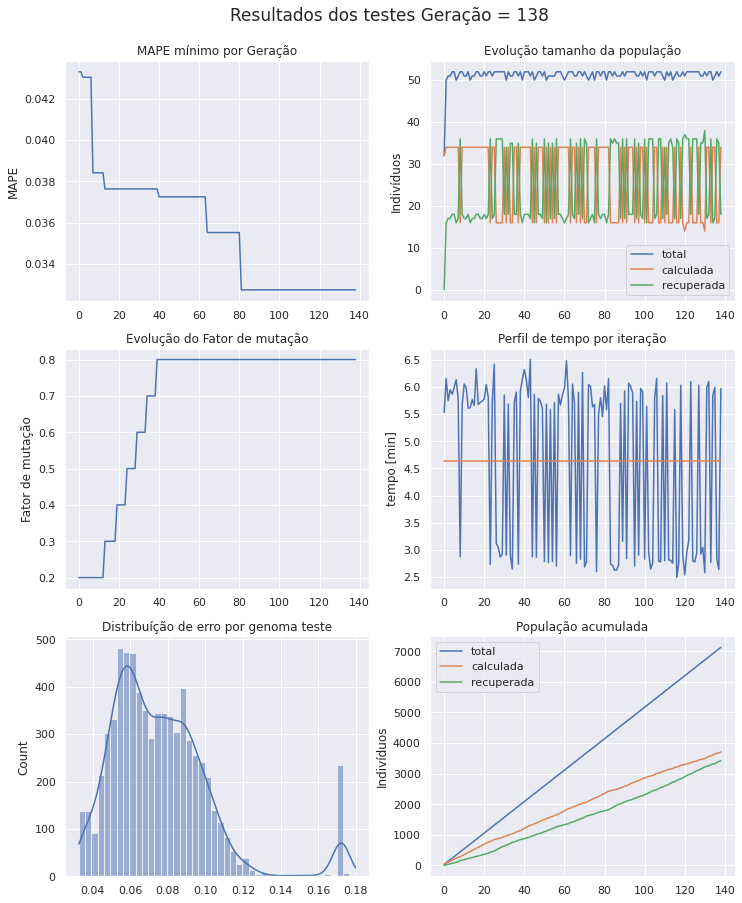

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 139 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [59 57 23 14 21 63 56 35 43 30 32 34 39]
Projenitores [22 26 59 37 58 48 45  6 17  5 12  9  0]
Projenitores [22 26 59 44 58 28 14  6 17 41 12  9  0]
Projenitores [59 19 45  3 47 58  6 57 22 52 56 40 39]
Projenitores [47 52  1 30 47 58 51 57 47 41 60 43 47]
Projenitores [48 28 51 47 10 59  4 23 14 63 21 46 60]
Projenitores [ 5  2 58 37 63 48 45 36 49  5 16 49 23]
Projenitores [22  7 35 53 47 46 60 51 34 36 36 32 19]
Projenitores [39  6 23 21  8 29 56 25 27 13 49 62 24]
Projenitores [44 17 35 54 28 11 27 45 34 47 54 54 58]
Projenitores [32 42 10  2 24 34 30 17  4  0 60 52 14]
Projenitores [39 34 16 21  8 24 35 18 49 13 49 62 17]
Projenitores [ 9  2  7 53  5 36 37 56 21 40 13 27 49]
Projenitores [38 26 27 37 58 49 45  6 17  5 41  4 10]
Projenitores [49 47 13 40 14 45 23 16 28

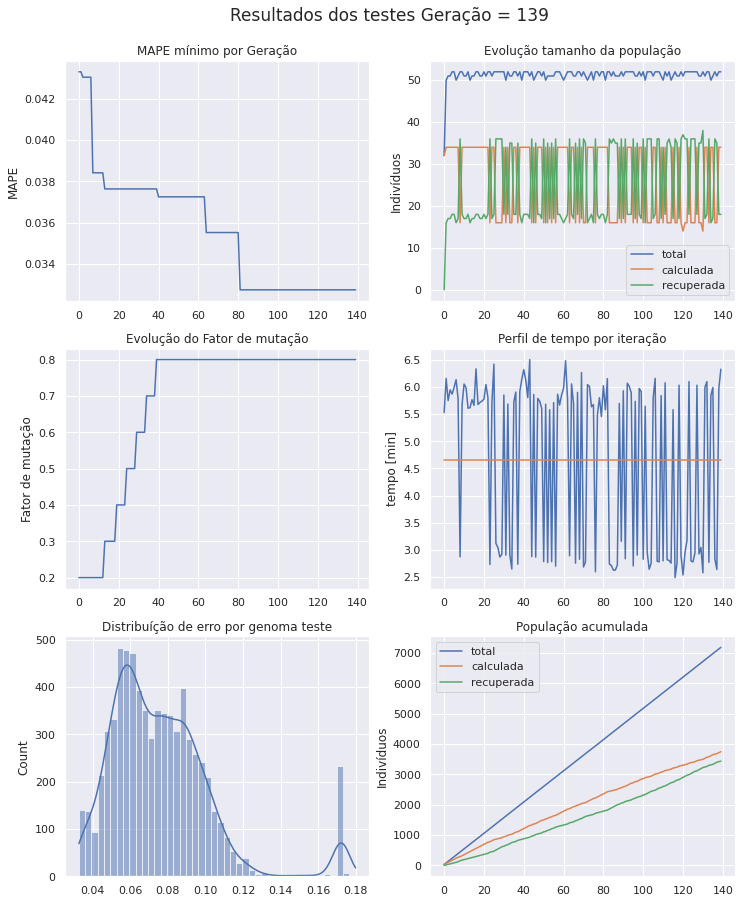

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 140 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [39 17 23 21  8 29 56 25 27 13 49 54 24]
Projenitores [21 30 41  7 28 34 15 22 45 36 40 26 52]
Projenitores [22 26 59 37 58 48 45  6 17  5 12  9  0]
Projenitores [48 28 51 30 10 58 51 23 14 41 21 43 47]
Projenitores [23 50 18  0  7 26 53 32 14 58 19 26  3]
Projenitores [26 15 28 11 54 41 60 17 51  7 13 31  4]
Projenitores [36 61 42  8 60 26 24 20 62 44 30 17 52]
Projenitores [ 7 30 30 12 11 54 39 57 49 53 39 44 44]
Projenitores [43  7 57 33 43 32 60 28 60 16 27 53 43]
Projenitores [20 55 31 41 42 17  9 32 13 62 44  7 28]
Projenitores [32 53 22 39 60 31 32 23 24 33 60 21 51]
Projenitores [22  7 35 37 63 46 45 36 49 36 36 49 23]
Projenitores [45 35 32 40 14 13 50 15 28  0 45  3 52]
Projenitores [44  6 35 54 28 11 27 45 34 47 54 62 58]
Projenitores [63 30 63 41 13 13 32 24 60

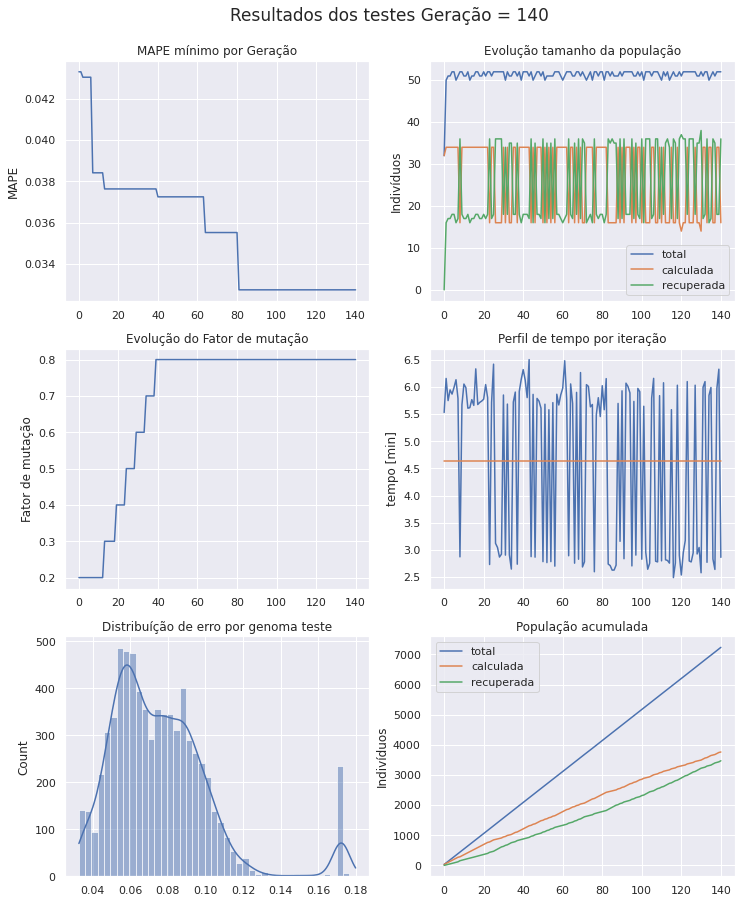

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 141 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [53  1 51 52 17 41 21  5 21 43 14 59 60]
Projenitores [ 7 30 30 12 11 54 39 57 49 53 39 44 44]
Projenitores [38 22 61 16 58  4  7 22 43  6 49 41 62]
Projenitores [48 26 59 30 58 58 45 23 17 41 12 43  0]
Projenitores [22  7 22 37 60 31 32 36 24 33 36 21 51]
Projenitores [39 34 63 41 13 24 35 24 60 47 49 55 42]
Projenitores [36 30 30  8 60 26 24 20 49 44 39 17 44]
Projenitores [22  7 35 37 63 46 45 36 49 36 36 49 23]
Projenitores [50  7 18 21 44 46 10 34  8 43 25 31 13]
Projenitores [39 17 23 21 28 29 15 25 27 13 49 26 52]
Projenitores [43  7 31 41 43 17  9 32 13 62 27  7 28]
Projenitores [28 52 60 31 39 30 38 48 35 24  8 16 54]
Projenitores [35  0 29 23 54 53 61  8 50 54 22 37 40]
Projenitores [39 17 23 21  8 29 56 25 27 13 49 54 24]
Projenitores [22 28 51 37 10 48 51  6 14

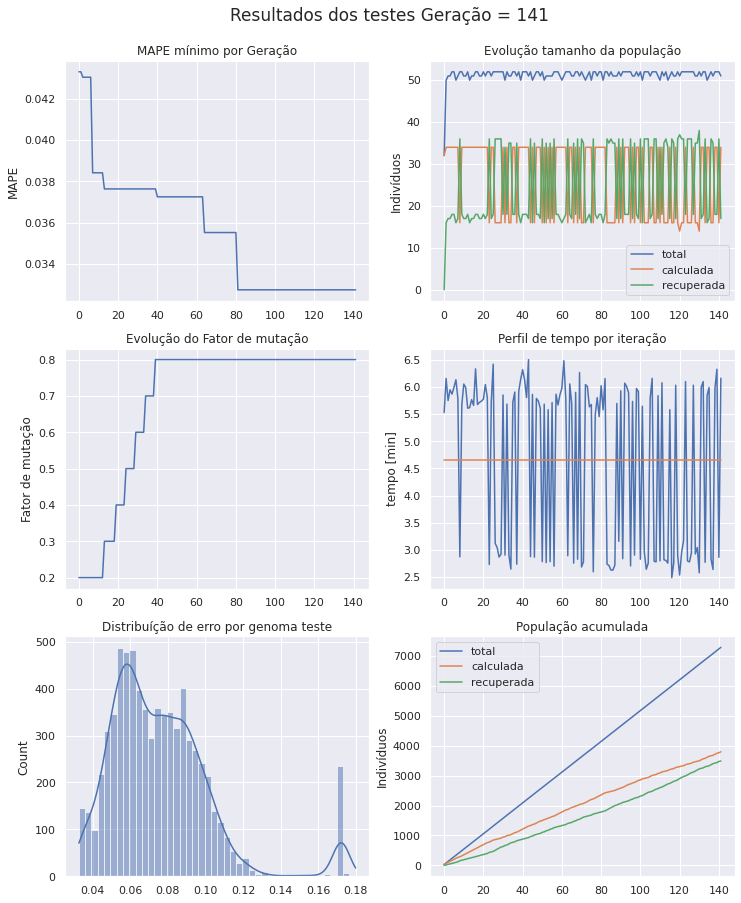

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 142 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [33 49 22 12 23 38 53  7 44 18 60 57 29]
Projenitores [38 26 59 30 58 58 45 22 17 41 12 43  0]
Projenitores [ 0 15 49 37 60 60 54 60  3 57 28  9 47]
Projenitores [39 34 63 41 13 24 35 24 60 47 49 55 42]
Projenitores [18 50 14 54 38  3 26 44 37 12  1  5 54]
Projenitores [17 44  6  1 39 53 49 61 30 38 19 46 22]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [39 17 23 21 28 29 15 25 27 13 49 26 52]
Projenitores [22  7 35 37 63 46 45 36 49 36 36 49 23]
Projenitores [39 17 23 21  8 29 56 25 27 13 49 54 24]
Projenitores [39  7 22 37 60 24 35 36 24 33 49 55 42]
Projenitores [48 28 51 30 10 48 51 23 14 41 21 43 47]
Projenitores [43  7 31 41 43 17  9 32 13 62 27  7 28]
Projenitores [39  7 23 21 44 46 10 34  8 43 49 26 52]
Projenitores [ 7 30

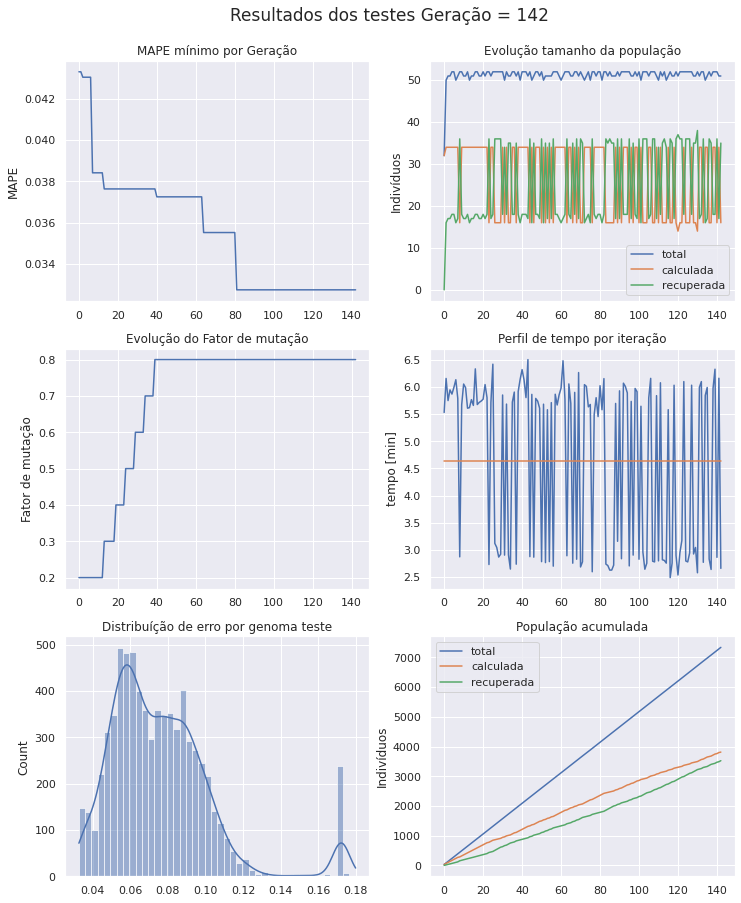

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 143 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 7 30 30 12 17 54 21 57 21 43 14 59 44]
Projenitores [ 7 55 29 54 46 39  5 25  1 24 35 29 23]
Projenitores [18 40 11 62 13 32 55 54 10  9 43 42 38]
Projenitores [ 7 30 30 21 17 46 10 34 21 43 25 59 13]
Projenitores [39  7 22 37 60 24 35 36 24 33 49 55 42]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [15 47 16 56 37 49 18 46 23 47 50 54 31]
Projenitores [ 0 15 63 41 13 60 54 24  3 57 49  9 42]
Projenitores [39 34 49 37 60 24 35 60 60 47 28 55 47]
Projenitores [33 49 22 12 23 38 45 22 44 41 60 57 29]
Projenitores [54 57 37 23 21 39 45 43 37  9 56 62 62]
Projenitores [46 16 52 22 37 60 36 21 56 49 32  3  3]
Projenitores [22 17 35 21 63 46 56 25 27 36 49 54 24]
Projenitores [44 52 50 57  4 62 22 13 62 12 35 32 39]
Projenitores [59 48 60 40  3 41 42 10  7

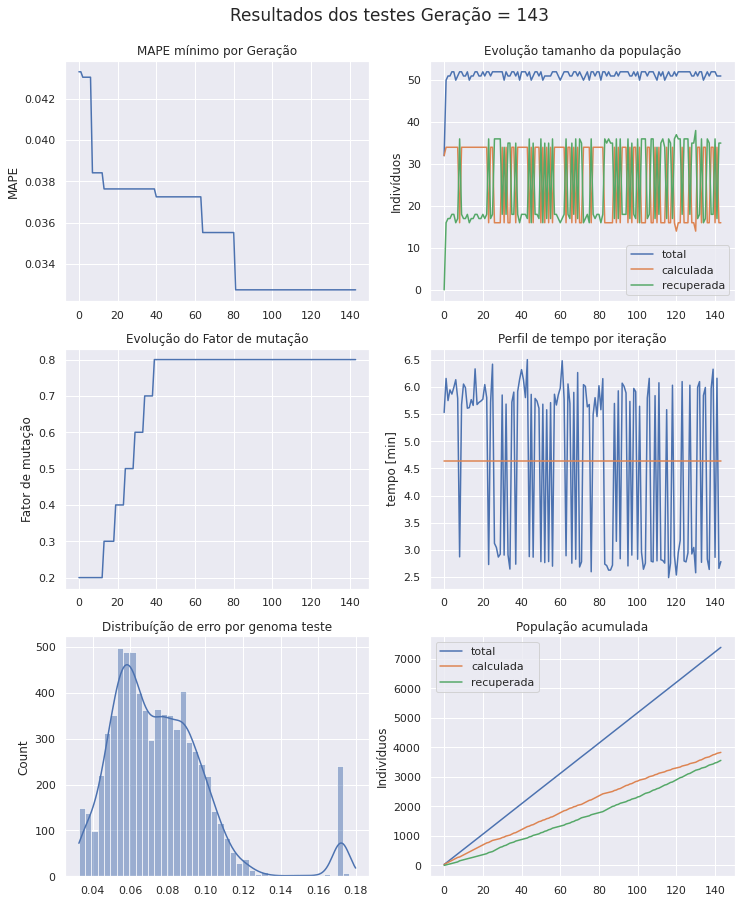

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 144 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [39 49 22 37 60 24 45 60 60 47 28 57 29]
Projenitores [44 52 50 57  4 62 22 13 62 12 35 32 39]
Projenitores [22 17 35 21 63 46 56 25 27 36 49 54 24]
Projenitores [22 17 50 57  4 62 22 13 62 36 49 32 39]
Projenitores [18 40 11 62 13 32 55 54 10  9 43 42 38]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [41 55 18 28  7 26 32 58 39  1 24  1 59]
Projenitores [28  7 53 33 14 44  9 52 42 18 33  7 48]
Projenitores [33 41 63 36 33  4 29 32 46 40  5 27  6]
Projenitores [ 0 15 63 41 13 60 54 24  3 57 49  9 42]
Projenitores [ 7 30 30 12 17 54 21 57 21 43 14 59 44]
Projenitores [ 8 50 25 29 22 13  3 12 51 40 11 46 12]
Projenitores [46 21 49 53  2 23 21 59 40 18 47 50 56]
Projenitores [28  7 53 33 14 44  9 10 42 18 33 41 48]
Projenitores [ 7 40 11 62 13 46 10 54 10

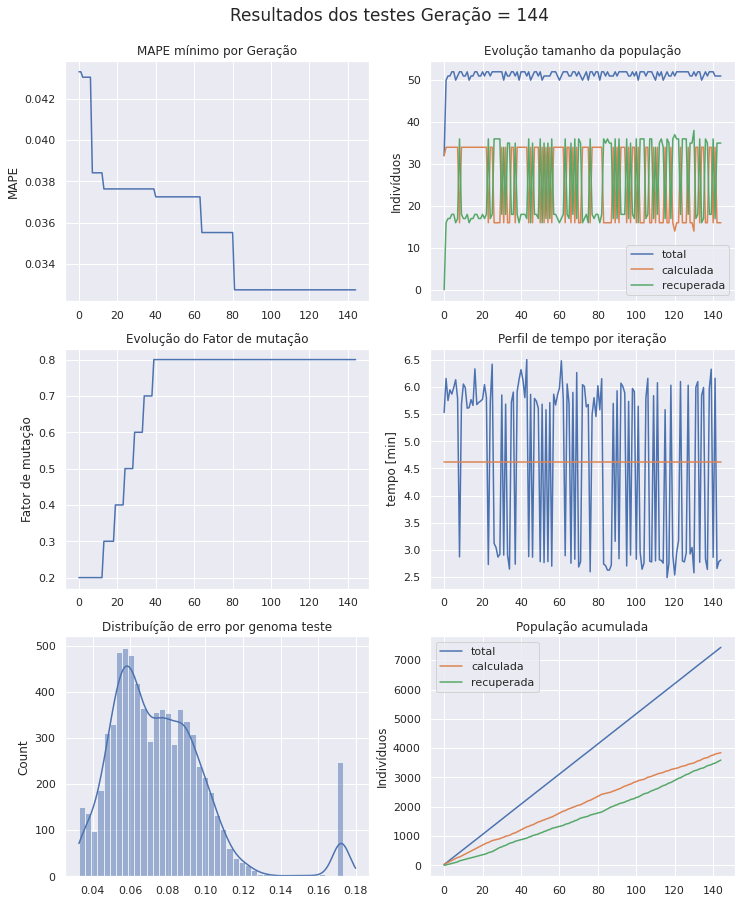

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 145 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [32 60 43 33  8 52 30 33 15 22 56 53 34]
Projenitores [18 40 11 62 13 32 61 54 10  9 22 42 38]
Projenitores [ 8 50 25 29 22 13  3 12 51 40 11 46 12]
Projenitores [43 59 18 63 28 16  5 35 13 32 53 23 31]
Projenitores [41 55 18 28  7 26 32 58 39  1 24  1 59]
Projenitores [28  7 53 33 14 44  9 52 42 18 33  7 48]
Projenitores [33 45 40 52 27 14 45 41 42 32 34 31 48]
Projenitores [28  7 53 33 14 44  9 10 42 18 33 41 48]
Projenitores [12 41 11  6 56 33 21 21 30 43 28 56 51]
Projenitores [22 17 35 57  4 62 56 13 27 36 49 32 39]
Projenitores [22 17 35 21 63 46 56 25 27 36 49 54 24]
Projenitores [50 21 31  8 43 60 20 10 26 38 27 35 17]
Projenitores [46 56 34 48 63 43  5 21 16 41 11 42 32]
Projenitores [13 24  3  7 49 42 32 33 11 27  4 38 31]
Projenitores [40 36  5 28 43 29 49 61 46

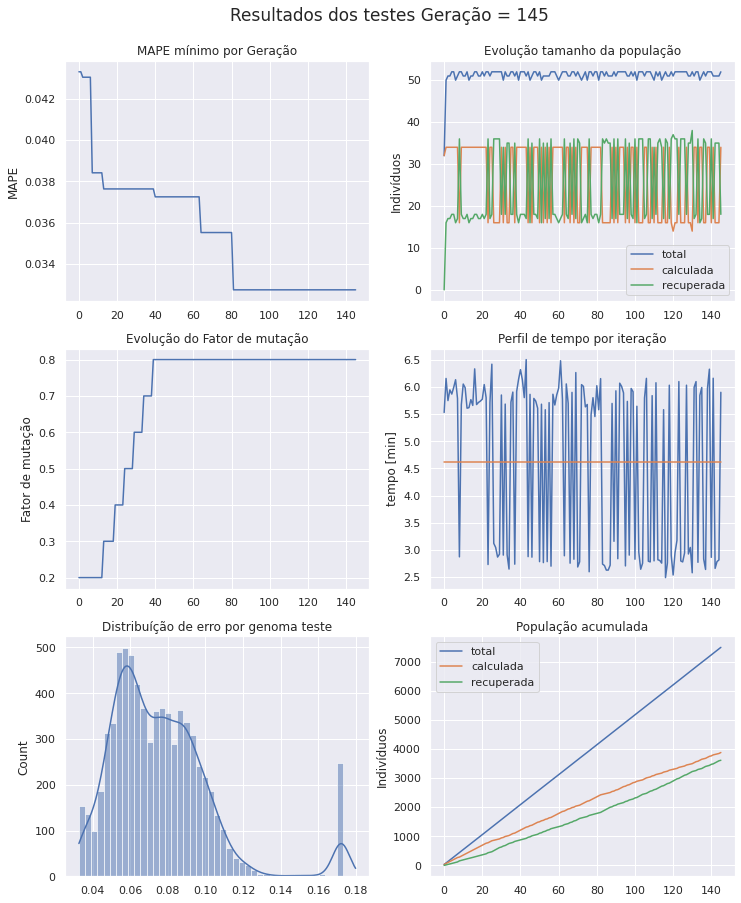

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 146 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [32 60 43 33  8 52 30 33 15 22 56 53 34]
Projenitores [59 59 57  6 21 31 13  7 56 24 15 41 18]
Projenitores [33 45 40 52 27 14 45 41 42 32 34 31 48]
Projenitores [32 40 43 33 13 32 30 54 15  9 56 53 34]
Projenitores [57 34 62 35 30 59  3 18 46 35 20 17 50]
Projenitores [28  7 53 33 14 44  9 10 42 18 33 41 48]
Projenitores [44 49 50 57 43 29 49 13 46 12 28 57 31]
Projenitores [30 24 61  2  3 30 34 43 13 48 40  8 19]
Projenitores [ 3 35 39  9  9 41 23  3 46 26 50 44  3]
Projenitores [ 8 50 18 63 22 13  3 35 13 40 53 46 12]
Projenitores [46 56  3 48 63 43  5 33 11 41 11 38 32]
Projenitores [31  9 10 27 45  7 39 61 21 33 44 34 34]
Projenitores [61 24  3 18 47  3 42 12 38 35 22 62 61]
Projenitores [12 41 35  6  4 62 56 13 27

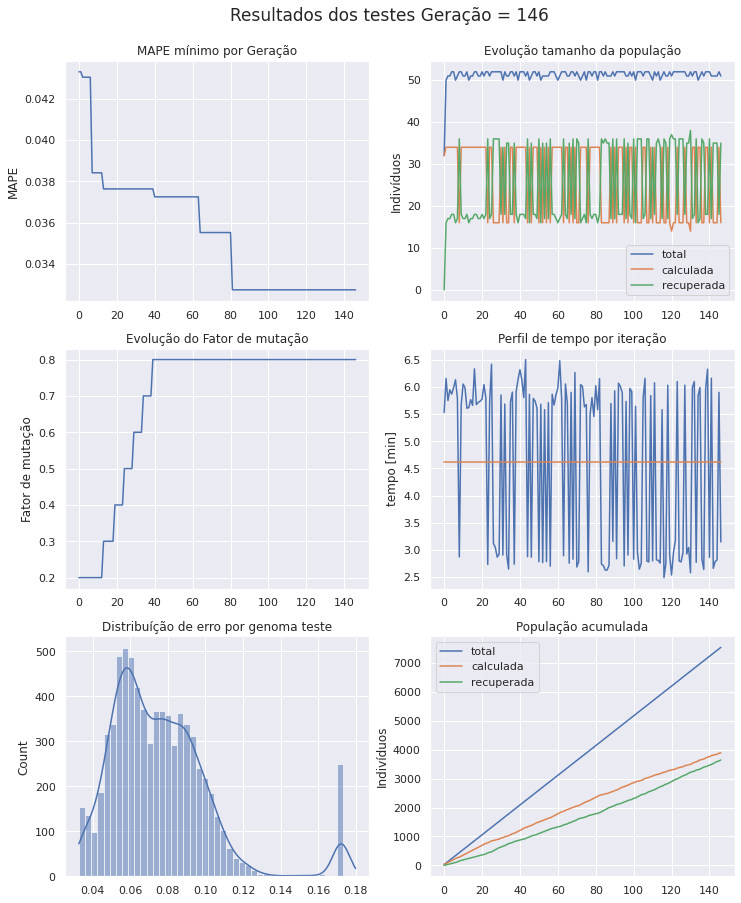

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 147 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [41 53 61 21 20 22 50 58 15 51 44 30 42]
Projenitores [57 34 62 35 30 59  3 18 46 35 20 17 50]
Projenitores [12 41 35  6  4 62 56 13 27 43 49 56 39]
Projenitores [32  0 43 33 54 53 61 33 15 54 56 53 40]
Projenitores [30 10  9 21 37 11 20  5 16 58  4 56 43]
Projenitores [33 45 40 52 27 14 45 41 42 32 34 31 48]
Projenitores [30 35 61  2  9 41 34 43 13 26 40  8 19]
Projenitores [57 40 43 33 13 32  3 18 15  9 56 17 50]
Projenitores [24 59 46 14 29 54 50 58 42 14  4 56 61]
Projenitores [32 60 43 33  8 52 30 33 15 22 56 53 34]
Projenitores [44 49 50 57 43 29 49 13 46 12 28 57 31]
Projenitores [ 8 50  3 48 63 13  5 33 13 41 53 46 12]
Projenitores [46 56 18 63 22 43  3 35 11 40 11 38 32]
Projenitores [32 40 43 33 13 32 30 54 15  9 56 53 34]
Projenitores [35 60

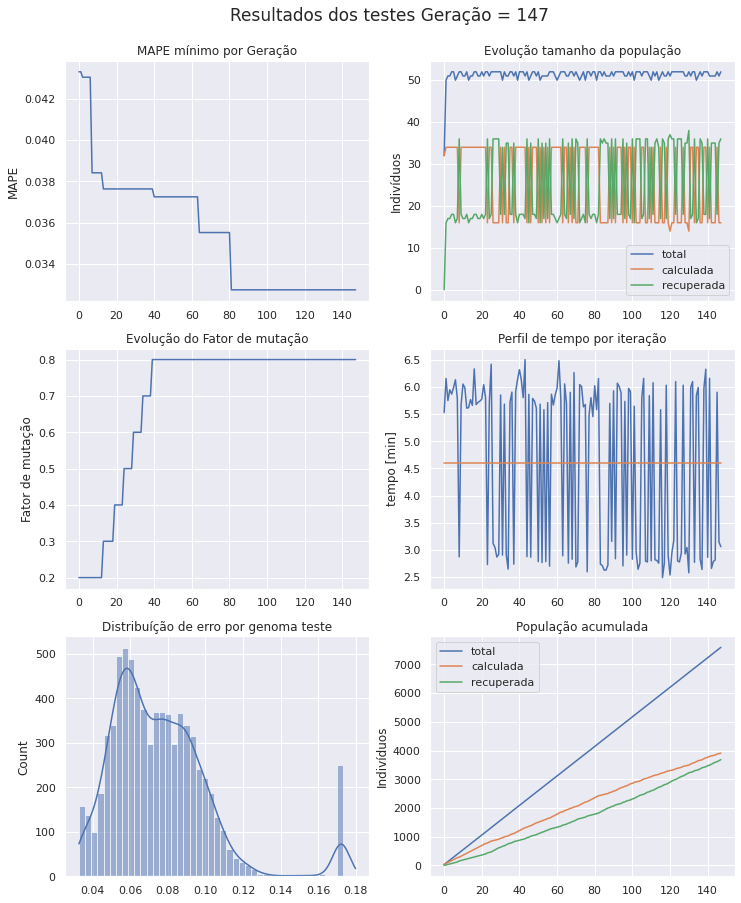

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 148 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [54 41 44 35 62 31 44 49  4 53 46  5 30]
Projenitores [47 20 48 62 42 34 40 46 32 55 30 22 58]
Projenitores [11 14 42 15 21  5 48 60 58 13 40  3 31]
Projenitores [35 60 29 35  8 31 44  8  4 22 22 37 34]
Projenitores [ 8 50  3 48 63 13  5 33 13 41 53 46 12]
Projenitores [30 35 61  2  9 41 34 43 13 26 40  8 19]
Projenitores [ 4 14 45 53  4  6 42  9 44 48 59 36 26]
Projenitores [12  0 43 33  4 53 56 13 15 43 49 53 39]
Projenitores [32 41 35  6 54 62 61 33 27 54 56 56 40]
Projenitores [57 53 62 35 20 59 50 58 46 51 44 30 50]
Projenitores [43 48 53 29 45 11 49 51 22 37 11 21 33]
Projenitores [38 20  9 40 16 11 39 58 17 39 49 63 33]
Projenitores [24 59 46 14 29 54 30 33 15 14  4 56 34]
Projenitores [40 16 62 10  4 22 19 21  9 35 56 35 48]
Projenitores [62 21 32 42 40 17 60 13  3

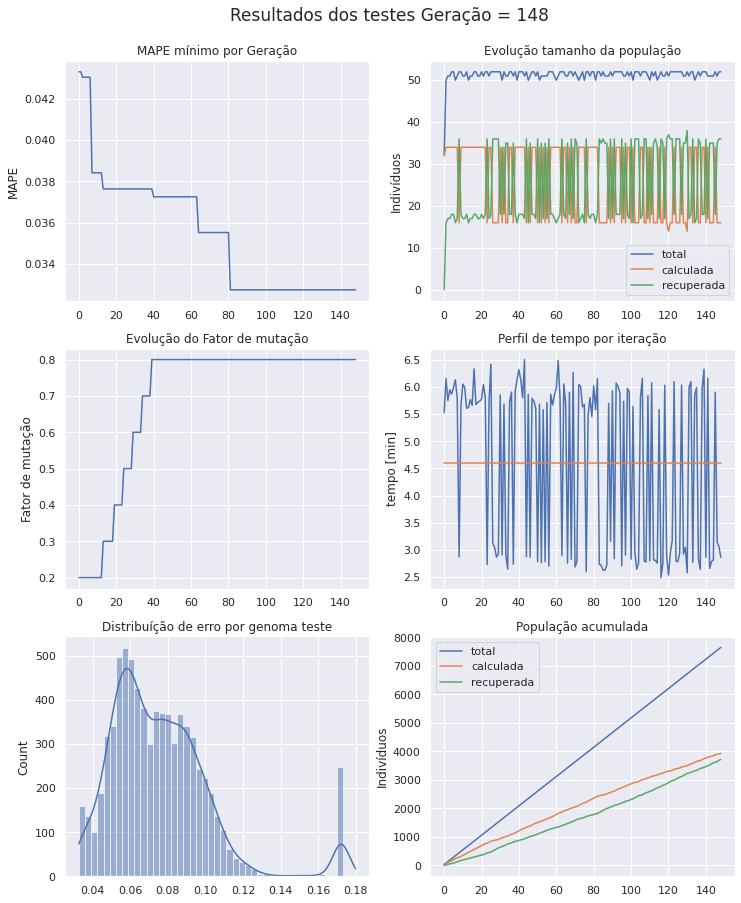

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 149 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [40 16 62 10  4 22 19 21  9 35 56 35 48]
Projenitores [24 59 62 10  4 22 19 21  9 14  4 35 48]
Projenitores [50 21 31  8 43 60 20 10 26 38 27 35 17]
Projenitores [32 53 62  6 54 62 50 33 27 54 56 30 50]
Projenitores [54  8 34 28 36 56 25 54 33  9 15 26 28]
Projenitores [35 60 29 35  8 31 44  8  4 22 22 37 34]
Projenitores [ 8 50  3 48 63 13  5 33 13 41 53 46 12]
Projenitores [47 20 48 35 42 31 40 46  4 53 46 22 30]
Projenitores [41 53 61 21 20 22 50 58 15 51 44 30 42]
Projenitores [ 0  0 29 19  4 38  0 16 24  3 49 48 45]
Projenitores [23 56 24 51 53 10 13 31 26 34 50 19 53]
Projenitores [12 14 43 33  4 53 56 13 44 43 49 36 39]
Projenitores [41 53 61 21 20 22 50 13 15 51 44 31 42]
Projenitores [43 48 53 29 45 11 49 51 22 37 11 21 33]
Projenitores [24 59 46 14 29 54 30 33 15

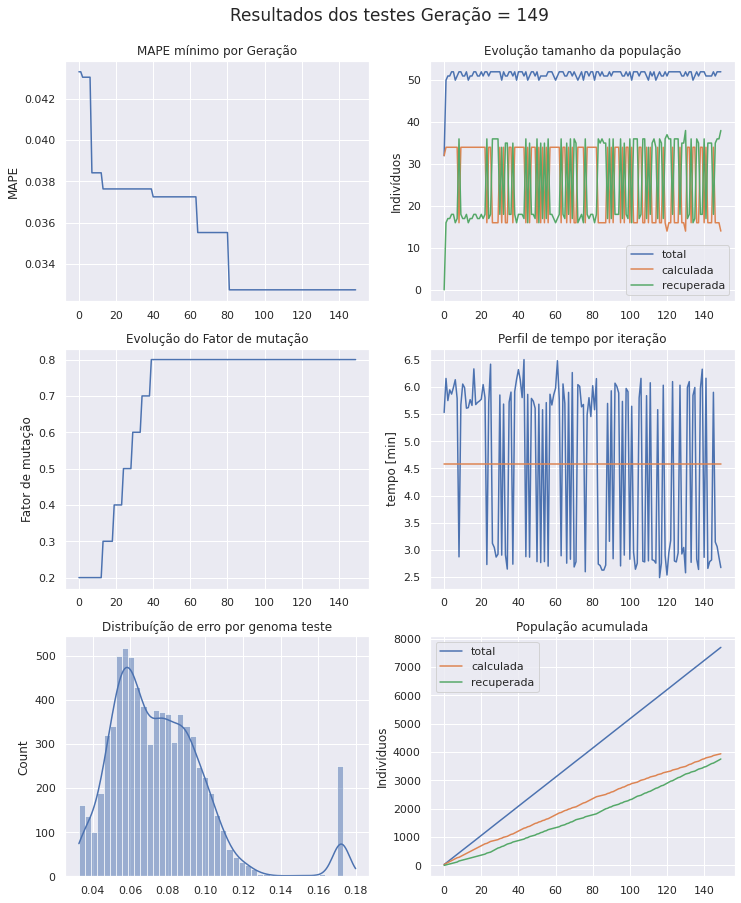

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 150 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [43 53 61 21 45 11 49 51 22 37 11 21 42]
Projenitores [22 41 56 14  4 25 15  4 33 28 20 17 26]
Projenitores [54  8 29 28  8 56 25 54  4  9 15 26 28]
Projenitores [46 29 40 51 17 36 10 55  2 50 15 62 30]
Projenitores [31 38 37 20  2 26 10 32 31 49 34 53 10]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [43  4 27 19 50 24 43 44 29  0 33 62  4]
Projenitores [12 14 43 33  4 53 56 13 44 43 49 36 39]
Projenitores [21 56 32 24 38 53  6 27  4 23  8 55 33]
Projenitores [60  3  0 53 37 62 19 35 23 11 45  5 62]
Projenitores [23 56 24 51 53 10 13 31 26 34 50 19 53]
Projenitores [23 56 24 33  4 53 13 31 44 34 49 36 53]
Projenitores [15  0 33 44 45 56 20 26 40  8 24  8 15]
Projenitores [ 0  0 29 19  4 38  0 16 24  3 49 48 45]
Projenitores [24 59 62 10  4 22 19 21  9

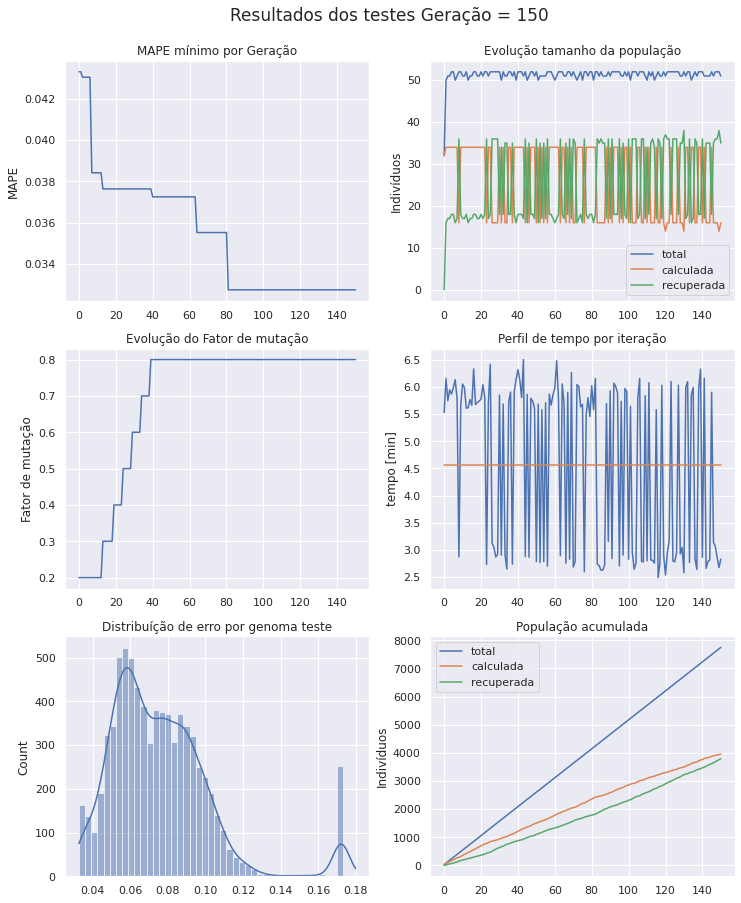

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 151 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [60  3  0 53 37 62 19 35 23 11 45  5 62]
Projenitores [ 0  0 29 19  4 38  0 16 24  3 49 48 45]
Projenitores [61 21 38 52 61 14 30 36 25 46 24 21 28]
Projenitores [24 53 61 21  4 22 19 58 15 14  4 35 42]
Projenitores [23 56 24 33  4 53 13 31 44 34 49 36 53]
Projenitores [54  8 29 28  8 56 25 54  4  9 15 26 28]
Projenitores [ 0  0 33 19  4 56  0 26 40  3 49  8 15]
Projenitores [41 53 61 21 20 22 50 58 15 51 44 30 42]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [23 56 24 51  4 10 13 31 44 34 49 36 53]
Projenitores [44 49 33 25 10 54 25 32 15 22 51 43 59]
Projenitores [ 4 43 47 60 53 56 19 21 32  0 41 59  0]
Projenitores [23 56 24 33 53 53 13 31 26 34 50 19 53]
Projenitores [43  4 27 19 50 24 43 44 29  0 33 62  4]
Projenitores [43 53 61 21 45 11 49 51 22

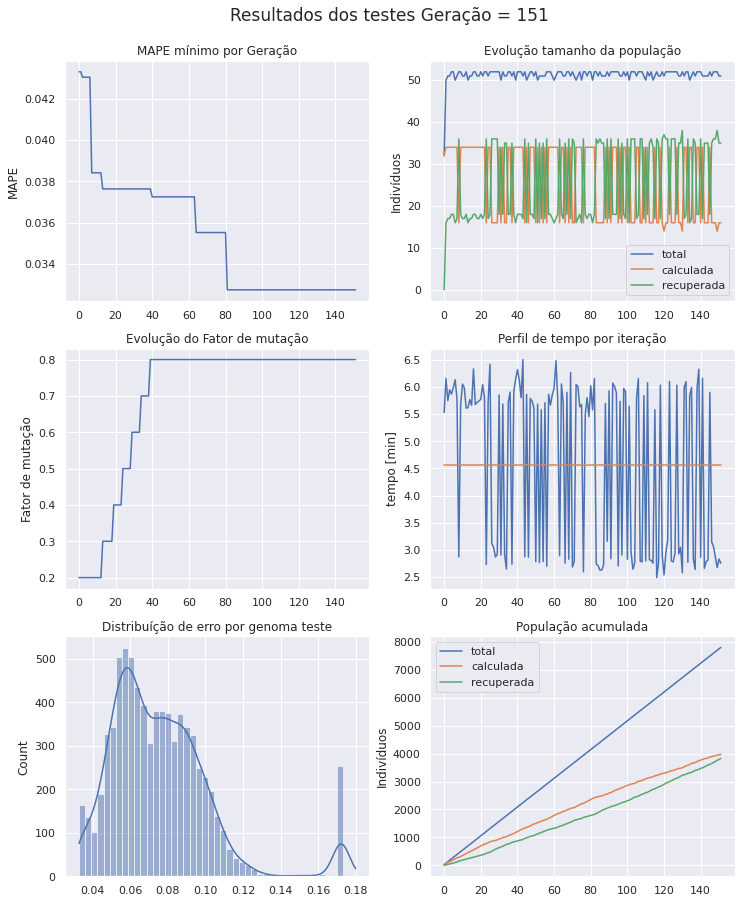

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 152 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [43 53 61 21 45 11 49 51 22 37 11 21 42]
Projenitores [39 42 24 19 14 47 19  0 42  0 33 15  8]
Projenitores [23 56 24 51  4 10 13 31 44 34 49 36 53]
Projenitores [24 53 61 52  4 22 19 36 15 46  4 21 28]
Projenitores [44 43 33 25 53 54 19 21 15 22 41 59 59]
Projenitores [52 53 61 21 63 11  1  5 42 37 10 18 42]
Projenitores [60 60 19 35 41 56 20 13 15 48 61  3  4]
Projenitores [43 56 24 19 50 24 13 44 26  0 50 62 53]
Projenitores [32  4 21  8 61 43 49 11 20 16 48 27 28]
Projenitores [12 15 52 30 30 18  4 34 25 46  6 55 26]
Projenitores [54 33 51 32  9 31 61 38 47 62 48 60 14]
Projenitores [51 25 63  4 29 43 45  7  6 49 22 19 25]
Projenitores [44 49 33 25 10 54 25 32 15 22 51 43 59]
Projenitores [12 42 48 33 45 59 23 52 42 38  7 59  1]
Projenitores [19  5

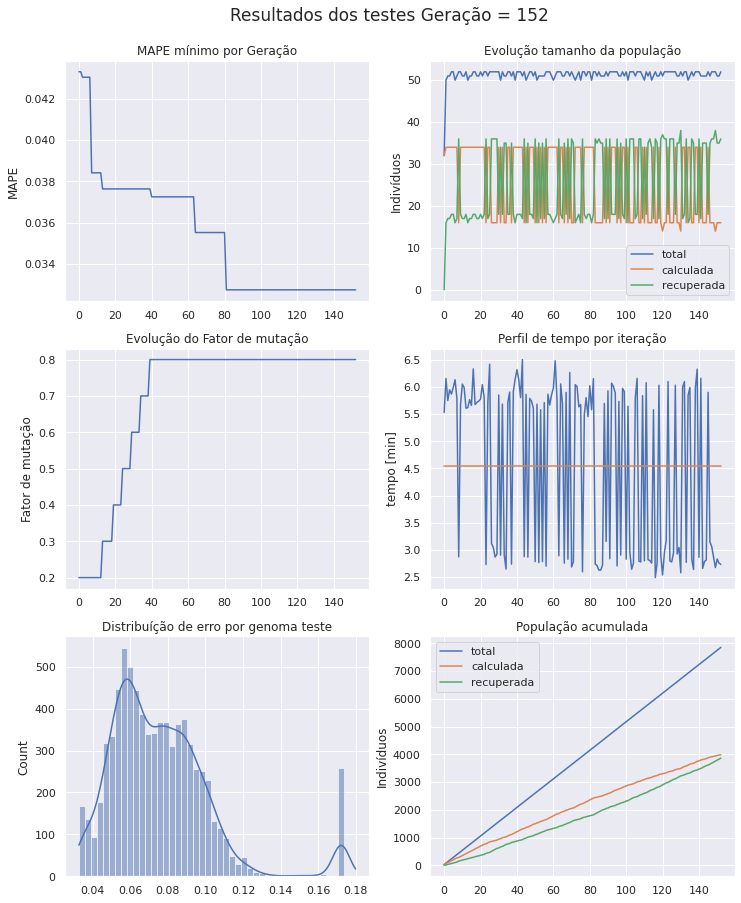

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 153 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [ 7 36 41 52 15 21 48 13 25  4 62 42 23]
Projenitores [44 43 33 25 53 54 19 21 15 22 41 59 59]
Projenitores [52 53 61 21 63 11  1  5 42 37 10 18 42]
Projenitores [12  4 52  8 61 18  4 11 25 46 48 27 26]
Projenitores [22 62 51 25 13 21 36 57 54  7 10 34 56]
Projenitores [44 42 48 33 10 54 23 52 15 22 51 43  1]
Projenitores [19  0 28 19 10 38  2 16  6 45 49 48 54]
Projenitores [51 25 63  4 29 43 45  7  6 49 22 19 25]
Projenitores [ 0  5 29 25  4 58  0 39 24  3  5 51 45]
Projenitores [10  4 56  0 37 39 55 57 53 13 39 22 45]
Projenitores [19  5 28 25 10 58  2 39  6 45  5 51 54]
Projenitores [39 30 60 43 62 44 33  2 14 14 20 28 28]
Projenitores [ 4 48 53 62 47 25 22 17 43 42 32  2  4]
Projenitores [ 7 56 59  1 20 42 20 54 25

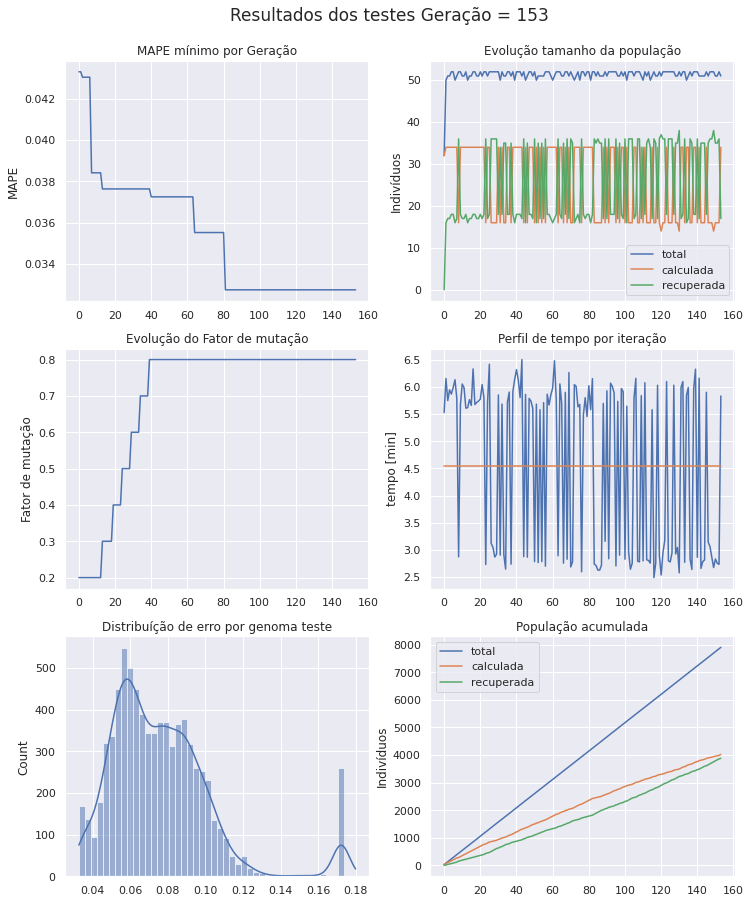

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 154 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [51  5 29  4 29 43 45 39 24  3  5 51 25]
Projenitores [ 4 30 60 62 62 25 33 17 14 42 32  2 28]
Projenitores [53  7 44  3 60 55 49 60 39 12 21 29 26]
Projenitores [10  4 28  0 37 39  2 39  6 45  5 51 45]
Projenitores [12  4 51 25 13 21  4 57 25  7 48 34 26]
Projenitores [19  0 28 19 10 38  2 16  6 45 49 48 54]
Projenitores [43 33 54 57 17 13 27  5  8 63 58 29 29]
Projenitores [12  4 52  8 61 18  4 11 25 46 48 27 26]
Projenitores [22 62 52  8 61 18 36 11 54 46 10 27 56]
Projenitores [20 44 18 55  0  5 30 27 49 57 31 36 41]
Projenitores [62 12 43 19 28 24  0 56 53 52 28 62 17]
Projenitores [10 40 48  4 42  6 18 36 60  9  1 62 32]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [19  5 56 25 10 58 55 57 53 13 39 22 54]
Projenitores [44  0 28 19 10 38 23 52 15

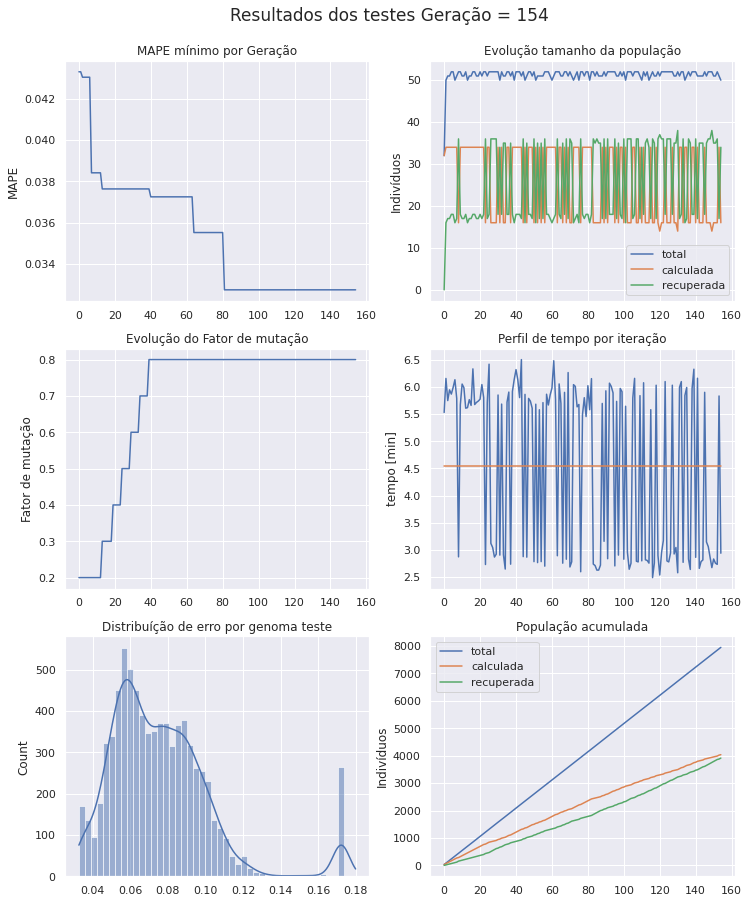

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 155 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [22 44 52  8  0 18 30 27 49 57 10 36 41]
Projenitores [54 45 56 25  8 39 63 57 49 13 39 41 54]
Projenitores [44 57 23 14 28 11 27 35 34 30 32 34 39]
Projenitores [10 40 48  4 28 24 18 56 60 52  1 62 32]
Projenitores [19  4 51 25 10 38  2 57  6 45 48 34 26]
Projenitores [43 33 54 57 17 13 27  5  8 63 58 29 29]
Projenitores [ 1 49 16  6 39 57 35 46 37 63  5 43 39]
Projenitores [12  4 51 25 13 21  4 57 25  7 48 34 26]
Projenitores [12  0 28 19 13 21  4 16 25  7 49 48 54]
Projenitores [47 52 53 10  2 33 34 35 47 41 50 63 47]
Projenitores [29 18 11 36 44 40 27 21 54 32 18 63 10]
Projenitores [61 22 42  7 47 39 25 56 21 40 34 21 59]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [62 12 43 19 42  6  0 36 53  9 28 62 17]
Projenitores [12  4 52 57 17 18 27 11  8

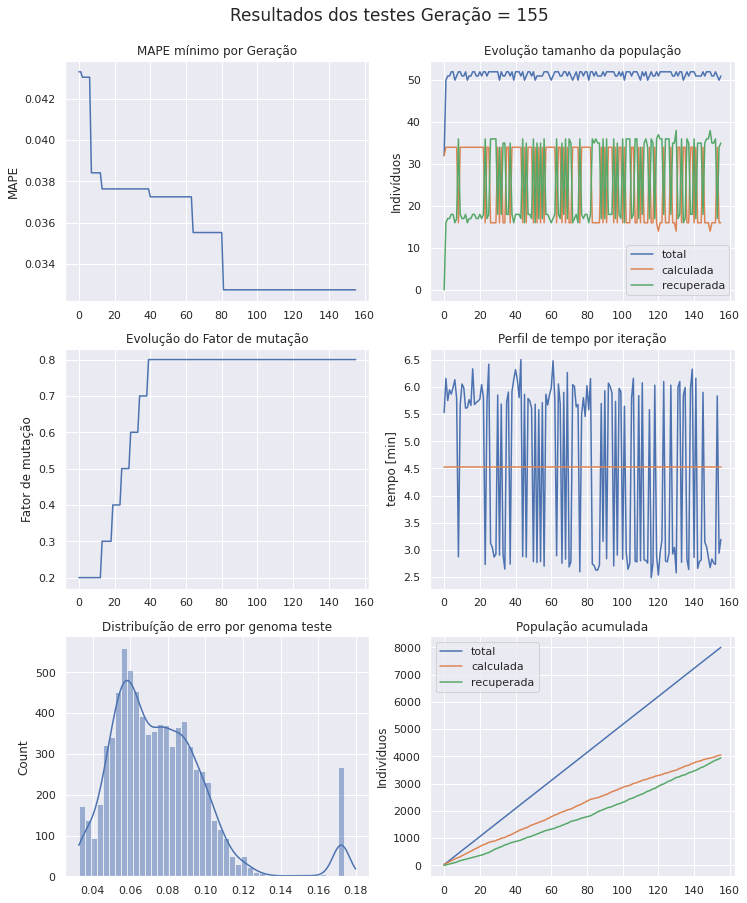

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 156 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [31 32 21 16 61 22 55 28 38 13 33 58 33]
Projenitores [22 45 56 25  8 39 63 57 49 13 39 36 54]
Projenitores [61 22 42  7 47 39 25 56 21 40 34 21 59]
Projenitores [43 33 54 57 17 13 27  5  8 63 58 29 29]
Projenitores [51 42 61 17  6 39 50 45 59  3 48  4 45]
Projenitores [20 52 33 15  9 50 44 33 28 25 34 25 20]
Projenitores [62 12 29 21 42  6  0  8 53 54 22 62 40]
Projenitores [47 52 53 10  2 33 34 35 47 41 50 63 47]
Projenitores [12  4 51 25 13 21  4 57 25  7 48 34 26]
Projenitores [62 12 43 19 42  6  0 36 53  9 28 62 17]
Projenitores [19 33 54 57 10 38  2  5  6 45 58 29 29]
Projenitores [31 32 52 16 61 22 55 11  8 13 33 29 33]
Projenitores [29 18 11 36 44 40 27 21 54 32 18 63 10]
Projenitores [47  0 53 10 13 33  4 16 25  7 50 48 54]
Projenitores [54 44 52  8  0 18 30 27 49

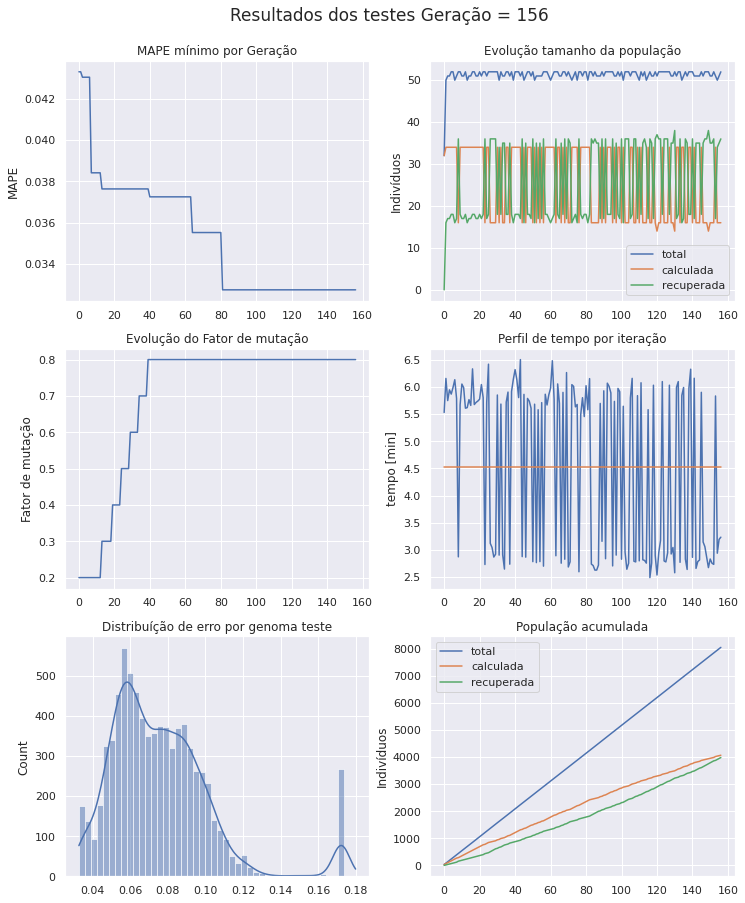

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 157 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [28  7 53 33 14 44  9 52 42 18 33  7 48]
Projenitores [31 32 21 16 61 22 55 28 38 13 33 58 33]
Projenitores [15 47 16 56 37 49 18 46 23 47 50 54 31]
Projenitores [62 12 29 21 42  6  0  8 53 54 22 62 40]
Projenitores [31 32 21 16 61 22 63 57 38 13 33 58 33]
Projenitores [59 48 60 40  3 41 42 10  7 59 38 41 30]
Projenitores [12  4 51 25 13 21  4 57 25  7 48 34 26]
Projenitores [20 52 33 15  9 50 44 33 28 25 34 25 20]
Projenitores [15 56 35 56  7 59 25 61 25 58 19  8 46]
Projenitores [61 22 54 57 17 39 25  5 21 40 58 21 29]
Projenitores [19 33 52 57 10 38  2  5  6 13 58 29 29]
Projenitores [51 52 33 15  6 39 50 45 28  3 48  4 20]
Projenitores [ 8  2 57 46 15 54 31 55 22 41 56 35  5]
Projenitores [47  0 53 10 13 33  4 16 25  7 50 48 54]
Projenitores [54 45

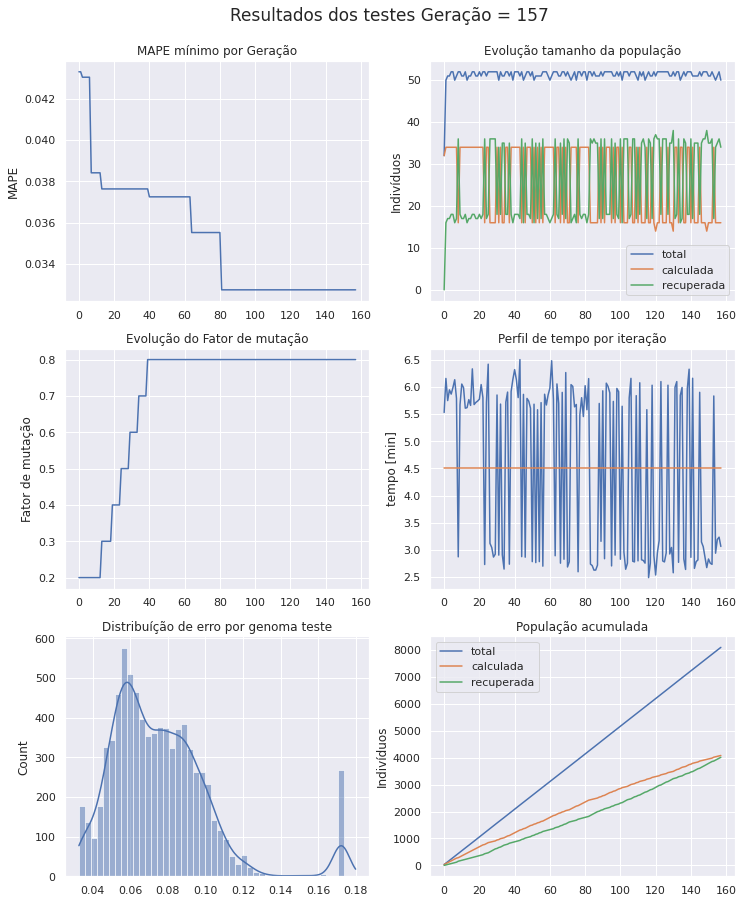

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 158 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [47  0 57 10 15 33 31 55 25  7 56 48  5]
Projenitores [14 41 24 15 21  0 56 56 57 34 54  6 13]
Projenitores [35  0 29 21 54 39 61 41 50 54 46 37 40]
Projenitores [16  6 38 46  2 29  5 32  0  5 60 61 37]
Projenitores [20  4 51 15  9 21 44 57 25 25 34 34 20]
Projenitores [38 54 16 10 63 11 42 54 43 63 57 36 10]
Projenitores [12 52 33 25 13 50  4 33 28  7 48 25 26]
Projenitores [ 8  2 57 46 15 54 31 55 22 41 56 35  5]
Projenitores [61 22 54 57 17 39 25  5 21 40 58 21 29]
Projenitores [19 52 52 57  6 38 50 45  6 13 58  4 29]
Projenitores [62 12 29 21 42  6 18  8 23 54 22 62 31]
Projenitores [31 32 21 40 61 41 42 10 38 59 33 41 30]
Projenitores [ 8 39 47 53 19  8 54 14 62 54 40 13 50]
Projenitores [52 34 59 34  7 33 32  3  3 14 48 16 12]
Projenitores [51 33 33 15 10 39  2  5 28

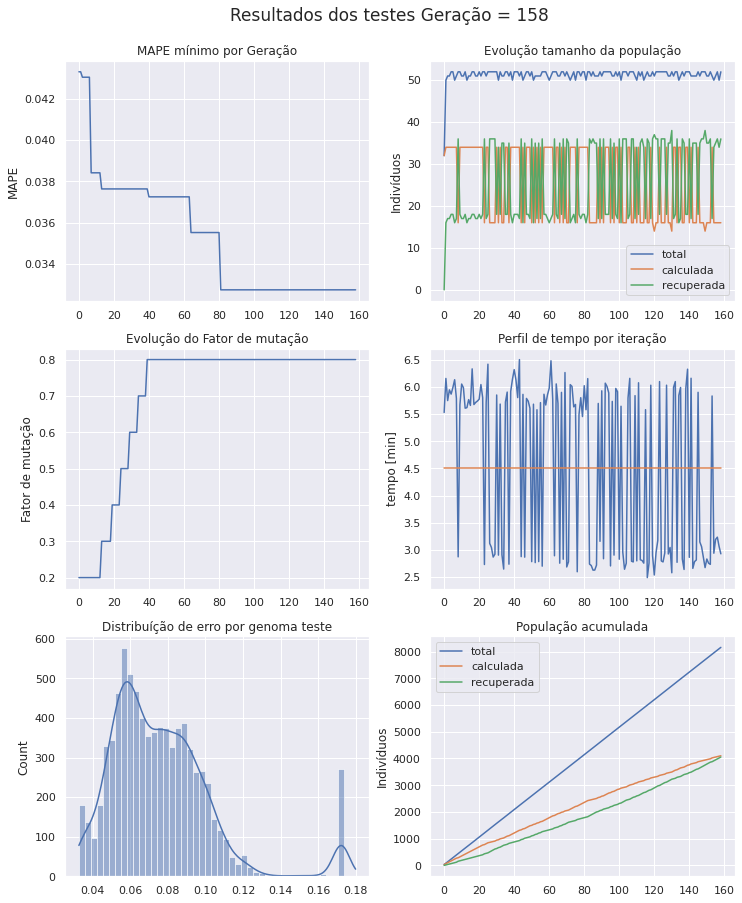

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 159 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [47  0 57 10 15 33 31 55 25  7 56 48  5]
Projenitores [ 8 11 63 15 22 63 61 35  6 48 28 25 58]
Projenitores [12 52 33 25 13 50  4 33 28  7 48 25 26]
Projenitores [14 41 57 15 21  0 31 56 25 34 56  6  5]
Projenitores [25 29 43 47 26 21 40 62 55 43 13  3 59]
Projenitores [ 8  2 57 46 15 54 31 55 22 41 56 35  5]
Projenitores [49 33 34 28 39 24  2  5 28  3 48 35 61]
Projenitores [50  0  8 10 29 50 48  7 47 33 22 57 21]
Projenitores [41 30 11 62 24 22 55 52 22 40 33 49 50]
Projenitores [20 54 16 10 63 11 44 57 25 63 34 34 10]
Projenitores [ 8 34 47 53 19  8 54  3 62 14 40 13 50]
Projenitores [54 62 40 15  0 63 19  7 45 34 16 42  4]
Projenitores [40 23 40 12 40 63  6 27 29 33 19 60 47]
Projenitores [19 22 54 57 17 39 25  5 21

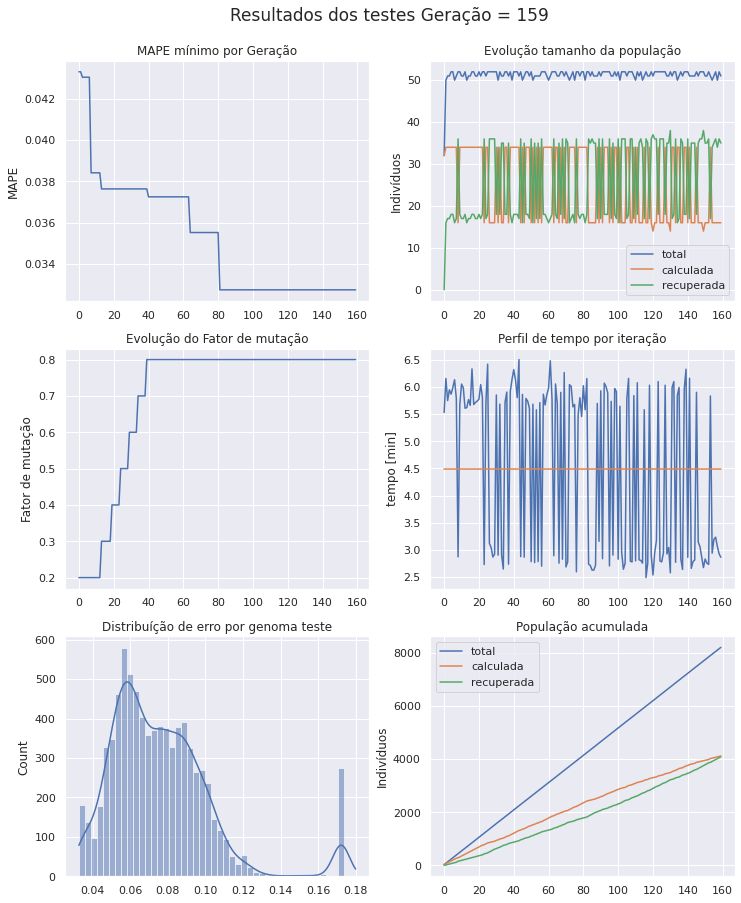

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 160 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [25 29 43 47 26 21 40 62 55 43 13  3 59]
Projenitores [47  0 57 10 54 53 61 55 25 54 56 48 40]
Projenitores [61 22 54 57 17 39 25  5 21 13 58 21 29]
Projenitores [61 22 54 57 17 39 25  5 21 40 58 21 29]
Projenitores [ 1 27 51 54 13 38 51 28  9 24  6 45 21]
Projenitores [35  0 29 21 15 33 31  8 50  7 22 37  5]
Projenitores [ 8  2 57 46 15 54 31 55 22 41 56 35  5]
Projenitores [24 59 46 14 29 54 50 58 42 14  4 56 61]
Projenitores [40 62 40 15 40 63 19  7 45 34 19 60  4]
Projenitores [20  5  0 61 51 61 18 40  3 37 62 26 20]
Projenitores [54 41 44 35 62 31 44 49  4 53 46  5 30]
Projenitores [41  0 11 62 29 50 55 52 22 33 33 49 50]
Projenitores [40 23 40 12 40 63  6 27 29 33 19 60 47]
Projenitores [14 41 57 15 21  0 31 56 25 34 56  6  5]
Projenitores [44 36 57 62 49 30 30 20 62

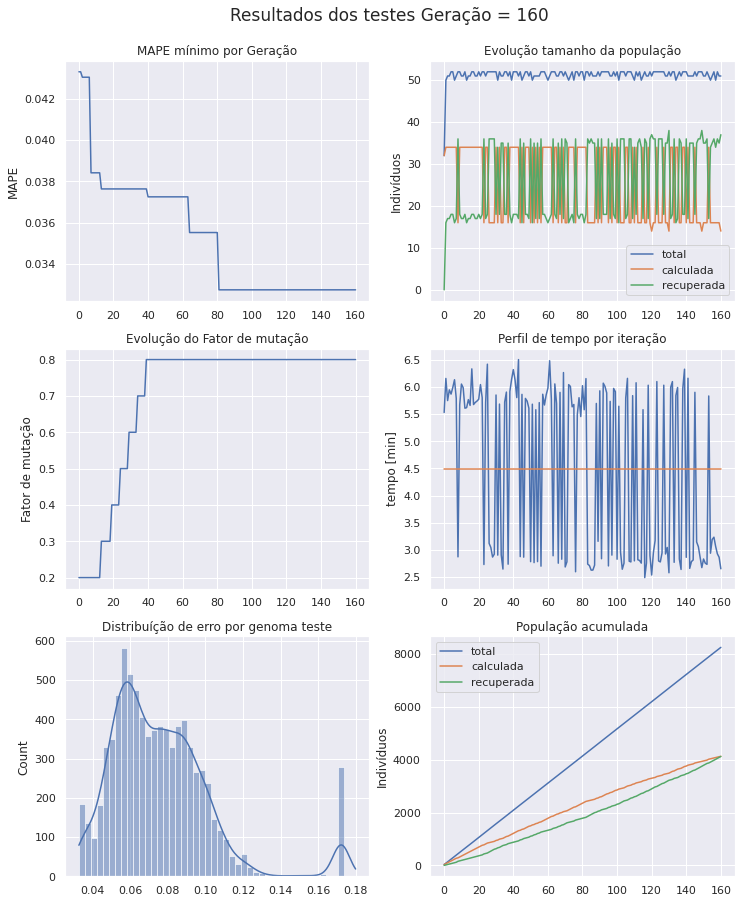

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 161 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 7 50 25 42 22 47 30 14 45 33 35 23 25]
Projenitores [35  0 29 62 54 53 30 20 50 42  2 30 40]
Projenitores [44 36 57 62 49 30 30 20 62 42  2 30  3]
Projenitores [42 28 35  1 37 56 16  2 31 10 19  0 39]
Projenitores [41  0 11 62 29 50 55 52 22 33 33 49 50]
Projenitores [22 14 19 22  3 54 26 17 30 36 15 22 50]
Projenitores [32 40 58 35 15 26 34 51 32 20 44 13 31]
Projenitores [ 1 27 29 21 13 38 51 28  9  7 22 37 21]
Projenitores [25 29 43 47 26 21 40 62 55 43 13  3 59]
Projenitores [61 22 54 57 17 39 25  5 21 40 58 21 29]
Projenitores [ 8  2 57 46 15 54 31 55 22 41 56 35  5]
Projenitores [52 57 47 34 50 63 53 22 43 40 24 23 19]
Projenitores [ 1 27 51 54 13 38 51 28  9 24  6 45 21]
Projenitores [20  5 40 15 51 63 18 40  3 37 19 26  4]
Projenitores [43  0 42 45 37  9 59 47 29

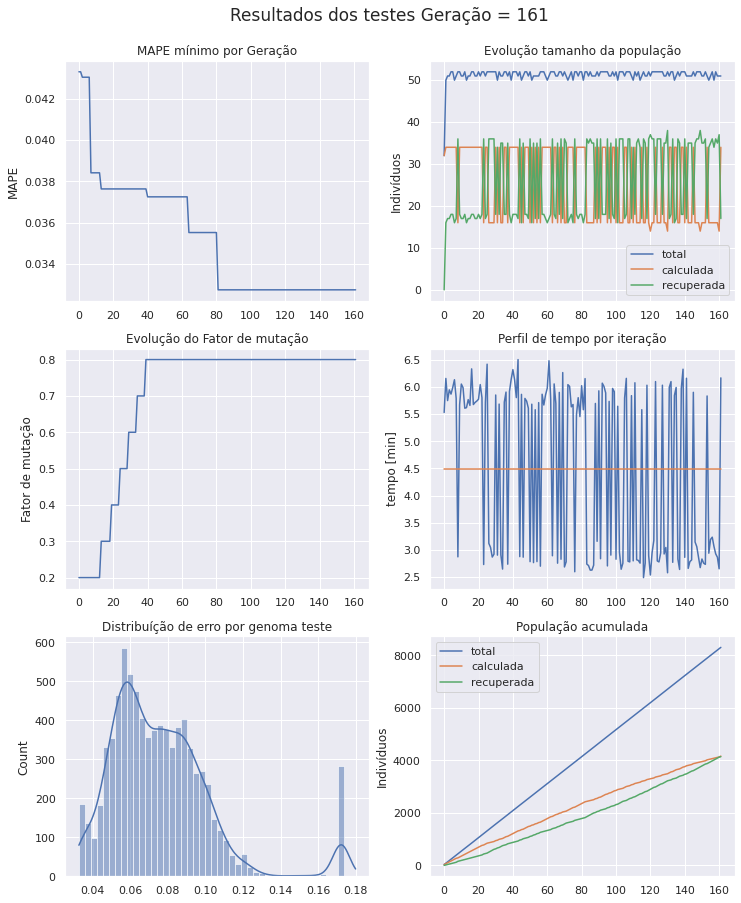

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 162 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 1 27 51 54 13 38 51 28  9 24  6 45 21]
Projenitores [52  2 57 34 50 63 53 22 43 40 24 35  5]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [52 53 14 17 21 16 14 55 62 52 22 44 51]
Projenitores [41  0 11 62 29 50 55 52 22 33 33 49 50]
Projenitores [35  0 29 21 54 53 59  8 50 50 22 15 40]
Projenitores [ 1 43 60  5 56 59 45 39 56 23 58 63 28]
Projenitores [43  0 42 45 37  9 61 47 29 54 25 37 59]
Projenitores [24 35  0 60 22 49 44 31 63 13 31 62 43]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [31  0 55  9 39 57 21 15 18 42  0 24  8]
Projenitores [ 1  5 40 15 13 38 18 28  3 37 19 26 21]
Projenitores [26 45 34 42 36 21 39 44 13 50 11 61 61]
Projenitores [22 14 19 22  3 54 26 17 30 36 15 22 50]
Projenitores [ 1 40

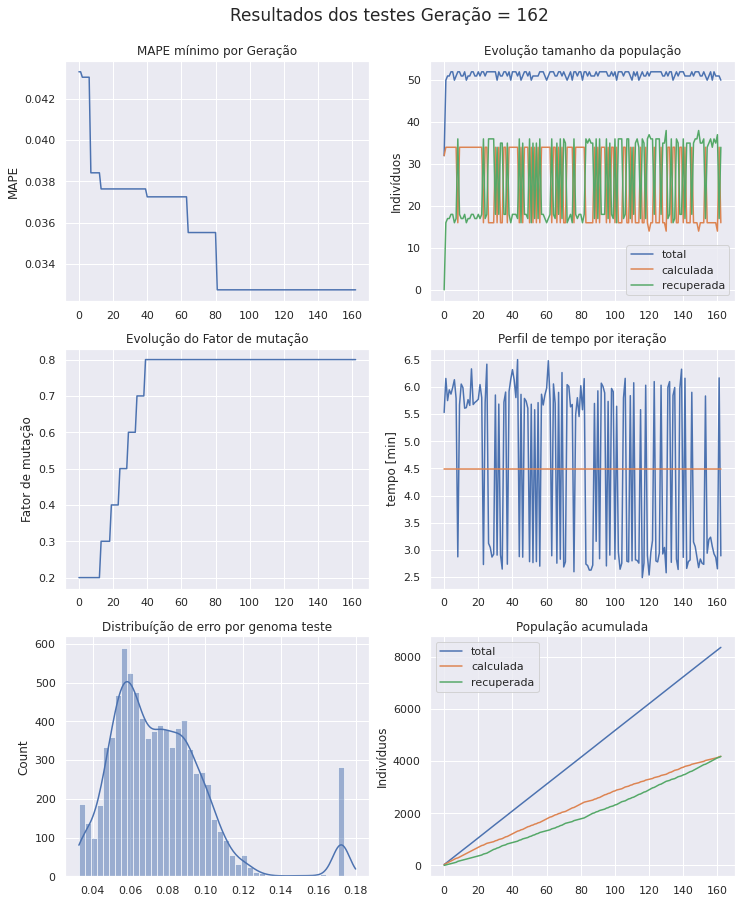

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 163 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [35  0 29 21 29 53 59  8 50 50 22 49 40]
Projenitores [24  0  0 60 22 53 61 31 50 13 31 62 43]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [22 45 34 22 36 54 26 17 13 36 11 22 50]
Projenitores [42  3  6 56 15 31 22  0 56 50 58 11 30]
Projenitores [ 1  5 40 15 13 38 18 28  3 37 19 26 21]
Projenitores [ 1 40 29 21 15 26 34 28 32 20 22 13 21]
Projenitores [ 2 40 22 38  0 59 14 52 30 26 45  4 61]
Projenitores [41  0 11 62 54 50 55 52 22 33 33 15 50]
Projenitores [28 33 23 41 39 22 58 53 41 56 20 28 19]
Projenitores [ 1 14 49 47 33 45 15 16 58 20 35 44 46]
Projenitores [ 1 27 51 54 50 38 53 22  9 24 24 45 21]
Projenitores [35  0 29 21 54 53 59  8 50 50 22 15 40]
Projenitores [23 40 29 21 15 26 34 28 32 40 22 13 21]
Projenitores [33 49 61 14 26 22 46 37 53

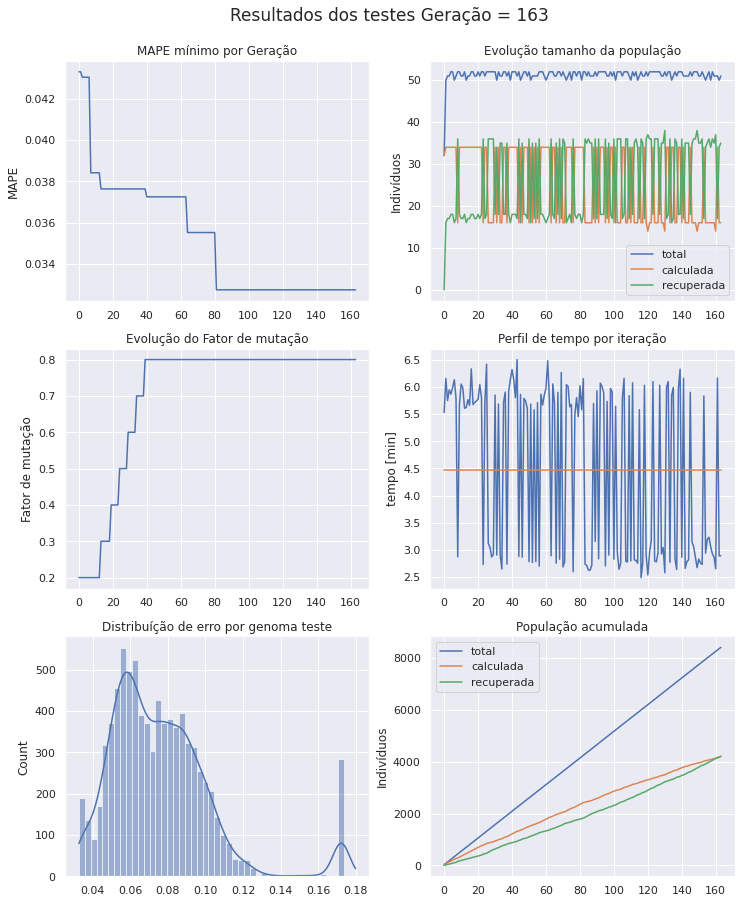

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 164 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [52  2 57 34 50 63 53 22 43 40 24 35  5]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [52 49 57 34 50 63 53 37 43  6 24 35 30]
Projenitores [28  0 23 41 39 50 58 53 41 33 20 15 50]
Projenitores [28 33 23 41 39 22 58 53 41 56 20 28 19]
Projenitores [22 45 29 29  8 39 26 41 49 44 11 22 50]
Projenitores [59 31 50 13 37  3 47 33 36 61 30  6 34]
Projenitores [46 35 35 53 45 62 49 23 21 36 21 30  1]
Projenitores [50 46 17  8 17 43 15 16  9 13  9  0  9]
Projenitores [ 1  3  6 15 15 31 18  0  3 50 19 11 30]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [26  6 53 46 12 44 58 25 26 28 33 61 54]
Projenitores [25  7  1 42 31 20 26 25 21 49 47 22 18]
Projenitores [24 44 27 52 21 53 59 53 41 51 23 21 26]
Projenitores [54 45 34 22 36 54 63 17 13

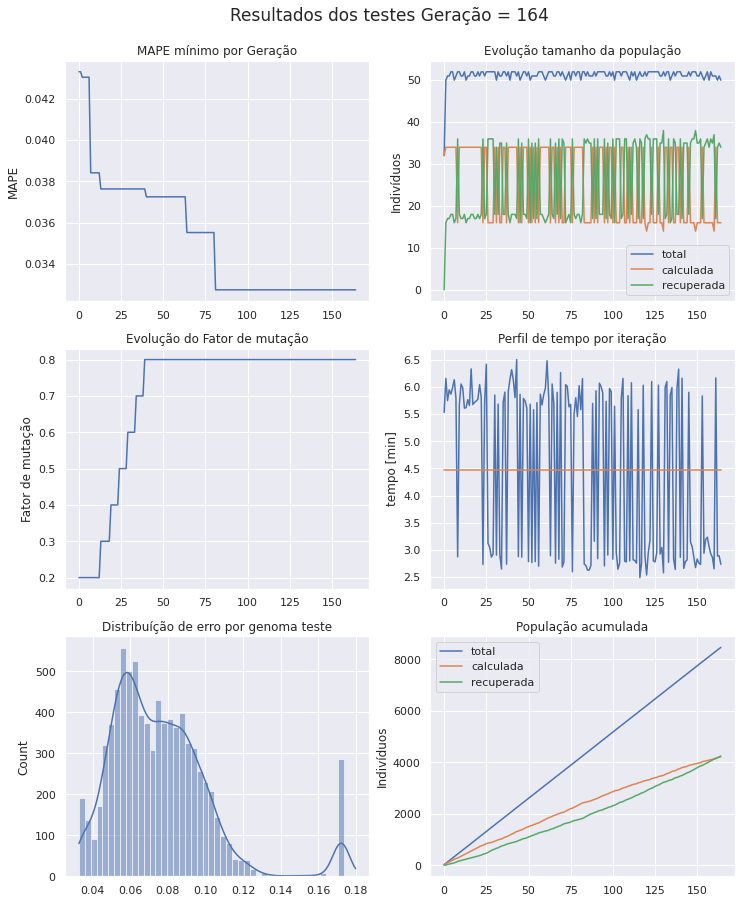

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 165 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [24 44 27 52 21 53 59 53 41 51 23 21 26]
Projenitores [59 31 50 13 37  3 47 33 36 61 30  6 34]
Projenitores [23 21  2 59  9 50 51 18  5 46 55 40  8]
Projenitores [18 37 58 49 26 62 59 50 33 52 50 46  3]
Projenitores [ 2 49 26 60 17  4 26 34 11 18 27 34 59]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [25  7  1 42 31 20 26 25 21 49 47 22 18]
Projenitores [ 1 35  7 48 53 43 15 28  0 54 21 31 58]
Projenitores [22 45 29 41  8 39 58 53 49 56 20 28 19]
Projenitores [50 46 17  8 17 43 15 16  9 13  9  0  9]
Projenitores [52 49 57 34 50 63 53 37 43  6 24 35 30]
Projenitores [25 22 51 59 46 54 49 57 17 39 52 16 42]
Projenitores [25 17 26 44 36 41 14 21 49 12 57 51 48]
Projenitores [52  2 29 34 54 63 61  8 50 40 24 37 40]
Projenitores [60 45 35 26 50 59 53 23 29

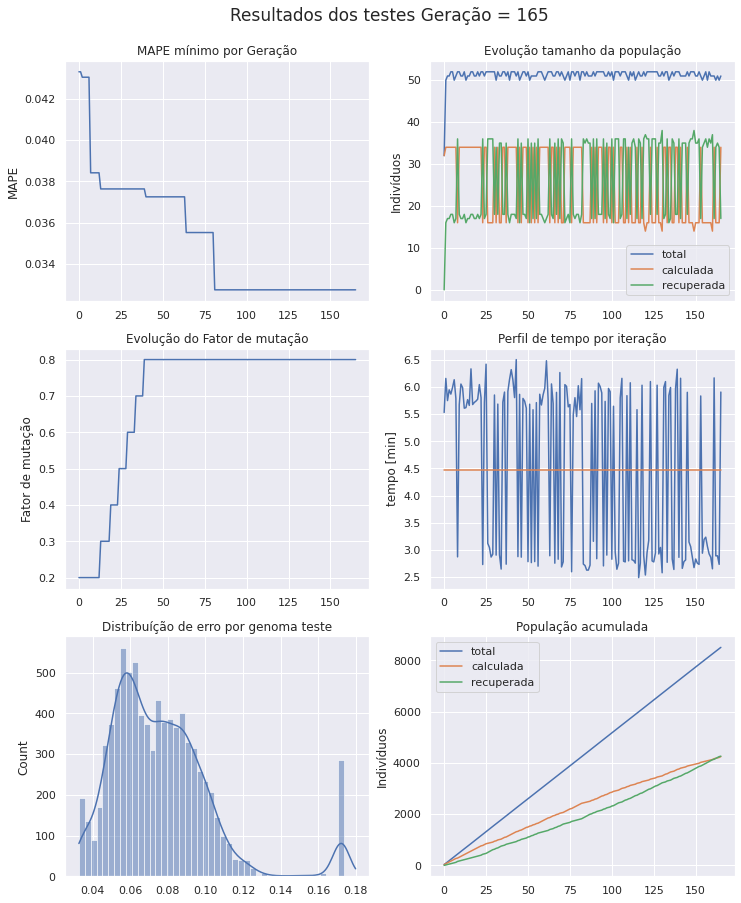

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 166 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [51 59 59 52 15 32 49  2  6 33 45 11 52]
Projenitores [52  2 29 34 54 63 61  8 50 40 24 37 40]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [36 59 41 62 48 53 56 38 19 30  7 45 41]
Projenitores [22 45 17 41  8 43 15 16  9 13  9 28  9]
Projenitores [25  7  7 48 53 43 15 25 21 49 47 31 58]
Projenitores [10 20 40 31 57  0 61 40 52 60 30 36 22]
Projenitores [ 2  0 29 21 54 53 26  8 50 18 22 34 40]
Projenitores [53 51 46 16 51  2  1 40 61 39 57 18 47]
Projenitores [12  3 13 54 37 10 47 52  4 38  5 40  9]
Projenitores [61  2 47 14 29 11 61 55 14 58 25  6 13]
Projenitores [27 10 19  7 53  1 58 51 23 49 57 11  3]
Projenitores [52 22 57 34 46 54 53 57 17 39 24 35 42]
Projenitores [25 24  0 40 27  5 47 30 32 46 22 33 34]
Projenitores [21 11 42 24 49 53 41 20  2

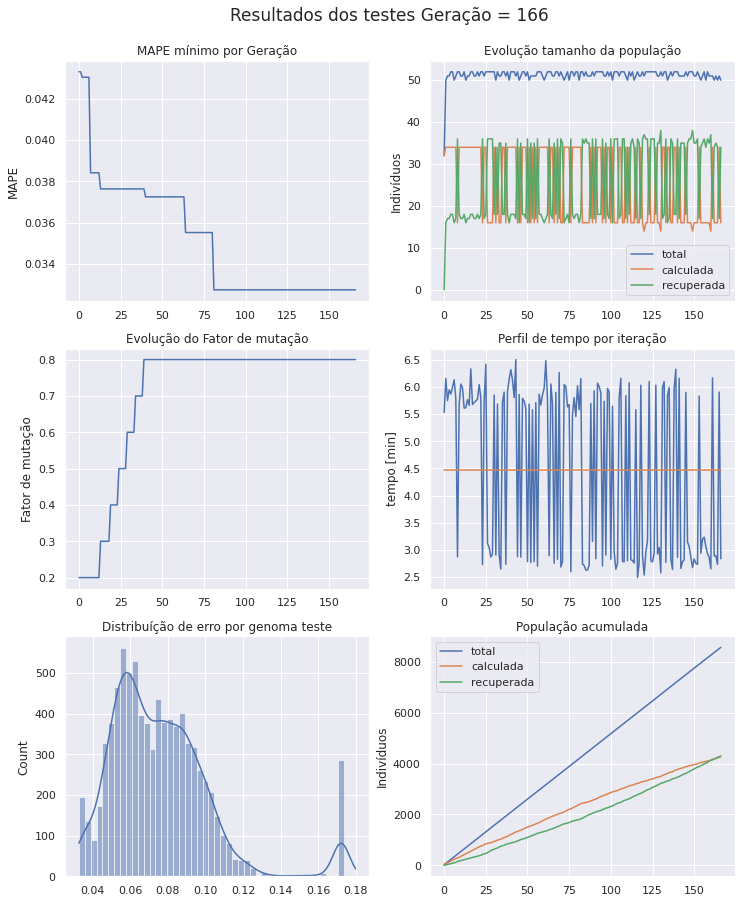

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 167 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 2 20 40 21 54  0 61 40 52 18 22 34 40]
Projenitores [33 30  4 22 56 27 38 55 61 16 32 31  2]
Projenitores [57 22 60 49 42 42 51 63 18  8  5 38 20]
Projenitores [45 24 20 40 58 57 17 49 63 29 30 19 31]
Projenitores [36 59 41 62 48 53 56 38 19 30  7 45 41]
Projenitores [62 52 44 31 24  5 31 30 48 52 51 35 58]
Projenitores [25 22 57 34 27  5 53 57 17 46 24 33 34]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [21 11 42 24 49 53 41 20  2 14 59  9 61]
Projenitores [27 10 47  7 29 11 58 55 14 58 57  6 13]
Projenitores [37 28  4 41  6 48 59 23 41 50 56 24 40]
Projenitores [27 10 19  7 53  1 58 51 23 49 57 11  3]
Projenitores [12  3 13 54 37 10 47 52  4 38  5 40  9]
Projenitores [52  2 29 34 54 63 61  8 50 40 24 37 40]
Projenitores [48  9

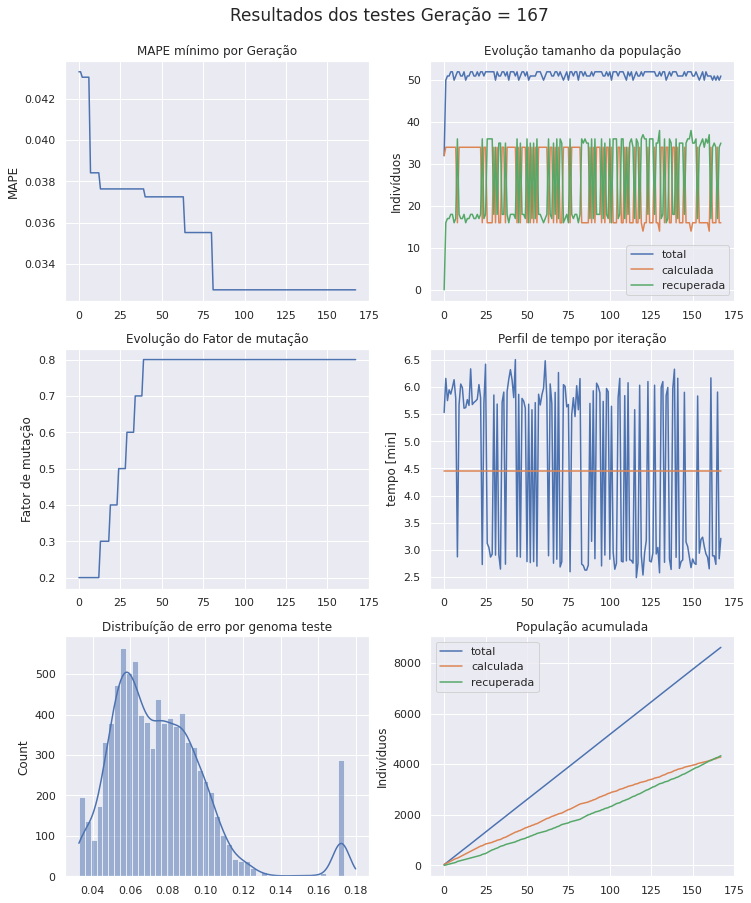

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 168 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [28 47  2 21 58 62 59 46 31 16  7 16  7]
Projenitores [62 52 44 31 24  5 31 30 48 52 51 35 58]
Projenitores [ 2 20 40 21 54  0 61 40 52 18 22 34 40]
Projenitores [ 2 20  4 21 56 27 38 40 61 18 22 31 40]
Projenitores [25 22 57 34 27  5 53 57 17 46 24 33 34]
Projenitores [47 56 53  8  5 36 61 31 62  5  3 54 37]
Projenitores [48  9 29 44 49  2 41 46 50 27 22 37 61]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [45 22 60 40 42 57 17 63 63 29 30 19 20]
Projenitores [12  3 13 54 37 10 47 52  4 38  5 40  9]
Projenitores [45  5  9 11 57 43 13 31 21 30 11  1 27]
Projenitores [57 22 60 49 42 42 51 63 18  8  5 38 20]
Projenitores [63 45 55 12 41 23 49 56 13 10 59 53 53]
Projenitores [21 11 23 24 45 53 30  8 37 54 39 44  7]
Projenitores [34 43 39  5  4 48  5 26  2

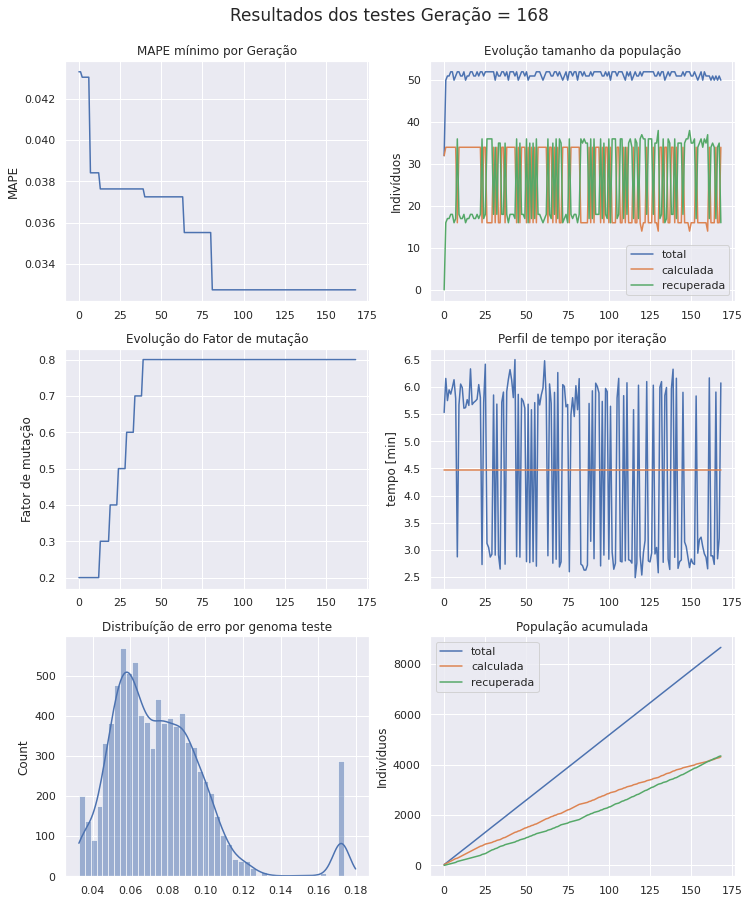

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 169 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [54 45 29  5  8 39  5 41  2 44 46 29 24]
Projenitores [10 25 42 32 43  0  7  6 56 43 36 13 32]
Projenitores [ 2  0 11 15 30 10 15 33 20 19 18 17 28]
Projenitores [31 53 43  4 16  3 15 15 59  4 41  6 30]
Projenitores [47 56 53  8  5 36 61 31 62  5  3 54 37]
Projenitores [31 33  5 22 16 51 16 62 10 20 52 56 35]
Projenitores [62 52 44 31 58 62 59 46 48 52  7 35 58]
Projenitores [47 61 56 56 17 25 42 57 28 58 61 14 54]
Projenitores [24 61 51 43 24 58 41 37 58 21 37 31 39]
Projenitores [45  5  9 11 57 43 13 31 21 30 11  1 27]
Projenitores [25 56 53 34 27  5 61 31 62  5 24 54 37]
Projenitores [ 2 21 51 26 55 19  2  9  6 45 59 50 39]
Projenitores [ 2 20 40 21 54  0 61 40 52 18 22 34 40]
Projenitores [48  0 29 44 49 53 61 46 50 54 22 37 40]
Projenitores [12  3 13 54 37 10 47 52  4

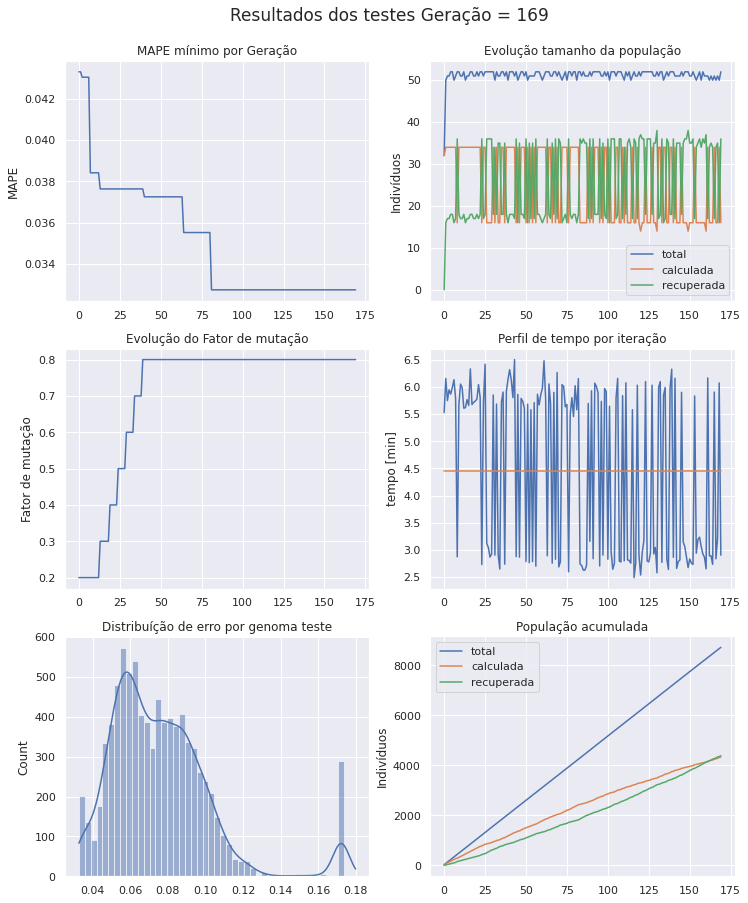

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 170 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [11  4 38 55 16 29 15 51 19 55 33 44 20]
Projenitores [ 2  0 40 44 49 53 61 40 52 18 22 34 40]
Projenitores [ 2 53 43 15 30 10 15 33 20  4 41  6 30]
Projenitores [47 56  5 22  5 36 61 62 62 20  3 54 35]
Projenitores [ 3 19  9 15 28  7 11 51 33 15  2 60 12]
Projenitores [12  3 13 54 37 10 47 52  4 38  5 40  9]
Projenitores [31 33  5 22 16 51 16 62 10 20 52 56 35]
Projenitores [47 61 56 56 17 25 42 57 28 58 61 14 54]
Projenitores [62 52 44 31 58 62 59 46 48 52  7 35 58]
Projenitores [ 2 21 51 26 55 19  2  9  6 45 59 50 39]
Projenitores [42  0 48  4 61 16 47 48  1 50 30  9 25]
Projenitores [57 32 15 46 28 35 43 31 13 18 37 17 60]
Projenitores [47 56 53  8  5 36 61 31 62  5  3 54 37]
Projenitores [31 33 53  8 16 51 16 31 10  5 52 56 37]
Projenitores [48  0 29 44 49 53 61 46 50

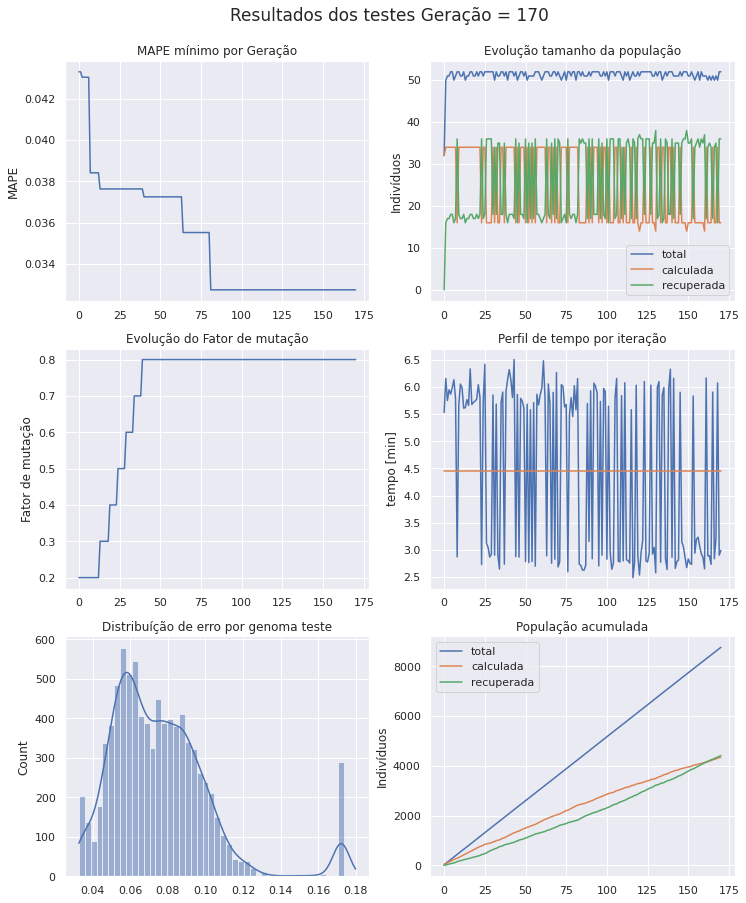

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 171 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [42  0 48  4 61 16 47 48  1 50 30  9 25]
Projenitores [48  0 29 44 49 53 61 46 50 54 22 37 40]
Projenitores [16 45 29 29 15 59 57  0 56 20  9 36 13]
Projenitores [38 26 34 49 49 53 61 44 59 40 56 37 40]
Projenitores [47 56 53  8  5 36 61 31 62  5  3 54 37]
Projenitores [47 56  5 22  5 36 61 62 62 20  3 54 35]
Projenitores [47 56 53  8 16 36 61 31 10  5  3 54 37]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [31 33  5 22 16 51 16 62 10 20 52 56 35]
Projenitores [42 32 48  4 61 16 43 31  1 50 37  9 25]
Projenitores [39 54 32  2 58 11 27  0 11 32  8 42 38]
Projenitores [47 29 38 29 18 39 22  0 61 49 35 62 47]
Projenitores [57  0 15 46 28 35 47 48 13 18 30 17 60]
Projenitores [47 61 56 56 17 25 42 57 28 58 61 14 54]
Projenitores [ 2  0 40 44 49 53 61 40 52

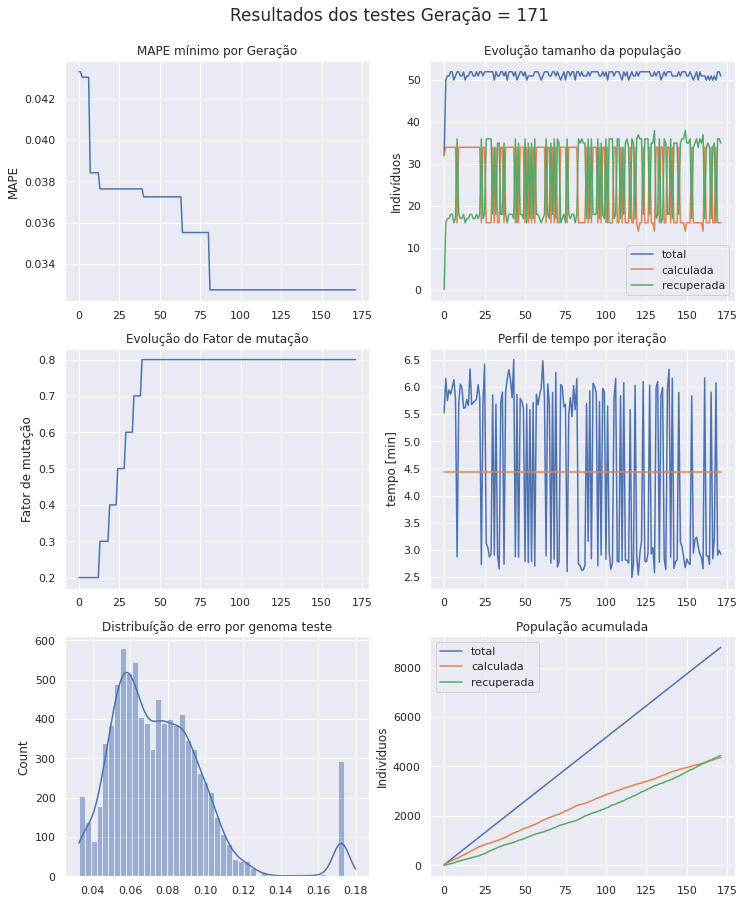

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 172 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [47 56  5 22  5 36 61 62 62  5  3 54 37]
Projenitores [48  0 48  4 49 16 61 46  1 50 30 37 25]
Projenitores [42 33  5 22 61 16 43 31  1 20 52  9 25]
Projenitores [12 15 52 30 30 18  4 34 25 46  6 55 26]
Projenitores [47  0 15 56 17 25 47 57 13 58 30 14 60]
Projenitores [47 56 53  8  5 36 61 31 62 20  3 54 35]
Projenitores [51 25 63  4 29 43 45  7  6 49 22 19 25]
Projenitores [57 61 56 46 28 35 42 48 28 18 61 17 54]
Projenitores [33 28 33 34 47 36  7  2 12 31 50 23 25]
Projenitores [47 56 53  8 16 36 61 31 10  5  3 54 37]
Projenitores [ 2 28 34 56 49 59 61 40 52  9 22 34 25]
Projenitores [30 18 16  9 35  1 26 60 12 55 51 49 26]
Projenitores [16 45 29 29 15 59 57  0 56 20  9 36 13]
Projenitores [18 28 34 56 42 59 25 35 61  9 42 62 25]
Projenitores [27 63

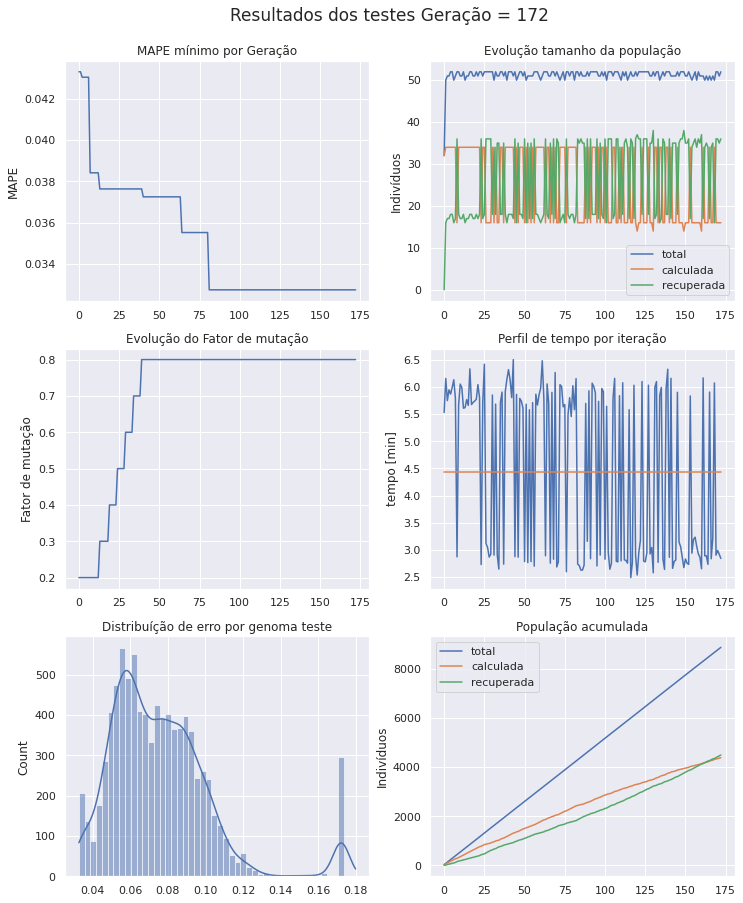

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 173 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [18 28 34 56 42 59 25 35 61  9 42 62 25]
Projenitores [47 56  5 22  5 36 61 62 62  5  3 54 37]
Projenitores [18 45 29 56 42 59 57  0 61  9 42 36 13]
Projenitores [14 50 57 33 49 30 11 44 54 34 46 49  3]
Projenitores [42 14 59 46  2 15 36 25 54 47  1 28 30]
Projenitores [54 47 21 59 48 19 37 62 22  7 18 40 52]
Projenitores [12 15  5 22 61 16  4 31  1 20  6 55 26]
Projenitores [33 56 33 34 47 36  7  2 12  5 50 54 37]
Projenitores [50 46 17  8 17 43 15 16  9 13  9  0  9]
Projenitores [51 25 63  4 29 43 45  7  6 49 22 19 25]
Projenitores [38 63 34 49 49 53 61 22 59 50 56 37 10]
Projenitores [51 61 56 46 29 43 42 48  6 18 61 17 54]
Projenitores [30 18 34 56 49  1 61 40 52 55 22 34 26]
Projenitores [22 34 19 29 43 57 58 55 20  8 34 49 46]
Projenitores [42 33 52 30 30 18 43 34 25

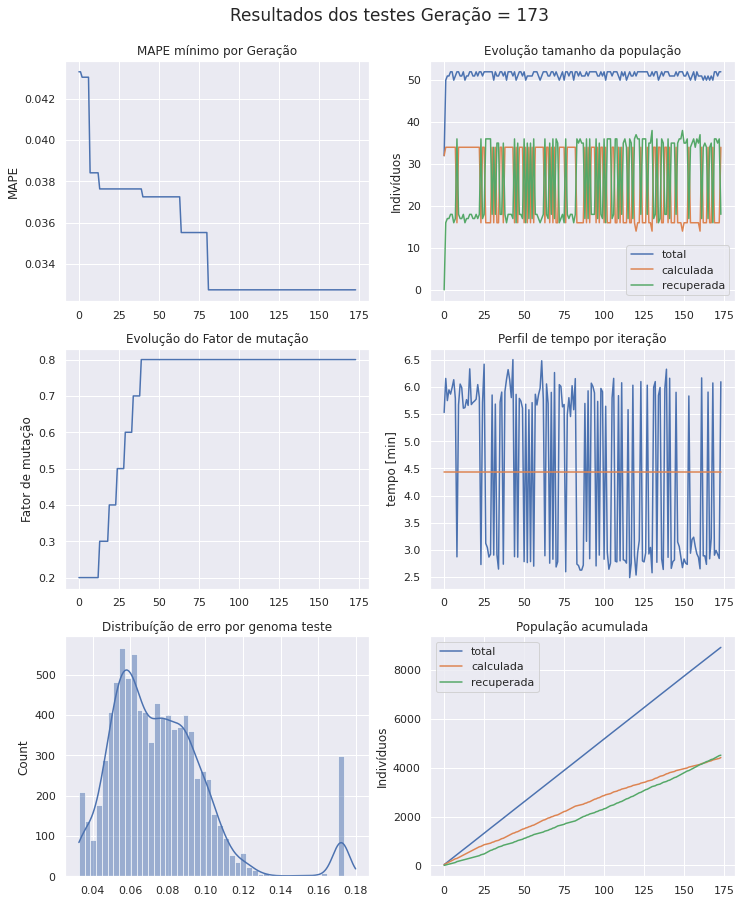

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 174 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [50 46 63  4 17 43 15  7  6 49  9  0  9]
Projenitores [47 56  5 22  5 36 61 62 62  5  3 54 37]
Projenitores [18 45 29 56 49 30 11 44 54  9 46 49 13]
Projenitores [43 20 53  6 43 15  0 61  1 17 55 48 47]
Projenitores [ 2 19 39 48 50 42 46 59 53 26 19 27 56]
Projenitores [38 61 34 49 49 53 42 22  6 50 56 17 54]
Projenitores [50 35 33 26 14 62 48 42  2 31 39  1 33]
Projenitores [17 20 20 28 58 56 32 40 32 37 34 31  4]
Projenitores [47 28 20 36 24 34 21 26 21 59 28 39 40]
Projenitores [21 52 54 13 43 11  0 29 14 26 19 24 19]
Projenitores [13 12 55  1 45 42 46 52 55 50 48 13 60]
Projenitores [48  0 48  4 49 16 61 46  1 50 30 37 25]
Projenitores [30 18 19 56 43  1 61 40 20 55 34 34 26]
Projenitores [48 33 52 30 30 16 61 34 25 46 30  9 25]
Projenitores [23  2 56  2 37  7 31 10  7

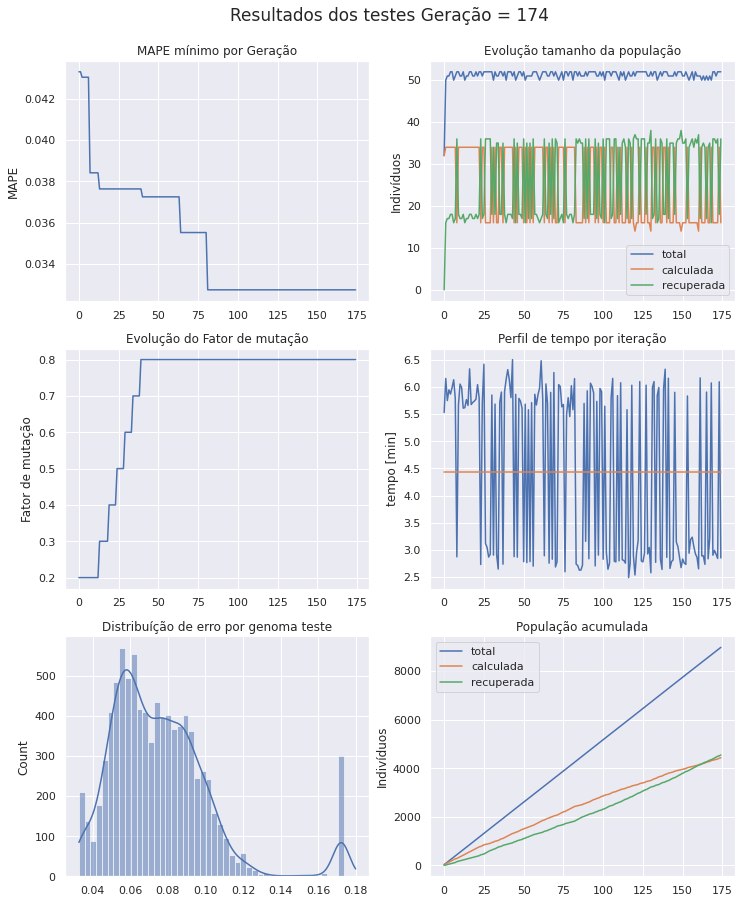

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 175 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 2 44 38 47 16 24 32 48  6 33  5 17 26]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [51  2 17  2 37 43 45 10  7 13 37 19 17]
Projenitores [21 28 54 36 43 11  0 26 21 26 28 24 40]
Projenitores [10 42 63 61 18 21 21 50 14 13 35 52 39]
Projenitores [38 19 39 49 49 42 46 59 53 26 19 17 54]
Projenitores [ 8 27 43 60 26 13 56 60 37 62 56 50 22]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [22  8 62 22 56 34 48 53 37 40 44 19 48]
Projenitores [50 20 20 26 58 56 32 40  2 31 39  1  4]
Projenitores [13 12 55  1 45 42 46 52 55 50 48 13 60]
Projenitores [18 45 29  6 49 30 11 61 54  9 55 49 13]
Projenitores [57 54 14  4 29  5 10 63 28 58 10  5 40]
Projenitores [18 45 29 56 49 30 11 44 54  9 46 49 13]
Projenitores [39 38 10 32 36 37 48 26 53

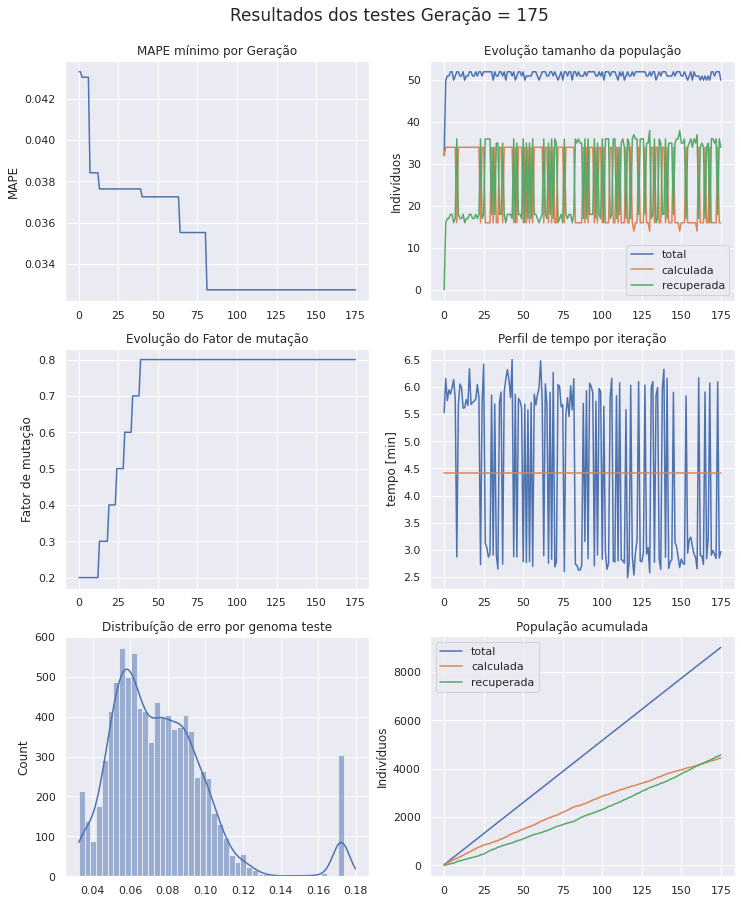

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 176 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [10 42 63 49 18 21 46 59 14 26 19 17 54]
Projenitores [50 20 20 26 58 34 32 53 37 31 39 19 48]
Projenitores [51  2 17  2 37 43 45 10  7 13 37 19 17]
Projenitores [18 54 14  4 49  5 10 44 54  9 46  5 13]
Projenitores [50 43 27 33 30 43  9 44 60 50 26 13 19]
Projenitores [18 45 29  6 49 30 11 61 54  9 55 49 13]
Projenitores [39 38 10 32 36 37 48 26 53 25 30 11 55]
Projenitores [50 46 14 56 47 29  7 58 31 17 34 12 39]
Projenitores [38 19 39 61 49 42 21 50 53 13 35 52 39]
Projenitores [41 19 59 12 31 16 41 12 15 46 47 37 51]
Projenitores [39 38 10 32 31 37 48 26 53 25 26 11 59]
Projenitores [ 2 44 29 47  8 24 63 41 49 33  5 41 28]
Projenitores [38 19 39 49 49 42 46 59 53 26 19 17 54]
Projenitores [57 45 29 56 29 30 11 63 28 58 10 49 40]
Projenitores [25 22 51 59 46 54 49 57 17

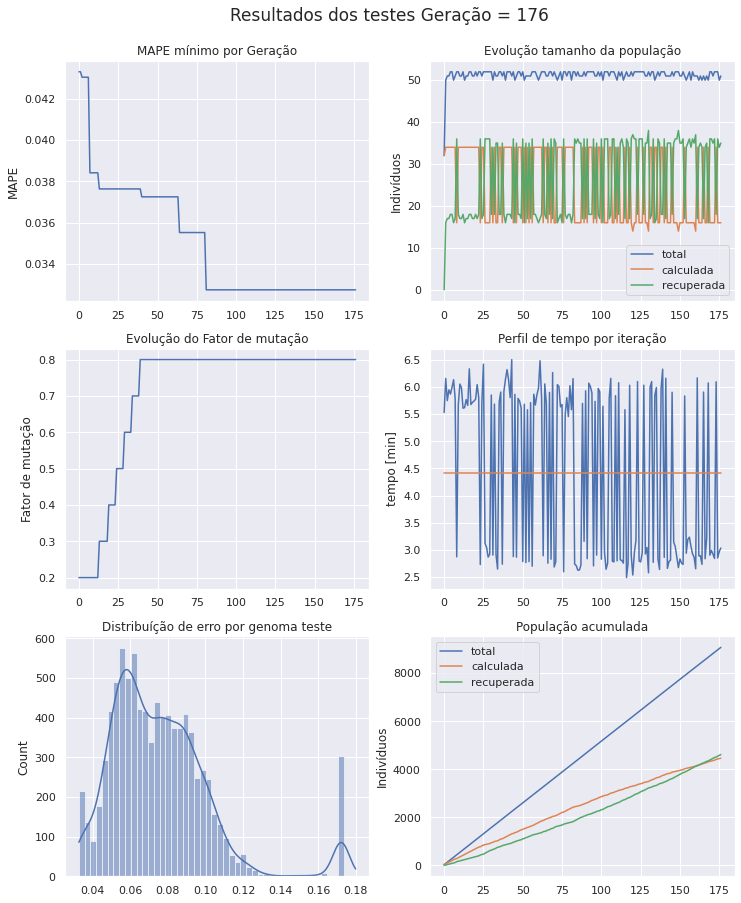

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 177 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [41 19 59 12 31 42 41 12 15 13 47 52 39]
Projenitores [55 62 22 14  1 22 34  9 47 33 23 58 47]
Projenitores [26  6 53 46 12 44 58 25 26 28 33 61 54]
Projenitores [57 45 29 56 29 30 11 63 28 58 10 49 40]
Projenitores [59 31 50 13 37  3 47 33 36 61 30  6 34]
Projenitores [57 19 39 56 29 42 46 59 28 58 10 17 54]
Projenitores [62  7 61  6 32 42  6  0 39 24  7 54 28]
Projenitores [39 46 14 56 36 37  7 58 53 17 34 12 39]
Projenitores [17 53  6  6 44 18 46 35 57 42 53 35 18]
Projenitores [51 49  3  7 51 50 18 24 23 28 47 42  7]
Projenitores [14 50 57 33 49 30 11 44 54 34 46 49  3]
Projenitores [54 47 21 59 48 19 37 62 22  7 18 40 52]
Projenitores [14 46 37 38 59 28 37 48 11 41 39 41 52]
Projenitores [51  2 14  4 49  5 45 44 54  9 37 19 17]
Projenitores [38 19

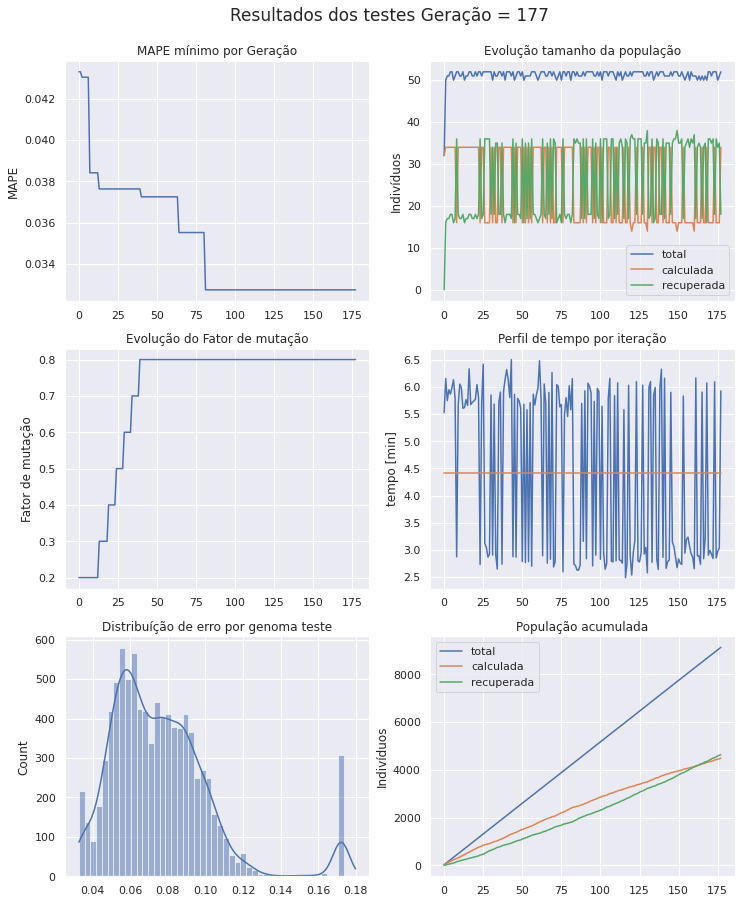

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 178 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [17 49  6  6 44 18 18 35 23 42 47 42  7]
Projenitores [ 8 40  8 11 58 16 17 46 57 53 32 12 50]
Projenitores [51  0  0 30 52 54 29 63 60 52 60  2  8]
Projenitores [38 19 39 61 49 42 21 50 53 13 35 52 39]
Projenitores [32  8  6  4 50 18 57 16 45 28  5 38 41]
Projenitores [51  2 37  4 49 28 37 48 11 41 39 41 17]
Projenitores [ 4 61 23 58 32 10 47 40 34 44  6 11 41]
Projenitores [62  7 14 56 36 42  7 58 53 17  7 12 39]
Projenitores [53 63 58 19 62  4 19 52 34  2 28 45 24]
Projenitores [24 11 43 18  0  7 21 34 58 38 35 44 13]
Projenitores [ 0  5 41 46  7  4 32  3 57 29 10 31 45]
Projenitores [25 17 41 28 46 55 38 34 52 34 43 24 60]
Projenitores [34 24 17 62 45 48 34  5  3 35 51 54 32]
Projenitores [26 45 29 56 29 30 11 63 28 28 33 61 54]
Projenitores [51 49  3  7 51 50 18 24 23

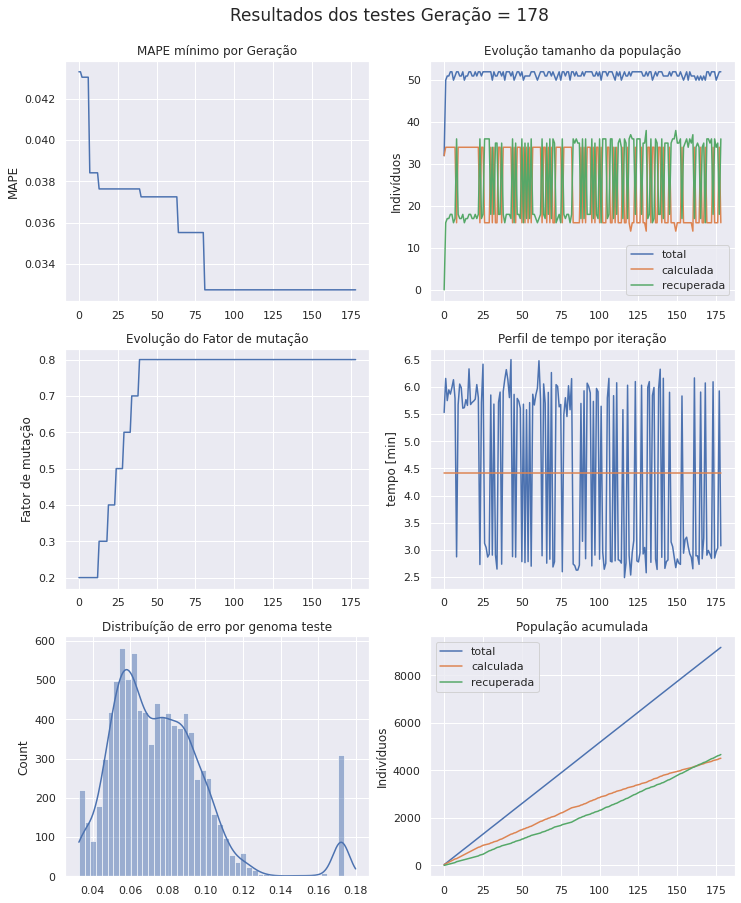

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 179 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 8 40  8  6 58 18 17 46 23 42 47 12  7]
Projenitores [ 4 61 14 56 36 10  7 58 53 17  6 12 39]
Projenitores [14 50  3 33 51 30 11 44 54 28 47 49  7]
Projenitores [25 17 41 28 46 55 38 34 52 34 43 24 60]
Projenitores [ 0  5 41 28  7  4 32 34 57 34 43 24 45]
Projenitores [17 49  6  6 44 18 18 35 23 42 47 42  7]
Projenitores [32  8 37  4 50 18 57 16 45 41  5 41 41]
Projenitores [53 63 58 19 62  4 19 52 34  2 28 45 24]
Projenitores [17 49  6 11 44 16 18 35 57 53 32 42 50]
Projenitores [ 8 40  8 11 58 16 17 46 57 53 32 12 50]
Projenitores [57 39 18 21 25 46 46 33 60 26 57  2 20]
Projenitores [24 63 43 18  0  7 19 34 34 38 28 45 24]
Projenitores [25 17 41 28 46 55 38 34 52 34 43 24 60]
Projenitores [ 0 49 15 58 51 30 51 42 37 48 37 38 60]
Projenitores [38 19 39 61 49 42 21 50 53

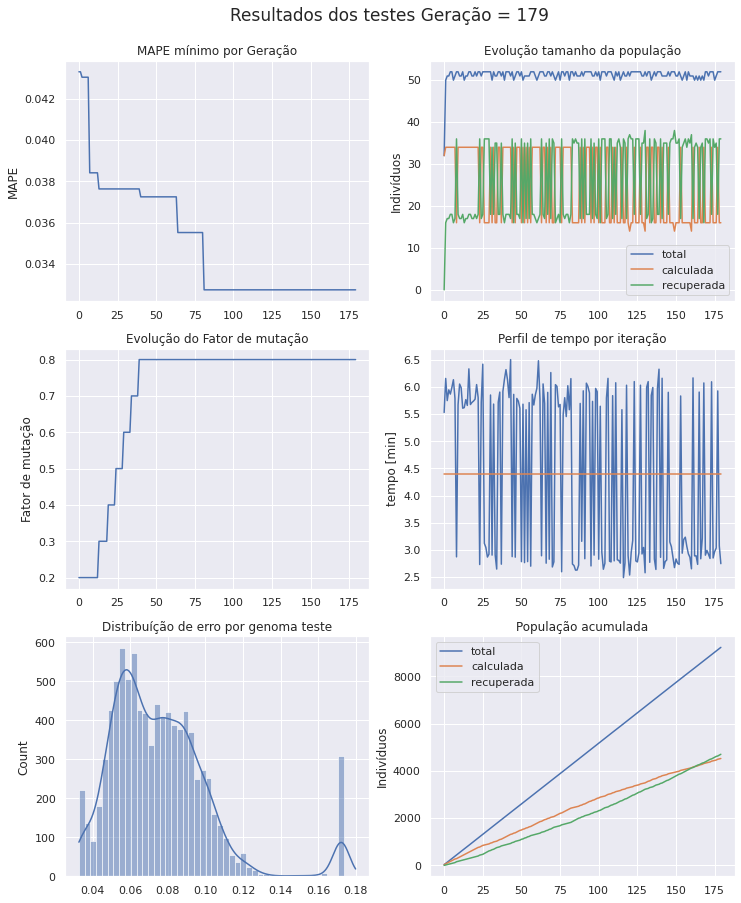

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 180 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 0 49 15 58 51 30 51 42 37 48 37 38 60]
Projenitores [57 39 18 21  0  7 19 34 34 38 57  2 24]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [ 2 20 19 48 54 32 61 28 55 18 31 28 30]
Projenitores [32  8 37  4 50 18 57 16 45 41  5 41 41]
Projenitores [17 49  6  6 44 18 18 35 23 42 47 42  7]
Projenitores [54 15  5 17 42 20 54 48 22 37 13 49 50]
Projenitores [38 11 39 18  0  7 21 50 53 38 35 44 13]
Projenitores [39 34 10 54 32 41 18 22  6  2  7 39 48]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [18 32 13 10 23 60 17  7 57 24 10 28 20]
Projenitores [ 0 17 41 58 46 55 38 42 37 48 37 38 60]
Projenitores [33 53 20 10 32 55 61 56 25 21 39 32 57]
Projenitores [19 25 49 14 13 20 52 43  6 13 56 59 15]
Projenitores [32 63 58 19 50  4 19 16 34

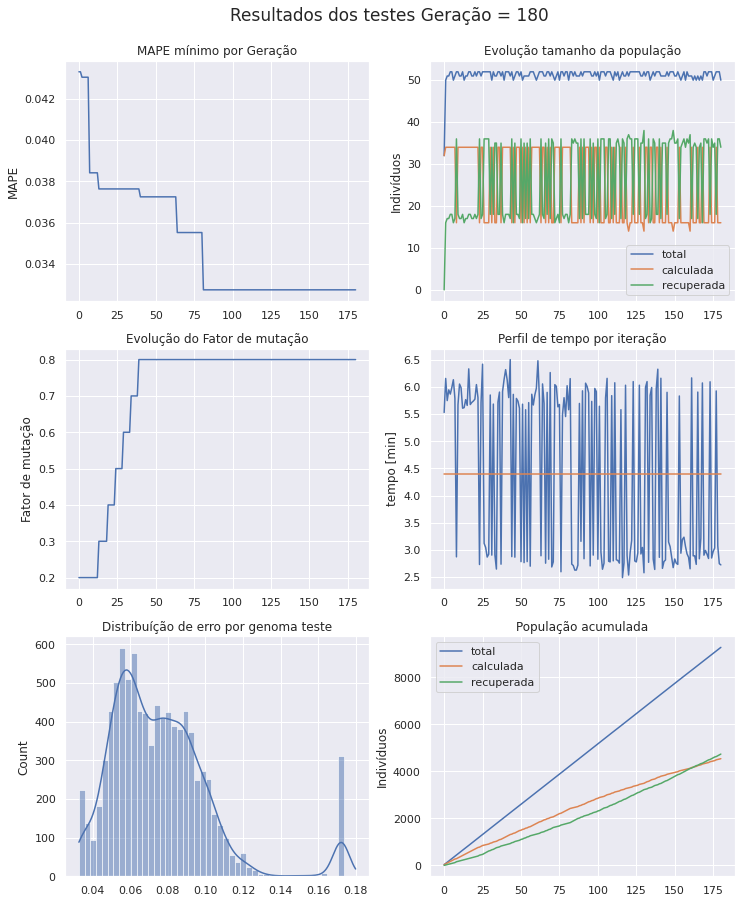

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 181 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 2  5  1 33 25 10 18 54  8 14 17 57 15]
Projenitores [32 63 58 19 50  4 19 16 34 39 28 45 41]
Projenitores [19 25 49 14 13 20 52 43  6 13 56 59 15]
Projenitores [32 63 58 19 50  4 19 16 34  2 28 45 41]
Projenitores [38 55  3 57 28 59 62  5 43 28 50  1 47]
Projenitores [13 21 28 56 51 21 41 14 13 47 35 58  6]
Projenitores [19 55 63 46 36  5  0 39 39 56 55 48 27]
Projenitores [17  8  6  6 50 18 18 35 23 42 47 41  7]
Projenitores [ 0 49 15 58 51 30 51 42 37 48 37 38 60]
Projenitores [ 2 20 19 48 54 32 61 28 55 18 31 28 30]
Projenitores [28 59  4 41 27 60 56 36 53 54  7 53 49]
Projenitores [52 25 11 61 55 26 55 45 32 40 59 23 47]
Projenitores [17 49  6  6 44 18 18 35 23 42 47 42  7]
Projenitores [39  0 10 54 32 53 61 22 50  2  7 39 48]
Projenitores [43 14 19 45 16 33 19 54 47

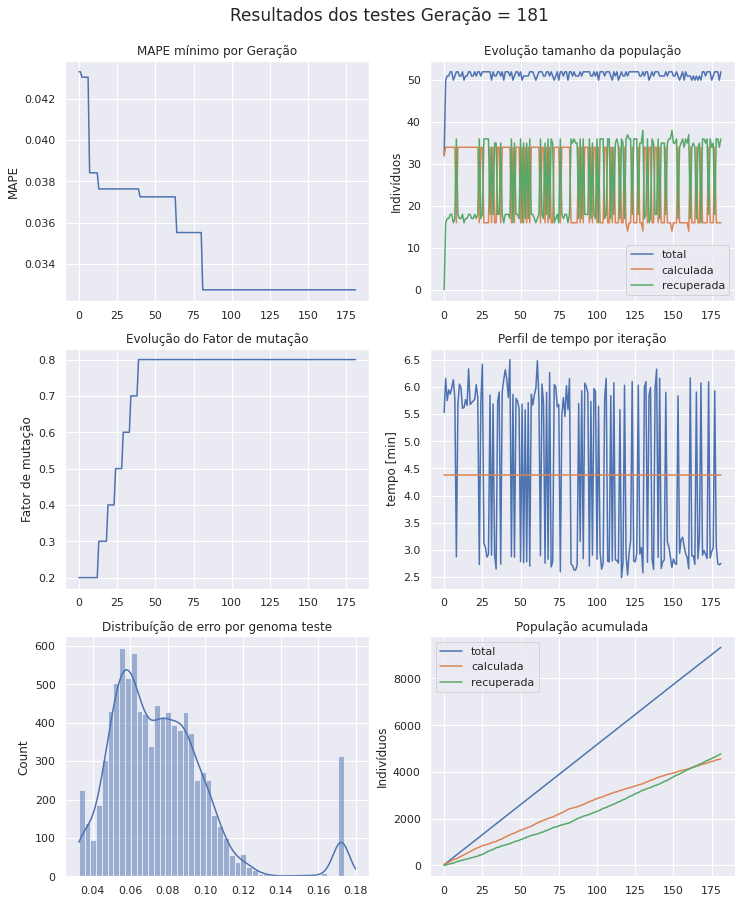

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 182 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 2 49 19 58 54 30 61 28 55 18 37 28 60]
Projenitores [23 14 49 47 33 45 15 16 58 40 35 44 46]
Projenitores [32 63 58 19 50  4 19 16 34 39 28 45 41]
Projenitores [13 21  3 56 51 59 41 14 43 28 50 58  6]
Projenitores [26  5 43 27 57 28 10 54  8 40 24 38 54]
Projenitores [18 38 17 21 21 14 34  6 14 26 27 49 23]
Projenitores [26 45 34 42 36 21 39 44 13 50 11 61 61]
Projenitores [27 20 54 43  6 10 51 20 31 23 32 60  9]
Projenitores [31  0 55  9 39 57 21 15 18 42  0 24  8]
Projenitores [ 1 43 60  5 56 59 45 39 56 23 58 63 28]
Projenitores [10 27 58 59  5 54  9 28 44 62 49 13 52]
Projenitores [19  8 63 46 50 18 18 39 23 42 55 41 27]
Projenitores [43 32 19 45 16 33 17 54 47 24 57 28 32]
Projenitores [ 0 20 15 48 51 32 51 42 37 48 31 38 30]
Projenitores [50 46

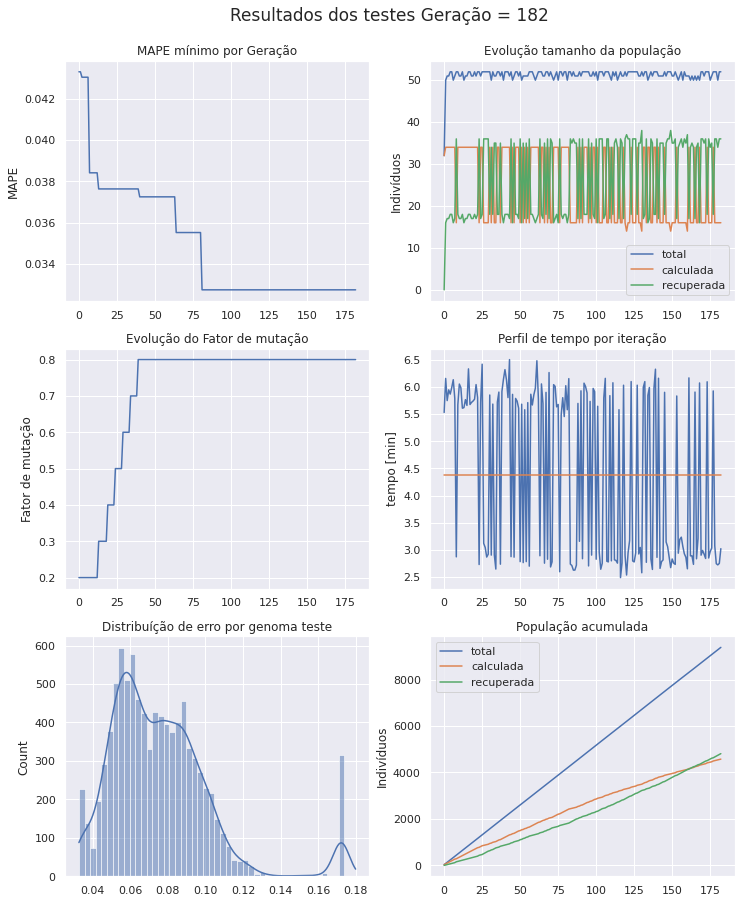

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 183 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [53  1 51 52 17 41 21  5 21 43 14 59 60]
Projenitores [50 46 44 42 14 38 56 51 10 44 12 31 47]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [ 3 54 44 17  1 44 18 14  8 38 51 63 36]
Projenitores [ 1 43 55  9 56 57 21 15 18 42 58 24  8]
Projenitores [27 45 34 43  6 10 51 20 13 23 11 60 61]
Projenitores [54 29 42 34 18 21 63 21 53 63 31 57 20]
Projenitores [26  5 17 27 21 28 34 54 14 26 24 49 23]
Projenitores [63 56 14 32 30 34 16 21 33  7 54 18 10]
Projenitores [10 23  0 45 34 25 55 25  5  7 48 23 50]
Projenitores [ 2 49 19 58 54 30 61 28 55 18 37 28 60]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [43 20 15 45 16 32 51 54 37 24 57 28 30]
Projenitores [ 7 49 62 17  3 23  1 30 34 51 51  6 57]
Projenitores [ 5 19 59 28  5  2 57 44 63

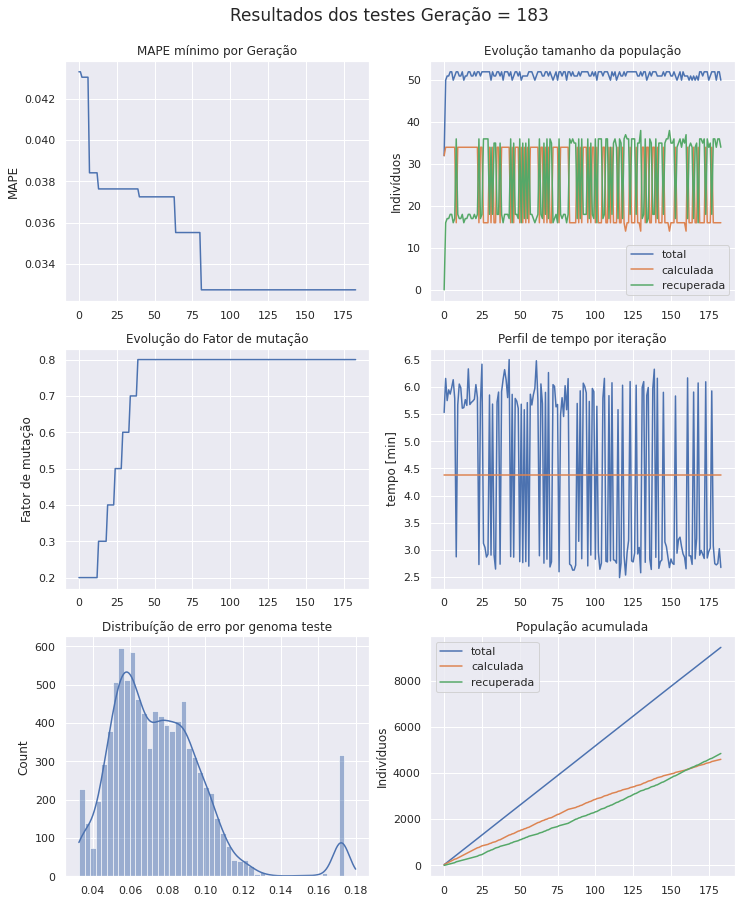

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 184 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [ 5 19 34 28  5 21 57 44 13 50 11 61 45]
Projenitores [43 20 15 45 16 32 51 54 37 24 57 28 30]
Projenitores [16 58  7 22  7 27 42  2 14 57 19  4  1]
Projenitores [57 22 60 49 42 42 51 63 18  8  5 38 20]
Projenitores [ 2 49 29 58 54 53 61  8 50 54 37 37 40]
Projenitores [53  1 51 42 17 41 21  5 21 43 12 59 60]
Projenitores [10 23  0 45 34 25 55 25  5  7 48 23 50]
Projenitores [ 7 49 62 17  3 23  1 30 34 51 51  6 57]
Projenitores [29 41 51 32 14 56 25 18 17 53 23  9 53]
Projenitores [50 54  7 52 21 36 24 11 10 31 59 45 29]
Projenitores [48  9 23 44 45  2 30 46 37 27 39 44  7]
Projenitores [ 3 54 44 17  1 44 18 14  8 38 51 63 36]
Projenitores [ 1 43 55  9 56 57 21 15 18 42 58 24  8]
Projenitores [54 29 42 34 18 21 63 21 53

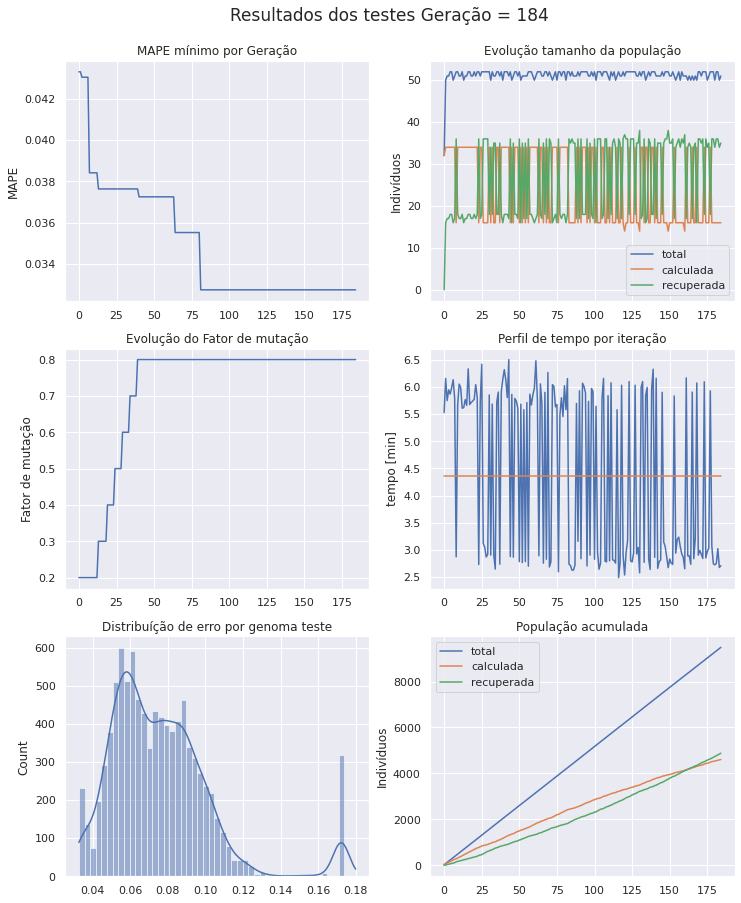

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 185 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [35  0 42 21 54 21 63 21 53 18 22 28 60]
Projenitores [ 5 45 29 28  8 39 63 41 49 44 46 41 45]
Projenitores [ 2 22 29 58 54 53 51  8 18  8 37 38 20]
Projenitores [50 28 58 37 48 50 46 29 54 63 62  7  0]
Projenitores [10  1 51 45 17 25 55 25 21  7 12 23 50]
Projenitores [54 19 34 29  5 21 57 44 13 50 11 61 28]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [43 20 15 45 16 32 51 54 37 24 57 28 30]
Projenitores [50 54  7 52 21 36 24 11 10 31 59 45 29]
Projenitores [ 0 51 11 56 42 19  2 50  2 41  0  0 23]
Projenitores [50  9 23 44 45  2 24 11 37 31 59 45 29]
Projenitores [57 61 19  9 32 12 47 12 47 24 19 19 15]
Projenitores [ 7 49 62 32  3 56  1 30 17 51 51  9 57]
Projenitores [58 53 48 20  4 14 43 25 17 55 32 43 54]
Projenitores [22 59 16 26 54 47 30 12  1

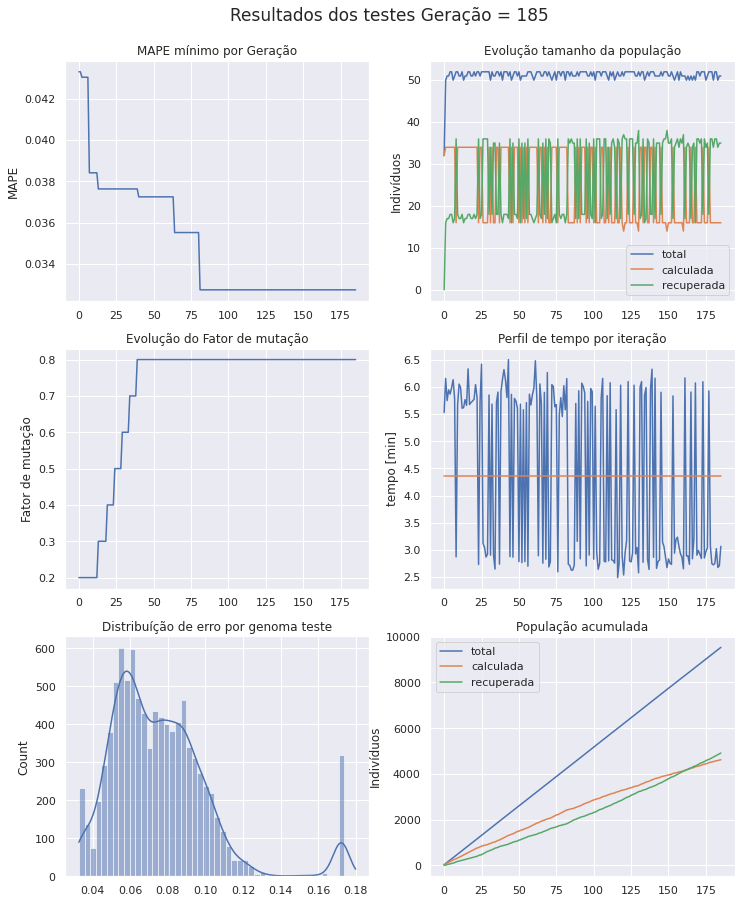

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 186 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [58 49 48 20  4 56  1 30 17 51 32  9 54]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [50  9 23 44 45  2 24 11 37 31 59 45 29]
Projenitores [35  0 42 28 54 39 63 21 53 44 22 28 60]
Projenitores [50  9 19  9 32 12 47 12 37 31 19 19 29]
Projenitores [42 34 34 14 36  7 39 37 45 22  9 30 45]
Projenitores [17 39 35 17 28 22 38 41 10 13  6 25 38]
Projenitores [ 2 14 46  0 29 63 11 35 53 29 33  2 20]
Projenitores [ 9  2  7 53  5 36 37 56 21 40 13 27 49]
Projenitores [20 10 32 55 61 56 25 21 39 32 57 19 25]
Projenitores [49 42 20 44 15 30 27 14 51 19 59 26 43]
Projenitores [49 14 13 20 52 43  6 13 56 59 15 24 59]
Projenitores [22  7 35 53 47 46 60 51 34 36 36 32 19]
Projenitores [10  1 51 45 17 25 55 25 21  7 12 23 50]
Projenitores [ 2 22 29 58 54 53 51  8 18

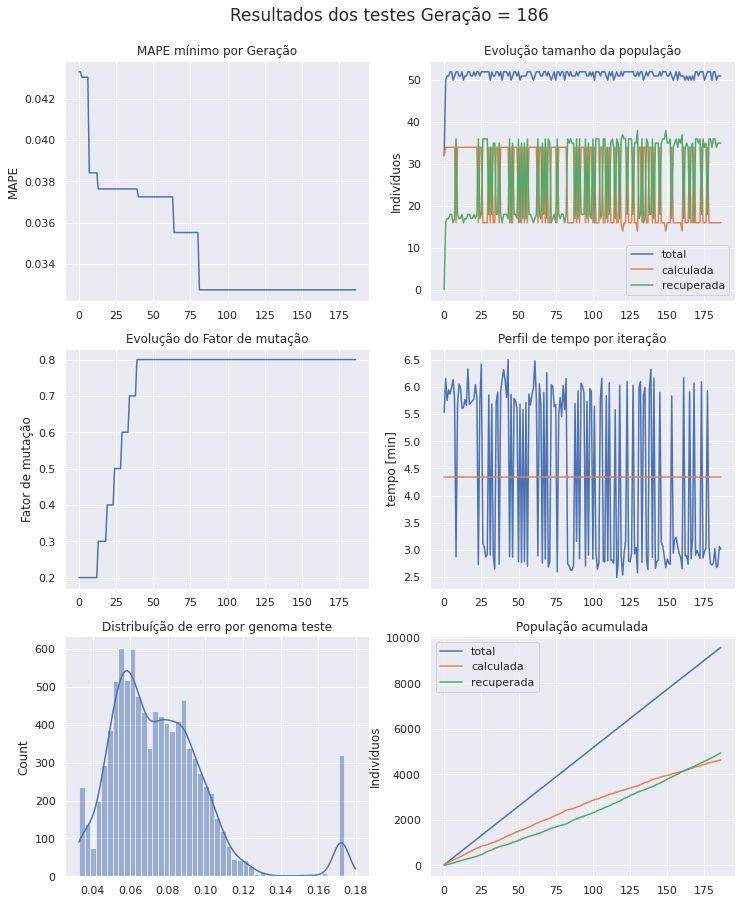

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 187 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [10  1 51 53 47 25 60 51 34  7 12 23 19]
Projenitores [45 22 32  8 54 13 51 15 18  0 37 19 24]
Projenitores [58 49 48 20  4 56  1 30 17 51 32  9 54]
Projenitores [ 2  6 62  7 19  8 34 41 45 22 12 28 21]
Projenitores [42 34 34 14 36  7 39 37 45 22  9 30 45]
Projenitores [49 14 20 44 15 43 27 13 51 59 15 24 59]
Projenitores [45 35 32  8 20 13 50 15 41  0 44 19 24]
Projenitores [50  9 23 44 45  2 24 11 37 31 59 45 29]
Projenitores [29 19 31  1  4 29 59  2 30  9 29 35 45]
Projenitores [12 22 27 17 17  9 19 47 28 32 34 24  0]
Projenitores [ 9  2  7 53  5 36 37 56 21 40 13 27 49]
Projenitores [60 34 36 61 32 24 42 52 59 36 35 17  9]
Projenitores [50  0 42 44 45 39 63 11 53 31 22 45 29]
Projenitores [12 63 34  7  7  7 54 61 10 48 60 35 50]
Projenitores [35  0

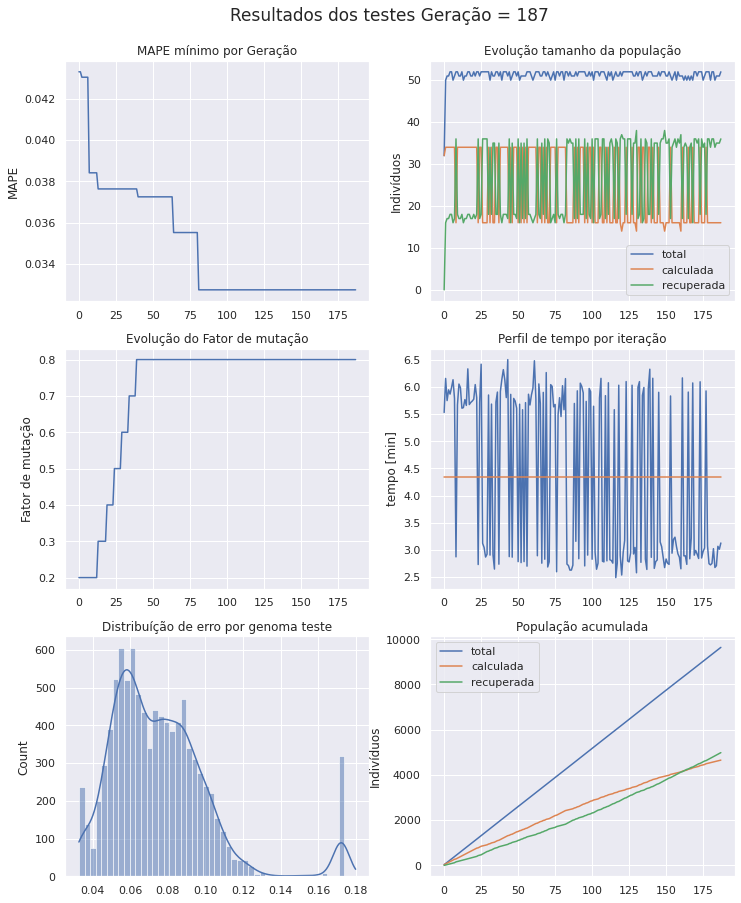

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 188 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [45  9 32 44 20  2 50 11 37 31 59 45 29]
Projenitores [27 52 31 31  1 48 16 39 14 55 25 38 58]
Projenitores [45 30 49 62 47 31 50  8 38 38 21  2  1]
Projenitores [57 32 41  6 14 20 39 56 36 28 22 43 55]
Projenitores [42 34 34 14 36  7 39 37 45 22  9 30 45]
Projenitores [31 47 23 39  0 45 15 28 10 17  2 13 36]
Projenitores [12 63 42  7 45 39 54 11 53 31 22 35 50]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [20 10 32 55 61 56 25 21 39 32 57 19 25]
Projenitores [ 9 34 36 61  5 24 42 52 21 40 13 27  9]
Projenitores [21 34 47 59 47  1 46 33 50  9 60 42 22]
Projenitores [50  0 42 44 45 39 63 11 53 31 22 45 29]
Projenitores [ 9  2  7 53  5 36 37 56 21 40 13 27 49]
Projenitores [58 49 48 20  4 56  1 30 17 51 32  9 54]
Projenitores [21 36  6 10  4 47 42 62 40

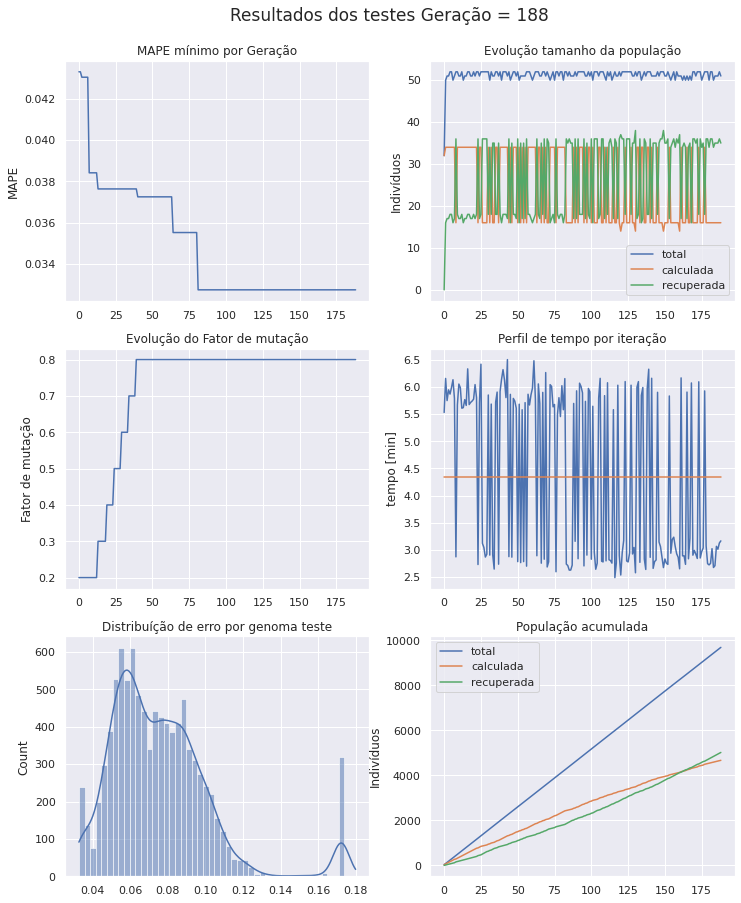

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 189 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [21 36  6 10  4 47 42 62 40  0 52 47 29]
Projenitores [32 17 49 31 62 24 19 53 59 37 32 38 28]
Projenitores [ 9 34 36 61  5 24 42 52 21 40 13 27  9]
Projenitores [45 32 41 62 14 31 50 56 38 38 21  2 55]
Projenitores [21  0 47 44 45 39 46 11 53  9 60 45 22]
Projenitores [54 63  6 49  4 55 42 56 40 41 52 47 29]
Projenitores [45  5  9 11 57 43 13 31 21 30 11  1 27]
Projenitores [ 9  2 48 53  4 36  1 56 17 40 13 27 54]
Projenitores [47 56 53  8  5 36 61 31 62  5  3 54 37]
Projenitores [55 46 49 56 31 39 49 27 54 28 50 33  1]
Projenitores [36 14 11 16  1 53 35 22 62  2 20 46 33]
Projenitores [ 2 63 27 38 56  9 52  2 11 22 33 16 13]
Projenitores [21 34 47 59 47  1 46 33 50  9 60 42 22]
Projenitores [ 2 55 11 50  7 33 35 58 18  2 51 41  9]
Projenitores [ 7 43 33 38 13 32 38 55 30

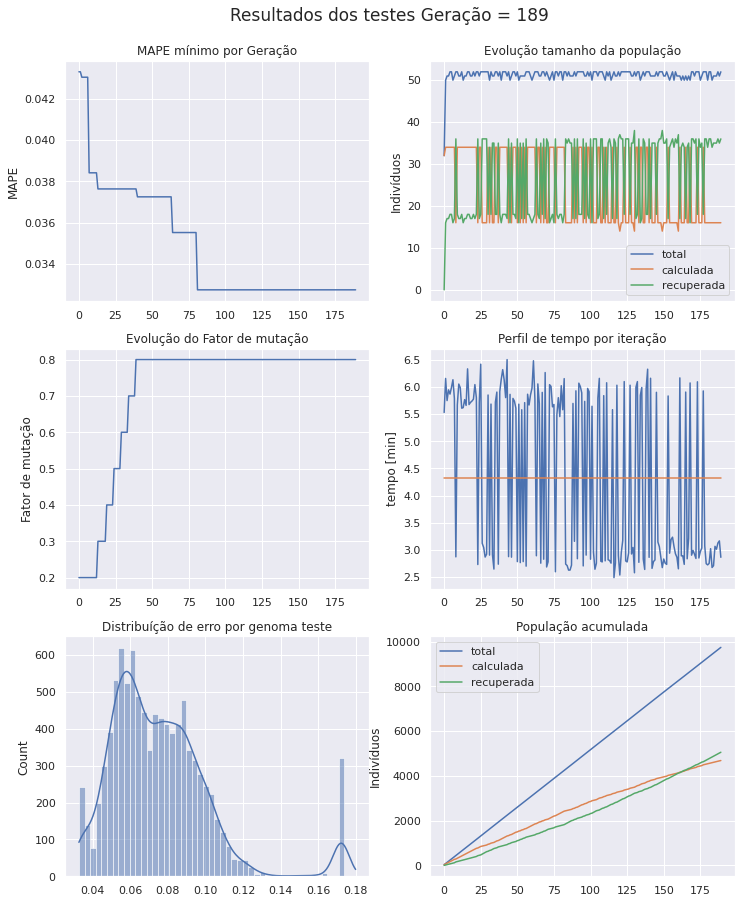

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 190 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [43 53 63 45 49  7 34 23 48 10 19 33 24]
Projenitores [32 17  6 31 62 24 19 53 40 37 52 38 28]
Projenitores [21 53 34 42 10 58  8 19 45 22 54 61  9]
Projenitores [45  5  9 11 57 43 13 31 21 30 11  1 27]
Projenitores [40  0 33 32 45 16 46 58 55 44 29 52 10]
Projenitores [ 7 56 59  1 20 42 20 54 25 39 17  9 60]
Projenitores [21 55 11 50 47  1 35 58 50  9 60 42  9]
Projenitores [ 9  2 48 53  4 36  1 56 17 40 13 27 54]
Projenitores [47 56 53  8  5 36 61 31 62  5  3 54 37]
Projenitores [ 7 43 33 38 13 32 38 55 30 63 40  9  9]
Projenitores [21  0 47 49 45 55 46 11 53 41 60 47 22]
Projenitores [ 7 30 33 62 13 31 38  8 30 63 21  2  9]
Projenitores [ 2 63 27 38 56  9 52  2 11 22 33 16 13]
Projenitores [55 56 49  8  5 39 49 31 54 28  3 54  1]
Projenitores [21 36 49 10  4 47 42 62 59

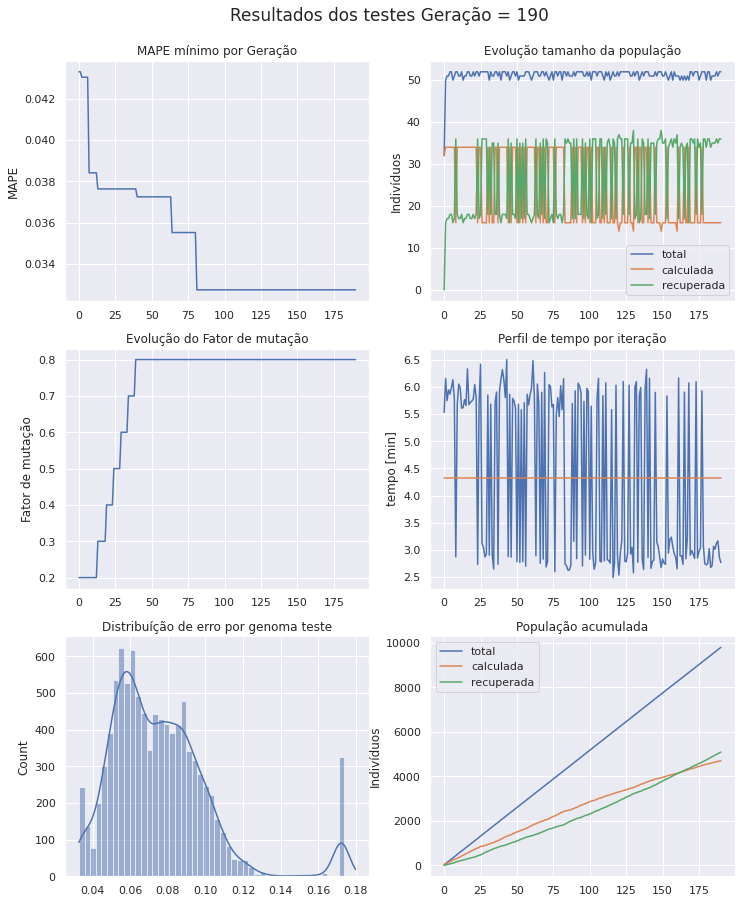

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 191 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [15 56 35 56  7 59 25 61 25 58 19  8 46]
Projenitores [15 47 16 56 37 49 18 46 23 47 50 54 31]
Projenitores [59 48 60 40  3 41 42 10  7 59 38 41 30]
Projenitores [32 17  6 31 62 24 19 53 40 37 52 38 28]
Projenitores [ 7 43 33 38 13 32 38 55 30 63 40  9  9]
Projenitores [21 55 11 50 47  1 35 58 50  9 60 42  9]
Projenitores [32 17  6 31 62 24 34 23 40 10 52 38 28]
Projenitores [21 36 49 56  4 39 49 27 59 28 50 47  1]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [ 7 56 33  8 13 32 61 31 62 63  3 54 37]
Projenitores [44 52 50 57  4 62 22 13 62 12 35 32 39]
Projenitores [55 46 49 10 31 47 42 62 54  0 32 33 29]
Projenitores [55 46 49 56 31 39 49 27 54 28 50 33  1]
Projenitores [ 7 30 47 62 13 31 38  8 30 41 21 47  9]
Projenitores [32 56 42  0 57 17 60 23 58

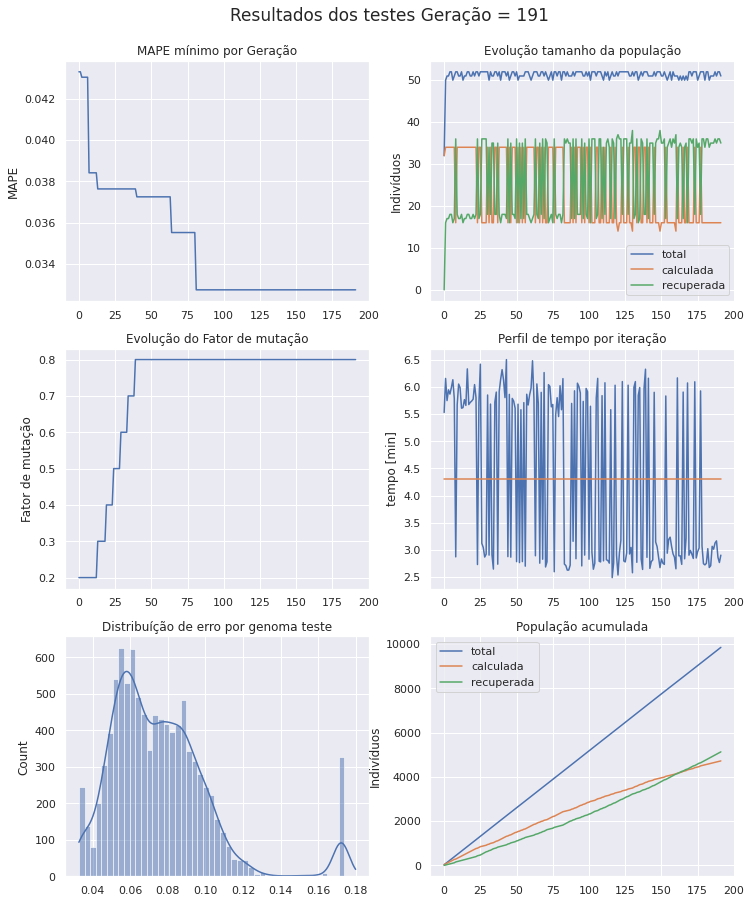

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 192 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [44 46 50 10 31 47 22 62 54 12 35 32 29]
Projenitores [32 17  6 31 62 24 34 23 40 10 52 38 28]
Projenitores [32 36 49 56 62 39 34 27 59 28 50 38 28]
Projenitores [54  4  3 63 13 41 19  0 28 57 13 34 10]
Projenitores [ 2 63 42  0 56 17 60  2 58  0 35  8 13]
Projenitores [43 16 28 29 35 35 39 10 50 16 51  7 20]
Projenitores [55 58 23 17 48 57 41 53 48 26 63 48 20]
Projenitores [44 52 50 57  4 62 22 13 62 12 35 32 39]
Projenitores [15 47 35 56 37 59 25 61 23 58 19  8 31]
Projenitores [ 2 63 27 38 56  9 52  2 11 22 33 16 13]
Projenitores [ 7  0 29  8 13 32 61 31 62 54 22 54 37]
Projenitores [32 56 27 38 57  9 52 23 11 22 33 16 32]
Projenitores [32 17  6 31 62 24 42 53  7 37 52 38 28]
Projenitores [59 48 60 40  3 41 42 10  7 59 38 41 30]
Projenitores [34 61

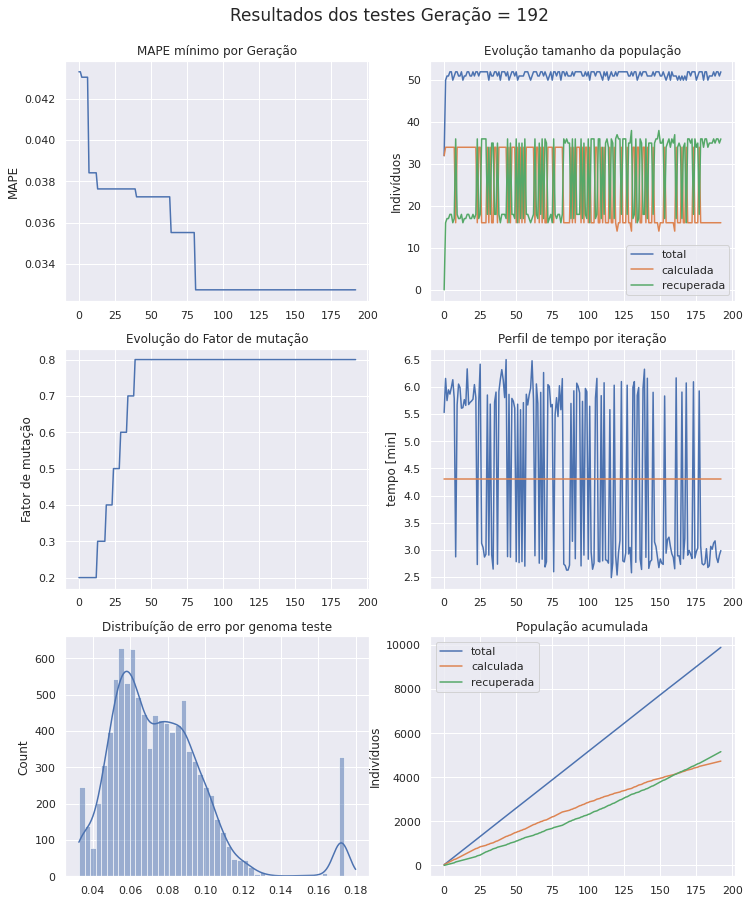

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 193 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [55 52 23 17  4 57 22 53 62 26 63 32 39]
Projenitores [ 0 56 30 14  1 14  1 36 54 58 56 61 53]
Projenitores [ 0  3 53  7 32 24 53 35 30 44 10 29 23]
Projenitores [59 17  6 31  3 24 42 53  7 37 52 38 28]
Projenitores [ 2 63 42  0 56 17 60  2 58  0 35  8 13]
Projenitores [22 33 49 22 12 23 38 53  7 44 18 60 57]
Projenitores [11 15 13 35 19 44 53 43 39  9 57 32 18]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [32  0 27 38 57  9 52 23 62 54 33 54 37]
Projenitores [32 17  6 31 62 24 42 53  7 37 52 38 28]
Projenitores [54  4  3 63 13 41 19  0 28 57 13 34 10]
Projenitores [32 56 27 38 57  9 52 23 11 22 33 16 32]
Projenitores [32 36 49 56 62 39 34 27 59 28 50 38 28]
Projenitores [ 3  3  9 62 25 54 56 46 37

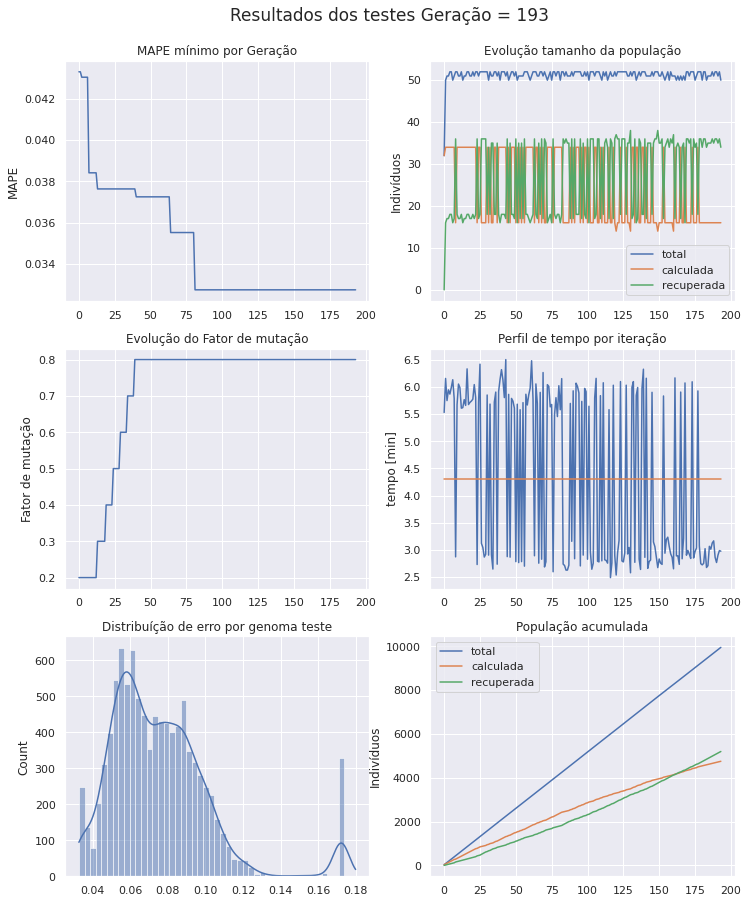

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 194 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [59 17  6 31  3 24 42 53  7 37 52 38 28]
Projenitores [ 2 55 11 50  7 33 35 58 18  2 51 41  9]
Projenitores [55 46 49 56 31 39 49 27 54 28 50 33  1]
Projenitores [32 56 49 38 62  9 34 23 59 22 33 16 28]
Projenitores [35  0 29 21 54 53 52  8 62 54 33 37 40]
Projenitores [ 3  3  3 62 38 54 28 46  1 26  1 28 16]
Projenitores [32  0 27 38 57  9 52 23 62 54 33 54 37]
Projenitores [36 14 11 16  1 53 35 22 62  2 20 46 33]
Projenitores [32  0 27 38 57  9 61 23 50 54 22 54 37]
Projenitores [34 43 39  5  4 48  5 26  2 16 33 29 24]
Projenitores [49 60  9 30 25 46 56 24 37 41  2  1 24]
Projenitores [16 48 39 28 61 48  2 28 21  0 45 11 35]
Projenitores [32 56 27 38 57  9 52 23 11 22 33 16 32]
Projenitores [22 33 49 22 12 23 38 53  7 44 18 60 57]
Projenitores [ 3  3  9 62 25 54 56 46 37

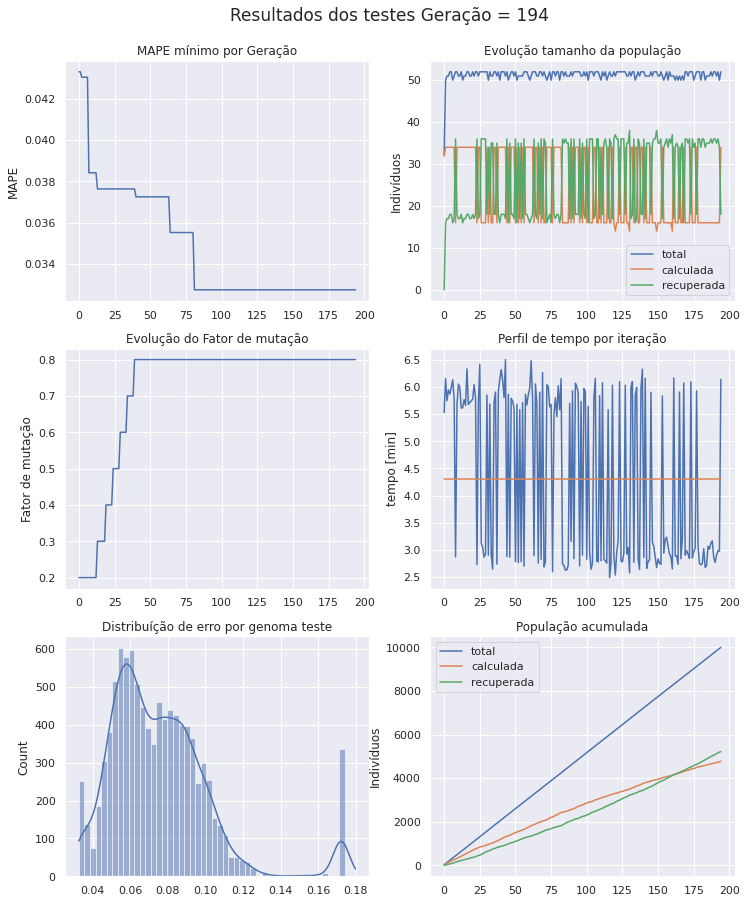

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
-->>epoca 195 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [26 21 34 51 43 28 16 60 60 50 28 23 63]
Projenitores [32  0 27 38 57  9 61 23 50 54 22 54 37]
Projenitores [14 20 44 18 55  0  5 30 27 49 57 31 36]
Projenitores [34 39 35 28 34 25 15 54 56 40 63 35 26]
Projenitores [34 43 39  5  4 48  5 26  2 16 33 29 24]
Projenitores [36  0 11 16  1 53 35 23 62 54 20 46 37]
Projenitores [41 62 12 43 19 28 24  0 56 53 52 28 62]
Projenitores [18  1 15 14  1 43 12 10 60 32 19 30 57]
Projenitores [ 3  3  9 62 25 54 56 46 37 26  2  1 24]
Projenitores [21 46 45 22 21 62 34 32 38 55 15 24 35]
Projenitores [16 60  9 28 25 46 56 28 21  0 45 11 35]
Projenitores [32  0 63 55 42 21 55 46 28 55 54 57 42]
Projenitores [32  1 36 21 49 17 36 47 24  9  9 20 58]
Projenitores [ 2 63 42  0 56 17 60  2 58  0 35  8 13]
Projenitores [22 33 49 22 12 23 38 53  7

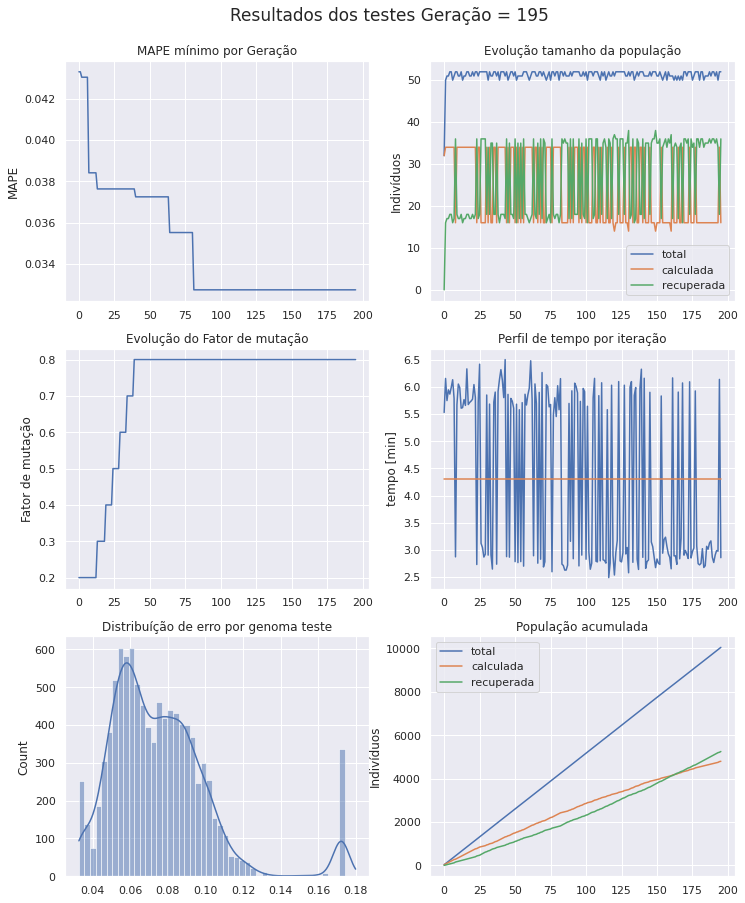

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 4 epocas
-->>epoca 196 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [16 11  1  4 56 28  4 33  9  3 22 21 48]
Projenitores [32 21 34 38 43  9 16 23 50 54 22 54 37]
Projenitores [27  8 55 54  9 37 35 19 63 56 15 63  0]
Projenitores [41 62 12 43 19 28 24  0 56 53 52 28 62]
Projenitores [18 21  0 51 24 47 46 29 16 58 18 62 38]
Projenitores [11  5  6 51 48 33  0 55  9 27 34 39 26]
Projenitores [ 2 63 42 21 49 17 60  2 24  0  9  8 13]
Projenitores [18  1 15 14  1 43 12 10 60 32 19 30 57]
Projenitores [ 3  3  9 62 25 54 56 46 37 26  2  1 24]
Projenitores [22 33 49 22 12 23 38 53  7 44 18 60 57]
Projenitores [36 43 11  5  1 53 35 23 62 16 33 29 37]
Projenitores [36 14 11 22  1 23 35 22  7  2 20 60 33]
Projenitores [32  0 63 55 42 21 55 46 28 55 54 57 42]
Projenitores [ 3 46  9 62 21 54 34 32 37 26  2 24 35]
Projenitores [26  0 27 51 57 28 61 60 60

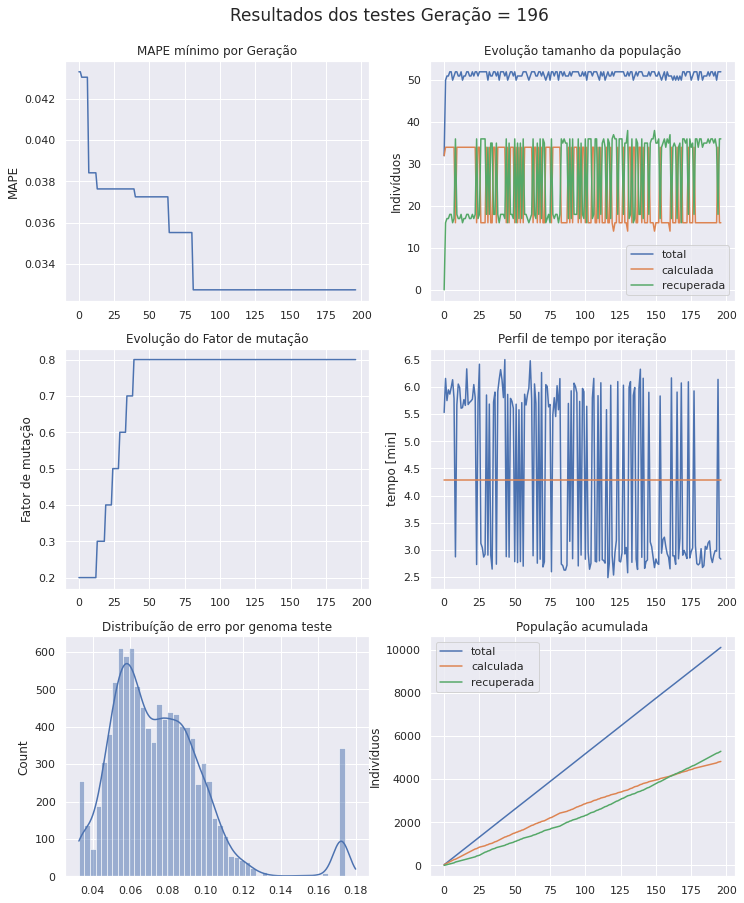

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
Indice Mutação:  0.9
	 parado a 0 epocas
-->>epoca 197 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [18 63 42 21 49 43 60  2 24 32 19 30 13]
Projenitores [21 46 45 51 21 28 61 60 38 50 28 24 63]
Projenitores [16 11  1  4 56 28 16 23  9 54 22 21 48]
Projenitores [35  0 29 21 54 53 61  8 50 54 22 37 40]
Projenitores [32 56 42  0 57 17 60 23 58  0 35  8 32]
Projenitores [18 21  0 51 24 47 46 29 16 58 18 62 38]
Projenitores [58 13 53 28 19 26 18  0 48 51 20 48 33]
Projenitores [18 40 11 62 13 32 55 54 10  9 43 42 38]
Projenitores [36 43 11  5  1 53 35 23 62 16 33 29 37]
Projenitores [26  0 27 51 57 28 61 60 60 50 28 23 63]
Projenitores [36 43 11  5  1 53 35 23 62  2 33 60 37]
Projenitores [32 46  9 55 21 21 34 32 28 55  2 57 35]
Projenitores [21 46 45 22 21 62 34 32 38 55 15 24 35]
Projenitores [ 2 63

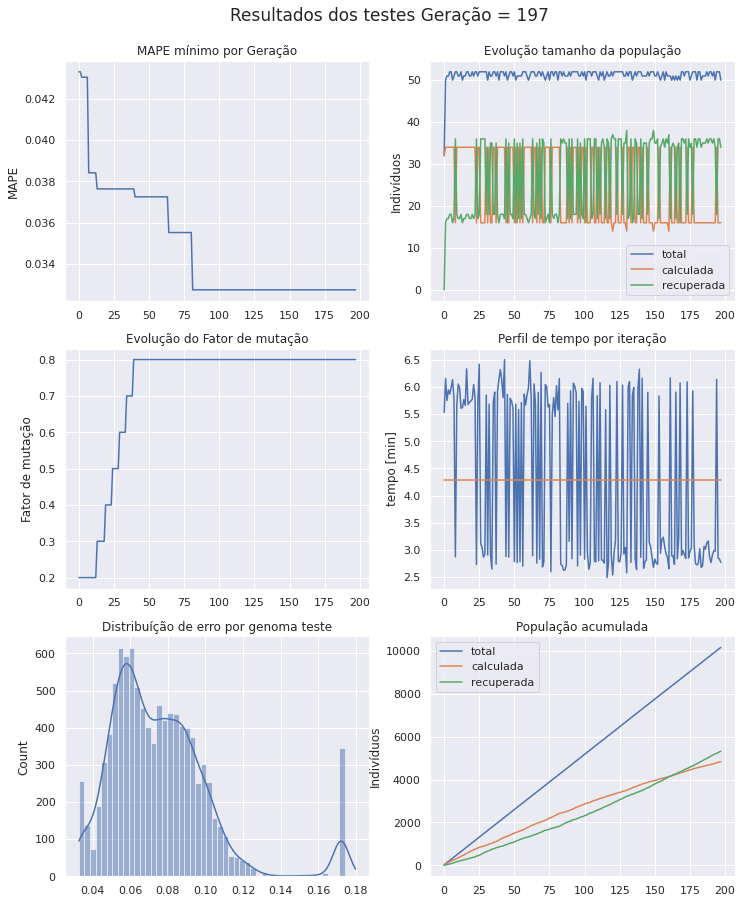

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 1 epocas
-->>epoca 198 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [ 3 33  9 22 25 17 38 53 24  0  9 60 13]
Projenitores [ 4 57  6 60 13 29 11 12 36 24 12 54  0]
Projenitores [ 3 33  9 22 25 54 38 53  7 26 18 60 57]
Projenitores [58 13 53 28 19 26 18  0 48 51 20 48 33]
Projenitores [19 39 59 27 48 63 24 30  7 15  6  5  8]
Projenitores [16 11  1  4 56 28 16 23  9 54 22 21 48]
Projenitores [32  0 29 21 57 53 61 23 58  0 35  8 32]
Projenitores [18 40 11 62 13 32 55 54 10  9 43 42 38]
Projenitores [58 23 32 59 36 52 32 52 31 45 22 58 54]
Projenitores [18 40 11  5 13 53 35 54 10  9 43 29 38]
Projenitores [21 46 45 51 21 28 61 60 38 50 28 24 63]
Projenitores [ 8 51 63 32 58 37 57 49  5 52 40  0 32]
Projenitores [18 45 29 21 49 39 60 41 24 44 46 41 13]
Projenitores [55  4 15  2  4 47 26 31  3 24 30 11  2]
Projenitores [36 43 11  5  1 53 35 23 62

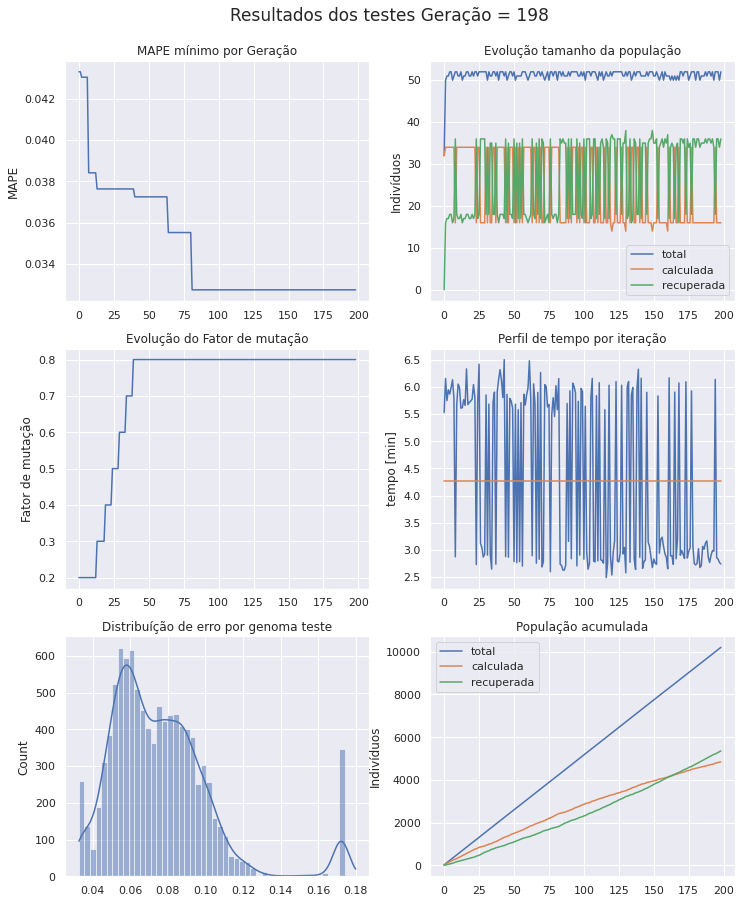

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 2 epocas
-->>epoca 199 ----------------------------------------------------
-->>>Seleção---------------------------------------------------
Projenitores [13 51 46 18  7 24 28 49 17 54  9 32 58]
Projenitores [55 42 13  2 48 34 57 46 51 52 49 20 15]
Projenitores [19 39 59 27 48 63 24 30  7 15  6  5  8]
Projenitores [ 3 33 53 28 25 54 18  0 48 51 20 60 57]
Projenitores [34 39 24 22  4 50 54 33 42  8  2  2 27]
Projenitores [54 45 29 29  8 39 63 41 49 44 46 41 28]
Projenitores [18 45 29 21 49 39 60 41 24 44 46 41 13]
Projenitores [18 40 11  5 13 53 35 54 10  9 43 29 38]
Projenitores [57 14 50 31 20  2  0 14 56 12 30 42 40]
Projenitores [16 11 59  4 56 63 16 23  9 54 22  5 48]
Projenitores [19 53 57 14 59 16 22 43 61 21 44 23  9]
Projenitores [14 52 12 63 58  4  9 18  4 54 33 12  8]
Projenitores [12 63 36 50 22 25 63  3 49 31 57  6 17]
Projenitores [58  0  0 21 38 26 22 33 20 24  7 37 30]
Projenitores [58 23 32 59 36 52 32 52 31

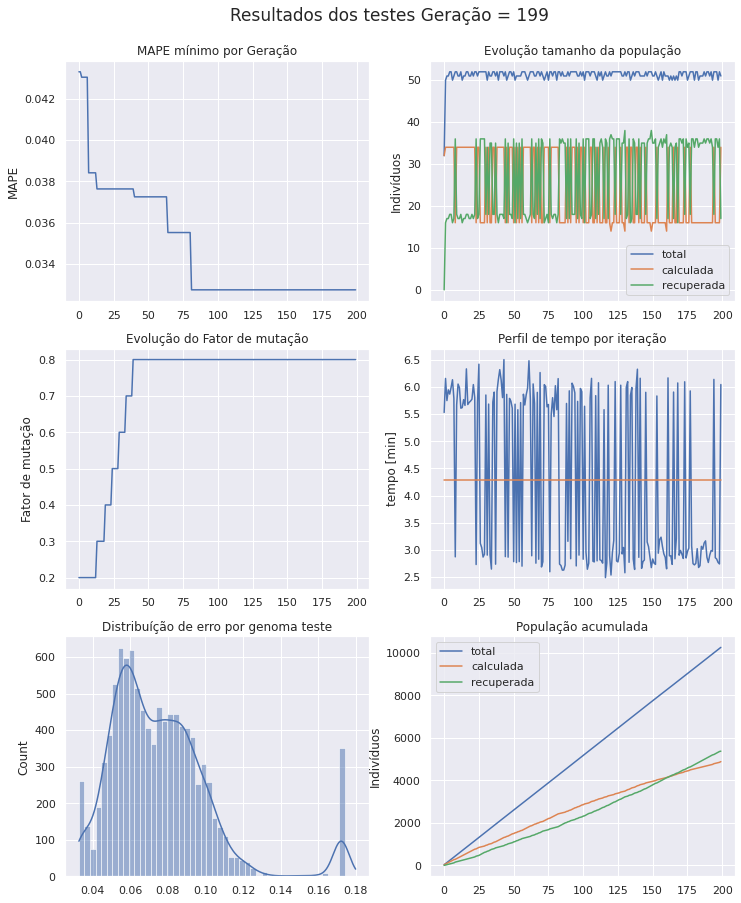

	 Min Erro Atual 0.03276 x 0.03276 Min Erro Anterior
	 parado a 3 epocas
Parada por maximo de interações:  200
Menor Mape   0.032756552045235796
Indice Mutação Final:  0.8
CPU times: user 16h 25min 41s, sys: 43min 37s, total: 17h 9min 19s
Wall time: 14h 27min 39s


In [29]:
%%time
# Parâmetros de entrada: 
ini_pop       = True        # Inicializa população aleatória
pop_selecao   = 0          # N melhore hist Selecionados para geração 0 
recup_memo    = False        # True recupera memória de iterações passadas
epocas        = 200          # total de gerações/Epocas
pop_tamanho   = 32          # tamanho da inicial população
n_genes       = 13           # Número de Genes
limites_genes = (0,64)      # Limite de valores para cada Gene
indice_mut    = 0.2         # Probaabilidade de Mutação inicial 
casais        = int((pop_tamanho+pop_selecao)/4)  # Número de casais Progenitores
max_parado    = 200         # Limite de epocas parado no mesmo erro
alvo          = 0.00001     # Erro Alvo

#------------------------------------------------------------------------------
arca_gen        = []           # Memória genetica
arca_apt        = []           # Memória de aptidão 
arca_mape       = []           # Memória de mape 
teste_mape      = []
count_parada    = 0
count_pop_r     = 0
count_pop_c     = 0
res             = []
elite           = []
list_mutacao    = []
list_tdiff      = []
list_t_pop      = []
list_t_pop_r    = []
list_t_pop_c    = []
novos_individuos= []
pre_selecionado = []
selecionado     = []
pop             = []

min_anterior  = 1
test_comb     = epocas*pop_tamanho
max_comb      = ((limites_genes[1]-limites_genes[0])+1)**n_genes


print('->Algoritmo genético de otimização -----------------------------------')
print(  '\t Nova Populaçao                         = '  , ini_pop       ,
      '\n\t Recupera memória de iterações passadas = '  , recup_memo    ,
      '\n\t Gerações máximas                       = '  , epocas        ,
      '\n\t Mais aptos selecionados em memória     = '  , pop_selecao   ,
      '\n\t Tamanho da população                   = '  , pop_tamanho   ,
      '\n\t Número de Genes                        = '  , n_genes       ,
      '\n\t Limite de valores para cada Gene       = '  , limites_genes ,
      '\n\t Probabilidade de Mutação inicial       = '  , indice_mut    ,
      '\n\t Casais por época                       = '  , casais        ,
      '\n\t Limite de épocas parado no mesmo erro  = '  , max_parado    ,
      '\n\t Erro Alvo                              = '  , alvo          ,
      '\n\t Total de combinações no teste          = '  , test_comb/20  ,
      '\n\t Tempo de execução estimado em horas    = '  , test_comb/20  ,
      '\n\t Total de combinações possíveis         = '  , max_comb      ,
      '\n\t Tempo máximo max comb. em anos         = '  , max_comb/175200
      )

if os.path.isfile(patha+'arca.csv') and recup_memo:
    arca_gen, arca_mape, arca_apt, dic_arca, dic_arca_i= recupera_arca()
    print('--------------------------------------------------------------------'
          ,'\n\t\t\t', len(arca_gen),'codigos recuperados'                
          ,'\n\t\t\t', f'{(len(arca_gen)/max_comb)*100:.5f} % da população avaliada' )
else: 
    dic_arca = {}
    dic_arca_i = {}
if ini_pop:
    print('-->Inicializa População............................................')
    pop = inicializa_populacao(pop_tamanho,n_genes,limites_genes)
    print('População Inicial:',pop)
if pop_selecao >0:
    for e, i in enumerate(arca_gen):
        if len(i) ==n_genes:
            pre_selecionado.append(i)
    print (len(pre_selecionado),'possiveis de seleção')    
    for e, i in enumerate(pre_selecionado[0:pop_selecao]):
        print (e,i, len(i))
        selecionado.append(i)
    pop += selecionado
for ep in range(epocas):
    T1 = datetime.now()
    gera_mape = []
    count_pop_r = 0
    count_pop_c = 0
    print('-->>epoca',ep,'----------------------------------------------------')
    #print('Novos Individuos:',novos_individuos)
    if ep > 0: 
        print('-->>>Seleção---------------------------------------------------')
        for i in progenitores.ravel():
            # Progenitores selecionados aleatóriamente  #####
            novos_individuos.append(pop[i])
            print("Progenitores", pop[i])
        for el in range(2):
            # Elite garantindo os 2 melhores da geração anterior
            bol, pos = busca_item_lista(elite[el],novos_individuos)
            if not bol:
                print('\t\t VIP', elite[el])
                novos_individuos.append(elite[el])
        pop = novos_individuos
        novos_individuos = []
    list_t_pop.append(len(pop))
    #print('Novos Individuos:',novos_individuos)
    probabilidades = []  
    print('-->>>Aptidão-------------------------------------------------------')
    for id, individuo in enumerate(pop):
        print(ep,'#', id, individuo)
        #bag, ibag = busca_item_lista(individuo, arca_gen)
        
        if tuple(individuo) in dic_arca:
            print('\t__Individuo Clone Recuperado da Arca #id:',
                  dic_arca[tuple(individuo)][0])
            a = dic_arca[tuple(individuo)][3]
            m = dic_arca[tuple(individuo)][2]
            print('\t arca_apt recuperado:',a)
            print('\t arca_mape recuperado:',m)
            count_pop_r +=1
        else:
            m,a = func_aptidao(individuo)
            dic_arca[tuple(individuo)]=[len(dic_arca),individuo,m,a]
            dic_arca_i[len(dic_arca_i)]=individuo
            arca_gen.append(individuo)
            arca_apt.append(a)
            arca_mape.append(m)
            count_pop_c +=1
        #print(probabilidades)
        if m>1:
            probabilidades.append(0)
        else: 
            probabilidades.append(1-m)
        gera_mape.append(m)
        #print('\t\t individuo mape',individuo,m)
        #print('\t\t',gera_mape)
    list_t_pop_c.append(count_pop_c)
    list_t_pop_r.append(count_pop_r)
    probabilidades =(np.array(probabilidades)/sum(probabilidades))
    #print('\t população avaliada:', pop)
    print('\t Probabilidades:', np.round(probabilidades,4))
    print('-->>>Elite---------------------------------------------------------')
    
    prob_elite = np.sort(probabilidades).tolist()[-2:]
    elite = [   pop[probabilidades.tolist().index(prob_elite[0])],
                pop[probabilidades.tolist().index(prob_elite[1])]]
    print('\t\t Elite :', elite)

    print('-->>>Progenitores--------------------------------------------------')
    progenitores = selecao_de_progenitores(pop, probabilidades, casais) 
    print('-->>>Cruzamento----------------------------------------------------')
    for p in progenitores:
        f1, f2 = cruzamento(p,pop, n_genes)
        novos_individuos.append(f1)
        novos_individuos.append(f2)
    print('Novos Individuos F1:',f1)
    print('Novos Individuos F2:',f2)
    #print('Novos Individuos:',novos_individuos)
    print('-->>>Mutação-------------------------------------------------------')
    # Replicas com Mutação dos filhos 
    mutantes = [] 
    for en, ori in enumerate(novos_individuos):
        mu = mutacao(ori,indice_mut,n_genes)
        mutantes.append(mu)
    novos_individuos += mutantes
    # Replicas com mutação da elite
    mutantes2 = [] 
    print('Novos Individuos:',novos_individuos)
    for en, ori in enumerate(elite):
        mu = mutacao(ori,indice_mut,n_genes)
        mutantes2.append(mu)
    novos_individuos += mutantes2
    print('Novos Individuos:',novos_individuos)
    ## Resultados Parciais ----------------------------------------------------
    teste_mape += gera_mape 
    ge_mape_min = (min(gera_mape))              # Menor erro na geração
    res.append(ge_mape_min)     
    ge_mape_ind = arca_mape.index(ge_mape_min)  
    ge_mape_gen = arca_gen[ge_mape_ind]
    
    list_mutacao.append(indice_mut)             # Indice de proba Mutação
    list_tdiff.append(time_diff(T1))            # Tempo de Processamento 
    
    ar_mape_min = min(arca_mape)     # Menor erro histórico
    ar_mape_ind = arca_mape.index(ar_mape_min)  
    ar_mape_gen = arca_gen[ar_mape_ind]
  
    relatorio_parcial()

    #Salva resultados Parciais    
    idtest = n_genes
    salva_resultado(ep,res,list_mutacao,list_tdiff,list_t_pop,
                    list_t_pop_r,list_t_pop_c,idtest)
    salva_arca(ep,idtest)

    # Critérios de parada
    if ge_mape_min < alvo:
        print('para por atingimento do alvo')
        break
    print(f'\t Min Erro Atual {ge_mape_min:.5f} x {min_anterior:.5f} Min Erro Anterior')
    if round(ge_mape_min,5) == round(min_anterior,5):
        count_parada +=1
        if count_parada > 4:
            if indice_mut < 0.81:
                indice_mut += 0.1
                print('Indice Mutação: ', indice_mut)
                count_parada = 0
        if indice_mut > 0.81:
            indice_mut = 0.8 

        if count_parada > max_parado:
            print('para por atingimento do limite de iterações parado')
            break
    else:
        
        min_anterior = min(ge_mape_min, min_anterior) #P/ Prox Laço 
        count_parada = 0
    print(f'\t parado a {count_parada} epocas')
            
print('Parada por maximo de interações: ', ep+1             )
print('Menor Mape  '                     , min(arca_mape)   )
print('Indice Mutação Final: '           , indice_mut       )
atualiza_arca(False)

In [ ]:
#relatorio_parcial()

## Relatórios Extras

In [ ]:
plt.figure(figsize=(16,8))
sns.lineplot(range(len(res)),res)
plt.title('MAPE mínimo por Geração', fontsize=17)
plt.ylabel('MAPE')
plt.xlabel('Geração')
plt.show();

In [ ]:
plt.figure(figsize=(16,8))
sns.histplot(arca_mape, kde=True)
plt.title('Distribuíção de erro por genoma', fontsize=17)
#plt.ylabel('MAPE')
#plt.xlabel('Geração')
plt.show();
display(len(arca_mape))

In [ ]:
arca_hist = df_arca_hist(pd.read_csv(urla))
arca_mean = arca_hist.mape.describe()[1]
arca_std = arca_hist.mape.describe()[2]
arca_min = arca_hist.mape.describe()[3]
arca_max =  arca_hist.mape.describe()[7]
arca_hist.mape.describe()

In [ ]:
plt.figure(figsize=(16,8))
sns.histplot(arca_hist.mape, kde=True)

plt.title('Distribuíção de erro por genoma', fontsize=17)
#plt.ylabel('MAPE')
#plt.xlabel('Geração')

xinf = max(arca_mean - 2*arca_std,arca_min)
xsup = min(arca_mean + 2*arca_std,arca_max)
plt.xlim(xinf,xsup)
#plt.xlim(0.0779,0.0829)
plt.show();
display(len(arca_hist.mape))


In [ ]:
arca_hist = df_arca_hist(pd.read_csv(urla))

In [ ]:
plt.figure(figsize=(16,8))

sns.histplot(x = arca_hist.mape, kde=True,palette='Dark2')

plt.title('Distribuíção de erro por genoma', fontsize=17)
#plt.ylabel('MAPE')
#plt.xlabel('Geração')

xinf = max(arca_mean - 2*arca_std,arca_min)
xsup = min(arca_mean + 2*arca_std,arca_max)
plt.xlim(xinf,xsup)
#plt.ylim(0,2000)

plt.show();
display(len(arca_hist.mape),65**4,len(arca_hist.mape)/65**4)
print(xinf, xsup)

In [ ]:
arca_hist.to_excel(path+'genhist.csv')

#Fim